In [2]:
#%ls
import pandas as pd
import numpy as np
import datetime 
file='tmean.csv'

Some notes about this data:
Data is not aggregated. Daily obervations are columnar (i.e. a column is a day, likely a measurement reported first time)
Each entry is a station.
Need to organize this data so that stations are aggregated and daily temp is reported per station
So, each station is about to have 361 records per year.
Columns spam from 2004 to 2014 (So there are 10 years of daily records in temperature as reported by 141 stations


In [3]:
data= pd.read_csv(file,header='infer',delimiter=',')
data.head(5)

,Station_Name,Longitude,Latitude,1/1/04 0:00,1/2/04 0:00,1/3/04 0:00,1/4/04 0:00,1/5/04 0:00,1/6/04 0:00,1/7/04 0:00,...,12/22/14 0:00,12/23/14 0:00,12/24/14 0:00,12/25/14 0:00,12/26/14 0:00,12/27/14 0:00,12/28/14 0:00,12/29/14 0:00,12/30/14 0:00,12/31/14 0:00
0,228,-85.125142,42.903843,-0.455,0.425,8.940001,1.915,-4.520,-8.345000,-12.025000,...,-1.295,0.100,6.360,2.280,1.340,4.520,4.060,-1.270,-5.315,-7.825
1,1375,-84.629681,42.527093,-0.120,1.245,8.340000,3.465,-3.450,-8.059999,-11.690001,...,-1.555,0.090,7.345,2.625,1.305,4.755,4.380,-1.265,-5.565,-7.505
2,1382,-84.736609,42.542085,-0.045,1.485,7.930000,3.540,-3.405,-8.020000,-11.445000,...,-1.710,0.130,7.105,2.540,1.105,4.660,4.190,-1.410,-5.645,-7.620
3,1426,-84.640901,42.277745,0.175,1.855,8.970000,3.990,-3.105,-8.060000,-12.260000,...,-2.020,-0.015,6.825,2.740,1.175,4.995,4.115,-1.705,-5.460,-7.765
4,1436,-84.869903,42.300634,0.425,1.760,9.645000,4.220,-2.745,-7.915000,-11.880000,...,-1.945,0.000,6.855,2.425,1.085,5.105,3.955,-1.680,-5.515,-7.690


In [4]:
#First let's rename the date-based columns
check= data.columns[3]
check.split(' ')[0]

def date_only(col_name):
    return col_name.split(' ')[0]

In [5]:
## Drop the hour, it is distracting and does nothing
date_columns= data.columns[3:]
date_names= [date_only(date) for date in date_columns]

In [6]:
## Create the new list of names for the data
data_first_cols= list(data.columns[:3])      #first columns: station,lat.long (unchanged)

for date in date_names:
    data_first_cols.append(date)            #Add in date-columns without the hour stamp

In [7]:
# Rename columns
data.columns= data_first_cols

It worked. Now the dataset columns are ready and we can start re-arranging the data. Going from wide to long.
It seems the stations are located between 80 and 89 Longitude and 35 to 42 Latitude. This may me think the temperature readings should not be so different from station to station. Significant departures may indicate some sort of anomalies.
Analysis per station makes sense as long as it is aggregated at some level.

In [8]:
#Find out how disperse are the stations from one another:
data[['Longitude','Latitude']].describe()

,Longitude,Latitude
count,141.000000,141.000000
mean,-86.499853,40.224094
std,1.949090,2.000965
min,-89.992511,35.153944
25%,-88.264231,39.435836
50%,-86.109575,40.676619
75%,-85.366560,41.790214
max,-80.357434,42.918773


In [9]:
data_long= pd.melt(data, id_vars=['Station_Name','Latitude','Longitude'], 
                   value_vars= data.columns[3:], 
                   var_name='Date',
                   value_name='X')

data_long.Date= pd.to_datetime(data_long.Date)     # Convert to date
data_long= data_long.sort_values(by=['Station_Name','Date'], ascending=[False,True]) #Sort by station and date

# Create year, month, and day for faster aggregation:
data_long['year']= pd.DatetimeIndex(data_long.Date).year
data_long['month']= pd.DatetimeIndex(data_long.Date).month
data_long['day']=pd.DatetimeIndex(data_long.Date).day

In [10]:
data_long.head(5)

,Station_Name,Latitude,Longitude,Date,X,year,month,day
140,11887,36.659153,-86.766564,2004-01-01,6.805,2004,1,1
281,11887,36.659153,-86.766564,2004-01-02,9.975,2004,1,2
422,11887,36.659153,-86.766564,2004-01-03,14.625,2004,1,3
563,11887,36.659153,-86.766564,2004-01-04,18.760,2004,1,4
704,11887,36.659153,-86.766564,2004-01-05,11.060,2004,1,5


In [11]:
daily_means= data_long.groupby(by='month').mean().loc[:,'X']     #daily avg across stations

In [12]:
daily_means

month
1     -2.753425
2     -2.118900
3      4.663923
4     11.130163
5     16.919906
6     21.980275
7     23.346206
8     22.598747
9     18.847057
10    12.108986
11     5.655045
12    -0.352169
Name: X, dtype: float64

In [13]:
# how many stations are there?
n_stations= len(data_long.Station_Name.unique())
print('There are {} stations'.format(n_stations))

There are 141 stations


In [14]:
data_long[data_long['Station_Name'] == 11887 ][0:3]

,Station_Name,Latitude,Longitude,Date,X,year,month,day
140,11887,36.659153,-86.766564,2004-01-01,6.805,2004,1,1
281,11887,36.659153,-86.766564,2004-01-02,9.975,2004,1,2
422,11887,36.659153,-86.766564,2004-01-03,14.625,2004,1,3


In [15]:
# Function to compute departures from "the everage" by a station:

def daily_departure(station):
    subset= data_long[data_long['Station_Name'] == station]
    station_means= subset.groupby(by='month').mean().loc[:,'X']
    return station_means

#testing the stuff:
#daily_departure(11887)

In [20]:
data_long.head(5)

,Station_Name,Latitude,Longitude,Date,X,year,month,day
140,11887,36.659153,-86.766564,2004-01-01,6.805,2004,1,1
281,11887,36.659153,-86.766564,2004-01-02,9.975,2004,1,2
422,11887,36.659153,-86.766564,2004-01-03,14.625,2004,1,3
563,11887,36.659153,-86.766564,2004-01-04,18.760,2004,1,4
704,11887,36.659153,-86.766564,2004-01-05,11.060,2004,1,5


In [74]:
#selected_years= [2004,2008,2012,2016]
#data_04_12= data_long[data_long.year.isin(selected_years)]
##TODO: plot 4 years


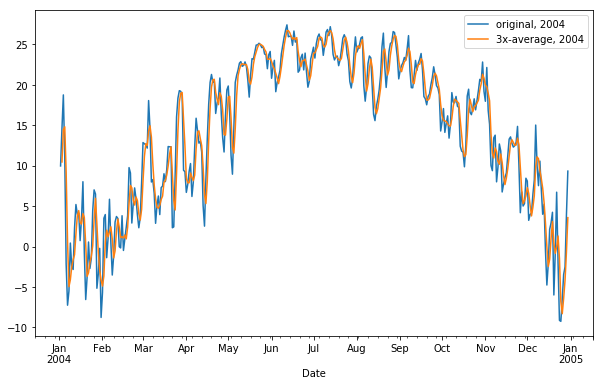

In [57]:
from pandas import Series

Series()
series= Series(data=data_long.X.values, index=data_long.Date)
plt.figure(figsize=(10,6))
series[1:365].plot()
series.rolling(window=3).mean()[1:365].plot()
plt.legend(['original, 2004', '3x-average, 2004'])
plt.show()

predicted=10.468333, expected=18.760000
predicted=14.453334, expected=11.060000
predicted=14.815000, expected=-2.150000
predicted=9.223334, expected=-7.245000
predicted=0.555000, expected=-5.490000
predicted=-4.961667, expected=0.440000
predicted=-4.098333, expected=-2.485000
predicted=-2.511667, expected=-2.825000
predicted=-1.623333, expected=2.285000
predicted=-1.008333, expected=5.205000
predicted=1.555000, expected=3.995000
predicted=3.828333, expected=4.155000
predicted=4.451667, expected=0.740000
predicted=2.963333, expected=3.490000
predicted=2.795000, expected=8.025000
predicted=4.085000, expected=-0.735000
predicted=3.593333, expected=-6.545000
predicted=0.248333, expected=-3.740000
predicted=-3.673333, expected=0.570000
predicted=-3.238333, expected=-2.705000
predicted=-1.958333, expected=-1.440000
predicted=-1.191667, expected=4.415000
predicted=0.090000, expected=7.015000
predicted=3.330000, expected=6.500000
predicted=5.976667, expected=-5.150000
predicted=2.788333, expec

predicted=3.588333, expected=-1.900000
predicted=1.296667, expected=1.235000
predicted=1.035000, expected=4.610000
predicted=1.315000, expected=7.140000
predicted=4.328333, expected=7.940001
predicted=6.563334, expected=10.730000
predicted=8.603333, expected=8.340000
predicted=9.003333, expected=1.920000
predicted=6.996667, expected=2.110000
predicted=4.123333, expected=3.470000
predicted=2.500000, expected=6.070000
predicted=3.883333, expected=6.150000
predicted=5.230000, expected=4.855000
predicted=5.691667, expected=3.160000
predicted=4.721667, expected=3.490000
predicted=3.835000, expected=5.595000
predicted=4.081667, expected=-3.415000
predicted=1.890000, expected=-8.705000
predicted=-2.175000, expected=-5.985000
predicted=-6.035000, expected=1.425000
predicted=-4.421667, expected=9.620000
predicted=1.686667, expected=15.440001
predicted=8.828333, expected=17.125000
predicted=14.061667, expected=11.585000
predicted=14.716667, expected=7.790000
predicted=12.166667, expected=11.1550

predicted=21.508333, expected=24.009998
predicted=21.828332, expected=19.584999
predicted=21.279999, expected=20.715000
predicted=21.436666, expected=22.455000
predicted=20.918333, expected=25.145000
predicted=22.771667, expected=24.090000
predicted=23.896667, expected=20.205000
predicted=23.146667, expected=21.985001
predicted=22.093334, expected=23.809999
predicted=22.000000, expected=24.250000
predicted=23.348333, expected=26.664999
predicted=24.908333, expected=26.475000
predicted=25.796666, expected=26.404999
predicted=26.514999, expected=24.280001
predicted=25.720000, expected=19.590000
predicted=23.425000, expected=17.105000
predicted=20.325000, expected=15.825001
predicted=17.506667, expected=15.320000
predicted=16.083333, expected=16.400000
predicted=15.848333, expected=18.630001
predicted=16.783333, expected=14.835000
predicted=16.621667, expected=15.480000
predicted=16.315000, expected=8.995000
predicted=13.103333, expected=9.850000
predicted=11.441667, expected=11.425000
pr

predicted=20.495000, expected=21.904999
predicted=21.644999, expected=21.315001
predicted=21.926666, expected=21.580000
predicted=21.600000, expected=22.095001
predicted=21.663334, expected=22.145000
predicted=21.940001, expected=25.599998
predicted=23.280000, expected=28.029999
predicted=25.258333, expected=21.965000
predicted=25.198332, expected=21.100000
predicted=23.698333, expected=23.599998
predicted=22.221666, expected=24.540001
predicted=23.080000, expected=24.510000
predicted=24.216667, expected=23.215000
predicted=24.088334, expected=23.959999
predicted=23.895000, expected=24.485001
predicted=23.886667, expected=24.645000
predicted=24.363333, expected=24.965000
predicted=24.698334, expected=25.334999
predicted=24.981667, expected=25.420000
predicted=25.240000, expected=26.815001
predicted=25.856667, expected=26.684999
predicted=26.306667, expected=27.510000
predicted=27.003333, expected=24.715000
predicted=26.303333, expected=22.735001
predicted=24.986667, expected=22.320000


predicted=4.841667, expected=5.300000
predicted=3.583333, expected=9.090000
predicted=5.485000, expected=12.255000
predicted=8.881667, expected=9.770000
predicted=10.371667, expected=11.025000
predicted=11.016666, expected=9.145000
predicted=9.980000, expected=4.590000
predicted=8.253333, expected=2.525000
predicted=5.420000, expected=7.040000
predicted=4.718333, expected=9.225000
predicted=6.263333, expected=13.865001
predicted=10.043334, expected=3.595000
predicted=8.895000, expected=5.490000
predicted=7.650000, expected=4.870000
predicted=4.651666, expected=6.030000
predicted=5.463333, expected=8.755000
predicted=6.551667, expected=10.275000
predicted=8.353333, expected=10.420000
predicted=9.816667, expected=10.535000
predicted=10.410000, expected=13.410000
predicted=11.455000, expected=13.190000
predicted=12.378333, expected=7.435000
predicted=11.345000, expected=10.915000
predicted=10.513333, expected=15.735000
predicted=11.361667, expected=11.605000
predicted=12.751666, expected=

predicted=4.153333, expected=5.090000
predicted=5.296667, expected=6.285000
predicted=6.230000, expected=7.910000
predicted=6.428333, expected=4.730000
predicted=6.308333, expected=5.785000
predicted=6.141667, expected=12.095000
predicted=7.536667, expected=9.365000
predicted=9.081667, expected=2.090000
predicted=7.850000, expected=6.240000
predicted=5.898333, expected=5.185000
predicted=4.505000, expected=0.730000
predicted=4.051667, expected=5.735000
predicted=3.883333, expected=10.455000
predicted=5.640000, expected=9.745000
predicted=8.645000, expected=7.110000
predicted=9.103333, expected=13.915001
predicted=10.256667, expected=6.140000
predicted=9.055000, expected=3.780000
predicted=7.945000, expected=3.325000
predicted=4.415000, expected=2.385000
predicted=3.163333, expected=1.120000
predicted=2.276667, expected=3.905000
predicted=2.470000, expected=6.305000
predicted=3.776667, expected=7.660000
predicted=5.956667, expected=10.575000
predicted=8.180000, expected=11.500000
predic

predicted=29.361668, expected=28.145000
predicted=28.956668, expected=26.029999
predicted=27.631667, expected=25.830000
predicted=26.668333, expected=23.240000
predicted=25.033333, expected=23.045000
predicted=24.038333, expected=24.415001
predicted=23.566667, expected=27.165001
predicted=24.875001, expected=25.150000
predicted=25.576667, expected=25.980000
predicted=26.098333, expected=26.885000
predicted=26.005000, expected=27.065001
predicted=26.643333, expected=26.635000
predicted=26.861667, expected=20.174999
predicted=24.625000, expected=19.235001
predicted=22.015000, expected=21.660000
predicted=20.356667, expected=24.984999
predicted=21.960000, expected=25.494999
predicted=24.046666, expected=23.630001
predicted=24.703333, expected=24.415001
predicted=24.513334, expected=27.395000
predicted=25.146667, expected=23.170000
predicted=24.993334, expected=21.170000
predicted=23.911667, expected=23.345001
predicted=22.561667, expected=24.540001
predicted=23.018334, expected=26.505001


predicted=22.671667, expected=20.545000
predicted=21.905000, expected=24.404999
predicted=22.236666, expected=26.799999
predicted=23.916666, expected=25.049999
predicted=25.418332, expected=22.215000
predicted=24.688333, expected=21.095001
predicted=22.786667, expected=19.395000
predicted=20.901667, expected=17.039999
predicted=19.176667, expected=19.485001
predicted=18.640000, expected=22.630001
predicted=19.718334, expected=25.685001
predicted=22.600001, expected=25.779999
predicted=24.698334, expected=26.625000
predicted=26.030000, expected=24.410000
predicted=25.605000, expected=24.055000
predicted=25.030000, expected=22.605000
predicted=23.690000, expected=21.665001
predicted=22.775000, expected=20.950001
predicted=21.740000, expected=23.375000
predicted=21.996667, expected=25.270000
predicted=23.198334, expected=23.910000
predicted=24.185000, expected=21.440001
predicted=23.540000, expected=23.174999
predicted=22.841667, expected=23.670000
predicted=22.761667, expected=26.595001


predicted=6.921667, expected=2.470000
predicted=4.138333, expected=7.485000
predicted=4.061667, expected=8.970000
predicted=6.308333, expected=13.305000
predicted=9.920000, expected=14.795000
predicted=12.356667, expected=14.554999
predicted=14.218333, expected=7.010000
predicted=12.120000, expected=5.605000
predicted=9.056667, expected=8.345000
predicted=6.986667, expected=9.515000
predicted=7.821667, expected=13.845000
predicted=10.568334, expected=11.084999
predicted=11.481667, expected=6.380000
predicted=10.436666, expected=3.650000
predicted=7.038333, expected=2.135000
predicted=4.055000, expected=5.350000
predicted=3.711667, expected=9.280000
predicted=5.588333, expected=10.930000
predicted=8.520000, expected=4.425000
predicted=8.211667, expected=1.870000
predicted=5.741667, expected=5.790000
predicted=4.028333, expected=8.805000
predicted=5.488333, expected=12.675000
predicted=9.090000, expected=9.605000
predicted=10.361667, expected=12.045000
predicted=11.441667, expected=9.350

predicted=14.291667, expected=6.020000
predicted=12.318333, expected=6.540000
predicted=9.290000, expected=11.290000
predicted=7.950000, expected=12.815001
predicted=10.215000, expected=12.139999
predicted=12.081667, expected=17.220001
predicted=14.058334, expected=18.105000
predicted=15.821667, expected=17.850000
predicted=17.725000, expected=14.110001
predicted=16.688334, expected=6.005000
predicted=12.655000, expected=8.230000
predicted=9.448334, expected=12.790000
predicted=9.008333, expected=14.414999
predicted=11.811666, expected=16.910000
predicted=14.705000, expected=18.834999
predicted=16.719999, expected=12.850000
predicted=16.198333, expected=2.695000
predicted=11.460000, expected=1.885000
predicted=5.810000, expected=3.275000
predicted=2.618333, expected=7.330000
predicted=4.163333, expected=4.495000
predicted=5.033333, expected=6.720000
predicted=6.181667, expected=8.145000
predicted=6.453333, expected=4.935000
predicted=6.600000, expected=6.320000
predicted=6.466666, expe

predicted=29.613333, expected=30.610001
predicted=29.861666, expected=32.709999
predicted=30.579999, expected=32.465000
predicted=31.928333, expected=30.090000
predicted=31.755000, expected=27.295000
predicted=29.950000, expected=28.270000
predicted=28.551667, expected=30.260000
predicted=28.608334, expected=30.885000
predicted=29.805000, expected=30.105000
predicted=30.416667, expected=31.235001
predicted=30.741667, expected=30.969999
predicted=30.770000, expected=31.660000
predicted=31.288333, expected=32.080002
predicted=31.570000, expected=30.174999
predicted=31.305000, expected=26.469999
predicted=29.575000, expected=28.014999
predicted=28.219999, expected=29.455000
predicted=27.980000, expected=30.245001
predicted=29.238333, expected=30.715000
predicted=30.138334, expected=29.300001
predicted=30.086667, expected=28.345001
predicted=29.453334, expected=26.570000
predicted=28.071667, expected=26.335001
predicted=27.083334, expected=23.215000
predicted=25.373334, expected=22.940001


predicted=11.795000, expected=15.125000
predicted=14.243334, expected=13.750000
predicted=14.435000, expected=18.830000
predicted=15.901667, expected=21.844999
predicted=18.141666, expected=21.340000
predicted=20.671666, expected=16.540001
predicted=19.908333, expected=6.080000
predicted=14.653334, expected=8.795000
predicted=10.471667, expected=11.990000
predicted=8.955000, expected=15.315001
predicted=12.033333, expected=18.475000
predicted=15.260000, expected=21.639999
predicted=18.476667, expected=22.750000
predicted=20.955000, expected=20.514999
predicted=21.635000, expected=16.240000
predicted=19.835000, expected=13.340000
predicted=16.698333, expected=18.215000
predicted=15.931667, expected=23.119999
predicted=18.225000, expected=24.639999
predicted=21.991666, expected=22.264999
predicted=23.341666, expected=21.650002
predicted=22.851667, expected=24.994999
predicted=22.970000, expected=27.299999
predicted=24.648333, expected=25.605000
predicted=25.966666, expected=22.440001
pre

predicted=3.478333, expected=4.505000
predicted=5.695000, expected=0.040000
predicted=4.098333, expected=-3.970000
predicted=0.191667, expected=2.495000
predicted=-0.478333, expected=8.470000
predicted=2.331667, expected=4.555000
predicted=5.173333, expected=2.095000
predicted=5.040000, expected=4.125000
predicted=3.591667, expected=3.260000
predicted=3.160000, expected=2.685000
predicted=3.356667, expected=3.660000
predicted=3.201667, expected=4.400000
predicted=3.581667, expected=4.650000
predicted=4.236667, expected=2.625000
predicted=3.891667, expected=5.755000
predicted=4.343333, expected=8.640000
predicted=5.673333, expected=10.985001
predicted=8.460000, expected=10.225000
predicted=9.950000, expected=6.955000
predicted=9.388334, expected=1.995000
predicted=6.391667, expected=1.890000
predicted=3.613333, expected=6.935000
predicted=3.606667, expected=8.955000
predicted=5.926667, expected=13.090000
predicted=9.660000, expected=14.530001
predicted=12.191667, expected=14.245000
pred

predicted=20.216667, expected=22.455000
predicted=20.826667, expected=21.225000
predicted=21.121667, expected=16.180000
predicted=19.953334, expected=18.495001
predicted=18.633334, expected=20.500000
predicted=18.391667, expected=14.924999
predicted=17.973333, expected=10.260000
predicted=15.228333, expected=10.510000
predicted=11.898333, expected=9.835000
predicted=10.201667, expected=10.520000
predicted=10.288334, expected=13.365000
predicted=11.240000, expected=10.650000
predicted=11.511667, expected=11.559999
predicted=11.858333, expected=13.850000
predicted=12.020000, expected=16.790001
predicted=14.066667, expected=9.180000
predicted=13.273334, expected=10.295000
predicted=12.088334, expected=12.095000
predicted=10.523334, expected=14.575000
predicted=12.321667, expected=14.720000
predicted=13.796667, expected=5.360000
predicted=11.551667, expected=5.710000
predicted=8.596667, expected=11.000000
predicted=7.356667, expected=12.080000
predicted=9.596667, expected=10.630000
predict

predicted=27.171666, expected=26.615000
predicted=26.706666, expected=29.125000
predicted=27.285000, expected=29.075001
predicted=28.271667, expected=28.850000
predicted=29.016667, expected=27.990002
predicted=28.638334, expected=26.924999
predicted=27.921667, expected=28.325001
predicted=27.746667, expected=28.570000
predicted=27.940000, expected=29.660000
predicted=28.851667, expected=29.235001
predicted=29.155000, expected=29.030001
predicted=29.308334, expected=30.270000
predicted=29.511667, expected=29.650000
predicted=29.650000, expected=28.514999
predicted=29.478333, expected=27.375000
predicted=28.513333, expected=28.180000
predicted=28.023333, expected=29.215000
predicted=28.256667, expected=29.625000
predicted=29.006667, expected=29.990000
predicted=29.610000, expected=27.755001
predicted=29.123334, expected=29.500000
predicted=29.081667, expected=32.389999
predicted=29.881667, expected=32.400002
predicted=31.430000, expected=29.400000
predicted=31.396667, expected=26.859999


predicted=10.683333, expected=17.915001
predicted=15.003333, expected=20.559999
predicted=18.163333, expected=22.459999
predicted=20.311666, expected=19.625000
predicted=20.881666, expected=7.815000
predicted=16.633333, expected=11.155000
predicted=12.865000, expected=13.495000
predicted=10.821667, expected=17.735001
predicted=14.128333, expected=20.115000
predicted=17.115000, expected=24.610001
predicted=20.820000, expected=25.209999
predicted=23.311666, expected=16.040001
predicted=21.953334, expected=7.935000
predicted=16.395000, expected=11.980000
predicted=11.985000, expected=13.275001
predicted=11.063333, expected=17.200001
predicted=14.151667, expected=14.720000
predicted=15.065001, expected=7.770000
predicted=13.230000, expected=12.630000
predicted=11.706667, expected=13.375000
predicted=11.258333, expected=14.280000
predicted=13.428333, expected=13.370000
predicted=13.675000, expected=18.465000
predicted=15.371667, expected=21.670000
predicted=17.835000, expected=20.559999
pre

predicted=12.511667, expected=16.690001
predicted=15.040000, expected=17.070000
predicted=16.273333, expected=16.090000
predicted=16.616667, expected=15.690001
predicted=16.283333, expected=11.264999
predicted=14.348333, expected=0.920000
predicted=9.291667, expected=2.260000
predicted=4.815000, expected=3.620000
predicted=2.266667, expected=7.060000
predicted=4.313333, expected=12.360000
predicted=7.680000, expected=18.395000
predicted=12.605000, expected=16.770000
predicted=15.841667, expected=4.925000
predicted=13.363334, expected=-1.200000
predicted=6.831667, expected=-1.230000
predicted=0.831667, expected=-6.005000
predicted=-2.811667, expected=-5.525000
predicted=-4.253333, expected=-1.740000
predicted=-4.423333, expected=4.765000
predicted=-0.833333, expected=8.285000
predicted=3.770000, expected=4.360000
predicted=5.803333, expected=-0.030000
predicted=4.205000, expected=-3.945000
predicted=0.128333, expected=2.665000
predicted=-0.436667, expected=8.665000
predicted=2.461667, e

predicted=25.266667, expected=22.135000
predicted=23.720000, expected=22.325001
predicted=22.846667, expected=22.680000
predicted=22.380000, expected=24.040001
predicted=23.015001, expected=23.559999
predicted=23.426667, expected=24.605000
predicted=24.068333, expected=25.090000
predicted=24.418333, expected=25.920000
predicted=25.205000, expected=26.480000
predicted=25.830000, expected=26.225000
predicted=26.208333, expected=26.345001
predicted=26.350000, expected=25.230000
predicted=25.933334, expected=21.060001
predicted=24.211667, expected=17.125000
predicted=21.138334, expected=14.600000
predicted=17.595001, expected=15.209999
predicted=15.645000, expected=17.795000
predicted=15.868333, expected=20.450001
predicted=17.818333, expected=20.350000
predicted=19.531667, expected=19.764999
predicted=20.188334, expected=22.205000
predicted=20.773333, expected=21.325001
predicted=21.098333, expected=16.565001
predicted=20.031667, expected=18.385000
predicted=18.758334, expected=20.825001


predicted=30.168334, expected=29.730000
predicted=30.023333, expected=29.510000
predicted=29.900000, expected=28.849998
predicted=29.363333, expected=29.174999
predicted=29.178333, expected=29.494999
predicted=29.173332, expected=28.299999
predicted=28.989999, expected=26.055000
predicted=27.949999, expected=24.120001
predicted=26.158333, expected=23.934999
predicted=24.703334, expected=24.980000
predicted=24.345000, expected=28.010000
predicted=25.641666, expected=26.850002
predicted=26.613334, expected=27.785000
predicted=27.548334, expected=28.480000
predicted=27.705001, expected=27.910000
predicted=28.058333, expected=28.870001
predicted=28.420000, expected=26.924999
predicted=27.901667, expected=27.845001
predicted=27.880000, expected=27.364998
predicted=27.378333, expected=25.915001
predicted=27.041667, expected=26.494999
predicted=26.591666, expected=28.820000
predicted=27.076667, expected=28.820000
predicted=28.044999, expected=28.660000
predicted=28.766666, expected=27.865000


predicted=13.475000, expected=6.335000
predicted=10.038334, expected=6.235000
predicted=7.180000, expected=3.255000
predicted=5.275000, expected=1.815000
predicted=3.768333, expected=4.655000
predicted=3.241667, expected=8.240000
predicted=4.903333, expected=4.625000
predicted=5.840000, expected=1.215000
predicted=4.693333, expected=2.375000
predicted=2.738333, expected=5.265000
predicted=2.951667, expected=11.530000
predicted=6.390000, expected=8.075000
predicted=8.290000, expected=9.370000
predicted=9.658333, expected=12.065001
predicted=9.836667, expected=10.500000
predicted=10.645000, expected=4.880000
predicted=9.148334, expected=7.295000
predicted=7.558333, expected=4.870000
predicted=5.681667, expected=10.960000
predicted=7.708333, expected=15.640000
predicted=10.490000, expected=17.820000
predicted=14.806667, expected=20.455000
predicted=17.971667, expected=22.440001
predicted=20.238333, expected=19.575001
predicted=20.823334, expected=7.670000
predicted=16.561667, expected=10.

predicted=7.476666, expected=7.425000
predicted=6.250000, expected=1.020000
predicted=4.225000, expected=-2.075000
predicted=2.123333, expected=0.425000
predicted=-0.210000, expected=2.140000
predicted=0.163333, expected=4.700000
predicted=2.421667, expected=6.470000
predicted=4.436666, expected=-4.270000
predicted=2.300000, expected=0.900000
predicted=1.033333, expected=4.690000
predicted=0.440000, expected=-5.870000
predicted=-0.093333, expected=-9.995000
predicted=-3.725000, expected=-10.495000
predicted=-8.786667, expected=-6.130000
predicted=-8.873333, expected=-2.800000
predicted=-6.475000, expected=-2.545000
predicted=-3.825000, expected=2.165000
predicted=-1.060000, expected=8.920000
predicted=2.846667, expected=13.164999
predicted=8.083333, expected=14.965000
predicted=12.350000, expected=16.325001
predicted=14.818333, expected=17.000000
predicted=16.096667, expected=15.965000
predicted=16.430000, expected=15.670000
predicted=16.211667, expected=10.934999
predicted=14.190000, 

predicted=27.183334, expected=26.945000
predicted=26.941667, expected=25.860001
predicted=26.513334, expected=24.654999
predicted=25.820000, expected=24.230000
predicted=24.915000, expected=19.924999
predicted=22.936666, expected=21.875000
predicted=22.010000, expected=22.994999
predicted=21.598333, expected=21.170000
predicted=22.013333, expected=17.225000
predicted=20.463333, expected=19.490000
predicted=19.295000, expected=23.369999
predicted=20.028333, expected=23.235001
predicted=22.031666, expected=22.684999
predicted=23.096666, expected=23.470001
predicted=23.130000, expected=24.735001
predicted=23.630000, expected=26.295002
predicted=24.833335, expected=26.920000
predicted=25.983334, expected=26.750000
predicted=26.655001, expected=24.545000
predicted=26.071667, expected=23.545000
predicted=24.946667, expected=21.580000
predicted=23.223333, expected=21.754999
predicted=22.293333, expected=22.230000
predicted=21.855000, expected=23.875000
predicted=22.620000, expected=23.185001


predicted=26.883333, expected=26.215000
predicted=27.165000, expected=26.125000
predicted=26.688333, expected=26.900002
predicted=26.413334, expected=24.760000
predicted=25.928334, expected=25.730000
predicted=25.796667, expected=26.845001
predicted=25.778334, expected=27.630001
predicted=26.735001, expected=27.250000
predicted=27.241667, expected=26.630001
predicted=27.170001, expected=29.389999
predicted=27.756667, expected=30.135002
predicted=28.718334, expected=29.674999
predicted=29.733334, expected=29.715000
predicted=29.841667, expected=28.760000
predicted=29.383333, expected=29.264999
predicted=29.246667, expected=29.745001
predicted=29.256667, expected=29.785000
predicted=29.598333, expected=30.225000
predicted=29.918334, expected=29.880001
predicted=29.963334, expected=30.535000
predicted=30.213334, expected=29.985001
predicted=30.133334, expected=29.565001
predicted=30.028334, expected=28.939999
predicted=29.496667, expected=29.209999
predicted=29.238333, expected=29.560001


predicted=5.540000, expected=5.095000
predicted=6.450000, expected=3.365000
predicted=5.885000, expected=2.930000
predicted=3.796667, expected=0.885000
predicted=2.393333, expected=-1.780000
predicted=0.678333, expected=0.880000
predicted=-0.005000, expected=9.755000
predicted=2.951667, expected=5.120000
predicted=5.251667, expected=2.065000
predicted=5.646667, expected=3.895000
predicted=3.693333, expected=7.405000
predicted=4.455000, expected=14.860001
predicted=8.720000, expected=10.895000
predicted=11.053334, expected=2.460000
predicted=9.405000, expected=5.700000
predicted=6.351667, expected=4.010000
predicted=4.056667, expected=7.095000
predicted=5.601667, expected=16.720001
predicted=9.275000, expected=14.840000
predicted=12.885001, expected=8.440001
predicted=13.333334, expected=6.470000
predicted=9.916667, expected=6.265000
predicted=7.058333, expected=3.410000
predicted=5.381667, expected=1.870000
predicted=3.848333, expected=4.550000
predicted=3.276667, expected=8.230000
pre

predicted=13.141667, expected=12.085000
predicted=12.686667, expected=14.110001
predicted=12.746667, expected=8.599999
predicted=11.598333, expected=5.730000
predicted=9.480000, expected=9.365000
predicted=7.898333, expected=5.165000
predicted=6.753333, expected=6.385000
predicted=6.971667, expected=8.625000
predicted=6.725000, expected=4.270000
predicted=6.426667, expected=4.235000
predicted=5.710000, expected=5.335000
predicted=4.613333, expected=5.660000
predicted=5.076667, expected=8.085000
predicted=6.360000, expected=9.875000
predicted=7.873333, expected=14.475000
predicted=10.811667, expected=9.470000
predicted=11.273334, expected=9.505000
predicted=11.150000, expected=10.215000
predicted=9.730000, expected=6.655000
predicted=8.791667, expected=4.115000
predicted=6.995000, expected=6.430000
predicted=5.733333, expected=0.285000
predicted=3.610000, expected=-2.030000
predicted=1.561666, expected=0.870000
predicted=-0.291667, expected=1.780000
predicted=0.206667, expected=4.835000

predicted=31.585000, expected=30.045000
predicted=31.036667, expected=29.570000
predicted=30.155000, expected=28.750000
predicted=29.455000, expected=30.174999
predicted=29.498333, expected=30.685001
predicted=29.870000, expected=30.439999
predicted=30.433333, expected=29.990002
predicted=30.371667, expected=27.474998
predicted=29.301666, expected=27.020000
predicted=28.161667, expected=28.639999
predicted=27.711666, expected=29.125000
predicted=28.261667, expected=29.150000
predicted=28.971666, expected=27.264999
predicted=28.513333, expected=24.754999
predicted=27.056666, expected=25.700001
predicted=25.906666, expected=27.584999
predicted=26.013333, expected=28.049999
predicted=27.111666, expected=27.770000
predicted=27.801666, expected=27.084999
predicted=27.635000, expected=26.830000
predicted=27.228333, expected=26.930000
predicted=26.948333, expected=25.855000
predicted=26.538333, expected=24.645000
predicted=25.810000, expected=24.275002
predicted=24.925001, expected=20.059999


predicted=23.863333, expected=21.985001
predicted=23.983334, expected=22.165001
predicted=23.016668, expected=20.985001
predicted=21.711667, expected=19.355000
predicted=20.835000, expected=17.630001
predicted=19.323334, expected=19.105000
predicted=18.696667, expected=20.135000
predicted=18.956667, expected=21.810001
predicted=20.350000, expected=24.809999
predicted=22.251667, expected=26.845001
predicted=24.488334, expected=25.415001
predicted=25.690001, expected=25.315001
predicted=25.858334, expected=25.369999
predicted=25.366667, expected=25.670000
predicted=25.451667, expected=25.305000
predicted=25.448333, expected=25.570000
predicted=25.515000, expected=24.904999
predicted=25.260000, expected=25.215000
predicted=25.230000, expected=27.240000
predicted=25.786666, expected=27.430000
predicted=26.628333, expected=26.105000
predicted=26.925000, expected=26.200001
predicted=26.578334, expected=26.674999
predicted=26.326667, expected=24.500000
predicted=25.791667, expected=25.330000


predicted=5.466667, expected=7.210000
predicted=5.906667, expected=11.525000
predicted=8.176666, expected=2.710000
predicted=7.148333, expected=5.665000
predicted=6.633333, expected=8.660000
predicted=5.678333, expected=6.310000
predicted=6.878333, expected=5.505000
predicted=6.825000, expected=5.110000
predicted=5.641667, expected=8.890000
predicted=6.501667, expected=3.460000
predicted=5.820000, expected=0.550000
predicted=4.300000, expected=5.295000
predicted=3.101667, expected=6.675000
predicted=4.173333, expected=2.710000
predicted=4.893333, expected=-1.280000
predicted=2.701667, expected=0.565000
predicted=0.665000, expected=2.190000
predicted=0.491667, expected=2.145000
predicted=1.633333, expected=4.625000
predicted=2.986667, expected=8.775000
predicted=5.181667, expected=4.880000
predicted=6.093333, expected=3.215000
predicted=5.623333, expected=2.610000
predicted=3.568333, expected=0.800000
predicted=2.208333, expected=-1.990000
predicted=0.473333, expected=0.555000
predicted

predicted=19.865000, expected=14.440001
predicted=18.056667, expected=12.445000
predicted=15.820000, expected=9.160000
predicted=12.015000, expected=11.025000
predicted=10.876666, expected=15.260000
predicted=11.815000, expected=15.865000
predicted=14.050000, expected=10.580000
predicted=13.901667, expected=12.825000
predicted=13.090000, expected=15.010000
predicted=12.805000, expected=11.480001
predicted=13.105000, expected=7.345000
predicted=11.278334, expected=8.590000
predicted=9.138334, expected=11.820000
predicted=9.251667, expected=13.340000
predicted=11.250000, expected=15.170000
predicted=13.443333, expected=16.549999
predicted=15.020000, expected=12.755000
predicted=14.825000, expected=13.049999
predicted=14.118333, expected=14.225000
predicted=13.343333, expected=11.840000
predicted=13.038333, expected=11.680000
predicted=12.581667, expected=13.825000
predicted=12.448333, expected=8.505000
predicted=11.336667, expected=5.765000
predicted=9.365000, expected=9.760000
predicted

predicted=28.276666, expected=27.725000
predicted=28.270000, expected=27.170000
predicted=27.668334, expected=28.029999
predicted=27.641666, expected=29.009998
predicted=28.069999, expected=29.109999
predicted=28.716665, expected=29.724998
predicted=29.281665, expected=30.230000
predicted=29.688332, expected=29.990000
predicted=29.981666, expected=30.475000
predicted=30.231667, expected=30.600000
predicted=30.355000, expected=30.590000
predicted=30.555000, expected=30.925001
predicted=30.705001, expected=29.910000
predicted=30.475000, expected=29.875000
predicted=30.236667, expected=30.805000
predicted=30.196667, expected=30.905001
predicted=30.528334, expected=30.815001
predicted=30.841667, expected=31.835001
predicted=31.185001, expected=32.294998
predicted=31.648333, expected=30.960001
predicted=31.696667, expected=30.100000
predicted=31.118333, expected=29.965000
predicted=30.341667, expected=28.830000
predicted=29.631667, expected=30.709999
predicted=29.835000, expected=30.570000


predicted=19.476666, expected=19.200001
predicted=20.011667, expected=17.950001
predicted=19.483334, expected=12.844999
predicted=16.665000, expected=12.514999
predicted=14.436666, expected=15.330000
predicted=13.563333, expected=21.045000
predicted=16.296666, expected=21.849998
predicted=19.408333, expected=21.934999
predicted=21.609999, expected=19.155001
predicted=20.980000, expected=20.735001
predicted=20.608334, expected=22.280001
predicted=20.723334, expected=24.255001
predicted=22.423334, expected=24.410000
predicted=23.648334, expected=20.135000
predicted=22.933334, expected=14.680000
predicted=19.741667, expected=14.670000
predicted=16.495000, expected=14.895000
predicted=14.748334, expected=21.780001
predicted=17.115000, expected=25.290001
predicted=20.655001, expected=24.759998
predicted=23.943333, expected=22.020000
predicted=24.023333, expected=22.095001
predicted=22.958333, expected=21.674999
predicted=21.930000, expected=19.570000
predicted=21.113333, expected=17.805000


predicted=-2.376667, expected=1.985000
predicted=-0.726667, expected=3.010000
predicted=1.241667, expected=6.745000
predicted=3.913333, expected=4.025000
predicted=4.593333, expected=-1.090000
predicted=3.226667, expected=-3.230000
predicted=-0.098333, expected=2.910000
predicted=-0.470000, expected=-0.100000
predicted=-0.140000, expected=2.325000
predicted=1.711667, expected=4.500000
predicted=2.241667, expected=9.710000
predicted=5.511667, expected=16.900002
predicted=10.370001, expected=17.000000
predicted=14.536667, expected=5.450000
predicted=13.116667, expected=1.500000
predicted=7.983333, expected=-4.210000
predicted=0.913333, expected=3.930000
predicted=0.406667, expected=6.085000
predicted=1.935000, expected=4.745000
predicted=4.920000, expected=5.770000
predicted=5.533333, expected=7.335000
predicted=5.950000, expected=11.725000
predicted=8.276667, expected=2.925000
predicted=7.328334, expected=5.715000
predicted=6.788334, expected=8.440001
predicted=5.693334, expected=6.5500

predicted=16.410000, expected=11.080000
predicted=14.293333, expected=7.465000
predicted=11.076667, expected=12.005000
predicted=10.183333, expected=13.615000
predicted=11.028333, expected=16.924999
predicted=14.181666, expected=21.755001
predicted=17.431667, expected=20.190001
predicted=19.623334, expected=15.855000
predicted=19.266667, expected=16.404999
predicted=17.483333, expected=19.590000
predicted=17.283333, expected=19.340000
predicted=18.445000, expected=19.889999
predicted=19.606667, expected=22.195000
predicted=20.475000, expected=24.285000
predicted=22.123333, expected=23.264999
predicted=23.248333, expected=23.155001
predicted=23.568333, expected=22.575001
predicted=22.998334, expected=19.430000
predicted=21.720001, expected=20.344999
predicted=20.783333, expected=18.910000
predicted=19.561666, expected=14.610001
predicted=17.955000, expected=12.180000
predicted=15.233334, expected=9.865000
predicted=12.218334, expected=12.730000
predicted=11.591667, expected=16.090000
pr

predicted=27.111667, expected=26.775000
predicted=27.075000, expected=25.494999
predicted=26.675000, expected=25.375000
predicted=25.881666, expected=25.040001
predicted=25.303333, expected=24.260000
predicted=24.891667, expected=24.920000
predicted=24.740000, expected=26.570000
predicted=25.250000, expected=26.610001
predicted=26.033333, expected=27.509998
predicted=26.896666, expected=28.299999
predicted=27.473333, expected=28.310001
predicted=28.040000, expected=24.220001
predicted=26.943334, expected=23.080002
predicted=25.203335, expected=22.520000
predicted=23.273335, expected=23.555000
predicted=23.051668, expected=24.575001
predicted=23.550001, expected=25.710001
predicted=24.613334, expected=27.005001
predicted=25.763334, expected=28.590000
predicted=27.101667, expected=27.680000
predicted=27.758334, expected=27.500000
predicted=27.923333, expected=27.240002
predicted=27.473334, expected=28.014999
predicted=27.585000, expected=29.329998
predicted=28.195000, expected=28.764999


predicted=17.981667, expected=18.684999
predicted=17.661666, expected=21.600000
predicted=18.775000, expected=21.875000
predicted=20.720000, expected=15.935000
predicted=19.803334, expected=11.000000
predicted=16.270000, expected=12.969999
predicted=13.301667, expected=15.575000
predicted=13.181666, expected=16.995001
predicted=15.180000, expected=19.610001
predicted=17.393334, expected=20.475000
predicted=19.026667, expected=20.860001
predicted=20.315001, expected=21.904999
predicted=21.080000, expected=21.095001
predicted=21.286667, expected=13.959999
predicted=18.986666, expected=14.170000
predicted=16.408333, expected=12.840000
predicted=13.656666, expected=14.945000
predicted=13.985000, expected=18.005001
predicted=15.263334, expected=18.910000
predicted=17.286667, expected=21.110001
predicted=19.341667, expected=18.930000
predicted=19.650000, expected=17.049999
predicted=19.030000, expected=12.420000
predicted=16.133333, expected=11.934999
predicted=13.801666, expected=15.344999


predicted=-1.038333, expected=1.225000
predicted=-0.666667, expected=-2.660000
predicted=-0.806667, expected=-0.315000
predicted=-0.583333, expected=3.330000
predicted=0.118333, expected=-1.055000
predicted=0.653333, expected=-2.700000
predicted=-0.141667, expected=-0.205000
predicted=-1.320000, expected=1.755000
predicted=-0.383333, expected=2.880000
predicted=1.476667, expected=1.540000
predicted=2.058333, expected=1.890000
predicted=2.103333, expected=6.280000
predicted=3.236667, expected=10.435000
predicted=6.201667, expected=15.004999
predicted=10.573333, expected=14.820000
predicted=13.420000, expected=12.210000
predicted=14.011666, expected=-0.645000
predicted=8.795000, expected=-2.950000
predicted=2.871667, expected=-2.775000
predicted=-2.123333, expected=-1.505000
predicted=-2.410000, expected=1.780000
predicted=-0.833333, expected=3.360000
predicted=1.211667, expected=6.840000
predicted=3.993333, expected=3.975000
predicted=4.725000, expected=-1.490000
predicted=3.108333, exp

predicted=20.153334, expected=23.020000
predicted=21.403334, expected=23.045000
predicted=22.465000, expected=22.005001
predicted=22.690001, expected=20.270000
predicted=21.773334, expected=19.770000
predicted=20.681667, expected=18.770000
predicted=19.603334, expected=16.000000
predicted=18.180000, expected=16.920000
predicted=17.230000, expected=18.775000
predicted=17.231667, expected=13.135000
predicted=16.276667, expected=17.690001
predicted=16.533333, expected=16.139999
predicted=15.655000, expected=15.115001
predicted=16.315000, expected=18.065001
predicted=16.440000, expected=22.740000
predicted=18.640000, expected=19.090000
predicted=19.965000, expected=19.490000
predicted=20.440000, expected=18.369999
predicted=18.983333, expected=16.184999
predicted=18.014999, expected=15.470000
predicted=16.675000, expected=12.525001
predicted=14.726667, expected=7.395000
predicted=11.796667, expected=12.094999
predicted=10.671667, expected=12.580000
predicted=10.690000, expected=15.335000
p

predicted=27.175001, expected=24.660000
predicted=26.365000, expected=24.570000
predicted=25.231667, expected=26.385000
predicted=25.205000, expected=28.360001
predicted=26.438334, expected=27.869999
predicted=27.538333, expected=26.205000
predicted=27.478333, expected=27.945000
predicted=27.340000, expected=27.155001
predicted=27.101667, expected=27.575001
predicted=27.558334, expected=28.025002
predicted=27.585001, expected=26.520000
predicted=27.373334, expected=25.139999
predicted=26.561667, expected=23.525000
predicted=25.061666, expected=23.290001
predicted=23.985000, expected=25.455000
predicted=24.090000, expected=27.474998
predicted=25.406666, expected=26.889999
predicted=26.606666, expected=25.990002
predicted=26.785000, expected=26.325001
predicted=26.401667, expected=27.334999
predicted=26.550001, expected=26.595001
predicted=26.751667, expected=24.635000
predicted=26.188334, expected=24.985001
predicted=25.405001, expected=23.725000
predicted=24.448334, expected=23.885000


predicted=8.453334, expected=8.835000
predicted=8.873334, expected=8.245000
predicted=8.843334, expected=10.220000
predicted=9.100000, expected=11.620000
predicted=10.028333, expected=12.290000
predicted=11.376667, expected=14.285000
predicted=12.731667, expected=7.505000
predicted=11.360000, expected=7.755000
predicted=9.848333, expected=12.100000
predicted=9.120000, expected=14.480000
predicted=11.445000, expected=8.110000
predicted=11.563333, expected=7.320000
predicted=9.970000, expected=11.275000
predicted=8.901666, expected=7.935000
predicted=8.843333, expected=9.875000
predicted=9.695000, expected=12.915000
predicted=10.241667, expected=18.514999
predicted=13.768333, expected=19.510000
predicted=16.980000, expected=17.810001
predicted=18.611667, expected=15.549999
predicted=17.623334, expected=18.700001
predicted=17.353334, expected=21.660000
predicted=18.636667, expected=21.764999
predicted=20.708333, expected=15.405001
predicted=19.610000, expected=11.650001
predicted=16.27333

predicted=11.518333, expected=14.190000
predicted=12.938333, expected=10.445000
predicted=13.181666, expected=-0.855000
predicted=7.926666, expected=-0.045000
predicted=3.181667, expected=2.405000
predicted=0.501667, expected=4.150000
predicted=2.170000, expected=5.280000
predicted=3.945000, expected=13.160000
predicted=7.530000, expected=12.770000
predicted=10.403333, expected=6.085000
predicted=10.671667, expected=7.410000
predicted=8.755000, expected=10.825000
predicted=8.106667, expected=4.675000
predicted=7.636667, expected=1.220000
predicted=5.573333, expected=4.090000
predicted=3.328333, expected=9.725000
predicted=5.011667, expected=5.435000
predicted=6.416667, expected=0.070000
predicted=5.076667, expected=-2.435000
predicted=1.023333, expected=-1.700000
predicted=-1.355000, expected=0.835000
predicted=-1.100000, expected=-3.140000
predicted=-1.335000, expected=-0.555000
predicted=-0.953333, expected=2.865000
predicted=-0.276667, expected=-1.695000
predicted=0.205000, expected

predicted=22.968333, expected=24.005001
predicted=23.495000, expected=24.760000
predicted=24.136667, expected=25.474998
predicted=24.746667, expected=24.900000
predicted=25.044999, expected=21.165001
predicted=23.846666, expected=20.369999
predicted=22.145000, expected=21.900000
predicted=21.145000, expected=21.619999
predicted=21.296666, expected=22.805000
predicted=22.108333, expected=22.730000
predicted=22.385000, expected=23.119999
predicted=22.885000, expected=24.520000
predicted=23.456666, expected=24.705000
predicted=24.115000, expected=22.795000
predicted=24.006667, expected=21.670000
predicted=23.056667, expected=21.330000
predicted=21.931667, expected=21.185001
predicted=21.395000, expected=18.520000
predicted=20.345001, expected=19.279999
predicted=19.661667, expected=20.980000
predicted=19.593333, expected=22.135000
predicted=20.798333, expected=22.439999
predicted=21.851666, expected=22.125000
predicted=22.233333, expected=20.070000
predicted=21.544999, expected=19.540001


predicted=24.658333, expected=23.840000
predicted=24.661667, expected=23.424999
predicted=24.261667, expected=25.165001
predicted=24.143333, expected=25.090000
predicted=24.560000, expected=23.514999
predicted=24.590000, expected=23.340000
predicted=23.981667, expected=24.125000
predicted=23.660000, expected=26.435001
predicted=24.633334, expected=28.855000
predicted=26.471667, expected=21.755001
predicted=25.681667, expected=23.380001
predicted=24.663334, expected=22.760000
predicted=22.631667, expected=23.139999
predicted=23.093334, expected=24.280001
predicted=23.393333, expected=25.010000
predicted=24.143333, expected=26.690001
predicted=25.326667, expected=26.895000
predicted=26.198334, expected=26.935001
predicted=26.840001, expected=28.055000
predicted=27.295001, expected=26.129999
predicted=27.040000, expected=24.634998
predicted=26.273333, expected=24.275000
predicted=25.013332, expected=26.195000
predicted=25.034999, expected=28.195000
predicted=26.221666, expected=27.305000


predicted=7.143333, expected=0.290000
predicted=3.853333, expected=-2.260000
predicted=-0.100000, expected=-1.280000
predicted=-1.083333, expected=2.320000
predicted=-0.406667, expected=4.160000
predicted=1.733333, expected=4.680000
predicted=3.720000, expected=3.970000
predicted=4.270000, expected=2.470000
predicted=3.706667, expected=2.575000
predicted=3.005000, expected=3.700000
predicted=2.915000, expected=4.400000
predicted=3.558333, expected=7.095000
predicted=5.065000, expected=11.345000
predicted=7.613333, expected=13.420000
predicted=10.620000, expected=11.965000
predicted=12.243334, expected=16.895000
predicted=14.093334, expected=13.684999
predicted=14.181667, expected=7.830000
predicted=12.803333, expected=8.225000
predicted=9.913333, expected=9.495000
predicted=8.516667, expected=9.660000
predicted=9.126667, expected=8.700000
predicted=9.285000, expected=10.510000
predicted=9.623333, expected=11.465000
predicted=10.225000, expected=12.990000
predicted=11.655000, expected=1

predicted=6.358333, expected=9.155000
predicted=7.621666, expected=10.880000
predicted=9.036667, expected=13.440000
predicted=11.158333, expected=10.505000
predicted=11.608333, expected=10.505000
predicted=11.483333, expected=5.035000
predicted=8.681667, expected=1.920000
predicted=5.820000, expected=6.345000
predicted=4.433333, expected=3.240000
predicted=3.835000, expected=1.200000
predicted=3.595000, expected=3.885000
predicted=2.775000, expected=6.850000
predicted=3.978333, expected=9.790000
predicted=6.841667, expected=16.110001
predicted=10.916667, expected=17.000000
predicted=14.300000, expected=18.610001
predicted=17.240000, expected=10.950000
predicted=15.520000, expected=9.405000
predicted=12.988333, expected=9.100000
predicted=9.818333, expected=14.540001
predicted=11.015000, expected=13.590000
predicted=12.410000, expected=9.840000
predicted=12.656667, expected=-1.500000
predicted=7.310000, expected=-0.185000
predicted=2.718333, expected=2.175000
predicted=0.163333, expecte

predicted=17.295001, expected=17.430000
predicted=16.585000, expected=18.420000
predicted=17.213334, expected=19.540001
predicted=18.463334, expected=21.280001
predicted=19.746667, expected=25.029999
predicted=21.950000, expected=26.450001
predicted=24.253333, expected=22.520000
predicted=24.666667, expected=20.065001
predicted=23.011667, expected=21.869999
predicted=21.485000, expected=24.325001
predicted=22.086667, expected=25.190001
predicted=23.795000, expected=25.549999
predicted=25.021667, expected=27.135000
predicted=25.958333, expected=26.654999
predicted=26.446666, expected=24.634998
predicted=26.141666, expected=23.465000
predicted=24.918332, expected=20.815001
predicted=22.971666, expected=22.170000
predicted=22.150000, expected=22.584999
predicted=21.856667, expected=22.994999
predicted=22.583333, expected=23.735001
predicted=23.105000, expected=23.424999
predicted=23.385000, expected=24.770000
predicted=23.976667, expected=26.110001
predicted=24.768333, expected=21.855000


predicted=21.651667, expected=24.134998
predicted=22.995000, expected=23.670000
predicted=23.666666, expected=22.570000
predicted=23.458333, expected=17.355000
predicted=21.198333, expected=20.510000
predicted=20.145000, expected=21.475000
predicted=19.780000, expected=13.895000
predicted=18.626667, expected=13.760000
predicted=16.376667, expected=13.030000
predicted=13.561667, expected=15.790000
predicted=14.193333, expected=17.809999
predicted=15.543333, expected=19.860001
predicted=17.820000, expected=22.385000
predicted=20.018333, expected=22.985001
predicted=21.743334, expected=22.305000
predicted=22.558334, expected=22.545000
predicted=22.611667, expected=22.945000
predicted=22.598333, expected=23.459999
predicted=22.983333, expected=24.225000
predicted=23.543333, expected=23.625000
predicted=23.770000, expected=23.709999
predicted=23.853333, expected=23.705000
predicted=23.680000, expected=25.114998
predicted=24.176666, expected=24.344999
predicted=24.388332, expected=23.115000


predicted=23.441666, expected=22.665001
predicted=23.385000, expected=25.035000
predicted=23.768333, expected=27.035000
predicted=24.911667, expected=23.955002
predicted=25.341667, expected=23.910000
predicted=24.966667, expected=23.775002
predicted=23.880001, expected=22.305000
predicted=23.330001, expected=22.855000
predicted=22.978334, expected=21.705000
predicted=22.288333, expected=24.705000
predicted=23.088333, expected=22.410000
predicted=22.940000, expected=22.165001
predicted=23.093334, expected=23.445000
predicted=22.673333, expected=24.520000
predicted=23.376667, expected=26.334999
predicted=24.766666, expected=26.885000
predicted=25.913333, expected=25.195000
predicted=26.138333, expected=25.900002
predicted=25.993334, expected=26.360001
predicted=25.818334, expected=26.420000
predicted=26.226667, expected=24.860001
predicted=25.880000, expected=26.005001
predicted=25.761667, expected=28.655001
predicted=26.506667, expected=30.664999
predicted=28.441667, expected=28.895000


predicted=10.640000, expected=4.020000
predicted=8.105000, expected=10.430000
predicted=6.306667, expected=12.490000
predicted=8.980000, expected=3.315000
predicted=8.745000, expected=2.595000
predicted=6.133333, expected=7.255000
predicted=4.388333, expected=8.045000
predicted=5.965000, expected=7.690001
predicted=7.663334, expected=12.015000
predicted=9.250000, expected=9.900000
predicted=9.868333, expected=3.820000
predicted=8.578333, expected=3.710000
predicted=5.810000, expected=-0.905000
predicted=2.208333, expected=2.135000
predicted=1.646667, expected=11.790001
predicted=4.340000, expected=13.555000
predicted=9.160000, expected=5.380000
predicted=10.241667, expected=8.035000
predicted=8.990000, expected=13.665000
predicted=9.026667, expected=18.809999
predicted=13.503333, expected=19.820000
predicted=17.431666, expected=18.785000
predicted=19.138333, expected=11.745000
predicted=16.783333, expected=7.765000
predicted=12.765000, expected=10.940001
predicted=10.150000, expected=1

predicted=-1.480000, expected=-2.975000
predicted=-1.985000, expected=-7.150000
predicted=-3.691667, expected=-8.220000
predicted=-6.115000, expected=-1.415000
predicted=-5.595000, expected=5.280000
predicted=-1.451667, expected=3.705000
predicted=2.523333, expected=3.955000
predicted=4.313334, expected=5.520000
predicted=4.393333, expected=3.980000
predicted=4.485000, expected=1.755000
predicted=3.751667, expected=2.020000
predicted=2.585000, expected=-0.520000
predicted=1.085000, expected=-4.730000
predicted=-1.076667, expected=-3.100000
predicted=-2.783333, expected=0.740000
predicted=-2.363333, expected=2.735000
predicted=0.125000, expected=6.370000
predicted=3.281667, expected=6.305000
predicted=5.136667, expected=4.845000
predicted=5.840000, expected=5.685000
predicted=5.611667, expected=11.650000
predicted=7.393333, expected=5.615000
predicted=7.650000, expected=1.645000
predicted=6.303333, expected=6.085000
predicted=4.448333, expected=8.099999
predicted=5.276666, expected=12.7

predicted=26.001667, expected=27.690001
predicted=27.163334, expected=26.385000
predicted=27.230000, expected=23.730000
predicted=25.935000, expected=21.295000
predicted=23.803333, expected=19.184999
predicted=21.403333, expected=19.310001
predicted=19.930000, expected=22.400000
predicted=20.298333, expected=23.815001
predicted=21.841667, expected=18.450001
predicted=21.555000, expected=22.389999
predicted=21.551667, expected=25.934999
predicted=22.258333, expected=27.474998
predicted=25.266666, expected=27.355000
predicted=26.921666, expected=19.090000
predicted=24.639999, expected=14.785000
predicted=20.410000, expected=16.639999
predicted=16.838333, expected=18.860001
predicted=16.761667, expected=21.205000
predicted=18.901667, expected=22.369999
predicted=20.811666, expected=20.060001
predicted=21.211667, expected=20.935001
predicted=21.121667, expected=22.920000
predicted=21.305001, expected=23.315001
predicted=22.390001, expected=22.290001
predicted=22.841667, expected=20.990000


predicted=18.806667, expected=27.190001
predicted=22.396667, expected=27.970001
predicted=26.455001, expected=27.340000
predicted=27.500001, expected=27.029999
predicted=27.446667, expected=28.345001
predicted=27.571667, expected=29.425001
predicted=28.266667, expected=29.799999
predicted=29.190001, expected=28.584999
predicted=29.270000, expected=29.025002
predicted=29.136667, expected=30.220001
predicted=29.276667, expected=29.389999
predicted=29.545001, expected=29.275002
predicted=29.628334, expected=29.020000
predicted=29.228334, expected=27.845001
predicted=28.713334, expected=26.024998
predicted=27.630000, expected=23.799999
predicted=25.889999, expected=26.049999
predicted=25.291665, expected=26.465000
predicted=25.438333, expected=27.475000
predicted=26.663333, expected=26.340000
predicted=26.760000, expected=24.295000
predicted=26.036667, expected=28.070000
predicted=26.235000, expected=29.440001
predicted=27.268333, expected=27.184999
predicted=28.231667, expected=26.504999


predicted=10.631667, expected=7.640000
predicted=10.255000, expected=9.650001
predicted=9.683334, expected=2.860000
predicted=6.716667, expected=1.665000
predicted=4.725000, expected=-0.090000
predicted=1.478333, expected=-3.385000
predicted=-0.603333, expected=-0.395000
predicted=-1.290000, expected=3.200000
predicted=-0.193333, expected=6.025000
predicted=2.943333, expected=-6.560000
predicted=0.888333, expected=-8.530000
predicted=-3.021667, expected=-5.900000
predicted=-6.996667, expected=-1.455000
predicted=-5.295000, expected=0.650000
predicted=-2.235000, expected=2.605000
predicted=0.600000, expected=5.285000
predicted=2.846667, expected=4.185000
predicted=4.025000, expected=10.310000
predicted=6.593333, expected=14.230000
predicted=9.575000, expected=4.210000
predicted=9.583333, expected=7.325000
predicted=8.588333, expected=9.930000
predicted=7.155000, expected=11.875000
predicted=9.710000, expected=3.945000
predicted=8.583333, expected=2.665000
predicted=6.161667, expected=7.

predicted=10.055000, expected=-0.905000
predicted=4.583333, expected=3.245000
predicted=1.166667, expected=6.145000
predicted=2.828333, expected=8.590000
predicted=5.993333, expected=4.560000
predicted=6.431667, expected=3.860000
predicted=5.670000, expected=8.455000
predicted=5.625000, expected=2.350000
predicted=4.888333, expected=-1.070000
predicted=3.245000, expected=9.410000
predicted=3.563333, expected=14.225000
predicted=7.521667, expected=10.745000
predicted=11.460000, expected=0.890000
predicted=8.620000, expected=1.215000
predicted=4.283333, expected=1.095000
predicted=1.066667, expected=-1.155000
predicted=0.385000, expected=8.105000
predicted=2.681666, expected=-0.200000
predicted=2.250000, expected=-4.650000
predicted=1.085000, expected=-1.630000
predicted=-2.160000, expected=-2.090000
predicted=-2.790000, expected=-3.540000
predicted=-2.420000, expected=-6.385000
predicted=-4.005000, expected=-2.050000
predicted=-3.991667, expected=4.050000
predicted=-1.461667, expected=2

predicted=21.848333, expected=21.570000
predicted=21.743333, expected=23.010000
predicted=21.925000, expected=23.445000
predicted=22.675000, expected=23.049999
predicted=23.168333, expected=21.619999
predicted=22.704999, expected=22.160000
predicted=22.276666, expected=23.764999
predicted=22.514999, expected=25.105000
predicted=23.676666, expected=26.945000
predicted=25.271666, expected=25.294998
predicted=25.781666, expected=26.435001
predicted=26.225000, expected=25.790001
predicted=25.840000, expected=24.545000
predicted=25.590001, expected=23.689999
predicted=24.675000, expected=22.935001
predicted=23.723333, expected=22.980000
predicted=23.201667, expected=25.445000
predicted=23.786667, expected=25.130001
predicted=24.518333, expected=25.674999
predicted=25.416667, expected=27.389999
predicted=26.065000, expected=27.299999
predicted=26.788333, expected=26.465000
predicted=27.051666, expected=26.625000
predicted=26.796666, expected=24.415001
predicted=25.835000, expected=19.705000


predicted=18.285000, expected=23.494999
predicted=20.981667, expected=24.564999
predicted=23.554999, expected=25.154999
predicted=24.404999, expected=23.930000
predicted=24.549999, expected=19.145000
predicted=22.743333, expected=14.030001
predicted=19.035000, expected=11.630000
predicted=14.935000, expected=10.510000
predicted=12.056667, expected=11.545000
predicted=11.228333, expected=14.520000
predicted=12.191667, expected=18.680000
predicted=14.915000, expected=22.480000
predicted=18.560000, expected=23.805000
predicted=21.655000, expected=23.090000
predicted=23.125000, expected=22.965000
predicted=23.286667, expected=23.290001
predicted=23.115000, expected=23.575001
predicted=23.276667, expected=18.715000
predicted=21.860001, expected=15.830000
predicted=19.373334, expected=22.719999
predicted=19.088333, expected=26.320000
predicted=21.623333, expected=26.935001
predicted=25.325000, expected=27.434999
predicted=26.896667, expected=26.700001
predicted=27.023334, expected=26.155001


predicted=-2.680000, expected=9.754999
predicted=3.886666, expected=-0.710000
predicted=4.781666, expected=-2.635000
predicted=2.136666, expected=-0.280000
predicted=-1.208333, expected=-3.680000
predicted=-2.198333, expected=-9.185000
predicted=-4.381667, expected=-8.225000
predicted=-7.030000, expected=-1.395000
predicted=-6.268334, expected=-2.670000
predicted=-4.096667, expected=-7.430000
predicted=-3.831667, expected=-6.545000
predicted=-5.548333, expected=-1.605000
predicted=-5.193333, expected=1.590000
predicted=-2.186667, expected=0.445000
predicted=0.143333, expected=-3.340000
predicted=-0.435000, expected=2.950000
predicted=0.018333, expected=5.905000
predicted=1.838333, expected=7.620000
predicted=5.491667, expected=12.775000
predicted=8.766667, expected=13.095000
predicted=11.163333, expected=6.540000
predicted=10.803333, expected=10.150000
predicted=9.928333, expected=4.485000
predicted=7.058333, expected=1.600000
predicted=5.411667, expected=0.120000
predicted=2.068333, e

predicted=6.888333, expected=6.610000
predicted=6.915000, expected=8.240000
predicted=7.236666, expected=12.375000
predicted=9.075000, expected=14.070000
predicted=11.561666, expected=8.495000
predicted=11.646667, expected=11.790000
predicted=11.451667, expected=14.885000
predicted=11.723333, expected=18.344999
predicted=15.006666, expected=20.095001
predicted=17.775000, expected=13.730000
predicted=17.390000, expected=14.465000
predicted=16.096667, expected=21.320000
predicted=16.505000, expected=13.995000
predicted=16.593333, expected=6.170000
predicted=13.828333, expected=8.625000
predicted=9.596667, expected=14.135000
predicted=9.643333, expected=14.910000
predicted=12.556667, expected=14.995000
predicted=14.680000, expected=13.184999
predicted=14.363333, expected=1.070000
predicted=9.750000, expected=-1.140000
predicted=4.371667, expected=2.625000
predicted=0.851667, expected=5.995000
predicted=2.493333, expected=8.225000
predicted=5.615000, expected=4.205000
predicted=6.141667, e

predicted=27.750001, expected=22.365000
predicted=25.713334, expected=22.495001
predicted=23.516667, expected=23.410000
predicted=22.756667, expected=26.150002
predicted=24.018334, expected=26.980000
predicted=25.513334, expected=27.235001
predicted=26.788334, expected=27.955000
predicted=27.390000, expected=27.649998
predicted=27.613333, expected=24.990000
predicted=26.864999, expected=27.025000
predicted=26.554999, expected=26.139999
predicted=26.051666, expected=24.470001
predicted=25.878333, expected=26.910000
predicted=25.840000, expected=28.195000
predicted=26.525000, expected=27.500000
predicted=27.535000, expected=22.685001
predicted=26.126667, expected=21.075001
predicted=23.753334, expected=21.770000
predicted=21.843334, expected=22.110001
predicted=21.651667, expected=20.915001
predicted=21.598334, expected=21.264999
predicted=21.430000, expected=22.750000
predicted=21.643333, expected=23.295000
predicted=22.436666, expected=23.119999
predicted=23.055000, expected=21.490000


predicted=13.240000, expected=21.904999
predicted=18.320000, expected=12.105000
predicted=17.775000, expected=12.670000
predicted=15.559999, expected=20.555000
predicted=15.110000, expected=21.494999
predicted=18.240000, expected=19.639999
predicted=20.563333, expected=19.994999
predicted=20.376666, expected=19.650000
predicted=19.761666, expected=12.560000
predicted=17.401666, expected=13.880000
predicted=15.363333, expected=16.235001
predicted=14.225000, expected=18.760000
predicted=16.291667, expected=18.440001
predicted=17.811667, expected=14.349999
predicted=17.183333, expected=9.495000
predicted=14.095000, expected=9.295000
predicted=11.046666, expected=12.240000
predicted=10.343333, expected=14.875000
predicted=12.136667, expected=16.840000
predicted=14.651667, expected=22.264999
predicted=17.993333, expected=23.174999
predicted=20.760000, expected=24.434999
predicted=23.291666, expected=24.930000
predicted=24.180000, expected=23.705000
predicted=24.356667, expected=18.610001
pr

predicted=6.605000, expected=7.210000
predicted=7.690000, expected=6.095000
predicted=6.333333, expected=5.635000
predicted=6.313334, expected=-2.875000
predicted=2.951667, expected=0.715000
predicted=1.158333, expected=-4.290000
predicted=-2.150000, expected=-0.880000
predicted=-1.485000, expected=3.920000
predicted=-0.416667, expected=7.675000
predicted=3.571667, expected=-5.420000
predicted=2.058333, expected=-7.555000
predicted=-1.766667, expected=-12.535000
predicted=-8.503333, expected=-8.740000
predicted=-9.610000, expected=1.135000
predicted=-6.713333, expected=5.020000
predicted=-0.861667, expected=-8.665000
predicted=-0.836667, expected=-12.620000
predicted=-5.421667, expected=-10.120001
predicted=-10.468334, expected=-3.380000
predicted=-8.706667, expected=5.575000
predicted=-2.641667, expected=9.810000
predicted=4.001667, expected=-0.295000
predicted=5.030000, expected=-2.330000
predicted=2.395000, expected=0.245000
predicted=-0.793333, expected=-3.095000
predicted=-1.72666

predicted=15.865000, expected=11.305000
predicted=11.946667, expected=13.200001
predicted=11.990000, expected=13.230000
predicted=12.578334, expected=14.995000
predicted=13.808333, expected=16.980000
predicted=15.068333, expected=17.664999
predicted=16.546666, expected=17.465000
predicted=17.370000, expected=14.780001
predicted=16.636667, expected=14.050000
predicted=15.431667, expected=16.580000
predicted=15.136667, expected=19.559999
predicted=16.730000, expected=21.385000
predicted=19.175000, expected=19.250000
predicted=20.065000, expected=11.455000
predicted=17.363333, expected=11.670000
predicted=14.125000, expected=7.740000
predicted=10.288333, expected=7.560000
predicted=8.990000, expected=6.780000
predicted=7.360000, expected=7.980000
predicted=7.440000, expected=8.125000
predicted=7.628333, expected=7.595000
predicted=7.900000, expected=8.515000
predicted=8.078334, expected=10.575001
predicted=8.895000, expected=16.064999
predicted=11.718333, expected=9.795000
predicted=12.14

predicted=22.713333, expected=23.260000
predicted=23.576667, expected=21.955002
predicted=23.378334, expected=21.935001
predicted=22.383334, expected=24.485001
predicted=22.791668, expected=27.035000
predicted=24.485001, expected=27.509998
predicted=26.343333, expected=23.130001
predicted=25.891666, expected=25.244999
predicted=25.294999, expected=27.599998
predicted=25.324999, expected=26.300001
predicted=26.381666, expected=22.264999
predicted=25.388333, expected=23.635000
predicted=24.066667, expected=24.785000
predicted=23.561666, expected=25.280001
predicted=24.566667, expected=25.720001
predicted=25.261667, expected=26.720001
predicted=25.906668, expected=27.154999
predicted=26.531667, expected=28.424999
predicted=27.433333, expected=28.514999
predicted=28.031666, expected=24.990000
predicted=27.309999, expected=22.045000
predicted=25.183333, expected=21.855000
predicted=22.963333, expected=24.834999
predicted=22.911666, expected=26.740000
predicted=24.476666, expected=26.995001


predicted=5.688333, expected=4.300000
predicted=5.701667, expected=6.115000
predicted=5.650000, expected=8.625000
predicted=6.346667, expected=13.375000
predicted=9.371667, expected=19.410000
predicted=13.803333, expected=12.305000
predicted=15.030000, expected=9.105000
predicted=13.606667, expected=15.755001
predicted=12.388334, expected=17.145000
predicted=14.001667, expected=22.565001
predicted=18.488334, expected=24.415001
predicted=21.375001, expected=24.065001
predicted=23.681667, expected=14.660000
predicted=21.046667, expected=12.435000
predicted=17.053334, expected=14.255000
predicted=13.783333, expected=17.040001
predicted=14.576667, expected=14.164999
predicted=15.153333, expected=7.295000
predicted=12.833333, expected=14.210000
predicted=11.890000, expected=18.885000
predicted=13.463333, expected=18.494999
predicted=17.196666, expected=10.205000
predicted=15.861666, expected=12.485001
predicted=13.728333, expected=19.529999
predicted=14.073333, expected=18.855000
predicted=

predicted=8.160000, expected=-4.765000
predicted=2.013333, expected=-6.275000
predicted=-2.718333, expected=-0.340000
predicted=-3.793333, expected=1.185000
predicted=-1.810000, expected=3.595000
predicted=1.480000, expected=3.465000
predicted=2.748333, expected=0.615000
predicted=2.558333, expected=-4.645000
predicted=-0.188333, expected=-0.690000
predicted=-1.573333, expected=1.640000
predicted=-1.231667, expected=-7.220000
predicted=-2.090000, expected=-7.295000
predicted=-4.291667, expected=1.605000
predicted=-4.303333, expected=-6.340000
predicted=-4.010000, expected=-16.330000
predicted=-7.021667, expected=-10.565001
predicted=-11.078333, expected=-2.000000
predicted=-9.631667, expected=0.630000
predicted=-3.978334, expected=6.275000
predicted=1.635000, expected=2.740000
predicted=3.215000, expected=5.110000
predicted=4.708333, expected=5.495000
predicted=4.448333, expected=3.990000
predicted=4.865000, expected=-3.215000
predicted=2.090000, expected=0.425000
predicted=0.400000, e

predicted=20.896667, expected=19.785000
predicted=19.895000, expected=22.760000
predicted=20.181667, expected=23.155001
predicted=21.900000, expected=23.670000
predicted=23.195000, expected=24.674999
predicted=23.833333, expected=25.424999
predicted=24.590000, expected=25.110001
predicted=25.070000, expected=22.615000
predicted=24.383333, expected=20.320000
predicted=22.681667, expected=19.205000
predicted=20.713333, expected=19.455000
predicted=19.660000, expected=12.830000
predicted=17.163333, expected=15.995000
predicted=16.093333, expected=20.045000
predicted=16.290000, expected=23.035000
predicted=19.691667, expected=22.820000
predicted=21.966667, expected=22.299999
predicted=22.718333, expected=21.504999
predicted=22.208333, expected=19.004999
predicted=20.936666, expected=12.775000
predicted=17.761666, expected=12.950000
predicted=14.910000, expected=13.320000
predicted=13.015000, expected=14.640000
predicted=13.636667, expected=17.244999
predicted=15.068333, expected=17.825001


predicted=24.341667, expected=24.380001
predicted=25.135000, expected=22.205000
predicted=24.358334, expected=23.939999
predicted=23.508333, expected=21.980000
predicted=22.708333, expected=18.924999
predicted=21.614999, expected=19.750000
predicted=20.218333, expected=21.549999
predicted=20.074999, expected=21.040001
predicted=20.780000, expected=22.510000
predicted=21.700000, expected=22.035000
predicted=21.861667, expected=21.320000
predicted=21.955000, expected=22.700001
predicted=22.018333, expected=25.299999
predicted=23.106667, expected=26.135002
predicted=24.711667, expected=25.580000
predicted=25.671667, expected=24.990000
predicted=25.568334, expected=22.410000
predicted=24.326667, expected=20.295000
predicted=22.565000, expected=21.605000
predicted=21.436666, expected=23.599998
predicted=21.833333, expected=23.075001
predicted=22.760000, expected=22.540001
predicted=23.071667, expected=21.970001
predicted=22.528334, expected=22.705000
predicted=22.405001, expected=23.584999


predicted=7.443333, expected=2.245000
predicted=6.568333, expected=5.835000
predicted=5.638333, expected=11.685000
predicted=6.588334, expected=9.490001
predicted=9.003334, expected=6.405000
predicted=9.193334, expected=7.110000
predicted=7.668334, expected=9.035000
predicted=7.516667, expected=14.885000
predicted=10.343333, expected=16.715000
predicted=13.545000, expected=12.495000
predicted=14.698333, expected=17.035000
predicted=15.415000, expected=18.139999
predicted=15.890000, expected=18.525000
predicted=17.900000, expected=14.525000
predicted=17.063333, expected=4.535000
predicted=12.528333, expected=3.955000
predicted=7.671666, expected=4.055000
predicted=4.181667, expected=3.685000
predicted=3.898333, expected=6.080000
predicted=4.606667, expected=6.435000
predicted=5.400000, expected=3.275000
predicted=5.263333, expected=2.225000
predicted=3.978333, expected=5.420000
predicted=3.640000, expected=9.085000
predicted=5.576667, expected=14.580000
predicted=9.695000, expected=13.2

predicted=6.445000, expected=10.790000
predicted=8.418333, expected=16.535000
predicted=11.660000, expected=8.634999
predicted=11.986666, expected=-2.260000
predicted=7.636666, expected=-3.770000
predicted=0.868333, expected=-1.095000
predicted=-2.375000, expected=-2.775000
predicted=-2.546667, expected=-4.180000
predicted=-2.683333, expected=-3.620000
predicted=-3.525000, expected=-6.075000
predicted=-4.625000, expected=-0.570000
predicted=-3.421667, expected=2.355000
predicted=-1.430000, expected=-0.135000
predicted=0.550000, expected=3.005000
predicted=1.741667, expected=-0.575000
predicted=0.765000, expected=0.810000
predicted=1.080000, expected=9.345000
predicted=3.193333, expected=14.310000
predicted=8.155000, expected=16.095001
predicted=13.250001, expected=6.025000
predicted=12.143334, expected=-1.985000
predicted=6.711667, expected=-6.135000
predicted=-0.698333, expected=-2.045000
predicted=-3.388333, expected=-0.210000
predicted=-2.796667, expected=2.600000
predicted=0.115000

predicted=8.636667, expected=18.139999
predicted=13.793333, expected=20.420000
predicted=17.471666, expected=21.130001
predicted=19.896667, expected=20.240000
predicted=20.596667, expected=20.230000
predicted=20.533333, expected=16.345001
predicted=18.938334, expected=17.520000
predicted=18.031667, expected=17.465000
predicted=17.110001, expected=19.160000
predicted=18.048333, expected=16.260000
predicted=17.628333, expected=11.815001
predicted=15.745000, expected=10.014999
predicted=12.696667, expected=16.029999
predicted=12.620000, expected=18.920000
predicted=14.988333, expected=19.000000
predicted=17.983333, expected=17.150000
predicted=18.356667, expected=9.080000
predicted=15.076667, expected=8.765000
predicted=11.665000, expected=13.380000
predicted=10.408333, expected=19.880001
predicted=14.008334, expected=21.049999
predicted=18.103333, expected=21.290001
predicted=20.740000, expected=22.115000
predicted=21.485000, expected=22.535000
predicted=21.980000, expected=22.459999
pre

predicted=24.770000, expected=24.095001
predicted=24.583334, expected=21.559999
predicted=23.531667, expected=21.404999
predicted=22.353333, expected=22.770000
predicted=21.911666, expected=23.150000
predicted=22.441666, expected=21.830000
predicted=22.583333, expected=20.970001
predicted=21.983334, expected=20.809999
predicted=21.203334, expected=21.385000
predicted=21.055000, expected=21.780001
predicted=21.325000, expected=21.350000
predicted=21.505000, expected=22.219999
predicted=21.783333, expected=23.655001
predicted=22.408333, expected=23.685001
predicted=23.186667, expected=23.505001
predicted=23.615001, expected=23.014999
predicted=23.401667, expected=23.090000
predicted=23.203334, expected=23.404999
predicted=23.169999, expected=23.344999
predicted=23.279999, expected=21.735001
predicted=22.828333, expected=19.490000
predicted=21.523333, expected=21.235001
predicted=20.820000, expected=22.715000
predicted=21.146667, expected=23.220001
predicted=22.390001, expected=23.889999


predicted=17.239999, expected=17.565001
predicted=18.135000, expected=21.064999
predicted=19.313333, expected=21.780001
predicted=20.136667, expected=18.875000
predicted=20.573333, expected=17.450001
predicted=19.368334, expected=20.660000
predicted=18.995000, expected=24.110001
predicted=20.740000, expected=23.070000
predicted=22.613333, expected=22.770000
predicted=23.316667, expected=24.480000
predicted=23.440000, expected=25.865002
predicted=24.371667, expected=26.084999
predicted=25.476667, expected=26.790001
predicted=26.246667, expected=27.020000
predicted=26.631667, expected=27.270000
predicted=27.026667, expected=26.950001
predicted=27.080001, expected=25.320000
predicted=26.513334, expected=21.969999
predicted=24.746667, expected=25.525002
predicted=24.271667, expected=26.209999
predicted=24.568333, expected=24.055000
predicted=25.263334, expected=22.480000
predicted=24.248333, expected=23.785000
predicted=23.440000, expected=20.725000
predicted=22.330000, expected=19.029999


predicted=7.790000, expected=14.100000
predicted=11.005000, expected=8.230000
predicted=11.928334, expected=6.980000
predicted=9.770000, expected=12.255000
predicted=9.155000, expected=11.050000
predicted=10.095000, expected=1.620000
predicted=8.308333, expected=4.375000
predicted=5.681667, expected=7.620000
predicted=4.538333, expected=2.045000
predicted=4.680000, expected=4.695000
predicted=4.786667, expected=14.485001
predicted=7.075000, expected=6.320000
predicted=8.500000, expected=5.720000
predicted=8.841667, expected=7.675000
predicted=6.571667, expected=10.519999
predicted=7.971666, expected=15.335000
predicted=11.176666, expected=7.420000
predicted=11.091667, expected=2.960000
predicted=8.571667, expected=5.415000
predicted=5.265000, expected=8.940000
predicted=5.771667, expected=8.980000
predicted=7.778333, expected=2.680000
predicted=6.866666, expected=5.965000
predicted=5.875000, expected=11.800000
predicted=6.815000, expected=9.845000
predicted=9.203333, expected=6.945000


predicted=4.528333, expected=-0.385000
predicted=2.255000, expected=4.595000
predicted=0.976667, expected=7.150000
predicted=3.786667, expected=13.400000
predicted=8.381667, expected=12.145000
predicted=10.898333, expected=6.290000
predicted=10.611667, expected=2.845000
predicted=7.093334, expected=6.555000
predicted=5.230000, expected=11.230001
predicted=6.876667, expected=7.460000
predicted=8.415000, expected=-0.310000
predicted=6.126667, expected=-3.980000
predicted=1.056667, expected=0.845000
predicted=-1.148333, expected=-0.415000
predicted=-1.183333, expected=-5.035000
predicted=-1.535000, expected=-2.515000
predicted=-2.655000, expected=0.935000
predicted=-2.205000, expected=5.145000
predicted=1.188334, expected=6.770000
predicted=4.283333, expected=8.565000
predicted=6.826667, expected=10.800000
predicted=8.711667, expected=16.539999
predicted=11.968333, expected=9.355000
predicted=12.231666, expected=-1.500000
predicted=8.131666, expected=-2.825000
predicted=1.676666, expected

predicted=25.913333, expected=25.744999
predicted=25.621667, expected=26.720001
predicted=25.921667, expected=27.505001
predicted=26.656667, expected=28.134998
predicted=27.453334, expected=28.570000
predicted=28.070000, expected=27.689999
predicted=28.131666, expected=27.285000
predicted=27.848333, expected=26.310001
predicted=27.095000, expected=25.369999
predicted=26.321667, expected=25.309999
predicted=25.663333, expected=26.584999
predicted=25.754999, expected=28.325001
predicted=26.740000, expected=27.165001
predicted=27.358334, expected=25.345001
predicted=26.945001, expected=24.684999
predicted=25.731667, expected=23.725000
predicted=24.585000, expected=24.415001
predicted=24.275000, expected=24.825001
predicted=24.321667, expected=24.619999
predicted=24.620000, expected=25.020000
predicted=24.821667, expected=24.040001
predicted=24.560000, expected=21.635000
predicted=23.565001, expected=21.325001
predicted=22.333334, expected=22.900000
predicted=21.953334, expected=23.110001


predicted=17.345000, expected=13.570000
predicted=15.095000, expected=15.515000
predicted=14.001667, expected=19.049999
predicted=16.045000, expected=21.020000
predicted=18.528333, expected=17.004999
predicted=19.025000, expected=16.860001
predicted=18.295000, expected=17.075001
predicted=16.980000, expected=12.750000
predicted=15.561667, expected=13.910000
predicted=14.578334, expected=16.260000
predicted=14.306667, expected=15.795000
predicted=15.321667, expected=13.934999
predicted=15.330000, expected=13.560000
predicted=14.430000, expected=16.160000
predicted=14.551667, expected=14.830000
predicted=14.850000, expected=15.094999
predicted=15.361666, expected=13.750000
predicted=14.558333, expected=14.870000
predicted=14.571666, expected=17.395000
predicted=15.338333, expected=19.505001
predicted=17.256667, expected=17.789999
predicted=18.230000, expected=21.180000
predicted=19.491667, expected=21.845001
predicted=20.271667, expected=19.025000
predicted=20.683334, expected=17.610001


predicted=0.446667, expected=1.630000
predicted=0.253333, expected=6.395000
predicted=2.926667, expected=5.840000
predicted=4.621667, expected=5.525000
predicted=5.920000, expected=4.210000
predicted=5.191667, expected=-4.180000
predicted=1.851667, expected=-2.685000
predicted=-0.885000, expected=-0.355000
predicted=-2.406667, expected=1.795000
predicted=-0.415000, expected=3.610000
predicted=1.683333, expected=-1.830000
predicted=1.191667, expected=-6.625000
predicted=-1.615000, expected=-10.240000
predicted=-6.231667, expected=-9.105000
predicted=-8.656667, expected=-6.340000
predicted=-8.561667, expected=1.930000
predicted=-4.505000, expected=8.255000
predicted=1.281667, expected=4.635000
predicted=4.940000, expected=5.745000
predicted=6.211667, expected=14.000000
predicted=8.126667, expected=14.270000
predicted=11.338334, expected=8.570000
predicted=12.280000, expected=7.210000
predicted=10.016667, expected=12.600000
predicted=9.460000, expected=11.375000
predicted=10.395000, expec

predicted=8.491667, expected=3.065000
predicted=5.766667, expected=2.930000
predicted=3.865000, expected=5.555000
predicted=3.850000, expected=9.500000
predicted=5.995000, expected=12.100000
predicted=9.051667, expected=13.440001
predicted=11.680000, expected=19.740000
predicted=15.093334, expected=15.545000
predicted=16.241667, expected=12.080000
predicted=15.788333, expected=7.595000
predicted=11.740000, expected=7.325000
predicted=9.000000, expected=10.504999
predicted=8.475000, expected=13.800000
predicted=10.543333, expected=12.470000
predicted=12.258333, expected=4.340000
predicted=10.203334, expected=5.355000
predicted=7.388333, expected=8.445000
predicted=6.046667, expected=6.440000
predicted=6.746666, expected=8.525000
predicted=7.803333, expected=-1.165000
predicted=4.600000, expected=-0.190000
predicted=2.390000, expected=4.690000
predicted=1.111667, expected=6.855000
predicted=3.785000, expected=13.735000
predicted=8.426667, expected=12.200000
predicted=10.930000, expected=

predicted=26.223333, expected=26.490000
predicted=26.503333, expected=27.090000
predicted=26.861667, expected=26.710001
predicted=26.763334, expected=26.380001
predicted=26.726667, expected=27.314999
predicted=26.801667, expected=28.064999
predicted=27.253333, expected=28.880001
predicted=28.086666, expected=27.845001
predicted=28.263334, expected=23.670000
predicted=26.798334, expected=22.990002
predicted=24.835001, expected=23.695000
predicted=23.451667, expected=24.480000
predicted=23.721667, expected=25.709999
predicted=24.628333, expected=26.150002
predicted=25.446667, expected=26.625000
predicted=26.161667, expected=27.145000
predicted=26.640001, expected=27.225000
predicted=26.998334, expected=26.349998
predicted=26.906666, expected=25.639999
predicted=26.404999, expected=25.010000
predicted=25.666666, expected=25.395000
predicted=25.348333, expected=26.424999
predicted=25.610000, expected=27.375000
predicted=26.398333, expected=27.910000
predicted=27.236666, expected=28.270000


predicted=22.281666, expected=24.029999
predicted=23.681666, expected=22.709999
predicted=23.708333, expected=20.055000
predicted=22.264999, expected=17.285000
predicted=20.016666, expected=16.959999
predicted=18.100000, expected=18.345001
predicted=17.530000, expected=19.924999
predicted=18.410000, expected=20.945000
predicted=19.738333, expected=21.420000
predicted=20.763333, expected=22.180000
predicted=21.515000, expected=22.150000
predicted=21.916667, expected=21.540001
predicted=21.956667, expected=22.049999
predicted=21.913333, expected=21.735001
predicted=21.775000, expected=21.360001
predicted=21.715000, expected=20.810001
predicted=21.301668, expected=19.635000
predicted=20.601667, expected=19.810001
predicted=20.085001, expected=21.125000
predicted=20.190001, expected=21.700001
predicted=20.878334, expected=21.655001
predicted=21.493334, expected=21.295000
predicted=21.550001, expected=21.965000
predicted=21.638334, expected=22.430000
predicted=21.896667, expected=22.635000


predicted=21.546666, expected=19.395000
predicted=20.495000, expected=21.209999
predicted=20.115000, expected=23.430000
predicted=21.345000, expected=24.559999
predicted=23.066666, expected=25.275002
predicted=24.421667, expected=26.080000
predicted=25.305000, expected=25.139999
predicted=25.498334, expected=21.064999
predicted=24.094999, expected=20.105000
predicted=22.103333, expected=20.330000
predicted=20.499999, expected=13.065000
predicted=17.833333, expected=16.084999
predicted=16.493333, expected=21.045000
predicted=16.731666, expected=19.125000
predicted=18.751666, expected=17.540001
predicted=19.236667, expected=16.900000
predicted=17.855000, expected=18.840000
predicted=17.760000, expected=20.905001
predicted=18.881667, expected=22.559999
predicted=20.768333, expected=22.869999
predicted=22.111666, expected=22.770000
predicted=22.733333, expected=20.360001
predicted=22.000000, expected=20.220001
predicted=21.116667, expected=21.635000
predicted=20.738334, expected=23.770000


predicted=26.618333, expected=27.110001
predicted=26.943334, expected=25.325001
predicted=26.550001, expected=24.764999
predicted=25.733334, expected=25.635002
predicted=25.241667, expected=26.014999
predicted=25.471667, expected=24.514999
predicted=25.388334, expected=24.869999
predicted=25.133333, expected=24.255001
predicted=24.546666, expected=25.050001
predicted=24.725000, expected=25.974998
predicted=25.093334, expected=26.520000
predicted=25.848333, expected=23.084999
predicted=25.193333, expected=21.930000
predicted=23.845000, expected=22.200001
predicted=22.405000, expected=24.404999
predicted=22.845000, expected=25.165001
predicted=23.923333, expected=25.535000
predicted=25.035000, expected=26.195000
predicted=25.631667, expected=27.209999
predicted=26.313333, expected=27.029999
predicted=26.811666, expected=27.450001
predicted=27.230000, expected=26.980000
predicted=27.153333, expected=26.439999
predicted=26.956666, expected=27.320000
predicted=26.913333, expected=28.145000


predicted=3.070000, expected=8.340000
predicted=4.436667, expected=14.665001
predicted=8.368334, expected=14.575001
predicted=12.526667, expected=7.645000
predicted=12.295001, expected=8.475000
predicted=10.231667, expected=13.740000
predicted=9.953334, expected=16.075001
predicted=12.763334, expected=8.860000
predicted=12.891667, expected=9.070000
predicted=11.335000, expected=11.100000
predicted=9.676667, expected=10.015000
predicted=10.061667, expected=9.330000
predicted=10.148334, expected=13.195001
predicted=10.846667, expected=15.645000
predicted=12.723334, expected=17.459999
predicted=15.433333, expected=15.940001
predicted=16.348333, expected=18.994999
predicted=17.465000, expected=14.830000
predicted=16.588333, expected=6.790000
predicted=13.538333, expected=4.560000
predicted=8.726667, expected=4.025000
predicted=5.125000, expected=8.685000
predicted=5.756667, expected=12.990000
predicted=8.566667, expected=15.959999
predicted=12.545000, expected=17.330000
predicted=15.426666

predicted=-3.500000, expected=-0.215000
predicted=-2.678333, expected=3.595000
predicted=-0.166667, expected=-1.115000
predicted=0.755000, expected=-0.905000
predicted=0.525000, expected=-0.665000
predicted=-0.895000, expected=-2.990000
predicted=-1.520000, expected=-4.060000
predicted=-2.571667, expected=-5.920000
predicted=-4.323333, expected=-4.070000
predicted=-4.683333, expected=2.895000
predicted=-2.365000, expected=9.740000
predicted=2.855000, expected=14.335000
predicted=8.990000, expected=2.260000
predicted=8.778333, expected=-3.985000
predicted=4.203333, expected=-1.270000
predicted=-0.998333, expected=-0.065000
predicted=-1.773333, expected=-1.980000
predicted=-1.105000, expected=0.275000
predicted=-0.590000, expected=-3.710000
predicted=-1.805000, expected=-9.840000
predicted=-4.425000, expected=-8.095000
predicted=-7.215000, expected=-2.155000
predicted=-6.696667, expected=-4.520000
predicted=-4.923333, expected=-7.035000
predicted=-4.570000, expected=-5.795000
predicted=-

predicted=20.501666, expected=14.790001
predicted=17.261667, expected=17.545000
predicted=15.771667, expected=17.389999
predicted=16.575000, expected=19.360001
predicted=18.098333, expected=21.139999
predicted=19.296666, expected=23.115000
predicted=21.205000, expected=23.005001
predicted=22.420000, expected=15.400001
predicted=20.506667, expected=14.680000
predicted=17.695001, expected=15.764999
predicted=15.281667, expected=19.045000
predicted=16.496667, expected=19.255001
predicted=18.021667, expected=17.590000
predicted=18.630000, expected=18.375000
predicted=18.406667, expected=19.245001
predicted=18.403334, expected=16.559999
predicted=18.060000, expected=18.905001
predicted=18.236667, expected=21.150000
predicted=18.871667, expected=20.790001
predicted=20.281667, expected=22.150000
predicted=21.363333, expected=22.844999
predicted=21.928333, expected=22.920000
predicted=22.638333, expected=14.520000
predicted=20.095000, expected=11.610001
predicted=16.350000, expected=12.940001


predicted=25.311666, expected=24.980000
predicted=25.498333, expected=24.165001
predicted=25.056667, expected=24.934999
predicted=24.693333, expected=25.680000
predicted=24.926667, expected=23.715000
predicted=24.776667, expected=21.545000
predicted=23.646667, expected=18.880001
predicted=21.380000, expected=19.674999
predicted=20.033333, expected=19.744999
predicted=19.433333, expected=20.855000
predicted=20.091666, expected=21.450001
predicted=20.683333, expected=22.575001
predicted=21.626667, expected=23.460001
predicted=22.495001, expected=24.115000
predicted=23.383334, expected=25.500000
predicted=24.358334, expected=26.220001
predicted=25.278334, expected=27.004999
predicted=26.241667, expected=26.334999
predicted=26.520000, expected=26.625000
predicted=26.654999, expected=27.210001
predicted=26.723333, expected=27.055000
predicted=26.963334, expected=25.200001
predicted=26.488334, expected=24.895000
predicted=25.716667, expected=25.959999
predicted=25.351667, expected=26.119999


predicted=10.321667, expected=3.015000
predicted=6.871667, expected=3.095000
predicted=3.793333, expected=-3.325000
predicted=0.928333, expected=-5.535000
predicted=-1.921667, expected=1.195000
predicted=-2.555000, expected=2.545000
predicted=-0.598333, expected=3.890000
predicted=2.543333, expected=10.500000
predicted=5.645000, expected=12.775000
predicted=9.055000, expected=6.955000
predicted=10.076667, expected=6.405000
predicted=8.711667, expected=7.725000
predicted=7.028333, expected=11.065001
predicted=8.398334, expected=14.035000
predicted=10.941667, expected=6.085000
predicted=10.395000, expected=7.755000
predicted=9.291667, expected=10.660000
predicted=8.166667, expected=3.765000
predicted=7.393333, expected=2.650000
predicted=5.691667, expected=2.210000
predicted=2.875000, expected=8.650001
predicted=4.503334, expected=14.465000
predicted=8.441667, expected=14.580000
predicted=12.565000, expected=7.120000
predicted=12.055000, expected=9.120000
predicted=10.273333, expected=13

predicted=4.993334, expected=6.045000
predicted=6.316667, expected=-1.885000
predicted=4.338333, expected=-0.650000
predicted=1.170000, expected=1.235000
predicted=-0.433333, expected=-0.110000
predicted=0.158333, expected=-3.645000
predicted=-0.840000, expected=-6.705000
predicted=-3.486667, expected=-7.180000
predicted=-5.843333, expected=-5.980000
predicted=-6.621667, expected=-3.315000
predicted=-5.491667, expected=4.690000
predicted=-1.535000, expected=2.360000
predicted=1.245000, expected=-7.195000
predicted=-0.048333, expected=-11.605000
predicted=-5.480000, expected=-10.140000
predicted=-9.646667, expected=-4.835000
predicted=-8.860000, expected=-1.295000
predicted=-5.423333, expected=-2.845000
predicted=-2.991667, expected=-3.930000
predicted=-2.690000, expected=-3.580000
predicted=-3.451667, expected=-0.135000
predicted=-2.548333, expected=2.935000
predicted=-0.260000, expected=-1.400000
predicted=0.466667, expected=-0.955000
predicted=0.193333, expected=-0.995000
predicted=-

predicted=24.253333, expected=23.630001
predicted=23.746667, expected=24.880001
predicted=23.973334, expected=26.064999
predicted=24.858334, expected=27.049999
predicted=25.998333, expected=26.310001
predicted=26.475000, expected=27.410000
predicted=26.923333, expected=26.490000
predicted=26.736667, expected=25.170000
predicted=26.356667, expected=23.595001
predicted=25.085000, expected=20.270000
predicted=23.011667, expected=20.184999
predicted=21.350000, expected=21.974998
predicted=20.809999, expected=22.630001
predicted=21.596666, expected=23.570000
predicted=22.725000, expected=24.875000
predicted=23.691667, expected=26.404999
predicted=24.949999, expected=26.445000
predicted=25.908333, expected=25.065001
predicted=25.971666, expected=21.820000
predicted=24.443333, expected=15.565001
predicted=20.816667, expected=15.215000
predicted=17.533333, expected=17.945000
predicted=16.241667, expected=17.760000
predicted=16.973333, expected=19.205000
predicted=18.303333, expected=21.065001


predicted=19.531667, expected=18.160000
predicted=19.066667, expected=19.200001
predicted=18.668334, expected=18.040001
predicted=18.466667, expected=15.250000
predicted=17.496667, expected=15.620001
predicted=16.303334, expected=18.215000
predicted=16.361667, expected=19.184999
predicted=17.673333, expected=18.480000
predicted=18.626666, expected=19.075001
predicted=18.913333, expected=19.105000
predicted=18.886667, expected=20.225000
predicted=19.468334, expected=19.480000
predicted=19.603333, expected=19.475000
predicted=19.726667, expected=21.410000
predicted=20.121667, expected=24.014999
predicted=21.633333, expected=26.300001
predicted=23.908333, expected=25.200001
predicted=25.171667, expected=24.299999
predicted=25.266667, expected=25.529999
predicted=25.010000, expected=26.040001
predicted=25.290000, expected=24.980000
predicted=25.516666, expected=24.290001
predicted=25.103334, expected=25.225000
predicted=24.831667, expected=25.695000
predicted=25.070000, expected=23.645000


predicted=-2.338333, expected=2.210000
predicted=-0.965000, expected=5.160000
predicted=0.958333, expected=8.280000
predicted=5.216667, expected=9.080000
predicted=7.506667, expected=0.540000
predicted=5.966667, expected=-1.135000
predicted=2.828333, expected=-2.235000
predicted=-0.943333, expected=-1.355000
predicted=-1.575000, expected=1.520000
predicted=-0.690000, expected=0.085000
predicted=0.083333, expected=1.935000
predicted=1.180000, expected=3.440000
predicted=1.820000, expected=-0.155000
predicted=1.740000, expected=-3.050000
predicted=0.078333, expected=1.510000
predicted=-0.565000, expected=4.405000
predicted=0.955000, expected=6.560000
predicted=4.158333, expected=12.875000
predicted=7.946667, expected=12.340000
predicted=10.591667, expected=5.815000
predicted=10.343333, expected=2.680000
predicted=6.945000, expected=3.125000
predicted=3.873333, expected=-3.215000
predicted=0.863333, expected=-5.740000
predicted=-1.943333, expected=1.055000
predicted=-2.633333, expected=2.

predicted=9.253334, expected=12.340000
predicted=11.668334, expected=12.615000
predicted=12.301667, expected=12.825000
predicted=12.593333, expected=11.950001
predicted=12.463333, expected=4.170000
predicted=9.648333, expected=4.655000
predicted=6.925000, expected=7.725000
predicted=5.516667, expected=6.350000
predicted=6.243333, expected=6.520000
predicted=6.865000, expected=7.495000
predicted=6.788333, expected=10.045000
predicted=8.020000, expected=15.800000
predicted=11.113333, expected=17.945000
predicted=14.596667, expected=7.550000
predicted=13.765000, expected=9.520000
predicted=11.671666, expected=8.160000
predicted=8.410000, expected=0.040000
predicted=5.906667, expected=1.690000
predicted=3.296667, expected=4.195000
predicted=1.975000, expected=8.655000
predicted=4.846667, expected=6.040000
predicted=6.296667, expected=-1.880000
predicted=4.271667, expected=-0.800000
predicted=1.120000, expected=1.130000
predicted=-0.516667, expected=-0.065000
predicted=0.088333, expected=-3

predicted=22.088333, expected=21.635000
predicted=21.688334, expected=24.599998
predicted=22.191666, expected=25.850000
predicted=24.028333, expected=26.009998
predicted=25.486666, expected=25.520000
predicted=25.793333, expected=24.869999
predicted=25.466666, expected=25.165001
predicted=25.185000, expected=24.170000
predicted=24.735000, expected=19.435001
predicted=22.923334, expected=17.275002
predicted=20.293334, expected=18.650000
predicted=18.453334, expected=20.930000
predicted=18.951667, expected=21.970001
predicted=20.516667, expected=21.920000
predicted=21.606667, expected=23.465000
predicted=22.451667, expected=23.865000
predicted=23.083333, expected=25.035000
predicted=24.121667, expected=25.250000
predicted=24.716667, expected=24.165001
predicted=24.816667, expected=23.369999
predicted=24.261667, expected=23.865000
predicted=23.800000, expected=25.075001
predicted=24.103333, expected=26.274998
predicted=25.071666, expected=27.219999
predicted=26.189999, expected=26.305000


predicted=10.998333, expected=11.415000
predicted=11.298333, expected=9.215000
predicted=9.491667, expected=9.500000
predicted=10.043333, expected=11.375000
predicted=10.030000, expected=13.690000
predicted=11.521667, expected=15.490000
predicted=13.518333, expected=18.520000
predicted=15.900000, expected=20.119999
predicted=18.043333, expected=20.575001
predicted=19.738333, expected=22.315001
predicted=21.003333, expected=24.215000
predicted=22.368334, expected=24.994999
predicted=23.841667, expected=24.474998
predicted=24.561666, expected=17.014999
predicted=22.161666, expected=12.010000
predicted=17.833333, expected=12.825000
predicted=13.950000, expected=15.945000
predicted=13.593333, expected=19.945000
predicted=16.238333, expected=22.595001
predicted=19.495000, expected=19.555000
predicted=20.698334, expected=18.045000
predicted=20.065001, expected=20.435001
predicted=19.345001, expected=19.680000
predicted=19.386667, expected=15.219999
predicted=18.445000, expected=14.730000
pre

predicted=-3.918333, expected=-6.605000
predicted=-5.703333, expected=0.175000
predicted=-4.986667, expected=2.535000
predicted=-1.298333, expected=4.090000
predicted=2.266667, expected=4.105000
predicted=3.576667, expected=-2.210000
predicted=1.995000, expected=1.915000
predicted=1.270000, expected=-1.265000
predicted=-0.520000, expected=5.550000
predicted=2.066667, expected=8.945000
predicted=4.410000, expected=15.969999
predicted=10.155000, expected=18.065001
predicted=14.326667, expected=8.365000
predicted=14.133333, expected=1.265000
predicted=9.231667, expected=4.645000
predicted=4.758333, expected=7.360000
predicted=4.423333, expected=-2.280000
predicted=3.241666, expected=-0.485000
predicted=1.531666, expected=0.945000
predicted=-0.606667, expected=-5.980000
predicted=-1.840000, expected=1.225000
predicted=-1.270000, expected=6.820000
predicted=0.688333, expected=8.995001
predicted=5.680000, expected=11.115000
predicted=8.976667, expected=3.280000
predicted=7.796667, expected=1

predicted=14.786667, expected=12.525001
predicted=12.598333, expected=12.665000
predicted=12.918333, expected=16.170000
predicted=13.786667, expected=20.750000
predicted=16.528333, expected=20.190001
predicted=19.036667, expected=17.645000
predicted=19.528334, expected=18.545000
predicted=18.793334, expected=8.474999
predicted=14.888333, expected=6.780000
predicted=11.266667, expected=11.255000
predicted=8.836667, expected=12.309999
predicted=10.115000, expected=12.315000
predicted=11.960000, expected=13.155001
predicted=12.593333, expected=9.190001
predicted=11.553334, expected=8.820000
predicted=10.388334, expected=2.365000
predicted=6.791667, expected=2.530000
predicted=4.571667, expected=5.825000
predicted=3.573333, expected=10.740000
predicted=6.365000, expected=12.415001
predicted=9.660000, expected=12.955000
predicted=12.036667, expected=13.004999
predicted=12.791667, expected=13.855000
predicted=13.271666, expected=13.510000
predicted=13.456666, expected=5.140000
predicted=10.8

predicted=24.545000, expected=26.934999
predicted=26.028333, expected=28.005001
predicted=26.860000, expected=27.279999
predicted=27.406666, expected=26.744999
predicted=27.343333, expected=26.924999
predicted=26.983332, expected=26.365000
predicted=26.678333, expected=24.505001
predicted=25.931667, expected=25.209999
predicted=25.360000, expected=21.700001
predicted=23.805000, expected=21.165001
predicted=22.691667, expected=22.365000
predicted=21.743334, expected=20.360001
predicted=21.296667, expected=19.790001
predicted=20.838334, expected=20.720001
predicted=20.290001, expected=21.040001
predicted=20.516668, expected=23.665001
predicted=21.808334, expected=21.869999
predicted=22.191667, expected=23.040001
predicted=22.858334, expected=23.170000
predicted=22.693333, expected=21.555000
predicted=22.588334, expected=22.420000
predicted=22.381667, expected=24.260000
predicted=22.745000, expected=24.580000
predicted=23.753333, expected=24.555000
predicted=24.465000, expected=26.465000


predicted=17.420000, expected=18.610001
predicted=18.728334, expected=11.475000
predicted=16.806667, expected=9.485000
predicted=13.190000, expected=11.890000
predicted=10.950000, expected=13.945000
predicted=11.773333, expected=15.790000
predicted=13.875000, expected=17.545000
predicted=15.760000, expected=18.285000
predicted=17.206667, expected=18.565001
predicted=18.131667, expected=19.020000
predicted=18.623334, expected=15.889999
predicted=17.825000, expected=13.290000
predicted=16.066667, expected=4.225000
predicted=11.135000, expected=8.355000
predicted=8.623333, expected=9.940001
predicted=7.506667, expected=8.020000
predicted=8.771667, expected=9.120000
predicted=9.026667, expected=10.309999
predicted=9.150000, expected=8.825000
predicted=9.418333, expected=7.700000
predicted=8.945000, expected=7.410000
predicted=7.978333, expected=6.285000
predicted=7.131667, expected=8.110001
predicted=7.268333, expected=11.060000
predicted=8.485000, expected=13.065001
predicted=10.745001, e

predicted=-5.338333, expected=8.645000
predicted=1.101667, expected=14.485001
predicted=8.403334, expected=17.120001
predicted=13.416667, expected=10.670000
predicted=14.091667, expected=5.440000
predicted=11.076667, expected=8.350000
predicted=8.153334, expected=0.495000
predicted=4.761667, expected=2.190000
predicted=3.678334, expected=-0.985000
predicted=0.566667, expected=-4.890000
predicted=-1.228333, expected=-4.480000
predicted=-3.451667, expected=-1.285000
predicted=-3.551667, expected=-1.650000
predicted=-2.471667, expected=-3.695000
predicted=-2.210000, expected=-11.130000
predicted=-5.491667, expected=-11.435000
predicted=-8.753333, expected=-5.300000
predicted=-9.288334, expected=-6.030000
predicted=-7.588334, expected=-6.715000
predicted=-6.015000, expected=-11.880000
predicted=-8.208333, expected=-9.090000
predicted=-9.228333, expected=-1.300000
predicted=-7.423333, expected=1.525000
predicted=-2.955000, expected=4.010000
predicted=1.411667, expected=1.795000
predicted=2.

predicted=15.861667, expected=13.480000
predicted=15.566667, expected=11.460000
predicted=13.998333, expected=9.585000
predicted=11.508333, expected=9.215000
predicted=10.086667, expected=11.155000
predicted=9.985000, expected=13.700001
predicted=11.356667, expected=15.955000
predicted=13.603333, expected=16.720001
predicted=15.458334, expected=18.305000
predicted=16.993334, expected=19.719999
predicted=18.248334, expected=20.139999
predicted=19.388333, expected=17.799999
predicted=19.219999, expected=14.995000
predicted=17.645000, expected=12.595000
predicted=15.130000, expected=10.970000
predicted=12.853333, expected=13.355001
predicted=12.306667, expected=16.939999
predicted=13.755000, expected=15.639999
predicted=15.311666, expected=10.610000
predicted=14.396666, expected=11.080000
predicted=12.443333, expected=9.085000
predicted=10.258333, expected=11.230000
predicted=10.465000, expected=17.115000
predicted=12.476666, expected=20.045000
predicted=16.130000, expected=19.025002
pred

predicted=24.168333, expected=23.900002
predicted=23.938334, expected=25.340000
predicted=24.906667, expected=24.035000
predicted=24.425001, expected=22.049999
predicted=23.808333, expected=21.250000
predicted=22.445000, expected=20.730000
predicted=21.343333, expected=21.014999
predicted=20.998333, expected=21.725000
predicted=21.156666, expected=19.684999
predicted=20.808333, expected=21.775000
predicted=21.061666, expected=20.470001
predicted=20.643333, expected=23.715000
predicted=21.986667, expected=25.660000
predicted=23.281667, expected=27.315001
predicted=25.563334, expected=24.849998
predicted=25.941666, expected=21.255001
predicted=24.473333, expected=20.900000
predicted=22.335000, expected=22.094999
predicted=21.416667, expected=25.549999
predicted=22.848333, expected=25.930000
predicted=24.525000, expected=27.105000
predicted=26.195000, expected=27.664999
predicted=26.900000, expected=27.799999
predicted=27.523333, expected=27.365002
predicted=27.610000, expected=25.670000


predicted=3.928333, expected=3.345000
predicted=4.470000, expected=2.235000
predicted=3.818333, expected=3.895000
predicted=3.158333, expected=3.130000
predicted=3.086667, expected=3.550000
predicted=3.525000, expected=6.485000
predicted=4.388333, expected=11.260000
predicted=7.098333, expected=15.370000
predicted=11.038333, expected=16.300001
predicted=14.310000, expected=12.120000
predicted=14.596667, expected=9.000000
predicted=12.473334, expected=9.380000
predicted=10.166667, expected=13.910000
predicted=10.763333, expected=18.740000
predicted=14.010000, expected=18.815001
predicted=17.155000, expected=16.160000
predicted=17.905000, expected=9.935000
predicted=14.970000, expected=13.100000
predicted=13.065000, expected=15.745000
predicted=12.926667, expected=21.500000
predicted=16.781667, expected=18.090000
predicted=18.445000, expected=12.060000
predicted=17.216667, expected=9.980000
predicted=13.376667, expected=11.955000
predicted=11.331667, expected=13.285000
predicted=11.74000

predicted=-4.076667, expected=-7.595000
predicted=-5.745000, expected=-6.545000
predicted=-6.501667, expected=-1.275000
predicted=-5.138333, expected=-3.455000
predicted=-3.758333, expected=0.765000
predicted=-1.321667, expected=5.020000
predicted=0.776667, expected=1.285000
predicted=2.356667, expected=-6.580000
predicted=-0.091667, expected=-4.980000
predicted=-3.425000, expected=1.025000
predicted=-3.511667, expected=2.675000
predicted=-0.426667, expected=-0.910000
predicted=0.930000, expected=-0.565000
predicted=0.400000, expected=-1.210000
predicted=-0.895000, expected=-1.330000
predicted=-1.035000, expected=-4.455000
predicted=-2.331667, expected=-12.855000
predicted=-6.213333, expected=-13.795000
predicted=-10.368333, expected=-9.375000
predicted=-12.008333, expected=-0.280000
predicted=-7.816667, expected=7.730000
predicted=-0.641667, expected=14.725000
predicted=7.391667, expected=15.775000
predicted=12.743333, expected=5.390000
predicted=11.963333, expected=1.440000
predicted

predicted=18.113333, expected=19.455000
predicted=18.556666, expected=21.049999
predicted=19.446666, expected=22.799999
predicted=21.101666, expected=22.379999
predicted=22.076666, expected=21.340000
predicted=22.173333, expected=15.130000
predicted=19.616666, expected=18.705000
predicted=18.391667, expected=20.665001
predicted=18.166667, expected=19.845001
predicted=19.738334, expected=24.594999
predicted=21.701667, expected=25.205000
predicted=23.215000, expected=22.349998
predicted=24.049999, expected=25.139999
predicted=24.231666, expected=16.209999
predicted=21.233332, expected=13.809999
predicted=18.386666, expected=11.450000
predicted=13.823333, expected=12.980001
predicted=12.746667, expected=16.020000
predicted=13.483334, expected=17.439999
predicted=15.480000, expected=15.480001
predicted=16.313333, expected=15.130000
predicted=16.016666, expected=9.184999
predicted=13.265000, expected=8.675000
predicted=10.996667, expected=9.075001
predicted=8.978333, expected=12.050000
pred

predicted=17.941667, expected=18.240000
predicted=18.956667, expected=17.654999
predicted=18.824999, expected=20.305000
predicted=18.733333, expected=21.459999
predicted=19.806666, expected=20.870001
predicted=20.878333, expected=25.009998
predicted=22.446666, expected=27.320000
predicted=24.400000, expected=21.789999
predicted=24.706666, expected=21.994999
predicted=23.701666, expected=22.935001
predicted=22.240000, expected=23.270000
predicted=22.733334, expected=24.105000
predicted=23.436667, expected=21.395000
predicted=22.923333, expected=22.895000
predicted=22.798333, expected=26.335001
predicted=23.541667, expected=27.369999
predicted=25.533333, expected=25.619999
predicted=26.441666, expected=25.325001
predicted=26.105000, expected=26.205000
predicted=25.716667, expected=26.115002
predicted=25.881667, expected=25.580000
predicted=25.966667, expected=26.145000
predicted=25.946667, expected=24.134998
predicted=25.286666, expected=20.255001
predicted=23.511667, expected=20.780001


predicted=7.406667, expected=3.800000
predicted=5.193333, expected=2.420000
predicted=3.450000, expected=4.540000
predicted=3.586667, expected=1.920000
predicted=2.960000, expected=0.545000
predicted=2.335000, expected=5.030000
predicted=2.498333, expected=5.445000
predicted=3.673333, expected=3.740000
predicted=4.738333, expected=1.115000
predicted=3.433333, expected=4.085000
predicted=2.980000, expected=5.720000
predicted=3.640000, expected=7.320000
predicted=5.708333, expected=9.129999
predicted=7.390000, expected=-0.035000
predicted=5.471666, expected=1.495000
predicted=3.530000, expected=9.410000
predicted=3.623333, expected=15.010000
predicted=8.638333, expected=15.055000
predicted=13.158333, expected=15.100000
predicted=15.055000, expected=17.594999
predicted=15.916667, expected=12.504999
predicted=15.066666, expected=11.530001
predicted=13.876666, expected=5.770000
predicted=9.935000, expected=6.650000
predicted=7.983334, expected=6.730000
predicted=6.383334, expected=8.145000


predicted=25.540000, expected=24.924999
predicted=25.485000, expected=26.834999
predicted=26.171666, expected=27.919998
predicted=26.559999, expected=28.564999
predicted=27.773332, expected=27.730000
predicted=28.071665, expected=27.654999
predicted=27.983332, expected=27.334999
predicted=27.573332, expected=21.465000
predicted=25.484999, expected=21.160000
predicted=23.320000, expected=22.950001
predicted=21.858334, expected=24.625000
predicted=22.911667, expected=26.700001
predicted=24.758334, expected=27.509998
predicted=26.278333, expected=26.389999
predicted=26.866666, expected=27.545002
predicted=27.148333, expected=28.570000
predicted=27.501667, expected=30.180000
predicted=28.765001, expected=30.044998
predicted=29.598333, expected=30.184999
predicted=30.136666, expected=29.664999
predicted=29.964999, expected=23.105000
predicted=27.651666, expected=24.379999
predicted=25.716666, expected=24.580000
predicted=24.021666, expected=27.520000
predicted=25.493333, expected=25.639999


predicted=1.791667, expected=-6.640000
predicted=-2.575000, expected=-5.040000
predicted=-5.420000, expected=-9.565001
predicted=-7.081667, expected=-9.495000
predicted=-8.033333, expected=-7.605000
predicted=-8.888333, expected=-4.825000
predicted=-7.308333, expected=-1.340000
predicted=-4.590000, expected=-3.015000
predicted=-3.060000, expected=-3.680000
predicted=-2.678333, expected=-0.625000
predicted=-2.440000, expected=-0.430000
predicted=-1.578333, expected=-4.895000
predicted=-1.983333, expected=-4.530000
predicted=-3.285000, expected=-5.240000
predicted=-4.888333, expected=-8.585000
predicted=-6.118333, expected=-8.905001
predicted=-7.576667, expected=-7.825000
predicted=-8.438334, expected=-5.510000
predicted=-7.413333, expected=-5.465000
predicted=-6.266666, expected=-5.495000
predicted=-5.490000, expected=-7.120000
predicted=-6.026666, expected=-4.455000
predicted=-5.690000, expected=-5.000000
predicted=-5.525000, expected=-3.355000
predicted=-4.270000, expected=-1.900000
p

predicted=0.630000, expected=-4.385000
predicted=-3.136667, expected=3.745000
predicted=-2.323334, expected=7.560000
predicted=2.306667, expected=9.304999
predicted=6.870000, expected=2.415000
predicted=6.426666, expected=1.145000
predicted=4.288333, expected=2.475000
predicted=2.011667, expected=5.855000
predicted=3.158333, expected=1.445000
predicted=3.258333, expected=-8.830000
predicted=-0.510000, expected=-10.670000
predicted=-6.018333, expected=-6.260000
predicted=-8.586667, expected=-0.515000
predicted=-5.815000, expected=10.134999
predicted=1.120000, expected=-2.785000
predicted=2.278333, expected=-5.745000
predicted=0.535000, expected=-6.195000
predicted=-4.908333, expected=-6.545000
predicted=-6.161667, expected=-3.525000
predicted=-5.421667, expected=4.400000
predicted=-1.890000, expected=0.660000
predicted=0.511667, expected=0.225000
predicted=1.761667, expected=-0.305000
predicted=0.193333, expected=0.960000
predicted=0.293333, expected=1.190000
predicted=0.615000, expecte

predicted=20.636667, expected=21.270000
predicted=20.705001, expected=18.469999
predicted=20.105000, expected=20.350000
predicted=20.030000, expected=18.209999
predicted=19.010000, expected=9.094999
predicted=15.885000, expected=7.080000
predicted=11.461666, expected=13.745000
predicted=9.973333, expected=15.139999
predicted=11.988333, expected=15.375000
predicted=14.753333, expected=15.120001
predicted=15.211667, expected=12.880000
predicted=14.458334, expected=9.395000
predicted=12.465000, expected=10.170000
predicted=10.815000, expected=12.785000
predicted=10.783333, expected=16.705000
predicted=13.220000, expected=13.245001
predicted=14.245000, expected=10.889999
predicted=13.613333, expected=15.230000
predicted=13.121667, expected=12.990000
predicted=13.036666, expected=10.200000
predicted=12.806666, expected=11.705000
predicted=11.631666, expected=13.275001
predicted=11.726667, expected=9.845000
predicted=11.608334, expected=9.510000
predicted=10.876667, expected=10.615000
predic

predicted=24.066666, expected=21.630001
predicted=22.670000, expected=21.305000
predicted=21.393333, expected=21.340000
predicted=21.425001, expected=21.035000
predicted=21.226667, expected=20.080000
predicted=20.818333, expected=19.100000
predicted=20.071667, expected=21.510000
predicted=20.230000, expected=25.275000
predicted=21.961667, expected=26.570000
predicted=24.451667, expected=25.689999
predicted=25.844999, expected=20.615000
predicted=24.291666, expected=17.779999
predicted=21.361666, expected=19.350000
predicted=19.248333, expected=20.139999
predicted=19.090000, expected=21.590000
predicted=20.360000, expected=22.670000
predicted=21.466667, expected=24.544998
predicted=22.934999, expected=22.330000
predicted=23.181666, expected=23.514999
predicted=23.463332, expected=25.180000
predicted=23.675000, expected=25.170000
predicted=24.621667, expected=25.580000
predicted=25.310000, expected=26.039999
predicted=25.596666, expected=26.014999
predicted=25.878333, expected=25.855000


predicted=9.331667, expected=1.360000
predicted=5.721667, expected=6.545000
predicted=3.650000, expected=8.645000
predicted=5.516666, expected=10.709999
predicted=8.633333, expected=13.325000
predicted=10.893333, expected=10.260000
predicted=11.431666, expected=9.375000
predicted=10.986667, expected=8.980000
predicted=9.538334, expected=8.145000
predicted=8.833334, expected=1.120000
predicted=6.081667, expected=6.395000
predicted=5.220000, expected=9.315001
predicted=5.610000, expected=9.010000
predicted=8.240000, expected=12.915000
predicted=10.413334, expected=3.630000
predicted=8.518333, expected=6.535000
predicted=7.693333, expected=8.705000
predicted=6.290000, expected=1.750000
predicted=5.663333, expected=2.310000
predicted=4.255000, expected=5.260000
predicted=3.106667, expected=7.935000
predicted=5.168333, expected=6.770000
predicted=6.655000, expected=5.075000
predicted=6.593333, expected=7.370000
predicted=6.405000, expected=6.040000
predicted=6.161667, expected=6.170000
pred

predicted=0.533333, expected=9.800000
predicted=4.526667, expected=7.145000
predicted=6.763333, expected=-0.520000
predicted=5.475000, expected=-0.860000
predicted=1.921667, expected=2.665000
predicted=0.428333, expected=6.505000
predicted=2.770000, expected=8.265000
predicted=5.811667, expected=8.570000
predicted=7.780000, expected=3.855000
predicted=6.896667, expected=0.160000
predicted=4.195000, expected=0.860000
predicted=1.625000, expected=2.095000
predicted=1.038333, expected=1.370000
predicted=1.441667, expected=-0.190000
predicted=1.091667, expected=-0.880000
predicted=0.100000, expected=5.430000
predicted=1.453333, expected=5.975000
predicted=3.508333, expected=5.455000
predicted=5.620000, expected=2.230000
predicted=4.553333, expected=-6.885000
predicted=0.266666, expected=-6.825000
predicted=-3.826667, expected=-0.575000
predicted=-4.761667, expected=3.100000
predicted=-1.433333, expected=7.630000
predicted=3.385000, expected=2.225000
predicted=4.318333, expected=1.100000
pr

predicted=17.201667, expected=19.379999
predicted=18.138333, expected=20.790001
predicted=19.395000, expected=14.505000
predicted=18.225000, expected=13.125000
predicted=16.140000, expected=11.085000
predicted=12.905000, expected=13.179999
predicted=12.463333, expected=13.995001
predicted=12.753333, expected=11.145000
predicted=12.773334, expected=12.605001
predicted=12.581667, expected=14.925000
predicted=12.891667, expected=16.135000
predicted=14.555000, expected=19.760000
predicted=16.940000, expected=14.680000
predicted=16.858334, expected=12.050000
predicted=15.496667, expected=13.755000
predicted=13.495000, expected=16.005001
predicted=13.936667, expected=17.299999
predicted=15.686667, expected=18.904999
predicted=17.403333, expected=19.100000
predicted=18.434999, expected=19.299999
predicted=19.101666, expected=19.045000
predicted=19.148333, expected=13.490000
predicted=17.278333, expected=15.740000
predicted=16.091667, expected=20.950001
predicted=16.726667, expected=12.245001


predicted=18.758333, expected=17.395000
predicted=17.940000, expected=19.280001
predicted=18.241667, expected=19.920000
predicted=18.865000, expected=19.434999
predicted=19.545000, expected=20.080000
predicted=19.811666, expected=19.585001
predicted=19.700000, expected=17.065001
predicted=18.910000, expected=17.025000
predicted=17.891667, expected=18.610001
predicted=17.566667, expected=19.209999
predicted=18.281666, expected=20.990000
predicted=19.603333, expected=22.775000
predicted=20.991666, expected=23.180000
predicted=22.315000, expected=23.639999
predicted=23.198333, expected=23.459999
predicted=23.426666, expected=24.275002
predicted=23.791667, expected=24.970001
predicted=24.235001, expected=26.260000
predicted=25.168334, expected=23.139999
predicted=24.790000, expected=21.490000
predicted=23.630000, expected=21.924999
predicted=22.184999, expected=21.865000
predicted=21.760000, expected=20.895000
predicted=21.561666, expected=20.814999
predicted=21.191666, expected=20.485001


predicted=7.655000, expected=-2.780000
predicted=3.623333, expected=-4.110000
predicted=-1.303333, expected=-6.430000
predicted=-4.440000, expected=-4.925000
predicted=-5.155000, expected=3.840000
predicted=-2.505000, expected=13.610000
predicted=4.175000, expected=16.065001
predicted=11.171667, expected=18.535000
predicted=16.070000, expected=11.845000
predicted=15.481667, expected=11.450000
predicted=13.943333, expected=13.120000
predicted=12.138333, expected=1.105000
predicted=8.558333, expected=-0.200000
predicted=4.675000, expected=4.290000
predicted=1.731667, expected=7.210000
predicted=3.766667, expected=10.155000
predicted=7.218333, expected=10.635000
predicted=9.333333, expected=12.735001
predicted=11.175000, expected=14.235000
predicted=12.535000, expected=6.195000
predicted=11.055000, expected=5.185000
predicted=8.538333, expected=8.240001
predicted=6.540000, expected=11.485001
predicted=8.303334, expected=14.495001
predicted=11.406667, expected=15.960000
predicted=13.980000

predicted=9.653333, expected=5.360000
predicted=7.746667, expected=10.269999
predicted=7.303333, expected=13.920000
predicted=9.850000, expected=7.855000
predicted=10.681667, expected=5.370000
predicted=9.048333, expected=1.415000
predicted=4.880000, expected=0.165000
predicted=2.316667, expected=1.720000
predicted=1.100000, expected=4.700000
predicted=2.195000, expected=8.240000
predicted=4.886667, expected=9.215000
predicted=7.385000, expected=4.805000
predicted=7.420000, expected=1.200000
predicted=5.073333, expected=-0.310000
predicted=1.898333, expected=0.555000
predicted=0.481667, expected=-1.145000
predicted=-0.300000, expected=-3.845000
predicted=-1.478333, expected=-1.290000
predicted=-2.093333, expected=1.560000
predicted=-1.191667, expected=5.605000
predicted=1.958333, expected=10.960000
predicted=6.041667, expected=7.980000
predicted=8.181667, expected=-0.305000
predicted=6.211667, expected=0.650000
predicted=2.775000, expected=3.785000
predicted=1.376667, expected=7.245000

predicted=22.685001, expected=24.810001
predicted=23.875001, expected=25.785000
predicted=24.961667, expected=25.815001
predicted=25.470001, expected=26.135000
predicted=25.911667, expected=25.369999
predicted=25.773333, expected=26.275000
predicted=25.926666, expected=26.065001
predicted=25.903333, expected=25.924999
predicted=26.088333, expected=25.535000
predicted=25.841667, expected=25.654999
predicted=25.704999, expected=24.135000
predicted=25.108333, expected=23.115002
predicted=24.301667, expected=24.325001
predicted=23.858334, expected=22.830000
predicted=23.423334, expected=23.209999
predicted=23.455000, expected=24.980000
predicted=23.673333, expected=25.855000
predicted=24.681666, expected=20.030001
predicted=23.621667, expected=18.095001
predicted=21.326667, expected=19.189999
predicted=19.105000, expected=20.410000
predicted=19.231667, expected=23.105000
predicted=20.901666, expected=16.570000
predicted=20.028333, expected=14.865000
predicted=18.180000, expected=11.930000


predicted=12.721667, expected=11.880000
predicted=12.175000, expected=14.610001
predicted=12.511667, expected=15.360001
predicted=13.950000, expected=14.465000
predicted=14.811667, expected=16.315001
predicted=15.380000, expected=16.625000
predicted=15.801667, expected=17.525000
predicted=16.821667, expected=15.295000
predicted=16.481667, expected=16.735001
predicted=16.518333, expected=21.785000
predicted=17.938334, expected=23.494999
predicted=20.671666, expected=23.775002
predicted=23.018333, expected=25.154999
predicted=24.141666, expected=25.360001
predicted=24.763334, expected=26.299999
predicted=25.605000, expected=26.000000
predicted=25.886667, expected=25.385000
predicted=25.895000, expected=22.655001
predicted=24.680000, expected=18.570000
predicted=22.203334, expected=20.165001
predicted=20.463334, expected=18.215000
predicted=18.983334, expected=19.460001
predicted=19.280001, expected=21.055000
predicted=19.576667, expected=20.744999
predicted=20.420000, expected=21.385000


predicted=4.468333, expected=12.035000
predicted=10.855000, expected=13.304999
predicted=12.825000, expected=14.155001
predicted=13.165000, expected=10.845000
predicted=12.768333, expected=6.380000
predicted=10.460000, expected=4.830000
predicted=7.351667, expected=3.450000
predicted=4.886666, expected=0.260000
predicted=2.846667, expected=-0.220000
predicted=1.163333, expected=3.035000
predicted=1.025000, expected=8.005000
predicted=3.606667, expected=-4.000000
predicted=2.346667, expected=-2.080000
predicted=0.641667, expected=1.770000
predicted=-1.436667, expected=-5.145000
predicted=-1.818333, expected=-3.255000
predicted=-2.210000, expected=1.470000
predicted=-2.310000, expected=10.540000
predicted=2.918333, expected=13.720000
predicted=8.576667, expected=6.420000
predicted=10.226667, expected=-0.690000
predicted=6.483333, expected=-2.355000
predicted=1.125000, expected=-5.190000
predicted=-2.745000, expected=-3.855000
predicted=-3.800000, expected=5.285000
predicted=-1.253333, ex

predicted=10.501667, expected=6.455000
predicted=9.255000, expected=8.700000
predicted=7.996667, expected=11.410000
predicted=8.855000, expected=14.465000
predicted=11.525000, expected=15.675000
predicted=13.850000, expected=9.170000
predicted=13.103333, expected=3.840000
predicted=9.561667, expected=4.610000
predicted=5.873333, expected=12.535000
predicted=6.995000, expected=17.975000
predicted=11.706667, expected=17.775000
predicted=16.095000, expected=12.965000
predicted=16.238333, expected=6.555000
predicted=12.431667, expected=1.730000
predicted=7.083333, expected=4.005000
predicted=4.096667, expected=11.785000
predicted=5.840000, expected=14.355000
predicted=10.048333, expected=15.004999
predicted=13.715000, expected=12.945000
predicted=14.101666, expected=7.200000
predicted=11.716666, expected=7.265000
predicted=9.136666, expected=11.055000
predicted=8.506667, expected=15.155000
predicted=11.158333, expected=9.910000
predicted=12.040000, expected=7.020000
predicted=10.695000, ex

predicted=19.311666, expected=21.885000
predicted=20.490000, expected=23.150000
predicted=21.981667, expected=22.440001
predicted=22.491667, expected=22.695000
predicted=22.761667, expected=23.505001
predicted=22.880000, expected=24.070000
predicted=23.423333, expected=25.535000
predicted=24.370000, expected=24.500000
predicted=24.701667, expected=23.119999
predicted=24.385000, expected=25.380001
predicted=24.333333, expected=25.750000
predicted=24.750000, expected=24.809999
predicted=25.313334, expected=20.840000
predicted=23.800000, expected=20.654999
predicted=22.101666, expected=21.985001
predicted=21.160000, expected=21.920000
predicted=21.520000, expected=23.195000
predicted=22.366667, expected=22.549999
predicted=22.555000, expected=23.480000
predicted=23.074999, expected=25.540001
predicted=23.856667, expected=26.259998
predicted=25.093333, expected=27.020000
predicted=26.273333, expected=27.365002
predicted=26.881667, expected=27.400002
predicted=27.261668, expected=26.025000


predicted=14.780000, expected=7.775000
predicted=12.185000, expected=8.995000
predicted=10.525000, expected=12.310000
predicted=9.693333, expected=14.865000
predicted=12.056667, expected=14.535000
predicted=13.903333, expected=12.550000
predicted=13.983333, expected=14.375000
predicted=13.820000, expected=15.335000
predicted=14.086667, expected=17.914999
predicted=15.875000, expected=16.020000
predicted=16.423333, expected=13.050000
predicted=15.661667, expected=12.715000
predicted=13.928334, expected=12.860000
predicted=12.875000, expected=15.165000
predicted=13.580000, expected=17.795000
predicted=15.273333, expected=15.730000
predicted=16.230000, expected=11.520000
predicted=15.015000, expected=7.585000
predicted=11.611667, expected=8.395000
predicted=9.166667, expected=9.645000
predicted=8.541667, expected=10.055000
predicted=9.365000, expected=13.690001
predicted=11.130000, expected=14.740001
predicted=12.828334, expected=11.325000
predicted=13.251667, expected=13.035000
predicted

predicted=-9.961667, expected=-8.560000
predicted=-7.090000, expected=-9.085000
predicted=-8.718334, expected=-4.930000
predicted=-7.525000, expected=2.250000
predicted=-3.921667, expected=0.115000
predicted=-0.855000, expected=-9.059999
predicted=-2.231667, expected=-10.514999
predicted=-6.486666, expected=-7.260000
predicted=-8.945000, expected=-7.210000
predicted=-8.328333, expected=-8.480000
predicted=-7.650000, expected=-5.260000
predicted=-6.983333, expected=-12.825001
predicted=-8.855000, expected=-6.300000
predicted=-8.128334, expected=0.545000
predicted=-6.193333, expected=-4.400000
predicted=-3.385000, expected=-10.860000
predicted=-4.905000, expected=-14.805000
predicted=-10.021667, expected=-11.985000
predicted=-12.550000, expected=0.055000
predicted=-8.911667, expected=7.040000
predicted=-1.630000, expected=3.900000
predicted=3.665000, expected=8.185000
predicted=6.375000, expected=13.610001
predicted=8.565000, expected=8.065001
predicted=9.953334, expected=4.105000
predic

predicted=14.185000, expected=12.180000
predicted=12.631667, expected=14.099999
predicted=12.925000, expected=10.674999
predicted=12.318333, expected=7.310000
predicted=10.695000, expected=6.380000
predicted=8.121666, expected=4.630000
predicted=6.106667, expected=6.530000
predicted=5.846667, expected=8.495000
predicted=6.551667, expected=12.725000
predicted=9.250000, expected=10.595000
predicted=10.605000, expected=14.010000
predicted=12.443334, expected=14.920000
predicted=13.175000, expected=5.080000
predicted=11.336667, expected=5.795000
predicted=8.598333, expected=5.725000
predicted=5.533333, expected=7.110000
predicted=6.210000, expected=7.165000
predicted=6.666667, expected=9.675000
predicted=7.983333, expected=12.955000
predicted=9.931667, expected=7.810000
predicted=10.146667, expected=6.025000
predicted=8.930000, expected=7.095000
predicted=6.976667, expected=11.670000
predicted=8.263333, expected=14.190000
predicted=10.985000, expected=16.320000
predicted=14.060000, expecte

predicted=10.460000, expected=8.830000
predicted=9.073333, expected=10.344999
predicted=9.146667, expected=5.410000
predicted=8.195000, expected=1.795000
predicted=5.850000, expected=7.065000
predicted=4.756666, expected=5.375000
predicted=4.745000, expected=3.255000
predicted=5.231667, expected=3.865000
predicted=4.165000, expected=3.440000
predicted=3.520000, expected=2.060000
predicted=3.121667, expected=3.125000
predicted=2.875000, expected=1.315000
predicted=2.166667, expected=4.590000
predicted=3.010000, expected=5.935000
predicted=3.946667, expected=11.825001
predicted=7.450000, expected=10.225000
predicted=9.328334, expected=5.555000
predicted=9.201667, expected=6.950000
predicted=7.576667, expected=5.595000
predicted=6.033333, expected=2.065000
predicted=4.870000, expected=3.585000
predicted=3.748333, expected=-3.880000
predicted=0.590000, expected=-5.585000
predicted=-1.960000, expected=-3.605000
predicted=-4.356667, expected=0.035000
predicted=-3.051667, expected=-0.925000
p

predicted=25.080000, expected=21.400000
predicted=23.306667, expected=25.430000
predicted=23.086667, expected=27.079998
predicted=24.636666, expected=25.830000
predicted=26.113333, expected=28.605000
predicted=27.171666, expected=28.625000
predicted=27.686666, expected=28.160000
predicted=28.463333, expected=22.384998
predicted=26.389999, expected=21.745001
predicted=24.096666, expected=23.915001
predicted=22.681667, expected=26.380001
predicted=24.013334, expected=27.490000
predicted=25.928334, expected=20.230000
predicted=24.700000, expected=19.660000
predicted=22.460000, expected=20.834999
predicted=20.241666, expected=22.145000
predicted=20.880000, expected=23.610001
predicted=22.196667, expected=25.090000
predicted=23.615000, expected=26.715000
predicted=25.138334, expected=23.559999
predicted=25.121667, expected=25.500000
predicted=25.258333, expected=24.700001
predicted=24.586667, expected=22.785000
predicted=24.328334, expected=22.735001
predicted=23.406667, expected=16.139999


predicted=18.676666, expected=15.880000
predicted=18.041666, expected=16.025000
predicted=17.700000, expected=14.860001
predicted=15.588333, expected=12.660000
predicted=14.515000, expected=12.855000
predicted=13.458333, expected=12.950000
predicted=12.821666, expected=16.010000
predicted=13.938333, expected=17.840000
predicted=15.600000, expected=19.575001
predicted=17.808334, expected=23.740000
predicted=20.385000, expected=24.295000
predicted=22.536667, expected=24.055000
predicted=24.030000, expected=24.795000
predicted=24.381667, expected=23.115000
predicted=23.988333, expected=22.895000
predicted=23.601667, expected=24.170000
predicted=23.393333, expected=25.415001
predicted=24.160000, expected=23.575001
predicted=24.386667, expected=23.555000
predicted=24.181667, expected=23.615000
predicted=23.581667, expected=23.219999
predicted=23.463333, expected=25.145000
predicted=23.993333, expected=23.985001
predicted=24.116667, expected=19.514999
predicted=22.881667, expected=20.240000


predicted=-2.843333, expected=-0.155000
predicted=-0.646667, expected=5.790000
predicted=1.600000, expected=-1.505000
predicted=1.376667, expected=0.070000
predicted=1.451667, expected=6.670000
predicted=1.745000, expected=1.465000
predicted=2.735000, expected=1.855000
predicted=3.330000, expected=2.405000
predicted=1.908333, expected=4.025000
predicted=2.761667, expected=-1.795000
predicted=1.545000, expected=-6.770000
predicted=-1.513333, expected=-4.705000
predicted=-4.423333, expected=5.865000
predicted=-1.870000, expected=-5.940000
predicted=-1.593333, expected=-6.410000
predicted=-2.161667, expected=-3.085000
predicted=-5.145000, expected=-1.260000
predicted=-3.585000, expected=-1.470000
predicted=-1.938333, expected=-0.395000
predicted=-1.041667, expected=2.030000
predicted=0.055000, expected=3.305000
predicted=1.646667, expected=0.785000
predicted=2.040000, expected=1.305000
predicted=1.798333, expected=-0.700000
predicted=0.463333, expected=-2.635000
predicted=-0.676667, expec

predicted=14.985000, expected=12.030001
predicted=13.605000, expected=9.555000
predicted=12.216667, expected=6.895000
predicted=9.493334, expected=7.345000
predicted=7.931667, expected=12.220000
predicted=8.820000, expected=10.235000
predicted=9.933333, expected=4.205000
predicted=8.886667, expected=5.660000
predicted=6.700000, expected=11.410000
predicted=7.091667, expected=5.590000
predicted=7.553333, expected=4.065000
predicted=7.021667, expected=3.675000
predicted=4.443333, expected=5.215000
predicted=4.318333, expected=6.465000
predicted=5.118333, expected=10.180000
predicted=7.286667, expected=13.905001
predicted=10.183334, expected=15.215000
predicted=13.100000, expected=13.059999
predicted=14.060000, expected=10.445000
predicted=12.906666, expected=8.345000
predicted=10.616666, expected=9.005000
predicted=9.265000, expected=10.684999
predicted=9.345000, expected=6.080000
predicted=8.590000, expected=2.120000
predicted=6.295000, expected=7.165000
predicted=5.121667, expected=5.5

predicted=23.375001, expected=23.459999
predicted=23.376666, expected=23.205000
predicted=23.343333, expected=24.105000
predicted=23.590000, expected=25.270000
predicted=24.193333, expected=25.904999
predicted=25.093333, expected=26.090000
predicted=25.755000, expected=26.439999
predicted=26.144999, expected=27.490000
predicted=26.673333, expected=28.395000
predicted=27.441666, expected=29.295000
predicted=28.393333, expected=29.465000
predicted=29.051667, expected=28.360001
predicted=29.040000, expected=25.410000
predicted=27.745000, expected=25.549999
predicted=26.440000, expected=26.995001
predicted=25.985000, expected=23.555000
predicted=25.366667, expected=22.375000
predicted=24.308334, expected=27.014999
predicted=24.315000, expected=26.695000
predicted=25.361666, expected=22.485001
predicted=25.398333, expected=21.485001
predicted=23.555000, expected=25.355000
predicted=23.108334, expected=27.295000
predicted=24.711667, expected=25.875000
predicted=26.175000, expected=28.680000


predicted=14.550000, expected=17.549999
predicted=16.086666, expected=12.790000
predicted=15.010000, expected=11.405000
predicted=13.915000, expected=7.830000
predicted=10.675000, expected=9.575001
predicted=9.603333, expected=15.425000
predicted=10.943334, expected=21.220001
predicted=15.406667, expected=19.055000
predicted=18.566667, expected=17.235001
predicted=19.170001, expected=17.439999
predicted=17.910000, expected=17.844999
predicted=17.506666, expected=18.639999
predicted=17.974999, expected=16.289999
predicted=17.591666, expected=17.869999
predicted=17.599999, expected=6.680000
predicted=13.613333, expected=8.825000
predicted=11.125000, expected=10.970000
predicted=8.825000, expected=17.974998
predicted=12.590000, expected=17.540001
predicted=15.495000, expected=21.455000
predicted=18.990000, expected=16.244999
predicted=18.413333, expected=15.985000
predicted=17.895000, expected=14.950001
predicted=15.726666, expected=12.835000
predicted=14.590000, expected=12.995001
predic

predicted=-3.270000, expected=-1.120000
predicted=-1.668333, expected=-0.870000
predicted=-0.875000, expected=4.435000
predicted=0.815000, expected=-3.505000
predicted=0.020000, expected=-10.245000
predicted=-3.105000, expected=-10.740000
predicted=-8.163333, expected=-7.045000
predicted=-9.343333, expected=-7.305000
predicted=-8.363333, expected=-5.735000
predicted=-6.695000, expected=-4.320000
predicted=-5.786667, expected=1.770000
predicted=-2.761667, expected=10.575000
predicted=2.675000, expected=14.215000
predicted=8.853333, expected=3.585000
predicted=9.458333, expected=-7.640000
predicted=3.386667, expected=-10.505000
predicted=-4.853334, expected=-6.285000
predicted=-8.143333, expected=-6.545000
predicted=-7.778333, expected=-0.775000
predicted=-4.535000, expected=-0.560000
predicted=-2.626667, expected=-0.015000
predicted=-0.450000, expected=6.150000
predicted=1.858333, expected=-1.425000
predicted=1.570000, expected=0.285000
predicted=1.670000, expected=6.865000
predicted=1.

predicted=2.355000, expected=-0.805000
predicted=1.743333, expected=-2.685000
predicted=-0.188333, expected=4.905000
predicted=0.471667, expected=5.985000
predicted=2.735000, expected=8.860001
predicted=6.583333, expected=4.020000
predicted=6.288333, expected=0.665000
predicted=4.515000, expected=0.015000
predicted=1.566667, expected=-0.085000
predicted=0.198333, expected=-0.110000
predicted=-0.060000, expected=2.650000
predicted=0.818333, expected=8.275000
predicted=3.605000, expected=10.225000
predicted=7.050000, expected=7.610000
predicted=8.703333, expected=11.215000
predicted=9.683333, expected=16.900000
predicted=11.908333, expected=10.030001
predicted=12.715000, expected=3.370000
predicted=10.100000, expected=5.650000
predicted=6.350000, expected=8.205000
predicted=5.741667, expected=2.230000
predicted=5.361667, expected=0.960000
predicted=3.798333, expected=2.040000
predicted=1.743333, expected=1.070000
predicted=1.356667, expected=-6.400000
predicted=-1.096667, expected=-2.420

predicted=-0.463333, expected=-1.720000
predicted=-0.538333, expected=-4.975000
predicted=-1.496667, expected=-4.325000
predicted=-3.673333, expected=-0.570000
predicted=-3.290000, expected=2.655000
predicted=-0.746667, expected=-0.800000
predicted=0.428333, expected=0.390000
predicted=0.748333, expected=2.180000
predicted=0.590000, expected=0.865000
predicted=1.145000, expected=2.295000
predicted=1.780000, expected=1.545000
predicted=1.568333, expected=-2.365000
predicted=0.491667, expected=-1.485000
predicted=-0.768333, expected=1.180000
predicted=-0.890000, expected=-6.365000
predicted=-2.223333, expected=-7.600000
predicted=-4.261667, expected=-6.620000
predicted=-6.861667, expected=-7.870000
predicted=-7.363334, expected=3.495000
predicted=-3.665000, expected=5.110000
predicted=0.245000, expected=-1.680000
predicted=2.308333, expected=-2.210000
predicted=0.406667, expected=-6.325000
predicted=-3.405000, expected=-0.900000
predicted=-3.145000, expected=6.430000
predicted=-0.265000,

predicted=-1.603333, expected=-6.305000
predicted=-3.043333, expected=-6.375000
predicted=-4.655000, expected=-0.030000
predicted=-4.236667, expected=-7.910000
predicted=-4.771667, expected=-9.605000
predicted=-5.848333, expected=-7.220000
predicted=-8.245000, expected=-5.910000
predicted=-7.578334, expected=-3.945000
predicted=-5.691667, expected=-4.245000
predicted=-4.700000, expected=-3.995000
predicted=-4.061667, expected=-0.300000
predicted=-2.846667, expected=3.215000
predicted=-0.360000, expected=5.780000
predicted=2.898333, expected=11.370000
predicted=6.788333, expected=11.250000
predicted=9.466667, expected=-1.650000
predicted=6.990000, expected=-6.185000
predicted=1.138333, expected=-3.500000
predicted=-3.778333, expected=-0.900000
predicted=-3.528333, expected=-1.230000
predicted=-1.876667, expected=-1.075000
predicted=-1.068333, expected=4.605000
predicted=0.766667, expected=-3.410000
predicted=0.040000, expected=-10.500000
predicted=-3.101667, expected=-11.205000
predicte

predicted=19.255000, expected=21.584999
predicted=20.470000, expected=20.385000
predicted=20.893333, expected=17.785000
predicted=19.918333, expected=17.514999
predicted=18.561666, expected=18.000000
predicted=17.766666, expected=15.590000
predicted=17.035000, expected=13.445000
predicted=15.678333, expected=15.065000
predicted=14.700000, expected=14.875000
predicted=14.461666, expected=10.745000
predicted=13.561666, expected=12.365000
predicted=12.661667, expected=12.360000
predicted=11.823333, expected=11.130000
predicted=11.951667, expected=14.110001
predicted=12.533333, expected=17.320000
predicted=14.186667, expected=17.875000
predicted=16.435000, expected=15.535000
predicted=16.910000, expected=14.890000
predicted=16.100000, expected=14.514999
predicted=14.980000, expected=14.809999
predicted=14.738333, expected=12.650000
predicted=13.991666, expected=11.440000
predicted=12.966666, expected=9.250000
predicted=11.113333, expected=7.500000
predicted=9.396667, expected=10.040000
pre

predicted=22.951668, expected=21.480000
predicted=21.728334, expected=22.514999
predicted=21.505000, expected=21.575001
predicted=21.856667, expected=21.720001
predicted=21.936667, expected=23.205000
predicted=22.166667, expected=24.709999
predicted=23.211667, expected=25.100000
predicted=24.338333, expected=25.000000
predicted=24.936666, expected=24.105000
predicted=24.735000, expected=22.160000
predicted=23.755000, expected=21.084999
predicted=22.449999, expected=19.980000
predicted=21.074999, expected=20.619999
predicted=20.561666, expected=22.744999
predicted=21.114999, expected=23.845001
predicted=22.403333, expected=23.875000
predicted=23.488333, expected=23.990000
predicted=23.903334, expected=24.389999
predicted=24.085000, expected=25.395000
predicted=24.591667, expected=26.105000
predicted=25.296666, expected=24.855000
predicted=25.451667, expected=20.360001
predicted=23.773333, expected=21.075001
predicted=22.096667, expected=22.115000
predicted=21.183334, expected=23.150000


predicted=7.525000, expected=7.565000
predicted=6.986667, expected=9.895000
predicted=7.865000, expected=9.500000
predicted=8.986667, expected=10.400001
predicted=9.931667, expected=11.565000
predicted=10.488333, expected=12.655000
predicted=11.540000, expected=10.945000
predicted=11.721666, expected=4.770000
predicted=9.456666, expected=9.920000
predicted=8.545000, expected=11.940001
predicted=8.876667, expected=6.915000
predicted=9.591667, expected=4.345000
predicted=7.733333, expected=8.740000
predicted=6.666667, expected=7.650000
predicted=6.911667, expected=7.640000
predicted=8.010000, expected=9.440000
predicted=8.243333, expected=16.324999
predicted=11.134999, expected=20.230000
predicted=15.331666, expected=20.045000
predicted=18.866666, expected=12.860000
predicted=17.711666, expected=16.514999
predicted=16.473333, expected=22.980000
predicted=17.451666, expected=23.680000
predicted=21.058333, expected=15.885000
predicted=20.848333, expected=7.080000
predicted=15.548334, expec

predicted=9.355000, expected=10.639999
predicted=11.038333, expected=1.565000
predicted=7.686666, expected=-0.725000
predicted=3.826666, expected=1.175000
predicted=0.671667, expected=2.470000
predicted=0.973333, expected=4.900000
predicted=2.848333, expected=10.975000
predicted=6.115000, expected=11.125000
predicted=9.000000, expected=7.475000
predicted=9.858334, expected=5.355000
predicted=7.985000, expected=7.605000
predicted=6.811667, expected=5.185000
predicted=6.048333, expected=-3.400000
predicted=3.130000, expected=-1.910000
predicted=-0.041667, expected=6.530000
predicted=0.406667, expected=4.125000
predicted=2.915000, expected=1.280000
predicted=3.978333, expected=-0.525000
predicted=1.626667, expected=-0.470000
predicted=0.095000, expected=0.145000
predicted=-0.283333, expected=-5.090000
predicted=-1.805000, expected=-4.815000
predicted=-3.253333, expected=0.810000
predicted=-3.031667, expected=-3.815000
predicted=-2.606667, expected=-5.855000
predicted=-2.953333, expected=-

predicted=21.986667, expected=23.680000
predicted=22.830001, expected=24.230000
predicted=23.721667, expected=24.790001
predicted=24.233334, expected=22.440001
predicted=23.820000, expected=19.639999
predicted=22.290000, expected=18.885000
predicted=20.321667, expected=18.410000
predicted=18.978333, expected=20.090000
predicted=19.128333, expected=20.490000
predicted=19.663333, expected=22.000000
predicted=20.860000, expected=23.475000
predicted=21.988333, expected=23.025002
predicted=22.833334, expected=24.080002
predicted=23.526668, expected=19.654999
predicted=22.253334, expected=17.465000
predicted=20.400000, expected=19.190001
predicted=18.770000, expected=17.580000
predicted=18.078334, expected=18.285000
predicted=18.351667, expected=19.305000
predicted=18.390000, expected=20.505001
predicted=19.365000, expected=21.790001
predicted=20.533334, expected=21.254999
predicted=21.183334, expected=17.650000
predicted=20.231667, expected=16.680000
predicted=18.528333, expected=16.885000


predicted=24.361667, expected=22.709999
predicted=24.258333, expected=24.535000
predicted=24.111666, expected=24.985001
predicted=24.076667, expected=21.535000
predicted=23.685000, expected=19.115000
predicted=21.878333, expected=17.755001
predicted=19.468334, expected=21.540001
predicted=19.470001, expected=27.840000
predicted=22.378334, expected=20.110001
predicted=23.163334, expected=19.995001
predicted=22.648334, expected=21.410000
predicted=20.505000, expected=23.075001
predicted=21.493334, expected=23.575001
predicted=22.686667, expected=24.910000
predicted=23.853334, expected=25.790001
predicted=24.758334, expected=24.215000
predicted=24.971667, expected=27.350000
predicted=25.785000, expected=27.184999
predicted=26.250000, expected=25.100000
predicted=26.545000, expected=21.795000
predicted=24.693333, expected=21.880001
predicted=22.925001, expected=24.560001
predicted=22.745001, expected=21.795000
predicted=22.745001, expected=21.985001
predicted=22.780001, expected=23.480000


predicted=2.116667, expected=-3.470000
predicted=-0.076667, expected=-5.885000
predicted=-3.126667, expected=-3.145000
predicted=-4.166667, expected=-2.305000
predicted=-3.778333, expected=-1.615000
predicted=-2.355000, expected=2.325000
predicted=-0.531667, expected=1.695000
predicted=0.801667, expected=0.860000
predicted=1.626667, expected=-0.220000
predicted=0.778333, expected=1.190000
predicted=0.610000, expected=1.215000
predicted=0.728333, expected=2.895000
predicted=1.766667, expected=4.685000
predicted=2.931667, expected=5.695000
predicted=4.425000, expected=9.514999
predicted=6.631667, expected=16.570000
predicted=10.593333, expected=10.960000
predicted=12.348333, expected=6.605000
predicted=11.378333, expected=7.225000
predicted=8.263333, expected=6.255000
predicted=6.695000, expected=5.640000
predicted=6.373333, expected=8.975000
predicted=6.956667, expected=9.219999
predicted=7.945000, expected=9.885000
predicted=9.360000, expected=11.215000
predicted=10.106667, expected=10

predicted=5.178333, expected=9.115000
predicted=7.056667, expected=8.535000
predicted=8.206667, expected=9.210000
predicted=8.953333, expected=9.675000
predicted=9.140000, expected=-0.065000
predicted=6.273333, expected=-1.410000
predicted=2.733333, expected=2.570000
predicted=0.365000, expected=1.820000
predicted=0.993333, expected=-0.860000
predicted=1.176667, expected=1.915000
predicted=0.958333, expected=4.560000
predicted=1.871667, expected=8.360000
predicted=4.945000, expected=11.684999
predicted=8.201666, expected=15.655001
predicted=11.900000, expected=17.490000
predicted=14.943333, expected=6.910000
predicted=13.351667, expected=3.755000
predicted=9.385000, expected=4.555000
predicted=5.073333, expected=7.865000
predicted=5.391667, expected=6.415000
predicted=6.278333, expected=5.285000
predicted=6.521667, expected=-2.675000
predicted=3.008333, expected=-1.590000
predicted=0.340000, expected=1.045000
predicted=-1.073333, expected=3.230000
predicted=0.895000, expected=5.235000


predicted=15.295000, expected=16.830000
predicted=15.948333, expected=17.240000
predicted=16.686666, expected=18.995001
predicted=17.688334, expected=22.805000
predicted=19.680000, expected=25.240000
predicted=22.346667, expected=23.924999
predicted=23.990000, expected=16.965000
predicted=22.043333, expected=19.495001
predicted=20.128333, expected=21.344999
predicted=19.268333, expected=23.619999
predicted=21.486666, expected=24.549999
predicted=23.171666, expected=24.920000
predicted=24.363333, expected=24.735001
predicted=24.735000, expected=27.180000
predicted=25.611667, expected=24.410000
predicted=25.441667, expected=18.535000
predicted=23.375000, expected=19.575001
predicted=20.840000, expected=21.500000
predicted=19.870000, expected=21.985001
predicted=21.020000, expected=23.465000
predicted=22.316667, expected=24.025000
predicted=23.158333, expected=24.619999
predicted=24.036666, expected=25.195000
predicted=24.613333, expected=23.150000
predicted=24.321666, expected=20.215000


predicted=23.538333, expected=19.685001
predicted=21.851667, expected=19.865000
predicted=21.223333, expected=17.494999
predicted=19.015000, expected=21.825001
predicted=19.728333, expected=21.795000
predicted=20.371667, expected=15.120000
predicted=19.580000, expected=9.825000
predicted=15.580000, expected=14.360001
predicted=13.101667, expected=18.375000
predicted=14.186667, expected=20.525002
predicted=17.753334, expected=21.135000
predicted=20.011667, expected=23.455000
predicted=21.705001, expected=24.289999
predicted=22.960000, expected=24.950001
predicted=24.231667, expected=23.225000
predicted=24.155000, expected=22.689999
predicted=23.621667, expected=22.805000
predicted=22.906666, expected=23.545000
predicted=23.013333, expected=25.215000
predicted=23.855000, expected=25.230000
predicted=24.663333, expected=22.834999
predicted=24.426666, expected=24.730000
predicted=24.264999, expected=25.385000
predicted=24.316666, expected=21.930000
predicted=24.015000, expected=19.834999
p

predicted=-2.736667, expected=-3.385000
predicted=-2.075000, expected=0.660000
predicted=-1.231667, expected=-0.485000
predicted=-1.070000, expected=-6.185000
predicted=-2.003333, expected=-5.510000
predicted=-4.060000, expected=-4.025000
predicted=-5.240000, expected=-6.575000
predicted=-5.370000, expected=-8.320000
predicted=-6.306667, expected=-8.264999
predicted=-7.720000, expected=-6.920000
predicted=-7.835000, expected=-5.885000
predicted=-7.023333, expected=-4.130000
predicted=-5.645000, expected=-6.030000
predicted=-5.348334, expected=-3.920000
predicted=-4.693333, expected=-4.515000
predicted=-4.821667, expected=-4.255000
predicted=-4.230000, expected=-2.280000
predicted=-3.683333, expected=4.060000
predicted=-0.825000, expected=4.300000
predicted=2.026667, expected=0.530000
predicted=2.963333, expected=-2.960000
predicted=0.623333, expected=-5.325000
predicted=-2.585000, expected=-2.595000
predicted=-3.626667, expected=-1.555000
predicted=-3.158333, expected=-1.235000
predict

predicted=6.215000, expected=4.445000
predicted=5.593333, expected=4.005000
predicted=5.026667, expected=6.255000
predicted=4.901667, expected=6.205000
predicted=5.488333, expected=2.745000
predicted=5.068333, expected=3.315000
predicted=4.088333, expected=3.975000
predicted=3.345000, expected=3.630000
predicted=3.640000, expected=4.010000
predicted=3.871667, expected=5.035000
predicted=4.225000, expected=10.840000
predicted=6.628333, expected=16.830000
predicted=10.901667, expected=10.305000
predicted=12.658333, expected=0.825000
predicted=9.320000, expected=1.085000
predicted=4.071667, expected=1.215000
predicted=1.041667, expected=2.485000
predicted=1.595000, expected=3.920000
predicted=2.540000, expected=5.670000
predicted=4.025000, expected=7.700000
predicted=5.763333, expected=9.195000
predicted=7.521667, expected=8.830000
predicted=8.575000, expected=9.500000
predicted=9.175000, expected=9.720000
predicted=9.350000, expected=0.325000
predicted=6.515000, expected=-1.545000
predic

predicted=21.931667, expected=16.505001
predicted=18.630000, expected=17.705000
predicted=17.623334, expected=19.650002
predicted=17.953334, expected=21.459999
predicted=19.605000, expected=22.480000
predicted=21.196667, expected=21.584999
predicted=21.841666, expected=23.724998
predicted=22.596666, expected=25.139999
predicted=23.483332, expected=25.450001
predicted=24.771666, expected=26.930000
predicted=25.840000, expected=22.855000
predicted=25.078334, expected=18.420000
predicted=22.735000, expected=17.825001
predicted=19.700000, expected=19.025000
predicted=18.423333, expected=21.125000
predicted=19.325000, expected=23.060001
predicted=21.070000, expected=19.350000
predicted=21.178334, expected=14.945000
predicted=19.118334, expected=14.240000
predicted=16.178333, expected=15.505000
predicted=14.896667, expected=16.130001
predicted=15.291667, expected=16.915001
predicted=16.183334, expected=19.424999
predicted=17.490000, expected=23.275002
predicted=19.871667, expected=25.820000


predicted=11.371667, expected=16.120001
predicted=12.950000, expected=19.840000
predicted=16.453334, expected=18.195000
predicted=18.051667, expected=19.115000
predicted=19.050000, expected=18.875000
predicted=18.728333, expected=15.160000
predicted=17.716667, expected=14.804999
predicted=16.280000, expected=17.160000
predicted=15.708333, expected=19.730000
predicted=17.231666, expected=23.035000
predicted=19.975000, expected=22.635000
predicted=21.800000, expected=18.045000
predicted=21.238333, expected=16.810001
predicted=19.163334, expected=18.235001
predicted=17.696667, expected=20.200001
predicted=18.415001, expected=16.910000
predicted=18.448334, expected=20.110001
predicted=19.073334, expected=24.125000
predicted=20.381667, expected=22.235001
predicted=22.156667, expected=23.529999
predicted=23.296666, expected=19.530001
predicted=21.765000, expected=19.770000
predicted=20.943333, expected=17.805000
predicted=19.035000, expected=21.335001
predicted=19.636667, expected=20.500000


predicted=-4.880000, expected=3.785000
predicted=-1.611667, expected=1.735000
predicted=1.198333, expected=2.055000
predicted=2.525000, expected=0.690000
predicted=1.493333, expected=1.595000
predicted=1.446667, expected=1.010000
predicted=1.098333, expected=1.665000
predicted=1.423333, expected=2.250000
predicted=1.641667, expected=2.245000
predicted=2.053333, expected=6.495000
predicted=3.663333, expected=4.680000
predicted=4.473333, expected=-3.255000
predicted=2.640000, expected=-6.615000
predicted=-1.730000, expected=-3.265000
predicted=-4.378334, expected=-8.960000
predicted=-6.280000, expected=-8.715000
predicted=-6.980000, expected=-7.675000
predicted=-8.450000, expected=-5.045000
predicted=-7.145000, expected=-1.515000
predicted=-4.745000, expected=-2.140000
predicted=-2.900000, expected=-2.940000
predicted=-2.198333, expected=0.055000
predicted=-1.675000, expected=-0.195000
predicted=-1.026667, expected=-4.875000
predicted=-1.671667, expected=-4.695000
predicted=-3.255000, ex

predicted=7.905000, expected=6.840000
predicted=8.356667, expected=9.615000
predicted=9.040000, expected=12.765000
predicted=9.740000, expected=17.305000
predicted=13.228333, expected=14.785001
predicted=14.951667, expected=12.275000
predicted=14.788334, expected=16.065001
predicted=14.375000, expected=14.575000
predicted=14.305000, expected=12.005000
predicted=14.215000, expected=9.290000
predicted=11.956667, expected=10.105000
predicted=10.466667, expected=15.525000
predicted=11.640000, expected=19.170000
predicted=14.933333, expected=18.135000
predicted=17.610000, expected=20.690001
predicted=19.331667, expected=15.325000
predicted=18.050000, expected=4.965000
predicted=13.660000, expected=5.590000
predicted=8.626667, expected=5.575000
predicted=5.376667, expected=6.305000
predicted=5.823334, expected=5.725000
predicted=5.868333, expected=5.125000
predicted=5.718333, expected=7.620000
predicted=6.156667, expected=6.475000
predicted=6.406667, expected=3.760000
predicted=5.951667, exp

predicted=3.671667, expected=-4.880000
predicted=0.050000, expected=2.425000
predicted=-2.118333, expected=6.280000
predicted=1.275000, expected=5.100000
predicted=4.601667, expected=4.210000
predicted=5.196667, expected=2.025000
predicted=3.778333, expected=5.760000
predicted=3.998333, expected=-5.330000
predicted=0.818333, expected=-3.650000
predicted=-1.073333, expected=6.480000
predicted=-0.833333, expected=12.320000
predicted=5.050000, expected=8.110000
predicted=8.970000, expected=-1.345000
predicted=6.361666, expected=-1.950000
predicted=1.605000, expected=-5.345000
predicted=-2.880000, expected=-6.580000
predicted=-4.625000, expected=-1.670000
predicted=-4.531667, expected=-7.530000
predicted=-5.260000, expected=-9.844999
predicted=-6.348333, expected=-10.525000
predicted=-9.300000, expected=-11.490000
predicted=-10.620000, expected=-8.280000
predicted=-10.098333, expected=-10.805000
predicted=-10.191667, expected=-3.940000
predicted=-7.675000, expected=-1.855000
predicted=-5.5

predicted=19.211666, expected=21.035000
predicted=20.111666, expected=20.879999
predicted=20.688333, expected=19.684999
predicted=20.533333, expected=19.985001
predicted=20.183333, expected=20.639999
predicted=20.103333, expected=20.850000
predicted=20.491667, expected=22.110001
predicted=21.200000, expected=24.424999
predicted=22.461667, expected=23.779999
predicted=23.438333, expected=23.924999
predicted=24.043332, expected=25.770000
predicted=24.491666, expected=20.920000
predicted=23.538333, expected=20.404999
predicted=22.365000, expected=20.540001
predicted=20.621667, expected=22.404999
predicted=21.116666, expected=22.904999
predicted=21.949999, expected=21.705000
predicted=22.338332, expected=22.145000
predicted=22.251666, expected=23.930000
predicted=22.593334, expected=25.265001
predicted=23.780001, expected=25.955000
predicted=25.050001, expected=25.125000
predicted=25.448334, expected=18.945000
predicted=23.341667, expected=16.445000
predicted=20.171666, expected=19.565001


predicted=14.236667, expected=16.520000
predicted=13.913334, expected=15.145000
predicted=15.160000, expected=9.590000
predicted=13.751667, expected=9.725000
predicted=11.486667, expected=12.075000
predicted=10.463333, expected=16.735001
predicted=12.845000, expected=17.465000
predicted=15.425000, expected=17.474998
predicted=17.225000, expected=14.925000
predicted=16.621666, expected=16.060001
predicted=16.153333, expected=15.630000
predicted=15.538334, expected=13.500000
predicted=15.063334, expected=13.920000
predicted=14.350000, expected=17.549999
predicted=14.990000, expected=17.219999
predicted=16.230000, expected=4.790000
predicted=13.186666, expected=6.105000
predicted=9.371666, expected=4.560000
predicted=5.151667, expected=6.985000
predicted=5.883333, expected=10.660000
predicted=7.401667, expected=6.650000
predicted=8.098333, expected=9.535001
predicted=8.948334, expected=11.625000
predicted=9.270000, expected=15.764999
predicted=12.308333, expected=14.549999
predicted=13.98

predicted=24.973333, expected=24.469999
predicted=24.978333, expected=24.244999
predicted=24.591667, expected=22.540001
predicted=23.751666, expected=14.959999
predicted=20.581666, expected=18.309999
predicted=18.603333, expected=21.600000
predicted=18.290000, expected=17.580000
predicted=19.163333, expected=19.625000
predicted=19.601667, expected=20.395000
predicted=19.200000, expected=14.410000
predicted=18.143333, expected=17.879999
predicted=17.561666, expected=20.915001
predicted=17.735000, expected=17.770000
predicted=18.855000, expected=18.674999
predicted=19.120000, expected=20.889999
predicted=19.111666, expected=22.255001
predicted=20.606667, expected=24.150000
predicted=22.431667, expected=25.380001
predicted=23.928334, expected=23.529999
predicted=24.353333, expected=24.840000
predicted=24.583333, expected=25.000000
predicted=24.456666, expected=19.020000
predicted=22.953334, expected=20.959999
predicted=21.660000, expected=23.799999
predicted=21.260000, expected=24.180000


predicted=5.813333, expected=9.770000
predicted=6.640000, expected=17.505001
predicted=10.828334, expected=13.434999
predicted=13.570000, expected=3.110000
predicted=11.350000, expected=1.020000
predicted=5.855000, expected=-0.980000
predicted=1.050000, expected=1.100000
predicted=0.380000, expected=6.385000
predicted=2.168333, expected=6.665000
predicted=4.716667, expected=15.799999
predicted=9.616666, expected=15.764999
predicted=12.743333, expected=15.770000
predicted=15.778333, expected=17.920000
predicted=16.485000, expected=20.570000
predicted=18.086667, expected=19.994999
predicted=19.495000, expected=20.440001
predicted=20.335000, expected=12.070001
predicted=17.501667, expected=12.730000
predicted=15.080000, expected=15.400000
predicted=13.400000, expected=16.470001
predicted=14.866667, expected=14.915001
predicted=15.595001, expected=15.985000
predicted=15.790001, expected=12.080000
predicted=14.326667, expected=-0.725000
predicted=9.113333, expected=-0.035000
predicted=3.773

predicted=-3.180000, expected=-2.440000
predicted=-3.495000, expected=-0.970000
predicted=-2.495000, expected=3.850000
predicted=0.146667, expected=-3.370000
predicted=-0.163333, expected=-10.065000
predicted=-3.195000, expected=-4.505000
predicted=-5.980000, expected=-1.860000
predicted=-5.476667, expected=3.075000
predicted=-1.096667, expected=5.230000
predicted=2.148333, expected=-6.370000
predicted=0.645000, expected=-6.345000
predicted=-2.495000, expected=-0.340000
predicted=-4.351667, expected=1.800000
predicted=-1.628333, expected=-0.535000
predicted=0.308333, expected=-1.720000
predicted=-0.151667, expected=-1.700000
predicted=-1.318333, expected=-0.545000
predicted=-1.321667, expected=0.375000
predicted=-0.623333, expected=3.380000
predicted=1.070000, expected=1.920000
predicted=1.891667, expected=-1.665000
predicted=1.211667, expected=-5.265000
predicted=-1.670000, expected=-6.480000
predicted=-4.470000, expected=-7.035000
predicted=-6.260000, expected=-1.540000
predicted=-5.

predicted=21.261666, expected=24.325001
predicted=22.306667, expected=24.389999
predicted=23.621667, expected=22.965000
predicted=23.893333, expected=23.275000
predicted=23.543333, expected=25.020000
predicted=23.753333, expected=21.985001
predicted=23.426667, expected=23.404999
predicted=23.470000, expected=20.325001
predicted=21.905000, expected=17.365000
predicted=20.365000, expected=16.055000
predicted=17.915000, expected=16.805000
predicted=16.741667, expected=18.485001
predicted=17.115000, expected=20.510000
predicted=18.600000, expected=20.910000
predicted=19.968334, expected=14.500000
predicted=18.640000, expected=15.975000
predicted=17.128333, expected=17.230000
predicted=15.901667, expected=17.744999
predicted=16.983333, expected=11.010000
predicted=15.328333, expected=12.225000
predicted=13.660000, expected=14.405000
predicted=12.546667, expected=13.889999
predicted=13.506666, expected=9.455000
predicted=12.583333, expected=9.190000
predicted=10.845000, expected=11.285000
pr

predicted=20.934999, expected=22.334999
predicted=21.096666, expected=16.540001
predicted=19.401667, expected=19.900000
predicted=19.591667, expected=21.785000
predicted=19.408333, expected=18.400002
predicted=20.028334, expected=19.289999
predicted=19.825000, expected=17.014999
predicted=18.235000, expected=18.260000
predicted=18.188333, expected=18.485001
predicted=17.920000, expected=20.139999
predicted=18.961667, expected=21.190001
predicted=19.938334, expected=24.145000
predicted=21.825000, expected=26.275000
predicted=23.870000, expected=25.935001
predicted=25.451667, expected=24.290001
predicted=25.500001, expected=26.174999
predicted=25.466667, expected=22.619999
predicted=24.361666, expected=24.795000
predicted=24.529999, expected=25.970001
predicted=24.461667, expected=25.529999
predicted=25.431667, expected=24.959999
predicted=25.486666, expected=24.785000
predicted=25.091666, expected=23.165001
predicted=24.303333, expected=15.945000
predicted=21.298333, expected=19.129999


predicted=-5.341667, expected=1.065000
predicted=-2.506667, expected=2.080000
predicted=1.240000, expected=-0.960000
predicted=0.728333, expected=-2.200000
predicted=-0.360000, expected=0.355000
predicted=-0.935000, expected=3.715000
predicted=0.623333, expected=-2.015000
predicted=0.685000, expected=-1.880000
predicted=-0.060000, expected=2.010000
predicted=-0.628333, expected=6.485000
predicted=2.205000, expected=2.850000
predicted=3.781667, expected=-4.815000
predicted=1.506667, expected=-4.140000
predicted=-2.035000, expected=-1.720000
predicted=-3.558333, expected=-4.020000
predicted=-3.293333, expected=-1.115000
predicted=-2.285000, expected=1.635000
predicted=-1.166667, expected=9.384999
predicted=3.301666, expected=6.235000
predicted=5.751667, expected=6.090000
predicted=7.236666, expected=10.350000
predicted=7.558333, expected=18.285000
predicted=11.575000, expected=13.875000
predicted=14.170000, expected=2.485000
predicted=11.548333, expected=1.470000
predicted=5.943333, expe

predicted=2.596667, expected=3.325000
predicted=2.895000, expected=5.065000
predicted=3.183333, expected=8.420000
predicted=5.603333, expected=16.344999
predicted=9.943333, expected=10.725000
predicted=11.830000, expected=6.885000
predicted=11.318333, expected=13.815001
predicted=10.475000, expected=11.715000
predicted=10.805000, expected=15.740000
predicted=13.756667, expected=16.530001
predicted=14.661667, expected=22.049999
predicted=18.106667, expected=12.210000
predicted=16.930000, expected=9.645000
predicted=14.635000, expected=11.559999
predicted=11.138333, expected=13.615000
predicted=11.606667, expected=12.395000
predicted=12.523333, expected=6.715000
predicted=10.908333, expected=11.559999
predicted=10.223333, expected=13.665000
predicted=10.646667, expected=13.225000
predicted=12.816667, expected=4.050000
predicted=10.313333, expected=8.255000
predicted=8.510000, expected=13.755000
predicted=8.686667, expected=15.615000
predicted=12.541667, expected=13.925000
predicted=14.43

predicted=-0.080000, expected=-9.665000
predicted=-5.475000, expected=-2.745000
predicted=-6.815000, expected=-0.750000
predicted=-4.386667, expected=3.550000
predicted=0.018333, expected=5.280000
predicted=2.693333, expected=0.085000
predicted=2.971667, expected=-6.355000
predicted=-0.330000, expected=-3.120000
predicted=-3.130000, expected=-0.700000
predicted=-3.391667, expected=-12.840000
predicted=-5.553333, expected=-13.135000
predicted=-8.891667, expected=-1.700000
predicted=-9.225000, expected=-11.195000
predicted=-8.676667, expected=-23.270000
predicted=-12.055000, expected=-17.549999
predicted=-17.338333, expected=-7.405000
predicted=-16.075000, expected=-3.435000
predicted=-9.463333, expected=3.910000
predicted=-2.310000, expected=2.925000
predicted=1.133333, expected=3.955000
predicted=3.596667, expected=2.855000
predicted=3.245000, expected=0.955000
predicted=2.588333, expected=-5.820000
predicted=-0.670000, expected=-3.685000
predicted=-2.850000, expected=-9.305000
predict

predicted=19.473334, expected=23.040001
predicted=20.851667, expected=20.320000
predicted=21.228334, expected=21.895000
predicted=21.751667, expected=25.045000
predicted=22.420000, expected=21.119999
predicted=22.686666, expected=23.625000
predicted=23.263333, expected=21.395000
predicted=22.046666, expected=17.934999
predicted=20.985000, expected=18.520000
predicted=19.283333, expected=16.584999
predicted=17.680000, expected=12.400000
predicted=15.835000, expected=14.264999
predicted=14.416666, expected=18.000000
predicted=14.888333, expected=22.625000
predicted=18.296666, expected=23.435001
predicted=21.353334, expected=22.924999
predicted=22.995000, expected=21.790001
predicted=22.716667, expected=14.545000
predicted=19.753333, expected=12.934999
predicted=16.423333, expected=10.580000
predicted=12.686666, expected=12.670000
predicted=12.061666, expected=13.514999
predicted=12.255000, expected=15.000000
predicted=13.728333, expected=17.564999
predicted=15.359999, expected=17.200001


predicted=24.358333, expected=22.334999
predicted=23.788333, expected=23.535000
predicted=22.665000, expected=20.119999
predicted=21.996666, expected=18.764999
predicted=20.806666, expected=19.160000
predicted=19.348333, expected=21.410000
predicted=19.778333, expected=21.934999
predicted=20.835000, expected=21.645000
predicted=21.663333, expected=20.389999
predicted=21.323333, expected=19.655001
predicted=20.563334, expected=21.955000
predicted=20.666667, expected=25.919998
predicted=22.510000, expected=25.540001
predicted=24.471666, expected=24.360001
predicted=25.273333, expected=23.095001
predicted=24.331668, expected=19.995001
predicted=22.483334, expected=18.090000
predicted=20.393334, expected=20.920000
predicted=19.668334, expected=24.379999
predicted=21.130000, expected=20.170000
predicted=21.823333, expected=18.985001
predicted=21.178333, expected=22.220001
predicted=20.458334, expected=24.130001
predicted=21.778334, expected=23.330000
predicted=23.226667, expected=25.820000


predicted=4.761667, expected=4.010000
predicted=3.658333, expected=6.925000
predicted=3.813333, expected=3.275000
predicted=4.736667, expected=3.740000
predicted=4.646667, expected=5.685000
predicted=4.233333, expected=9.415000
predicted=6.280000, expected=14.825001
predicted=9.975000, expected=9.280000
predicted=11.173333, expected=7.485000
predicted=10.530000, expected=12.879999
predicted=9.881666, expected=17.320000
predicted=12.561666, expected=16.270000
predicted=15.490000, expected=11.960000
predicted=15.183333, expected=0.665000
predicted=9.631667, expected=1.190000
predicted=4.605000, expected=-0.485000
predicted=0.456667, expected=0.660000
predicted=0.455000, expected=2.550000
predicted=0.908333, expected=4.380000
predicted=2.530000, expected=1.210000
predicted=2.713333, expected=3.525000
predicted=3.038333, expected=5.215000
predicted=3.316667, expected=8.655001
predicted=5.798334, expected=16.435001
predicted=10.101667, expected=10.855001
predicted=11.981668, expected=7.0900

predicted=5.906667, expected=11.304999
predicted=7.688333, expected=0.490000
predicted=6.085000, expected=-7.280000
predicted=1.505000, expected=-7.765000
predicted=-4.851667, expected=-3.890000
predicted=-6.311667, expected=-5.890000
predicted=-5.848333, expected=-7.660000
predicted=-5.813333, expected=-8.925000
predicted=-7.491667, expected=-11.040000
predicted=-9.208333, expected=-3.250000
predicted=-7.738333, expected=-1.895000
predicted=-5.395000, expected=-5.330000
predicted=-3.491667, expected=-3.960000
predicted=-3.728333, expected=-5.200000
predicted=-4.830000, expected=-1.705000
predicted=-3.621667, expected=8.560000
predicted=0.551667, expected=10.059999
predicted=5.638333, expected=7.135000
predicted=8.585000, expected=1.565000
predicted=6.253333, expected=-7.745000
predicted=0.318333, expected=-9.680000
predicted=-5.286667, expected=-2.705000
predicted=-6.710000, expected=-0.850000
predicted=-4.411667, expected=3.445000
predicted=-0.036667, expected=5.505000
predicted=2.70

predicted=22.473333, expected=19.410000
predicted=22.080000, expected=19.895000
predicted=21.011667, expected=20.584999
predicted=19.963333, expected=20.365000
predicted=20.281666, expected=19.580000
predicted=20.176666, expected=21.325001
predicted=20.423333, expected=20.755001
predicted=20.553334, expected=21.469999
predicted=21.183334, expected=23.295000
predicted=21.840000, expected=23.650000
predicted=22.805000, expected=23.535000
predicted=23.493333, expected=24.130001
predicted=23.771667, expected=23.139999
predicted=23.601667, expected=23.959999
predicted=23.743333, expected=26.005001
predicted=24.368333, expected=20.264999
predicted=23.410000, expected=16.834999
predicted=21.035000, expected=13.380000
predicted=16.826666, expected=18.254999
predicted=16.156666, expected=19.404999
predicted=17.013333, expected=24.880001
predicted=20.846666, expected=20.805000
predicted=21.696667, expected=21.315001
predicted=22.333334, expected=26.125000
predicted=22.748334, expected=17.035000


predicted=14.406667, expected=19.005001
predicted=15.606667, expected=17.660000
predicted=17.498334, expected=11.469999
predicted=16.045000, expected=14.330000
predicted=14.486666, expected=18.665001
predicted=14.821667, expected=24.924999
predicted=19.306667, expected=21.785000
predicted=21.791667, expected=22.090000
predicted=22.933333, expected=24.590000
predicted=22.821667, expected=22.264999
predicted=22.981667, expected=24.670000
predicted=23.841667, expected=28.160000
predicted=25.031666, expected=25.660000
predicted=26.163333, expected=25.770000
predicted=26.530000, expected=26.910000
predicted=26.113333, expected=22.270000
predicted=24.983334, expected=22.459999
predicted=23.880000, expected=25.184999
predicted=23.305000, expected=27.424999
predicted=25.023333, expected=23.639999
predicted=25.416666, expected=23.639999
predicted=24.901666, expected=24.889999
predicted=24.056666, expected=19.810001
predicted=22.780000, expected=19.639999
predicted=21.446667, expected=20.285000


predicted=8.138333, expected=3.785000
predicted=6.423333, expected=7.970000
predicted=5.735000, expected=3.030000
predicted=4.928333, expected=-1.570000
predicted=3.143333, expected=1.215000
predicted=0.891667, expected=1.280000
predicted=0.308333, expected=-0.175000
predicted=0.773333, expected=1.060000
predicted=0.721667, expected=6.930000
predicted=2.605000, expected=-0.815000
predicted=2.391667, expected=2.110000
predicted=2.741667, expected=2.240000
predicted=1.178333, expected=5.140000
predicted=3.163333, expected=8.990000
predicted=5.456666, expected=0.295000
predicted=4.808333, expected=0.305000
predicted=3.196667, expected=2.140000
predicted=0.913333, expected=6.715000
predicted=3.053333, expected=5.470000
predicted=4.775000, expected=0.340000
predicted=4.175000, expected=3.850000
predicted=3.220000, expected=4.135000
predicted=2.775000, expected=1.700000
predicted=3.228333, expected=3.325000
predicted=3.053333, expected=3.335000
predicted=2.786667, expected=8.665000
predicted

predicted=-1.370000, expected=4.710000
predicted=-0.478333, expected=7.900000
predicted=3.475000, expected=12.560000
predicted=8.390000, expected=12.344999
predicted=10.935000, expected=3.110000
predicted=9.338333, expected=1.910000
predicted=5.788333, expected=3.050000
predicted=2.690000, expected=7.830000
predicted=4.263333, expected=1.375000
predicted=4.085000, expected=-6.815000
predicted=0.796667, expected=-7.230000
predicted=-4.223333, expected=-1.955000
predicted=-5.333333, expected=-3.315000
predicted=-4.166667, expected=-6.140000
predicted=-3.803333, expected=-3.325000
predicted=-4.260000, expected=-2.870000
predicted=-4.111667, expected=4.120000
predicted=-0.691667, expected=3.820000
predicted=1.690000, expected=3.915000
predicted=3.951667, expected=7.580000
predicted=5.105000, expected=7.855000
predicted=6.450000, expected=-2.880000
predicted=4.185000, expected=-8.820000
predicted=-1.281667, expected=-8.600000
predicted=-6.766667, expected=-4.385000
predicted=-7.268333, expe

predicted=25.146667, expected=26.954998
predicted=26.155000, expected=27.360001
predicted=26.995000, expected=27.550001
predicted=27.288333, expected=23.420000
predicted=26.110001, expected=20.035000
predicted=23.668334, expected=20.145000
predicted=21.200000, expected=21.869999
predicted=20.683333, expected=23.105000
predicted=21.706666, expected=25.259998
predicted=23.411666, expected=26.639999
predicted=25.001666, expected=23.825001
predicted=25.241666, expected=23.680000
predicted=24.715000, expected=19.514999
predicted=22.340000, expected=18.070000
predicted=20.421666, expected=20.410000
predicted=19.331666, expected=21.950001
predicted=20.143333, expected=23.040001
predicted=21.800001, expected=21.805000
predicted=22.265001, expected=23.639999
predicted=22.828334, expected=23.459999
predicted=22.968333, expected=20.385000
predicted=22.495000, expected=21.400000
predicted=21.748333, expected=21.639999
predicted=21.141666, expected=21.305000
predicted=21.448333, expected=20.815001


predicted=12.285000, expected=16.805000
predicted=12.638333, expected=20.490000
predicted=16.751667, expected=15.230001
predicted=17.508334, expected=10.575000
predicted=15.431667, expected=10.015000
predicted=11.940000, expected=13.350000
predicted=11.313334, expected=8.594999
predicted=10.653333, expected=11.830000
predicted=11.258333, expected=15.559999
predicted=11.995000, expected=12.965000
predicted=13.451667, expected=9.225000
predicted=12.583333, expected=14.025000
predicted=12.071667, expected=16.660000
predicted=13.303333, expected=11.940000
predicted=14.208333, expected=10.830000
predicted=13.143333, expected=11.935000
predicted=11.568333, expected=13.105000
predicted=11.956667, expected=14.815001
predicted=13.285000, expected=10.760000
predicted=12.893333, expected=16.230000
predicted=13.935000, expected=19.250000
predicted=15.413333, expected=18.255001
predicted=17.911667, expected=10.105000
predicted=15.870000, expected=14.400000
predicted=14.253333, expected=18.059999
pr

predicted=-2.876667, expected=-3.445000
predicted=-2.655000, expected=-6.050000
predicted=-3.670000, expected=-7.770000
predicted=-5.755000, expected=-12.690001
predicted=-8.836667, expected=-12.800000
predicted=-11.086667, expected=-8.530000
predicted=-11.340000, expected=-3.465000
predicted=-8.265000, expected=-1.615000
predicted=-4.536667, expected=-9.180000
predicted=-4.753333, expected=-14.924999
predicted=-8.573333, expected=-15.865000
predicted=-13.323333, expected=-13.950000
predicted=-14.913333, expected=-4.695000
predicted=-11.503333, expected=-0.295000
predicted=-6.313333, expected=3.540000
predicted=-0.483333, expected=1.585000
predicted=1.610000, expected=1.775000
predicted=2.300000, expected=7.945000
predicted=3.768333, expected=9.045000
predicted=6.255000, expected=5.150000
predicted=7.380000, expected=3.690000
predicted=5.961667, expected=7.975000
predicted=5.605000, expected=2.020000
predicted=4.561667, expected=-1.040000
predicted=2.985000, expected=1.095000
predicted

predicted=3.020000, expected=3.755000
predicted=2.956667, expected=6.340000
predicted=3.740000, expected=5.880000
predicted=5.325000, expected=8.505000
predicted=6.908333, expected=8.400000
predicted=7.595000, expected=14.894999
predicted=10.600000, expected=12.440000
predicted=11.911666, expected=7.855000
predicted=11.730000, expected=4.495000
predicted=8.263333, expected=5.980000
predicted=6.110000, expected=10.220000
predicted=6.898333, expected=12.219999
predicted=9.473333, expected=5.795000
predicted=9.411667, expected=3.640000
predicted=7.218333, expected=4.090000
predicted=4.508333, expected=9.345000
predicted=5.691667, expected=4.985000
predicted=6.140000, expected=2.260000
predicted=5.530000, expected=-4.040000
predicted=1.068333, expected=-1.705000
predicted=-1.161667, expected=4.770000
predicted=-0.325000, expected=7.100000
predicted=3.388333, expected=13.310000
predicted=8.393334, expected=12.299999
predicted=10.903333, expected=2.765000
predicted=9.458333, expected=1.50000

predicted=26.131667, expected=28.165001
predicted=27.220000, expected=26.285000
predicted=27.483334, expected=27.419998
predicted=27.290000, expected=30.895000
predicted=28.199999, expected=31.025000
predicted=29.779999, expected=25.540001
predicted=29.153334, expected=19.455000
predicted=25.340000, expected=19.530001
predicted=21.508334, expected=22.139999
predicted=20.375000, expected=24.029999
predicted=21.900000, expected=23.915001
predicted=23.361666, expected=25.235001
predicted=24.393333, expected=26.490000
predicted=25.213334, expected=28.085001
predicted=26.603334, expected=25.420000
predicted=26.665000, expected=22.685001
predicted=25.396667, expected=22.645000
predicted=23.583334, expected=23.795000
predicted=23.041667, expected=25.275002
predicted=23.905001, expected=27.619999
predicted=25.563334, expected=27.584999
predicted=26.826667, expected=28.355000
predicted=27.853333, expected=28.189999
predicted=28.043332, expected=23.735001
predicted=26.760000, expected=20.065001


predicted=3.346667, expected=7.665000
predicted=4.895000, expected=14.440000
predicted=8.968333, expected=16.910000
predicted=13.005000, expected=14.830000
predicted=15.393333, expected=11.635000
predicted=14.458333, expected=14.700000
predicted=13.721667, expected=17.055000
predicted=14.463333, expected=18.315001
predicted=16.690000, expected=20.135000
predicted=18.501667, expected=20.154999
predicted=19.535000, expected=15.230001
predicted=18.506667, expected=9.655000
predicted=15.013333, expected=7.990000
predicted=10.958333, expected=5.385000
predicted=7.676667, expected=7.090000
predicted=6.821667, expected=13.500000
predicted=8.658333, expected=18.820000
predicted=13.136667, expected=16.005001
predicted=16.108334, expected=8.325000
predicted=14.383334, expected=13.139999
predicted=12.490000, expected=17.030001
predicted=12.831667, expected=20.184999
predicted=16.785000, expected=15.645000
predicted=17.620000, expected=11.170000
predicted=15.666667, expected=10.450000
predicted=12

predicted=-9.245000, expected=-3.865000
predicted=-7.911667, expected=-6.920000
predicted=-6.620000, expected=-11.520000
predicted=-7.435000, expected=-11.305000
predicted=-9.915000, expected=-5.100000
predicted=-9.308334, expected=-7.260000
predicted=-7.888333, expected=-7.710000
predicted=-6.690000, expected=-0.525000
predicted=-5.165000, expected=-2.375000
predicted=-3.536667, expected=-6.665000
predicted=-3.188333, expected=-13.865000
predicted=-7.635000, expected=-15.920000
predicted=-12.150000, expected=-8.575000
predicted=-12.786667, expected=-6.800000
predicted=-10.431667, expected=-5.660000
predicted=-7.011667, expected=-4.335000
predicted=-5.598333, expected=-4.310000
predicted=-4.768333, expected=-3.820000
predicted=-4.155000, expected=-2.810000
predicted=-3.646667, expected=-0.750000
predicted=-2.460000, expected=-2.120000
predicted=-1.893333, expected=-4.985000
predicted=-2.618333, expected=-7.080000
predicted=-4.728333, expected=-12.305000
predicted=-8.123333, expected=-1

predicted=23.926666, expected=18.600000
predicted=22.423333, expected=11.325000
predicted=18.295000, expected=13.490000
predicted=14.471667, expected=15.525000
predicted=13.446666, expected=15.474999
predicted=14.830000, expected=18.264999
predicted=16.421666, expected=20.010000
predicted=17.916666, expected=14.889999
predicted=17.721666, expected=12.605000
predicted=15.835000, expected=12.434999
predicted=13.309999, expected=12.795000
predicted=12.611666, expected=9.860000
predicted=11.696666, expected=10.980000
predicted=11.211666, expected=9.245000
predicted=10.028333, expected=8.330000
predicted=9.518333, expected=12.370000
predicted=9.981667, expected=4.785000
predicted=8.495000, expected=4.565000
predicted=7.240000, expected=4.375000
predicted=4.575000, expected=1.330000
predicted=3.423333, expected=4.185000
predicted=3.296667, expected=6.435000
predicted=3.983333, expected=5.890000
predicted=5.503333, expected=8.970000
predicted=7.098334, expected=8.905000
predicted=7.921667, ex

predicted=25.245001, expected=19.710001
predicted=23.626668, expected=19.740000
predicted=21.591667, expected=22.860001
predicted=20.770000, expected=24.945000
predicted=22.515000, expected=22.215000
predicted=23.340000, expected=22.785000
predicted=23.315000, expected=22.195000
predicted=22.398333, expected=20.939999
predicted=21.973333, expected=21.639999
predicted=21.591666, expected=23.535000
predicted=22.038333, expected=24.559999
predicted=23.245000, expected=23.355000
predicted=23.816666, expected=22.764999
predicted=23.559999, expected=23.770000
predicted=23.296666, expected=25.334999
predicted=23.956666, expected=24.190001
predicted=24.431667, expected=25.795000
predicted=25.106667, expected=25.525002
predicted=25.170001, expected=24.560001
predicted=25.293334, expected=26.320000
predicted=25.468334, expected=25.764999
predicted=25.548333, expected=23.939999
predicted=25.341666, expected=25.200001
predicted=24.968333, expected=28.400000
predicted=25.846666, expected=29.535000


predicted=2.523333, expected=7.405000
predicted=4.841667, expected=4.050000
predicted=5.791667, expected=1.915000
predicted=4.456667, expected=2.975000
predicted=2.980000, expected=7.720000
predicted=4.203333, expected=13.420000
predicted=8.038333, expected=3.985000
predicted=8.375000, expected=3.920000
predicted=7.108333, expected=6.035000
predicted=4.646667, expected=3.845000
predicted=4.600000, expected=7.180000
predicted=5.686667, expected=10.530000
predicted=7.185000, expected=13.630000
predicted=10.446667, expected=13.620000
predicted=12.593333, expected=9.115000
predicted=12.121667, expected=12.035000
predicted=11.590000, expected=13.525000
predicted=11.558333, expected=3.785000
predicted=9.781666, expected=1.885000
predicted=6.398333, expected=4.155000
predicted=3.275000, expected=7.035000
predicted=4.358334, expected=13.230000
predicted=8.140000, expected=16.590000
predicted=12.285000, expected=17.565001
predicted=15.795000, expected=11.540000
predicted=15.231667, expected=13.

predicted=-7.076667, expected=-2.790000
predicted=-5.310000, expected=-5.370000
predicted=-4.531667, expected=-2.465000
predicted=-3.541667, expected=-2.920000
predicted=-3.585000, expected=-5.120000
predicted=-3.501667, expected=-7.380000
predicted=-5.140000, expected=-6.405000
predicted=-6.301667, expected=-5.155000
predicted=-6.313334, expected=-2.400000
predicted=-4.653334, expected=6.265000
predicted=-0.430000, expected=10.480000
predicted=4.781666, expected=-1.075000
predicted=5.223333, expected=-4.050000
predicted=1.785000, expected=-0.970000
predicted=-2.031667, expected=-4.655000
predicted=-3.225000, expected=-4.175000
predicted=-3.266667, expected=-5.100000
predicted=-4.643333, expected=-8.820000
predicted=-6.031667, expected=-10.885000
predicted=-8.268333, expected=-8.845000
predicted=-9.516667, expected=-4.970000
predicted=-8.233334, expected=-4.960000
predicted=-6.258334, expected=-7.250000
predicted=-5.726667, expected=-7.855000
predicted=-6.688333, expected=-3.400000
pre

predicted=14.531666, expected=16.559999
predicted=13.694999, expected=12.950000
predicted=14.233333, expected=16.225000
predicted=15.245000, expected=21.209999
predicted=16.795000, expected=22.410000
predicted=19.948333, expected=19.495001
predicted=21.038333, expected=14.460000
predicted=18.788334, expected=12.825000
predicted=15.593334, expected=13.475000
predicted=13.586667, expected=15.290000
predicted=13.863333, expected=16.155001
predicted=14.973334, expected=16.740000
predicted=16.061667, expected=17.430000
predicted=16.775000, expected=19.285000
predicted=17.818333, expected=15.325001
predicted=17.346667, expected=18.490000
predicted=17.700000, expected=19.575001
predicted=17.796667, expected=21.535000
predicted=19.866667, expected=22.910000
predicted=21.340000, expected=23.529999
predicted=22.658333, expected=21.225000
predicted=22.555000, expected=12.565001
predicted=19.106667, expected=11.215000
predicted=15.001667, expected=13.380000
predicted=12.386667, expected=14.190001


predicted=26.098334, expected=23.885000
predicted=25.296667, expected=22.600000
predicted=23.998334, expected=23.935001
predicted=23.473334, expected=22.985001
predicted=23.173334, expected=18.209999
predicted=21.710000, expected=17.070000
predicted=19.421666, expected=16.285000
predicted=17.188333, expected=16.830000
predicted=16.728333, expected=18.084999
predicted=17.066666, expected=19.375000
predicted=18.096666, expected=22.139999
predicted=19.866666, expected=21.360001
predicted=20.958333, expected=24.490000
predicted=22.663333, expected=26.415001
predicted=24.088334, expected=25.695000
predicted=25.533333, expected=26.365000
predicted=26.158333, expected=26.080002
predicted=26.046667, expected=24.035000
predicted=25.493334, expected=25.615000
predicted=25.243334, expected=24.689999
predicted=24.779999, expected=19.764999
predicted=23.356666, expected=19.520000
predicted=21.324999, expected=22.895000
predicted=20.726667, expected=24.445000
predicted=22.286667, expected=21.975000


predicted=0.841667, expected=-1.490000
predicted=-2.178333, expected=-5.920000
predicted=-3.256667, expected=-7.735000
predicted=-5.048333, expected=-2.400000
predicted=-5.351667, expected=1.060000
predicted=-3.025000, expected=0.305000
predicted=-0.345000, expected=4.060000
predicted=1.808333, expected=10.135000
predicted=4.833333, expected=5.355000
predicted=6.516667, expected=3.240000
predicted=6.243333, expected=3.375000
predicted=3.990000, expected=3.285000
predicted=3.300000, expected=7.780000
predicted=4.813333, expected=1.385000
predicted=4.150000, expected=4.330000
predicted=4.498333, expected=6.775000
predicted=4.163333, expected=-1.320000
predicted=3.261667, expected=0.245000
predicted=1.900000, expected=1.035000
predicted=-0.013333, expected=5.335000
predicted=2.205000, expected=7.195000
predicted=4.521667, expected=3.720000
predicted=5.416667, expected=1.710000
predicted=4.208333, expected=2.680000
predicted=2.703333, expected=7.445000
predicted=3.945000, expected=13.49499

predicted=3.971667, expected=-4.425000
predicted=2.358333, expected=-2.305000
predicted=-0.768333, expected=-1.255000
predicted=-2.661667, expected=-3.375000
predicted=-2.311667, expected=-8.375000
predicted=-4.335000, expected=-10.960000
predicted=-7.570000, expected=-9.810000
predicted=-9.715000, expected=-10.394999
predicted=-10.388333, expected=-7.290000
predicted=-9.165000, expected=1.355000
predicted=-5.443333, expected=0.095000
predicted=-1.946667, expected=-6.835000
predicted=-1.795000, expected=-11.095000
predicted=-5.945000, expected=-12.635000
predicted=-10.188334, expected=-11.665001
predicted=-11.798334, expected=-5.415000
predicted=-9.905000, expected=-8.430000
predicted=-8.503334, expected=-8.445000
predicted=-7.430000, expected=-7.610000
predicted=-8.161667, expected=-5.290000
predicted=-7.115000, expected=-2.155000
predicted=-5.018333, expected=-5.465000
predicted=-4.303333, expected=-2.305000
predicted=-3.308333, expected=-3.190000
predicted=-3.653333, expected=-5.315

predicted=20.876666, expected=24.400000
predicted=22.468333, expected=27.334999
predicted=24.741666, expected=25.800001
predicted=25.845000, expected=23.630001
predicted=25.588334, expected=25.279999
predicted=24.903334, expected=25.150002
predicted=24.686667, expected=23.940001
predicted=24.790000, expected=18.939999
predicted=22.676667, expected=16.550001
predicted=19.810000, expected=19.170000
predicted=18.220000, expected=19.595001
predicted=18.438334, expected=20.100000
predicted=19.621667, expected=22.480000
predicted=20.725000, expected=23.830000
predicted=22.136667, expected=26.185001
predicted=24.165000, expected=28.480000
predicted=26.165000, expected=27.634998
predicted=27.433333, expected=19.014999
predicted=25.043332, expected=11.125000
predicted=19.258333, expected=13.110001
predicted=14.416667, expected=16.590000
predicted=13.608334, expected=12.924999
predicted=14.208333, expected=15.799999
predicted=15.105000, expected=21.170000
predicted=16.631666, expected=22.174999


predicted=16.625001, expected=19.314999
predicted=17.103333, expected=17.160000
predicted=17.956666, expected=15.645000
predicted=17.373333, expected=14.969999
predicted=15.925000, expected=16.750000
predicted=15.788333, expected=17.680000
predicted=16.466667, expected=15.165000
predicted=16.531667, expected=18.570000
predicted=17.138333, expected=17.305000
predicted=17.013333, expected=19.560001
predicted=18.478334, expected=21.145000
predicted=19.336667, expected=17.049999
predicted=19.251667, expected=20.254999
predicted=19.483333, expected=24.549999
predicted=20.618333, expected=25.075001
predicted=23.293333, expected=24.910000
predicted=24.845000, expected=25.940001
predicted=25.308334, expected=26.225000
predicted=25.691667, expected=26.995001
predicted=26.386667, expected=26.560001
predicted=26.593334, expected=24.445000
predicted=26.000001, expected=21.195000
predicted=24.066667, expected=24.170000
predicted=23.270000, expected=22.680000
predicted=22.681667, expected=18.725000


predicted=-6.686667, expected=-5.410000
predicted=-5.336667, expected=-0.490000
predicted=-2.870000, expected=6.550000
predicted=0.216667, expected=-6.725000
predicted=-0.221667, expected=-9.440001
predicted=-3.205000, expected=-11.925000
predicted=-9.363334, expected=-8.850000
predicted=-10.071667, expected=-6.685000
predicted=-9.153334, expected=-6.495000
predicted=-7.343334, expected=-3.235000
predicted=-5.471667, expected=0.325000
predicted=-3.135000, expected=-3.630000
predicted=-2.180000, expected=-8.880000
predicted=-4.061667, expected=-5.495000
predicted=-6.001667, expected=0.980000
predicted=-4.465000, expected=1.125000
predicted=-1.130000, expected=10.540000
predicted=4.215000, expected=6.125000
predicted=5.930000, expected=-3.930000
predicted=4.245000, expected=-2.755000
predicted=-0.186667, expected=-1.670000
predicted=-2.785000, expected=-4.870000
predicted=-3.098333, expected=-5.285000
predicted=-3.941667, expected=0.645000
predicted=-3.170000, expected=-0.200000
predicte

predicted=12.596666, expected=14.565001
predicted=13.473333, expected=14.495000
predicted=14.086667, expected=9.845000
predicted=12.968334, expected=5.360000
predicted=9.900000, expected=4.615000
predicted=6.606667, expected=2.200000
predicted=4.058333, expected=4.585000
predicted=3.800000, expected=0.790000
predicted=2.525000, expected=1.495000
predicted=2.290000, expected=4.450000
predicted=2.245000, expected=12.565001
predicted=6.170000, expected=10.070001
predicted=9.028334, expected=-0.300000
predicted=7.445000, expected=4.260000
predicted=4.676667, expected=1.840000
predicted=1.933333, expected=-1.405000
predicted=1.565000, expected=-1.255000
predicted=-0.273333, expected=1.110000
predicted=-0.516667, expected=7.005000
predicted=2.286667, expected=1.660000
predicted=3.258333, expected=-5.185000
predicted=1.160000, expected=-2.550000
predicted=-2.025000, expected=-1.640000
predicted=-3.125000, expected=-3.490000
predicted=-2.560000, expected=-9.764999
predicted=-4.965000, expected

predicted=-2.501667, expected=-3.550000
predicted=-4.181667, expected=-1.975000
predicted=-3.451667, expected=-0.160000
predicted=-1.895000, expected=4.620000
predicted=0.828333, expected=8.010000
predicted=4.156667, expected=2.970000
predicted=5.200000, expected=2.845000
predicted=4.608333, expected=6.455000
predicted=4.090000, expected=3.150000
predicted=4.150000, expected=-4.255000
predicted=1.783333, expected=-2.925000
predicted=-1.343333, expected=-8.040000
predicted=-5.073333, expected=2.785000
predicted=-2.726667, expected=4.870000
predicted=-0.128333, expected=12.810000
predicted=6.821667, expected=6.485000
predicted=8.055000, expected=-0.485000
predicted=6.270000, expected=-8.400001
predicted=-0.800000, expected=-12.200001
predicted=-7.028334, expected=-7.010000
predicted=-9.203334, expected=-3.825000
predicted=-7.678334, expected=-9.165000
predicted=-6.666667, expected=-8.075000
predicted=-7.021667, expected=0.525000
predicted=-5.571667, expected=0.645000
predicted=-2.301667,

predicted=18.640000, expected=16.610001
predicted=17.575000, expected=17.225000
predicted=16.920000, expected=19.055000
predicted=17.630000, expected=22.295000
predicted=19.525000, expected=14.270000
predicted=18.540000, expected=11.559999
predicted=16.041667, expected=10.145000
predicted=11.991667, expected=13.535000
predicted=11.746667, expected=16.549999
predicted=13.410000, expected=17.105000
predicted=15.730000, expected=13.485001
predicted=15.713333, expected=14.644999
predicted=15.078333, expected=16.869999
predicted=15.000000, expected=17.325001
predicted=16.280000, expected=9.640000
predicted=14.611667, expected=11.090000
predicted=12.685000, expected=13.075000
predicted=11.268333, expected=16.360001
predicted=13.508334, expected=19.180000
predicted=16.205000, expected=22.910000
predicted=19.483334, expected=18.924999
predicted=20.338333, expected=9.850000
predicted=17.228333, expected=9.745001
predicted=12.840000, expected=11.365000
predicted=10.320000, expected=15.390000
pre

predicted=9.348333, expected=9.340000
predicted=9.581667, expected=18.385000
predicted=11.538334, expected=19.500000
predicted=15.741667, expected=18.695000
predicted=18.860000, expected=15.965000
predicted=18.053333, expected=12.394999
predicted=15.685000, expected=4.235000
predicted=10.865000, expected=5.470000
predicted=7.366667, expected=9.340000
predicted=6.348334, expected=4.525000
predicted=6.445000, expected=4.480000
predicted=6.115000, expected=2.245000
predicted=3.750000, expected=4.310000
predicted=3.678333, expected=5.180000
predicted=3.911667, expected=0.485000
predicted=3.325000, expected=0.885000
predicted=2.183333, expected=6.560000
predicted=2.643333, expected=11.175000
predicted=6.206667, expected=11.300000
predicted=9.678333, expected=11.305000
predicted=11.260000, expected=12.705000
predicted=11.770000, expected=12.965000
predicted=12.325000, expected=12.300000
predicted=12.656667, expected=4.800000
predicted=10.021667, expected=4.310000
predicted=7.136667, expected

predicted=26.538334, expected=27.815001
predicted=27.143334, expected=27.570000
predicted=27.421667, expected=23.174999
predicted=26.186666, expected=24.059999
predicted=24.934999, expected=23.014999
predicted=23.416666, expected=20.395000
predicted=22.490000, expected=16.264999
predicted=19.891666, expected=18.059999
predicted=18.240000, expected=20.719999
predicted=18.348333, expected=17.349998
predicted=18.709999, expected=16.105000
predicted=18.058332, expected=17.764999
predicted=17.073332, expected=19.279999
predicted=17.716666, expected=19.459999
predicted=18.834999, expected=19.730000
predicted=19.489999, expected=21.780001
predicted=20.323333, expected=19.280001
predicted=20.263334, expected=18.920000
predicted=19.993334, expected=20.330000
predicted=19.510000, expected=21.865000
predicted=20.371667, expected=23.799999
predicted=21.998333, expected=22.420000
predicted=22.695000, expected=22.740000
predicted=22.986666, expected=22.295000
predicted=22.485000, expected=21.740000


predicted=16.701667, expected=6.145000
predicted=13.958333, expected=9.525001
predicted=10.853333, expected=10.710000
predicted=8.793334, expected=12.185000
predicted=10.806667, expected=15.504999
predicted=12.800000, expected=17.764999
predicted=15.151666, expected=20.084999
predicted=17.784999, expected=20.865000
predicted=19.571666, expected=17.369999
predicted=19.439999, expected=10.140000
predicted=16.125000, expected=6.755000
predicted=11.421666, expected=1.925000
predicted=6.273333, expected=5.295000
predicted=4.658333, expected=10.625000
predicted=5.948333, expected=8.665000
predicted=8.195000, expected=8.410000
predicted=9.233333, expected=10.280000
predicted=9.118333, expected=9.240000
predicted=9.310000, expected=6.940000
predicted=8.820000, expected=6.855000
predicted=7.678333, expected=4.145000
predicted=5.980000, expected=5.290000
predicted=5.430000, expected=9.870000
predicted=6.435000, expected=12.745000
predicted=9.301667, expected=16.865000
predicted=13.160000, expect

predicted=16.538334, expected=21.355000
predicted=19.480000, expected=21.565001
predicted=20.926667, expected=21.775000
predicted=21.565000, expected=21.715000
predicted=21.685000, expected=17.885000
predicted=20.458333, expected=21.260000
predicted=20.286667, expected=21.610001
predicted=20.251667, expected=14.655001
predicted=19.175001, expected=17.715000
predicted=17.993334, expected=17.754999
predicted=16.708333, expected=18.010000
predicted=17.826667, expected=22.174999
predicted=19.313333, expected=17.785000
predicted=19.323333, expected=12.480000
predicted=17.480000, expected=14.390000
predicted=14.885000, expected=17.725000
predicted=14.865000, expected=20.719999
predicted=17.611667, expected=21.755001
predicted=20.066667, expected=21.850000
predicted=21.441667, expected=19.650000
predicted=21.085000, expected=19.950001
predicted=20.483334, expected=18.905001
predicted=19.501667, expected=19.740000
predicted=19.531667, expected=19.965000
predicted=19.536667, expected=20.744999


predicted=24.243333, expected=22.365000
predicted=23.275000, expected=19.690001
predicted=22.173333, expected=19.860001
predicted=20.638334, expected=19.639999
predicted=19.730000, expected=17.190001
predicted=18.896667, expected=19.380001
predicted=18.736667, expected=19.834999
predicted=18.801667, expected=22.885000
predicted=20.700000, expected=20.969999
predicted=21.230000, expected=23.965000
predicted=22.606667, expected=25.325001
predicted=23.420000, expected=26.820000
predicted=25.370000, expected=20.945000
predicted=24.363333, expected=19.189999
predicted=22.318333, expected=20.244999
predicted=20.126666, expected=22.305000
predicted=20.579999, expected=25.375000
predicted=22.641666, expected=26.000000
predicted=24.560000, expected=26.434999
predicted=25.936666, expected=27.200001
predicted=26.545000, expected=27.955000
predicted=27.196667, expected=28.045000
predicted=27.733334, expected=24.990000
predicted=26.996667, expected=24.375000
predicted=25.803333, expected=23.780001


predicted=23.311667, expected=24.945000
predicted=24.176667, expected=23.610001
predicted=24.135000, expected=21.525002
predicted=23.360001, expected=23.420000
predicted=22.851667, expected=22.380001
predicted=22.441668, expected=20.795000
predicted=22.198334, expected=20.244999
predicted=21.140000, expected=21.580000
predicted=20.873333, expected=20.455000
predicted=20.760000, expected=20.450001
predicted=20.828334, expected=21.215000
predicted=20.706667, expected=21.490000
predicted=21.051667, expected=23.540001
predicted=22.081667, expected=21.285000
predicted=22.105000, expected=20.240000
predicted=21.688334, expected=20.630001
predicted=20.718334, expected=22.695000
predicted=21.188334, expected=24.315001
predicted=22.546667, expected=23.505001
predicted=23.505000, expected=23.805000
predicted=23.875001, expected=23.160000
predicted=23.490000, expected=21.990000
predicted=22.985000, expected=19.564999
predicted=21.571666, expected=18.459999
predicted=20.004999, expected=19.809999


predicted=19.461666, expected=21.420000
predicted=20.083333, expected=20.350000
predicted=20.695000, expected=21.205000
predicted=20.991667, expected=15.264999
predicted=18.940000, expected=17.650000
predicted=18.040000, expected=17.520000
predicted=16.811666, expected=17.510000
predicted=17.560000, expected=23.580002
predicted=19.536668, expected=24.389999
predicted=21.826667, expected=21.070000
predicted=23.013334, expected=25.530001
predicted=23.663333, expected=15.584999
predicted=20.728333, expected=12.995001
predicted=18.036667, expected=11.445000
predicted=13.341667, expected=12.435000
predicted=12.291667, expected=14.955000
predicted=12.945000, expected=16.200001
predicted=14.530000, expected=15.235001
predicted=15.463334, expected=14.875000
predicted=15.436667, expected=8.885000
predicted=12.998334, expected=8.215000
predicted=10.658333, expected=8.970000
predicted=8.690000, expected=11.760000
predicted=9.648334, expected=15.155000
predicted=11.961667, expected=15.065000
predi

predicted=9.350000, expected=7.830000
predicted=9.336667, expected=8.515000
predicted=7.995000, expected=13.530000
predicted=9.958333, expected=12.955000
predicted=11.666667, expected=11.575000
predicted=12.686666, expected=18.365000
predicted=14.298333, expected=11.185000
predicted=13.708333, expected=4.965000
predicted=11.505000, expected=5.085000
predicted=7.078334, expected=2.940000
predicted=4.330000, expected=2.365000
predicted=3.463333, expected=4.260000
predicted=3.188333, expected=12.510000
predicted=6.378333, expected=7.675000
predicted=8.148333, expected=10.035000
predicted=10.073333, expected=4.120000
predicted=7.276667, expected=3.385000
predicted=5.846667, expected=4.650000
predicted=4.051667, expected=6.890000
predicted=4.975000, expected=11.405000
predicted=7.648333, expected=2.260000
predicted=6.851667, expected=-2.440000
predicted=3.741667, expected=-3.130000
predicted=-1.103333, expected=-4.885000
predicted=-3.485000, expected=-3.985000
predicted=-4.000000, expected=

predicted=0.300000, expected=-1.965000
predicted=-0.361667, expected=-3.735000
predicted=-1.438333, expected=1.905000
predicted=-1.265000, expected=1.995000
predicted=0.055000, expected=-3.855000
predicted=0.015000, expected=-1.975000
predicted=-1.278333, expected=-9.160001
predicted=-4.996667, expected=-8.830000
predicted=-6.655000, expected=-4.665000
predicted=-7.551667, expected=-5.600000
predicted=-6.365000, expected=-2.435000
predicted=-4.233333, expected=-1.500000
predicted=-3.178333, expected=-1.110000
predicted=-1.681667, expected=-1.545000
predicted=-1.385000, expected=-3.690000
predicted=-2.115000, expected=-5.160000
predicted=-3.465000, expected=-4.715000
predicted=-4.521667, expected=-7.000000
predicted=-5.625000, expected=-6.225000
predicted=-5.980000, expected=-2.225000
predicted=-5.150000, expected=-5.375000
predicted=-4.608333, expected=-0.800000
predicted=-2.800000, expected=2.940000
predicted=-1.078333, expected=0.685000
predicted=0.941667, expected=-6.425000
predicte

predicted=4.206667, expected=1.285000
predicted=4.120000, expected=0.565000
predicted=2.696667, expected=2.100000
predicted=1.316667, expected=4.615000
predicted=2.426667, expected=4.190000
predicted=3.635000, expected=-6.725000
predicted=0.693333, expected=-9.985001
predicted=-4.173334, expected=-9.970000
predicted=-8.893334, expected=-3.725000
predicted=-7.893334, expected=5.150000
predicted=-2.848334, expected=-4.345000
predicted=-0.973333, expected=-6.580000
predicted=-1.925000, expected=-10.795000
predicted=-7.240000, expected=-9.585000
predicted=-8.986667, expected=-6.875000
predicted=-9.085000, expected=0.890000
predicted=-5.190000, expected=1.815000
predicted=-1.390000, expected=-0.745000
predicted=0.653333, expected=-1.060000
predicted=0.003333, expected=0.855000
predicted=-0.316667, expected=1.175000
predicted=0.323333, expected=-1.025000
predicted=0.335000, expected=-2.250000
predicted=-0.700000, expected=6.245000
predicted=0.990000, expected=7.775000
predicted=3.923333, exp

predicted=0.458333, expected=6.815000
predicted=3.933333, expected=4.860000
predicted=5.466667, expected=5.640000
predicted=5.771667, expected=-1.840000
predicted=2.886667, expected=-5.950000
predicted=-0.716667, expected=-6.095000
predicted=-4.628333, expected=-1.465000
predicted=-4.503333, expected=4.175000
predicted=-1.128334, expected=1.205000
predicted=1.305000, expected=-2.190000
predicted=1.063333, expected=-0.885000
predicted=-0.623333, expected=-0.085000
predicted=-1.053333, expected=2.330000
predicted=0.453333, expected=0.990000
predicted=1.078333, expected=1.550000
predicted=1.623333, expected=-2.910000
predicted=-0.123333, expected=-5.935000
predicted=-2.431667, expected=-6.385000
predicted=-5.076667, expected=-2.705000
predicted=-5.008333, expected=4.335000
predicted=-1.585000, expected=1.910000
predicted=1.180000, expected=11.165000
predicted=5.803333, expected=4.245000
predicted=5.773333, expected=-4.355000
predicted=3.685000, expected=-3.740000
predicted=-1.283333, expe

predicted=9.526667, expected=14.835001
predicted=11.751667, expected=7.615000
predicted=11.135000, expected=8.160000
predicted=10.203334, expected=6.320000
predicted=7.365000, expected=3.640000
predicted=6.040000, expected=0.590000
predicted=3.516667, expected=5.075000
predicted=3.101667, expected=6.480000
predicted=4.048333, expected=7.810000
predicted=6.455000, expected=11.980000
predicted=8.756667, expected=5.175000
predicted=8.321667, expected=6.490000
predicted=7.881667, expected=4.240000
predicted=5.301667, expected=1.485000
predicted=4.071667, expected=3.305000
predicted=3.010000, expected=5.490000
predicted=3.426667, expected=7.140000
predicted=5.311667, expected=3.965000
predicted=5.531667, expected=4.385000
predicted=5.163333, expected=6.865000
predicted=5.071667, expected=3.850000
predicted=5.033333, expected=3.375000
predicted=4.696667, expected=6.905000
predicted=4.710000, expected=9.925000
predicted=6.735000, expected=12.620001
predicted=9.816667, expected=15.760000
predi

predicted=0.551667, expected=1.665000
predicted=-0.250000, expected=6.120000
predicted=2.128333, expected=3.440000
predicted=3.741667, expected=2.695000
predicted=4.085000, expected=0.745000
predicted=2.293333, expected=-1.610000
predicted=0.610000, expected=-0.385000
predicted=-0.416667, expected=0.720000
predicted=-0.425000, expected=1.185000
predicted=0.506667, expected=-0.980000
predicted=0.308333, expected=-1.680000
predicted=-0.491667, expected=5.750000
predicted=1.030000, expected=4.420000
predicted=2.830000, expected=4.125000
predicted=4.765000, expected=-0.105000
predicted=2.813333, expected=-7.765000
predicted=-1.248333, expected=-6.450000
predicted=-4.773333, expected=1.405000
predicted=-4.270000, expected=3.875000
predicted=-0.390000, expected=6.745000
predicted=4.008333, expected=1.150000
predicted=3.923333, expected=0.230000
predicted=2.708333, expected=1.860000
predicted=1.080000, expected=4.475000
predicted=2.188333, expected=3.525000
predicted=3.286667, expected=-6.145

predicted=13.156667, expected=9.900000
predicted=10.351666, expected=12.200001
predicted=10.640000, expected=11.305000
predicted=11.135000, expected=12.815001
predicted=12.106667, expected=13.850000
predicted=12.656667, expected=15.015000
predicted=13.893334, expected=16.200001
predicted=15.021667, expected=20.770000
predicted=17.328334, expected=13.900001
predicted=16.956667, expected=12.740000
predicted=15.803334, expected=14.670000
predicted=13.770000, expected=16.490000
predicted=14.633333, expected=17.875000
predicted=16.345000, expected=19.209999
predicted=17.858333, expected=19.209999
predicted=18.764999, expected=18.705000
predicted=19.041666, expected=19.404999
predicted=19.106666, expected=13.150001
predicted=17.086666, expected=16.629999
predicted=16.395000, expected=19.990000
predicted=16.590000, expected=9.920000
predicted=15.513333, expected=6.160000
predicted=12.023333, expected=8.600000
predicted=8.226667, expected=12.220000
predicted=8.993333, expected=13.440001
predic

predicted=15.561667, expected=19.260000
predicted=15.665000, expected=13.480000
predicted=16.065000, expected=9.860001
predicted=14.200000, expected=8.575000
predicted=10.638333, expected=9.340000
predicted=9.258334, expected=11.120000
predicted=9.678333, expected=7.345000
predicted=9.268333, expected=6.475000
predicted=8.313334, expected=7.645000
predicted=7.155000, expected=10.349999
predicted=8.156667, expected=8.915000
predicted=8.970000, expected=5.560000
predicted=8.275000, expected=6.880000
predicted=7.118333, expected=7.830000
predicted=6.756667, expected=8.255000
predicted=7.655000, expected=7.100000
predicted=7.728333, expected=1.130000
predicted=5.495000, expected=2.125000
predicted=3.451667, expected=6.655000
predicted=3.303333, expected=3.205000
predicted=3.995000, expected=4.600000
predicted=4.820000, expected=10.050000
predicted=5.951667, expected=10.600000
predicted=8.416667, expected=10.120001
predicted=10.256667, expected=8.160000
predicted=9.626667, expected=0.285000

predicted=5.438333, expected=0.680000
predicted=2.151667, expected=-0.030000
predicted=1.090000, expected=1.955000
predicted=0.868333, expected=3.010000
predicted=1.645000, expected=9.150000
predicted=4.705000, expected=6.045000
predicted=6.068333, expected=1.825000
predicted=5.673333, expected=-0.555000
predicted=2.438333, expected=-1.875000
predicted=-0.201667, expected=-1.180000
predicted=-1.203333, expected=-6.005000
predicted=-3.020000, expected=-6.440000
predicted=-4.541667, expected=-0.415000
predicted=-4.286667, expected=1.425000
predicted=-1.810000, expected=4.545000
predicted=1.851667, expected=10.514999
predicted=5.495000, expected=4.320000
predicted=6.460000, expected=-1.045000
predicted=4.596666, expected=-1.205000
predicted=0.690000, expected=1.760000
predicted=-0.163333, expected=6.070000
predicted=2.208333, expected=3.800000
predicted=3.876667, expected=2.790000
predicted=4.220000, expected=1.020000
predicted=2.536667, expected=-1.525000
predicted=0.761667, expected=-0.

predicted=20.971666, expected=25.465000
predicted=23.286666, expected=26.950001
predicted=25.093334, expected=23.455000
predicted=25.290000, expected=23.475000
predicted=24.626667, expected=26.270000
predicted=24.400000, expected=25.715000
predicted=25.153334, expected=23.595001
predicted=25.193334, expected=24.799999
predicted=24.703334, expected=22.920000
predicted=23.771667, expected=24.145000
predicted=23.955000, expected=22.985001
predicted=23.350000, expected=19.970001
predicted=22.366667, expected=14.754999
predicted=19.236667, expected=17.490000
predicted=17.405000, expected=19.225000
predicted=17.156666, expected=17.350000
predicted=18.021667, expected=20.389999
predicted=18.988333, expected=17.455000
predicted=18.398333, expected=16.035000
predicted=17.960000, expected=19.180000
predicted=17.556667, expected=20.405001
predicted=18.540000, expected=18.209999
predicted=19.265000, expected=19.690001
predicted=19.435000, expected=21.645000
predicted=19.848333, expected=23.174999


predicted=14.313334, expected=15.455000
predicted=14.221667, expected=14.130000
predicted=14.625000, expected=13.935000
predicted=14.506667, expected=17.885000
predicted=15.316667, expected=22.805000
predicted=18.208334, expected=22.440001
predicted=21.043334, expected=23.445000
predicted=22.896667, expected=26.085001
predicted=23.990000, expected=27.365000
predicted=25.631667, expected=27.095001
predicted=26.848334, expected=26.225000
predicted=26.895000, expected=23.595001
predicted=25.638334, expected=17.295000
predicted=22.371667, expected=20.830000
predicted=20.573334, expected=20.010000
predicted=19.378333, expected=19.250000
predicted=20.030000, expected=20.869999
predicted=20.043333, expected=21.940001
predicted=20.686666, expected=23.045000
predicted=21.951667, expected=23.985001
predicted=22.990000, expected=19.335001
predicted=22.121667, expected=14.465000
predicted=19.261667, expected=14.010000
predicted=15.936667, expected=17.255001
predicted=15.243334, expected=19.655001


predicted=24.144999, expected=25.385000
predicted=25.261666, expected=22.110001
predicted=24.693333, expected=19.129999
predicted=22.208333, expected=18.270000
predicted=19.836667, expected=18.985001
predicted=18.795000, expected=20.209999
predicted=19.155000, expected=23.020000
predicted=20.738333, expected=26.209999
predicted=23.146666, expected=25.930000
predicted=25.053333, expected=25.860001
predicted=26.000000, expected=27.625000
predicted=26.471667, expected=26.005001
predicted=26.496667, expected=22.815001
predicted=25.481667, expected=23.510000
predicted=24.110001, expected=23.115002
predicted=23.146667, expected=24.820000
predicted=23.815001, expected=24.150000
predicted=24.028334, expected=27.040001
predicted=25.336667, expected=25.255001
predicted=25.481667, expected=23.935001
predicted=25.410001, expected=26.455000
predicted=25.215001, expected=23.760000
predicted=24.716667, expected=23.695000
predicted=24.636667, expected=23.500000
predicted=23.651667, expected=25.590000


predicted=21.948334, expected=22.150002
predicted=22.373334, expected=20.840000
predicted=22.028334, expected=20.395000
predicted=21.128334, expected=20.755001
predicted=20.663334, expected=22.035000
predicted=21.061667, expected=22.924999
predicted=21.905000, expected=21.869999
predicted=22.276666, expected=17.590000
predicted=20.794999, expected=20.445000
predicted=19.968333, expected=18.570000
predicted=18.868333, expected=18.379999
predicted=19.131666, expected=21.445000
predicted=19.465000, expected=21.820000
predicted=20.548333, expected=22.935001
predicted=22.066667, expected=23.080000
predicted=22.611667, expected=22.750000
predicted=22.921667, expected=26.254999
predicted=24.028333, expected=25.439999
predicted=24.814999, expected=25.119999
predicted=25.604999, expected=26.720001
predicted=25.760000, expected=26.780001
predicted=26.206667, expected=25.820000
predicted=26.440001, expected=23.610001
predicted=25.403334, expected=23.630001
predicted=24.353334, expected=25.885000


predicted=18.733334, expected=14.264999
predicted=16.415000, expected=16.480000
predicted=15.325000, expected=13.070000
predicted=14.605000, expected=10.670000
predicted=13.406666, expected=13.349999
predicted=12.363333, expected=16.315001
predicted=13.445000, expected=20.650000
predicted=16.771667, expected=22.250000
predicted=19.738333, expected=21.934999
predicted=21.611666, expected=23.615000
predicted=22.600000, expected=17.404999
predicted=20.984999, expected=19.560001
predicted=20.193333, expected=23.980000
predicted=20.315000, expected=23.779999
predicted=22.440000, expected=16.000000
predicted=21.253333, expected=16.150002
predicted=18.643333, expected=14.965000
predicted=15.705001, expected=16.645000
predicted=15.920001, expected=20.245001
predicted=17.285000, expected=18.660000
predicted=18.516667, expected=20.760000
predicted=19.888334, expected=17.920000
predicted=19.113333, expected=20.510000
predicted=19.730000, expected=23.459999
predicted=20.630000, expected=24.059999


predicted=6.975000, expected=5.360000
predicted=6.296667, expected=9.070001
predicted=6.998333, expected=12.330000
predicted=8.920000, expected=10.360000
predicted=10.586667, expected=13.200000
predicted=11.963333, expected=11.094999
predicted=11.551666, expected=4.205000
predicted=9.500000, expected=5.035000
predicted=6.778333, expected=4.800000
predicted=4.680000, expected=6.785000
predicted=5.540000, expected=5.625000
predicted=5.736667, expected=8.260000
predicted=6.890000, expected=12.165000
predicted=8.683333, expected=6.265000
predicted=8.896667, expected=5.075000
predicted=7.835000, expected=6.535000
predicted=5.958333, expected=10.170000
predicted=7.260000, expected=11.930000
predicted=9.545000, expected=15.380000
predicted=12.493333, expected=8.395000
predicted=11.901667, expected=1.640000
predicted=8.471667, expected=2.475000
predicted=4.170000, expected=10.390000
predicted=4.835000, expected=13.195000
predicted=8.686667, expected=11.535000
predicted=11.706667, expected=10.3

predicted=1.953333, expected=4.490000
predicted=2.796667, expected=1.225000
predicted=3.356667, expected=2.055000
predicted=2.590000, expected=2.330000
predicted=1.870000, expected=1.190000
predicted=1.858333, expected=1.395000
predicted=1.638333, expected=1.375000
predicted=1.320000, expected=2.975000
predicted=1.915000, expected=3.320000
predicted=2.556667, expected=8.320000
predicted=4.871667, expected=9.735000
predicted=7.125000, expected=4.805000
predicted=7.620000, expected=5.825000
predicted=6.788333, expected=3.810000
predicted=4.813333, expected=1.870000
predicted=3.835000, expected=1.160000
predicted=2.280000, expected=-2.775000
predicted=0.085000, expected=-6.155000
predicted=-2.590000, expected=-3.785000
predicted=-4.238333, expected=-0.975000
predicted=-3.638333, expected=-1.660000
predicted=-2.140000, expected=-2.760000
predicted=-1.798333, expected=-12.055000
predicted=-5.491667, expected=-6.915000
predicted=-7.243334, expected=-1.035000
predicted=-6.668333, expected=-7.

predicted=19.793333, expected=17.580000
predicted=18.416667, expected=17.639999
predicted=18.135000, expected=14.500000
predicted=16.573333, expected=15.785000
predicted=15.975000, expected=18.254999
predicted=16.180000, expected=21.970001
predicted=18.670000, expected=25.810001
predicted=22.011667, expected=19.344999
predicted=22.375001, expected=16.260000
predicted=20.471667, expected=15.500000
predicted=17.035000, expected=17.935001
predicted=16.565001, expected=16.494999
predicted=16.643333, expected=17.334999
predicted=17.255000, expected=19.135000
predicted=17.654999, expected=19.575001
predicted=18.681667, expected=18.865000
predicted=19.191667, expected=19.605000
predicted=19.348333, expected=19.705000
predicted=19.391666, expected=18.994999
predicted=19.434999, expected=18.105000
predicted=18.934999, expected=17.725000
predicted=18.275000, expected=18.969999
predicted=18.266666, expected=18.130001
predicted=18.275000, expected=13.240000
predicted=16.780000, expected=10.910000


predicted=12.138333, expected=7.215000
predicted=10.251667, expected=9.740000
predicted=8.426667, expected=12.435000
predicted=9.796667, expected=14.295000
predicted=12.156667, expected=16.770000
predicted=14.500000, expected=17.650000
predicted=16.238333, expected=18.325001
predicted=17.581667, expected=18.630001
predicted=18.201667, expected=18.125000
predicted=18.360001, expected=17.445000
predicted=18.066667, expected=17.770000
predicted=17.780000, expected=15.539999
predicted=16.918333, expected=13.309999
predicted=15.540000, expected=12.175000
predicted=13.675000, expected=11.650000
predicted=12.378333, expected=10.715000
predicted=11.513333, expected=10.645000
predicted=11.003333, expected=7.545000
predicted=9.635000, expected=7.050000
predicted=8.413334, expected=6.535000
predicted=7.043333, expected=5.170000
predicted=6.251667, expected=8.835000
predicted=6.846667, expected=12.080000
predicted=8.695000, expected=10.144999
predicted=10.353333, expected=13.070000
predicted=11.76

predicted=8.618333, expected=3.890000
predicted=7.386667, expected=5.080000
predicted=5.701667, expected=10.594999
predicted=6.521666, expected=4.165000
predicted=6.613333, expected=2.470000
predicted=5.743333, expected=2.075000
predicted=2.903333, expected=3.950000
predicted=2.831667, expected=5.430000
predicted=3.818333, expected=9.230000
predicted=6.203333, expected=12.549999
predicted=9.070000, expected=15.645000
predicted=12.475000, expected=12.850000
predicted=13.681667, expected=9.585000
predicted=12.693334, expected=6.465000
predicted=9.633334, expected=7.200000
predicted=7.750000, expected=8.434999
predicted=7.366666, expected=2.640000
predicted=6.091666, expected=0.300000
predicted=3.791667, expected=5.165000
predicted=2.701667, expected=4.440000
predicted=3.301667, expected=1.090000
predicted=3.565000, expected=2.230000
predicted=2.586667, expected=2.765000
predicted=2.028333, expected=1.675000
predicted=2.223333, expected=2.290000
predicted=2.243333, expected=1.395000
predi

predicted=-1.241667, expected=-6.060000
predicted=-2.978333, expected=-5.855000
predicted=-6.326667, expected=-2.890000
predicted=-4.935000, expected=-0.420000
predicted=-3.055000, expected=-8.210000
predicted=-3.840000, expected=-16.000000
predicted=-8.210000, expected=-12.035000
predicted=-12.081667, expected=-0.530000
predicted=-9.521667, expected=-1.485000
predicted=-4.683333, expected=-5.555000
predicted=-2.523333, expected=8.035000
predicted=0.331666, expected=8.775001
predicted=3.751667, expected=0.750000
predicted=5.853333, expected=2.075000
predicted=3.866667, expected=1.500000
predicted=1.441667, expected=-6.325000
predicted=-0.916667, expected=-3.235000
predicted=-2.686667, expected=-2.075000
predicted=-3.878333, expected=-0.205000
predicted=-1.838333, expected=1.295000
predicted=-0.328333, expected=-3.705000
predicted=-0.871667, expected=-1.635000
predicted=-1.348333, expected=-6.025000
predicted=-3.788333, expected=-7.745000
predicted=-5.135000, expected=-3.675000
predicte

predicted=18.486667, expected=22.330000
predicted=20.448334, expected=19.305000
predicted=20.620000, expected=12.715000
predicted=18.116667, expected=10.155001
predicted=14.058334, expected=11.525000
predicted=11.465000, expected=14.265000
predicted=11.981667, expected=16.350000
predicted=14.046667, expected=16.375000
predicted=15.663334, expected=18.555000
predicted=17.093334, expected=17.645000
predicted=17.525000, expected=15.930000
predicted=17.376667, expected=13.125000
predicted=15.566667, expected=13.090000
predicted=14.048333, expected=15.260000
predicted=13.825000, expected=15.375000
predicted=14.575000, expected=14.645000
predicted=15.093334, expected=13.025000
predicted=14.348333, expected=15.820000
predicted=14.496667, expected=8.405000
predicted=12.416666, expected=7.030000
predicted=10.418333, expected=9.990000
predicted=8.475000, expected=12.514999
predicted=9.845000, expected=14.580000
predicted=12.361666, expected=17.450001
predicted=14.848333, expected=18.500000
predi

predicted=5.363333, expected=8.960000
predicted=6.936667, expected=9.835000
predicted=8.271667, expected=9.665000
predicted=9.486667, expected=11.320001
predicted=10.273334, expected=13.375000
predicted=11.453334, expected=10.080000
predicted=11.591667, expected=12.555000
predicted=12.003333, expected=14.535000
predicted=12.390000, expected=13.820000
predicted=13.636667, expected=14.135000
predicted=14.163333, expected=20.090000
predicted=16.015000, expected=13.320000
predicted=15.848333, expected=9.500000
predicted=14.303333, expected=10.130000
predicted=10.983333, expected=6.000000
predicted=8.543333, expected=6.090000
predicted=7.406667, expected=5.310000
predicted=5.800000, expected=6.860000
predicted=6.086667, expected=10.930000
predicted=7.700000, expected=6.230000
predicted=8.006667, expected=3.490000
predicted=6.883333, expected=5.365000
predicted=5.028333, expected=10.325000
predicted=6.393333, expected=2.040000
predicted=5.910000, expected=2.390000
predicted=4.918333, expecte

predicted=-0.236667, expected=0.150000
predicted=-0.331667, expected=0.040000
predicted=-0.083333, expected=0.465000
predicted=0.218333, expected=-0.775000
predicted=-0.090000, expected=-2.810000
predicted=-1.040000, expected=-2.355000
predicted=-1.980000, expected=-0.515000
predicted=-1.893333, expected=-7.630000
predicted=-3.500000, expected=-7.815000
predicted=-5.320000, expected=-6.345000
predicted=-7.263333, expected=-7.585000
predicted=-7.248333, expected=-0.515000
predicted=-4.815000, expected=2.070000
predicted=-2.010000, expected=-3.925000
predicted=-0.790000, expected=-4.070000
predicted=-1.975000, expected=-7.155000
predicted=-5.050000, expected=-1.115000
predicted=-4.113333, expected=1.775000
predicted=-2.165000, expected=-9.305000
predicted=-2.881667, expected=-8.545000
predicted=-5.358334, expected=-8.795000
predicted=-8.881667, expected=-6.185000
predicted=-7.841667, expected=-3.595000
predicted=-6.191667, expected=-10.385000
predicted=-6.721667, expected=-17.935001
pred

predicted=-7.570000, expected=-6.430000
predicted=-7.191667, expected=-2.210000
predicted=-4.910000, expected=-3.750000
predicted=-4.130000, expected=-3.455000
predicted=-3.138333, expected=0.460000
predicted=-2.248333, expected=1.380000
predicted=-0.538333, expected=2.485000
predicted=1.441667, expected=10.250000
predicted=4.705000, expected=8.130000
predicted=6.955000, expected=-3.660000
predicted=4.906667, expected=-8.035000
predicted=-1.188333, expected=-6.190000
predicted=-5.961667, expected=-3.435000
predicted=-5.886667, expected=-3.285000
predicted=-4.303333, expected=-1.965000
predicted=-2.895000, expected=0.745000
predicted=-1.501667, expected=-7.485000
predicted=-2.901667, expected=-12.880000
predicted=-6.540000, expected=-14.075000
predicted=-11.480000, expected=-10.625000
predicted=-12.526667, expected=-10.695000
predicted=-11.798333, expected=-6.090000
predicted=-9.136666, expected=-5.205000
predicted=-7.330000, expected=0.880000
predicted=-3.471666, expected=8.425000
pred

predicted=-1.771667, expected=-4.860000
predicted=-1.813333, expected=-3.965000
predicted=-3.385000, expected=3.895000
predicted=-1.643333, expected=4.410000
predicted=1.446667, expected=4.310000
predicted=4.205000, expected=-10.245000
predicted=-0.508333, expected=-15.530001
predicted=-7.155000, expected=-11.810000
predicted=-12.528334, expected=-5.270000
predicted=-10.870000, expected=-0.145000
predicted=-5.741667, expected=2.305000
predicted=-1.036667, expected=0.645000
predicted=0.935000, expected=1.500000
predicted=1.483333, expected=-3.460000
predicted=-0.438333, expected=-3.520000
predicted=-1.826667, expected=2.430000
predicted=-1.516667, expected=1.680000
predicted=0.196667, expected=4.630000
predicted=2.913333, expected=-0.240000
predicted=2.023333, expected=-1.280000
predicted=1.036667, expected=-0.465000
predicted=-0.661667, expected=-1.380000
predicted=-1.041667, expected=-2.510000
predicted=-1.451667, expected=0.855000
predicted=-1.011667, expected=9.725000
predicted=2.69

predicted=6.220000, expected=4.335000
predicted=4.266667, expected=7.305000
predicted=5.545000, expected=9.080000
predicted=6.906667, expected=1.510000
predicted=5.965000, expected=1.440000
predicted=4.010000, expected=5.780000
predicted=2.910000, expected=4.290000
predicted=3.836667, expected=3.585000
predicted=4.551667, expected=7.810000
predicted=5.228333, expected=16.939999
predicted=9.445000, expected=19.915001
predicted=14.888333, expected=18.145000
predicted=18.333333, expected=9.170000
predicted=15.743334, expected=15.205000
predicted=14.173333, expected=16.275000
predicted=13.550000, expected=20.139999
predicted=17.206666, expected=10.455000
predicted=15.623333, expected=2.850000
predicted=11.148333, expected=7.050000
predicted=6.785000, expected=14.175000
predicted=8.025000, expected=14.309999
predicted=11.845000, expected=15.494999
predicted=14.660000, expected=15.219999
predicted=15.008333, expected=18.740000
predicted=16.484999, expected=21.370001
predicted=18.443333, expe

predicted=12.605000, expected=9.195000
predicted=11.286667, expected=8.325000
predicted=10.528333, expected=9.365000
predicted=8.961666, expected=14.365000
predicted=10.685000, expected=10.335000
predicted=11.355000, expected=11.705000
predicted=12.135000, expected=15.185000
predicted=12.408333, expected=21.510000
predicted=16.133334, expected=24.930000
predicted=20.541667, expected=16.740000
predicted=21.060000, expected=17.695000
predicted=19.788333, expected=22.500000
predicted=18.978333, expected=22.950001
predicted=21.048333, expected=16.020000
predicted=20.490000, expected=9.235001
predicted=16.068334, expected=7.575000
predicted=10.943334, expected=6.000000
predicted=7.603333, expected=9.045000
predicted=7.540000, expected=12.380000
predicted=9.141667, expected=15.335000
predicted=12.253333, expected=22.639999
predicted=16.785000, expected=21.840000
predicted=19.938333, expected=15.420000
predicted=19.966667, expected=14.055000
predicted=17.105000, expected=16.809999
predicted=1

predicted=15.081667, expected=27.230000
predicted=18.870000, expected=18.430000
predicted=20.640000, expected=17.580000
predicted=21.080000, expected=19.395000
predicted=18.468334, expected=21.315001
predicted=19.430000, expected=22.389999
predicted=21.033333, expected=23.950001
predicted=22.551667, expected=23.815001
predicted=23.385000, expected=22.994999
predicted=23.586667, expected=25.700001
predicted=24.170000, expected=27.010000
predicted=25.235000, expected=26.575001
predicted=26.428334, expected=20.150000
predicted=24.578334, expected=21.230000
predicted=22.651667, expected=23.040001
predicted=21.473333, expected=21.120001
predicted=21.796667, expected=18.075001
predicted=20.745001, expected=20.075001
predicted=19.756667, expected=25.045000
predicted=21.065001, expected=26.455000
predicted=23.858334, expected=25.100000
predicted=25.533333, expected=19.645000
predicted=23.733334, expected=18.495001
predicted=21.080001, expected=19.840000
predicted=19.326667, expected=18.434999


predicted=0.025000, expected=-1.100000
predicted=-0.760000, expected=-0.860000
predicted=-0.945000, expected=-0.400000
predicted=-0.786667, expected=1.200000
predicted=-0.020000, expected=4.055000
predicted=1.618333, expected=6.410000
predicted=3.888333, expected=7.985000
predicted=6.150000, expected=13.200000
predicted=9.198333, expected=12.765000
predicted=11.316667, expected=10.950001
predicted=12.305000, expected=6.075000
predicted=9.930000, expected=4.575000
predicted=7.200000, expected=3.220000
predicted=4.623333, expected=7.340000
predicted=5.045000, expected=7.890000
predicted=6.150000, expected=9.905000
predicted=8.378333, expected=10.340000
predicted=9.378333, expected=5.445000
predicted=8.563333, expected=6.900000
predicted=7.561667, expected=6.630000
predicted=6.325000, expected=6.720000
predicted=6.750000, expected=7.520000
predicted=6.956667, expected=1.380000
predicted=5.206667, expected=0.510000
predicted=3.136667, expected=4.745000
predicted=2.211667, expected=3.720000

predicted=6.631667, expected=11.054999
predicted=8.148333, expected=11.344999
predicted=10.030000, expected=17.350000
predicted=13.250000, expected=18.379999
predicted=15.691666, expected=5.820000
predicted=13.850000, expected=-1.805000
predicted=7.465000, expected=2.975000
predicted=2.330000, expected=10.150000
predicted=3.773333, expected=9.630000
predicted=7.585000, expected=9.165000
predicted=9.648333, expected=13.655000
predicted=10.816667, expected=15.440001
predicted=12.753333, expected=5.205000
predicted=11.433333, expected=7.230000
predicted=9.291667, expected=10.640000
predicted=7.691667, expected=12.090000
predicted=9.986667, expected=9.720000
predicted=10.816667, expected=10.590000
predicted=10.800000, expected=8.860001
predicted=9.723334, expected=16.494999
predicted=11.981667, expected=9.970000
predicted=11.775000, expected=7.495000
predicted=11.320000, expected=8.975000
predicted=8.813334, expected=13.345000
predicted=9.938334, expected=8.920000
predicted=10.413334, expe

predicted=10.341667, expected=18.555000
predicted=13.108334, expected=16.035000
predicted=15.743334, expected=18.035000
predicted=17.541667, expected=21.990000
predicted=18.686666, expected=24.075001
predicted=21.366667, expected=23.845001
predicted=23.303334, expected=16.855000
predicted=21.591667, expected=19.915001
predicted=20.205001, expected=17.305000
predicted=18.025000, expected=20.485001
predicted=19.235001, expected=23.980000
predicted=20.590000, expected=23.485001
predicted=22.650000, expected=24.190001
predicted=23.885000, expected=23.969999
predicted=23.881667, expected=24.950001
predicted=24.370000, expected=19.945000
predicted=22.955000, expected=15.934999
predicted=20.276667, expected=13.134999
predicted=16.338333, expected=16.285000
predicted=15.118333, expected=27.305000
predicted=18.908333, expected=18.490000
predicted=20.693333, expected=17.600000
predicted=21.131667, expected=19.369999
predicted=18.486666, expected=21.330000
predicted=19.433333, expected=22.410000


predicted=18.626666, expected=21.685001
predicted=19.628333, expected=22.365000
predicted=21.605000, expected=18.520000
predicted=20.856667, expected=20.455000
predicted=20.446667, expected=23.340000
predicted=20.771667, expected=21.510000
predicted=21.768333, expected=26.120001
predicted=23.656667, expected=23.755001
predicted=23.795001, expected=21.230000
predicted=23.701667, expected=24.174999
predicted=23.053333, expected=24.020000
predicted=23.141666, expected=22.665001
predicted=23.620000, expected=22.814999
predicted=23.166667, expected=24.459999
predicted=23.313333, expected=26.389999
predicted=24.554999, expected=25.415001
predicted=25.421666, expected=24.660000
predicted=25.488333, expected=20.610001
predicted=23.561667, expected=22.080000
predicted=22.450000, expected=23.525000
predicted=22.071667, expected=25.590000
predicted=23.731667, expected=27.675001
predicted=25.596667, expected=28.299999
predicted=27.188334, expected=28.139999
predicted=28.038333, expected=29.680000


predicted=23.221667, expected=25.540001
predicted=24.716667, expected=19.770000
predicted=23.315001, expected=16.470001
predicted=20.593334, expected=17.040001
predicted=17.760001, expected=18.780001
predicted=17.430001, expected=20.845001
predicted=18.888334, expected=21.905001
predicted=20.510001, expected=15.780000
predicted=19.510001, expected=13.040001
predicted=16.908334, expected=13.100000
predicted=13.973334, expected=14.684999
predicted=13.608334, expected=15.870000
predicted=14.551667, expected=17.020000
predicted=15.858333, expected=18.440001
predicted=17.110000, expected=22.295000
predicted=19.251667, expected=21.654999
predicted=20.796666, expected=18.064999
predicted=20.671666, expected=15.970000
predicted=18.563333, expected=16.725000
predicted=16.920000, expected=19.834999
predicted=17.510000, expected=22.904999
predicted=19.821666, expected=23.090000
predicted=21.943333, expected=22.130001
predicted=22.708333, expected=23.820000
predicted=23.013334, expected=24.645000


predicted=15.771667, expected=15.910000
predicted=15.083334, expected=19.325001
predicted=16.336667, expected=21.555000
predicted=18.930000, expected=23.950001
predicted=21.610001, expected=16.799999
predicted=20.768333, expected=13.830000
predicted=18.193333, expected=15.690001
predicted=15.440000, expected=20.125000
predicted=16.548333, expected=18.065001
predicted=17.960000, expected=19.275000
predicted=19.155000, expected=20.355000
predicted=19.231667, expected=20.665001
predicted=20.098333, expected=21.180000
predicted=20.733334, expected=21.165001
predicted=21.003334, expected=21.349998
predicted=21.231667, expected=19.825001
predicted=20.780000, expected=18.080000
predicted=19.751666, expected=18.705000
predicted=18.870000, expected=17.250000
predicted=18.011667, expected=14.720000
predicted=16.891667, expected=11.585000
predicted=14.518333, expected=10.310000
predicted=12.205000, expected=11.709999
predicted=11.201667, expected=9.600000
predicted=10.540000, expected=10.020000
p

predicted=11.871667, expected=7.020000
predicted=10.003333, expected=7.875000
predicted=8.155000, expected=11.830000
predicted=8.908333, expected=16.014999
predicted=11.906666, expected=17.950001
predicted=15.265000, expected=20.455000
predicted=18.140000, expected=14.260000
predicted=17.555000, expected=5.440000
predicted=13.385000, expected=5.465000
predicted=8.388333, expected=5.435000
predicted=5.446667, expected=6.530000
predicted=5.810000, expected=4.225000
predicted=5.396667, expected=3.310000
predicted=4.688333, expected=5.305000
predicted=4.280000, expected=4.725000
predicted=4.446667, expected=3.490000
predicted=4.506667, expected=3.430000
predicted=3.881667, expected=1.705000
predicted=2.875000, expected=1.180000
predicted=2.105000, expected=4.815000
predicted=2.566667, expected=3.895000
predicted=3.296667, expected=8.200000
predicted=5.636667, expected=15.785000
predicted=9.293333, expected=9.940000
predicted=11.308333, expected=-0.790000
predicted=8.311666, expected=-0.235

predicted=-3.735000, expected=2.980000
predicted=-3.578333, expected=11.010000
predicted=2.705000, expected=7.975000
predicted=7.321667, expected=-2.140000
predicted=5.615000, expected=-3.320000
predicted=0.838333, expected=-6.185000
predicted=-3.881667, expected=-8.545000
predicted=-6.016667, expected=-4.175000
predicted=-6.301667, expected=-9.025001
predicted=-7.248334, expected=-12.379999
predicted=-8.526667, expected=-12.790000
predicted=-11.398333, expected=-14.455000
predicted=-13.208333, expected=-8.090000
predicted=-11.778333, expected=-10.320000
predicted=-10.955000, expected=-3.370000
predicted=-7.260000, expected=-7.755000
predicted=-7.148333, expected=-7.630000
predicted=-6.251667, expected=-2.820000
predicted=-6.068333, expected=-0.405000
predicted=-3.618333, expected=-2.415000
predicted=-1.880000, expected=-7.680000
predicted=-3.500000, expected=-9.005000
predicted=-6.366667, expected=-13.224999
predicted=-9.970000, expected=-14.135000
predicted=-12.121667, expected=-9.24

predicted=-14.791667, expected=-11.969999
predicted=-14.028333, expected=-12.180000
predicted=-12.731667, expected=-12.160001
predicted=-12.103333, expected=-7.605000
predicted=-10.648334, expected=-10.590000
predicted=-10.118334, expected=-14.155000
predicted=-10.783333, expected=-13.985001
predicted=-12.910000, expected=-6.545000
predicted=-11.561667, expected=-6.575000
predicted=-9.035000, expected=-4.060000
predicted=-5.726667, expected=1.080000
predicted=-3.185000, expected=-1.740000
predicted=-1.573333, expected=-3.260000
predicted=-1.306667, expected=-2.970000
predicted=-2.656667, expected=-2.300000
predicted=-2.843333, expected=-3.585000
predicted=-2.951667, expected=-1.315000
predicted=-2.400000, expected=-0.085000
predicted=-1.661667, expected=1.265000
predicted=-0.045000, expected=4.130000
predicted=1.770000, expected=3.460000
predicted=2.951667, expected=-4.305000
predicted=1.095000, expected=-8.955000
predicted=-3.266667, expected=-8.580000
predicted=-7.280000, expected=-1

predicted=-15.371666, expected=-18.545000
predicted=-17.833333, expected=-12.510000
predicted=-16.758333, expected=-7.995000
predicted=-13.016667, expected=-13.000000
predicted=-11.168333, expected=-12.160000
predicted=-11.051667, expected=-5.555000
predicted=-10.238333, expected=-4.640000
predicted=-7.451667, expected=-0.745000
predicted=-3.646667, expected=2.035000
predicted=-1.116667, expected=4.200000
predicted=1.830000, expected=-1.085000
predicted=1.716667, expected=-3.110000
predicted=0.001667, expected=-6.530000
predicted=-3.575000, expected=-7.325000
predicted=-5.655000, expected=-11.285000
predicted=-8.380000, expected=-12.070000
predicted=-10.226666, expected=-14.295000
predicted=-12.550000, expected=-7.370000
predicted=-11.245000, expected=-7.655000
predicted=-9.773333, expected=-14.695000
predicted=-9.906666, expected=-12.975000
predicted=-11.775000, expected=-7.145000
predicted=-11.605000, expected=-6.890000
predicted=-9.003333, expected=-5.880000
predicted=-6.638333, exp

predicted=8.746666, expected=12.130000
predicted=10.295000, expected=11.590000
predicted=12.471667, expected=15.434999
predicted=13.051667, expected=19.434999
predicted=15.486666, expected=20.090000
predicted=18.320000, expected=16.520000
predicted=18.681667, expected=10.230001
predicted=15.613334, expected=11.845000
predicted=12.865000, expected=11.519999
predicted=11.198333, expected=14.285000
predicted=12.550000, expected=10.290000
predicted=12.031666, expected=11.559999
predicted=12.045000, expected=8.825000
predicted=10.225000, expected=-1.625000
predicted=6.253333, expected=-0.230000
predicted=2.323333, expected=-2.095000
predicted=-1.316667, expected=-2.880000
predicted=-1.735000, expected=0.945000
predicted=-1.343333, expected=1.510000
predicted=-0.141667, expected=4.845000
predicted=2.433333, expected=2.520000
predicted=2.958333, expected=1.320000
predicted=2.895000, expected=5.110000
predicted=2.983333, expected=3.530000
predicted=3.320000, expected=6.520000
predicted=5.05333

predicted=9.258333, expected=10.625000
predicted=8.146667, expected=15.770000
predicted=10.688334, expected=11.105000
predicted=12.500000, expected=8.735001
predicted=11.870000, expected=6.015000
predicted=8.618333, expected=8.425000
predicted=7.725000, expected=11.145000
predicted=8.528334, expected=13.705000
predicted=11.091667, expected=14.330000
predicted=13.060000, expected=15.770000
predicted=14.601667, expected=19.244999
predicted=16.448333, expected=25.325001
predicted=20.113333, expected=24.675001
predicted=23.081667, expected=22.924999
predicted=24.308334, expected=17.660000
predicted=21.753333, expected=10.094999
predicted=16.893333, expected=5.865000
predicted=11.206666, expected=8.425000
predicted=8.128333, expected=11.065001
predicted=8.451667, expected=11.525000
predicted=10.338333, expected=16.125000
predicted=12.905000, expected=19.650000
predicted=15.766666, expected=21.010000
predicted=18.928333, expected=23.285000
predicted=21.315000, expected=20.629999
predicted=21

predicted=18.426667, expected=24.025002
predicted=20.916667, expected=25.805000
predicted=23.780001, expected=27.510000
predicted=25.780001, expected=24.130001
predicted=25.815001, expected=22.805000
predicted=24.815001, expected=25.430000
predicted=24.121667, expected=25.610001
predicted=24.615000, expected=23.139999
predicted=24.726667, expected=22.799999
predicted=23.850000, expected=22.930000
predicted=22.956666, expected=23.795000
predicted=23.175000, expected=22.084999
predicted=22.936666, expected=18.945000
predicted=21.608333, expected=15.920000
predicted=18.983333, expected=18.365000
predicted=17.743333, expected=18.514999
predicted=17.600000, expected=18.540001
predicted=18.473333, expected=20.594999
predicted=19.216667, expected=15.539999
predicted=18.225000, expected=16.480000
predicted=17.538333, expected=19.250000
predicted=17.090000, expected=19.834999
predicted=18.521666, expected=18.385000
predicted=19.156666, expected=21.264999
predicted=19.828333, expected=21.655001


predicted=21.563334, expected=23.295000
predicted=21.715000, expected=25.174999
predicted=23.110000, expected=25.889999
predicted=24.786666, expected=25.660000
predicted=25.574999, expected=25.080000
predicted=25.543333, expected=23.689999
predicted=24.809999, expected=25.025000
predicted=24.598333, expected=22.525002
predicted=23.746667, expected=20.059999
predicted=22.536667, expected=20.290001
predicted=20.958334, expected=20.985001
predicted=20.445000, expected=22.510000
predicted=21.261667, expected=21.725000
predicted=21.740000, expected=23.305000
predicted=22.513334, expected=24.670000
predicted=23.233334, expected=25.500000
predicted=24.491667, expected=25.244999
predicted=25.138333, expected=25.029999
predicted=25.258333, expected=23.570000
predicted=24.614999, expected=21.650000
predicted=23.416666, expected=22.495001
predicted=22.571667, expected=26.215000
predicted=23.453334, expected=23.924999
predicted=24.211667, expected=21.790001
predicted=23.976667, expected=20.145000


predicted=18.786667, expected=22.260000
predicted=19.956667, expected=26.065001
predicted=22.546667, expected=25.985001
predicted=24.770000, expected=26.084999
predicted=26.045000, expected=21.014999
predicted=24.361666, expected=23.064999
predicted=23.388332, expected=23.605000
predicted=22.561666, expected=24.314999
predicted=23.661666, expected=25.665001
predicted=24.528333, expected=25.494999
predicted=25.158333, expected=22.915001
predicted=24.691667, expected=24.430000
predicted=24.280000, expected=26.520000
predicted=24.621667, expected=25.434999
predicted=25.461667, expected=23.910000
predicted=25.288333, expected=22.615002
predicted=23.986667, expected=17.695000
predicted=21.406667, expected=16.965000
predicted=19.091667, expected=16.195000
predicted=16.951667, expected=17.860001
predicted=17.006667, expected=20.889999
predicted=18.315000, expected=22.719999
predicted=20.490000, expected=13.605000
predicted=19.071666, expected=15.770000
predicted=17.365000, expected=17.190001


predicted=15.653333, expected=10.925000
predicted=14.103333, expected=13.480001
predicted=12.966667, expected=18.785000
predicted=14.396667, expected=22.090000
predicted=18.118334, expected=24.639999
predicted=21.838333, expected=25.020000
predicted=23.916667, expected=19.315001
predicted=22.991667, expected=9.005000
predicted=17.780000, expected=7.680000
predicted=12.000000, expected=7.895000
predicted=8.193333, expected=11.115000
predicted=8.896667, expected=13.010000
predicted=10.673333, expected=15.000000
predicted=13.041667, expected=14.565001
predicted=14.191667, expected=14.724999
predicted=14.763333, expected=16.170000
predicted=15.153333, expected=11.680000
predicted=14.191667, expected=11.260000
predicted=13.036667, expected=15.415001
predicted=12.785000, expected=15.094999
predicted=13.923333, expected=11.665000
predicted=14.058333, expected=9.450000
predicted=12.070000, expected=11.285000
predicted=10.800000, expected=6.215000
predicted=8.983333, expected=4.640000
predicted

predicted=7.978333, expected=13.715000
predicted=10.555000, expected=14.730000
predicted=13.513333, expected=12.650000
predicted=13.698333, expected=6.050000
predicted=11.143333, expected=5.400000
predicted=8.033333, expected=5.510000
predicted=5.653333, expected=7.340000
predicted=6.083333, expected=11.595000
predicted=8.148334, expected=6.375000
predicted=8.436667, expected=7.100000
predicted=8.356667, expected=6.285000
predicted=6.586667, expected=6.870000
predicted=6.751667, expected=4.335000
predicted=5.830000, expected=4.730000
predicted=5.311667, expected=5.485000
predicted=4.850000, expected=8.255000
predicted=6.156667, expected=4.580000
predicted=6.106667, expected=7.115000
predicted=6.650000, expected=4.890000
predicted=5.528333, expected=1.210000
predicted=4.405000, expected=0.935000
predicted=2.345000, expected=5.355000
predicted=2.500000, expected=3.245000
predicted=3.178333, expected=2.345000
predicted=3.648333, expected=6.080000
predicted=3.890000, expected=2.550000
pred

predicted=-7.810000, expected=-11.260000
predicted=-7.591667, expected=-8.425000
predicted=-8.715000, expected=-5.775000
predicted=-8.486667, expected=-5.125000
predicted=-6.441667, expected=1.765000
predicted=-3.045000, expected=-0.565000
predicted=-1.308333, expected=-0.885000
predicted=0.105000, expected=-5.865000
predicted=-2.438333, expected=-15.415000
predicted=-7.388333, expected=-12.835000
predicted=-11.371667, expected=-6.610000
predicted=-11.620000, expected=-4.395000
predicted=-7.946667, expected=-0.130000
predicted=-3.711667, expected=3.785000
predicted=-0.246667, expected=-8.880000
predicted=-1.741667, expected=-14.910000
predicted=-6.668333, expected=-13.660000
predicted=-12.483333, expected=-8.170000
predicted=-12.246667, expected=-14.684999
predicted=-12.171666, expected=-13.035000
predicted=-11.963333, expected=-4.440000
predicted=-10.720000, expected=-17.584999
predicted=-11.686666, expected=-24.919998
predicted=-15.648332, expected=-19.180000
predicted=-20.561666, ex

predicted=-3.978334, expected=-3.855000
predicted=-3.035000, expected=-6.090000
predicted=-4.223333, expected=-6.950000
predicted=-5.631667, expected=-2.815000
predicted=-5.285000, expected=-6.630000
predicted=-5.465000, expected=-9.470000
predicted=-6.305000, expected=-7.780000
predicted=-7.960000, expected=-12.780000
predicted=-10.010000, expected=-11.575000
predicted=-10.711666, expected=-8.365000
predicted=-10.906666, expected=-12.730000
predicted=-10.890000, expected=-16.514999
predicted=-12.536666, expected=-18.969999
predicted=-16.071666, expected=-18.625000
predicted=-18.036666, expected=-17.084999
predicted=-18.226666, expected=-17.395000
predicted=-17.701667, expected=-17.260000
predicted=-17.246667, expected=-14.055000
predicted=-16.236667, expected=-14.710000
predicted=-15.341667, expected=-7.450000
predicted=-12.071667, expected=-3.415000
predicted=-8.525000, expected=-8.719999
predicted=-6.528333, expected=-12.720000
predicted=-8.285000, expected=-15.460000
predicted=-12.

predicted=4.843333, expected=5.900000
predicted=5.343333, expected=12.410000
predicted=7.616666, expected=13.605000
predicted=10.638333, expected=16.260000
predicted=14.091667, expected=11.655001
predicted=13.840000, expected=10.370000
predicted=12.761667, expected=6.990000
predicted=9.671667, expected=12.820001
predicted=10.060000, expected=10.690001
predicted=10.166667, expected=9.995001
predicted=11.168334, expected=11.350000
predicted=10.678334, expected=13.440001
predicted=11.595001, expected=12.145000
predicted=12.311667, expected=3.965000
predicted=9.850000, expected=7.080000
predicted=7.730000, expected=8.805000
predicted=6.616667, expected=4.835000
predicted=6.906667, expected=7.110000
predicted=6.916667, expected=6.540000
predicted=6.161666, expected=11.460000
predicted=8.370000, expected=14.105000
predicted=10.701667, expected=14.549999
predicted=13.371666, expected=14.515000
predicted=14.390000, expected=7.740000
predicted=12.268333, expected=5.800000
predicted=9.351667, ex

predicted=-5.513333, expected=-4.220000
predicted=-4.366667, expected=-6.440000
predicted=-4.320000, expected=-3.795000
predicted=-4.818333, expected=-3.520000
predicted=-4.585000, expected=3.730000
predicted=-1.195000, expected=2.085000
predicted=0.765000, expected=3.000000
predicted=2.938333, expected=6.660000
predicted=3.915000, expected=5.425000
predicted=5.028333, expected=-4.805000
predicted=2.426667, expected=-9.715000
predicted=-3.031667, expected=-9.360001
predicted=-7.960000, expected=-5.555000
predicted=-8.210000, expected=-12.420000
predicted=-9.111667, expected=-10.550000
predicted=-9.508334, expected=-13.545000
predicted=-12.171667, expected=-13.059999
predicted=-12.385000, expected=-6.065000
predicted=-10.890000, expected=-6.390000
predicted=-8.505000, expected=-11.370001
predicted=-7.941667, expected=-9.020000
predicted=-8.926667, expected=-5.715000
predicted=-8.701667, expected=-4.055000
predicted=-6.263334, expected=2.370000
predicted=-2.466667, expected=0.560000
pred

predicted=2.783333, expected=4.510000
predicted=1.850000, expected=6.720000
predicted=3.926667, expected=6.905000
predicted=6.045000, expected=1.825000
predicted=5.150000, expected=1.220000
predicted=3.316666, expected=0.845000
predicted=1.296667, expected=-3.300000
predicted=-0.411667, expected=-2.520000
predicted=-1.658333, expected=4.990000
predicted=-0.276667, expected=4.840000
predicted=2.436667, expected=0.485000
predicted=3.438333, expected=0.750000
predicted=2.025000, expected=-4.150000
predicted=-0.971667, expected=-8.670000
predicted=-4.023333, expected=-7.565000
predicted=-6.795000, expected=-4.370000
predicted=-6.868333, expected=-6.625000
predicted=-6.186667, expected=-6.680000
predicted=-5.891667, expected=-2.550000
predicted=-5.285000, expected=-2.610000
predicted=-3.946667, expected=-3.695000
predicted=-2.951667, expected=-5.935000
predicted=-4.080000, expected=-6.730000
predicted=-5.453333, expected=-2.830000
predicted=-5.165000, expected=-6.435000
predicted=-5.331666,

predicted=-15.506667, expected=-5.585000
predicted=-13.198333, expected=-0.585000
predicted=-7.533333, expected=3.650000
predicted=-0.840000, expected=0.900000
predicted=1.321667, expected=-0.045000
predicted=1.501667, expected=6.395000
predicted=2.416667, expected=8.625000
predicted=4.991667, expected=3.655000
predicted=6.225000, expected=0.570000
predicted=4.283333, expected=2.540000
predicted=2.255000, expected=-2.125000
predicted=0.328333, expected=-4.000000
predicted=-1.195000, expected=-1.115000
predicted=-2.413333, expected=0.595000
predicted=-1.506667, expected=-0.400000
predicted=-0.306667, expected=-0.775000
predicted=-0.193333, expected=1.075000
predicted=-0.033333, expected=-1.805000
predicted=-0.501667, expected=1.545000
predicted=0.271667, expected=-1.615000
predicted=-0.625000, expected=2.035000
predicted=0.655000, expected=8.175000
predicted=2.865000, expected=-1.050000
predicted=3.053333, expected=-1.695000
predicted=1.810000, expected=-1.145000
predicted=-1.296667, ex

predicted=2.481667, expected=7.740001
predicted=4.895000, expected=-2.625000
predicted=3.400000, expected=-0.310000
predicted=1.601667, expected=8.565000
predicted=1.876667, expected=11.550000
predicted=6.601667, expected=14.340000
predicted=11.485000, expected=13.410000
predicted=13.100000, expected=13.920000
predicted=13.890000, expected=14.360000
predicted=13.896667, expected=10.590000
predicted=12.956667, expected=8.290000
predicted=11.080000, expected=5.595000
predicted=8.158333, expected=5.435000
predicted=6.440000, expected=6.230000
predicted=5.753333, expected=8.030000
predicted=6.565000, expected=3.565000
predicted=5.941667, expected=5.750000
predicted=5.781667, expected=13.750000
predicted=7.688333, expected=12.490001
predicted=10.663334, expected=6.885000
predicted=11.041667, expected=8.080000
predicted=9.151667, expected=6.735000
predicted=7.233333, expected=4.335000
predicted=6.383333, expected=3.140000
predicted=4.736667, expected=4.430000
predicted=3.968333, expected=10.

predicted=10.640000, expected=4.915000
predicted=6.978333, expected=4.300000
predicted=5.420000, expected=10.395000
predicted=6.536667, expected=18.215000
predicted=10.970000, expected=16.315001
predicted=14.975000, expected=7.615000
predicted=14.048334, expected=12.219999
predicted=12.050000, expected=16.165001
predicted=12.000000, expected=20.490000
predicted=16.291667, expected=14.730000
predicted=17.128333, expected=10.250000
predicted=15.156666, expected=9.535000
predicted=11.505000, expected=12.940001
predicted=10.908333, expected=9.395000
predicted=10.623334, expected=10.740000
predicted=11.025000, expected=16.795000
predicted=12.310000, expected=11.150000
predicted=12.895000, expected=9.115000
predicted=12.353333, expected=15.390000
predicted=11.885000, expected=15.410000
predicted=13.305000, expected=9.520000
predicted=13.440000, expected=12.215000
predicted=12.381667, expected=11.684999
predicted=11.140000, expected=12.740000
predicted=12.213333, expected=12.290000
predicted=

predicted=18.230000, expected=16.225000
predicted=18.103333, expected=16.720001
predicted=16.913334, expected=19.299999
predicted=17.415000, expected=22.470001
predicted=19.496667, expected=24.799999
predicted=22.190000, expected=26.070000
predicted=24.446667, expected=23.720001
predicted=24.863333, expected=17.715000
predicted=22.501667, expected=17.889999
predicted=19.775000, expected=22.200001
predicted=19.268333, expected=25.889999
predicted=21.993333, expected=26.309999
predicted=24.800000, expected=24.189999
predicted=25.463332, expected=27.305000
predicted=25.934999, expected=27.540001
predicted=26.345000, expected=27.844999
predicted=27.563334, expected=22.230000
predicted=25.871667, expected=21.665001
predicted=23.913333, expected=23.680000
predicted=22.525000, expected=25.254999
predicted=23.533333, expected=19.165001
predicted=22.700000, expected=20.474998
predicted=21.631666, expected=25.125000
predicted=21.588333, expected=30.025002
predicted=25.208333, expected=24.869999


predicted=24.131666, expected=24.740000
predicted=24.071666, expected=24.825001
predicted=24.615000, expected=26.365000
predicted=25.310000, expected=27.889999
predicted=26.360000, expected=22.684999
predicted=25.646666, expected=23.955002
predicted=24.843334, expected=25.985001
predicted=24.208334, expected=24.125000
predicted=24.688334, expected=23.950001
predicted=24.686667, expected=24.065001
predicted=24.046667, expected=29.750000
predicted=25.921667, expected=26.150002
predicted=26.655001, expected=21.810001
predicted=25.903334, expected=17.369999
predicted=21.776667, expected=18.764999
predicted=19.315000, expected=21.075001
predicted=19.070000, expected=22.420000
predicted=20.753333, expected=22.775000
predicted=22.090000, expected=24.220001
predicted=23.138334, expected=25.725000
predicted=24.240000, expected=26.720001
predicted=25.555001, expected=24.389999
predicted=25.611667, expected=20.660000
predicted=23.923333, expected=21.404999
predicted=22.151666, expected=22.434999


predicted=20.525000, expected=16.975000
predicted=19.228334, expected=16.450001
predicted=17.656667, expected=17.469999
predicted=16.965000, expected=18.770000
predicted=17.563334, expected=20.760000
predicted=19.000000, expected=19.445000
predicted=19.658333, expected=17.570000
predicted=19.258333, expected=16.915001
predicted=17.976667, expected=15.080000
predicted=16.521667, expected=12.925000
predicted=14.973334, expected=13.315000
predicted=13.773333, expected=14.975000
predicted=13.738333, expected=16.365000
predicted=14.885000, expected=17.795000
predicted=16.378333, expected=17.814999
predicted=17.324999, expected=18.830000
predicted=18.146666, expected=18.855000
predicted=18.499999, expected=18.440001
predicted=18.708333, expected=19.195000
predicted=18.830000, expected=20.000000
predicted=19.211667, expected=20.719999
predicted=19.971666, expected=19.424999
predicted=20.048333, expected=18.795000
predicted=19.646666, expected=18.105000
predicted=18.775000, expected=19.205000


predicted=18.425001, expected=13.129999
predicted=17.026667, expected=15.470000
predicted=15.885000, expected=20.619999
predicted=16.406666, expected=21.199999
predicted=19.096666, expected=21.465000
predicted=21.094999, expected=21.799999
predicted=21.488333, expected=18.014999
predicted=20.426666, expected=10.325000
predicted=16.713333, expected=13.150000
predicted=13.830000, expected=15.495000
predicted=12.990000, expected=14.620000
predicted=14.421666, expected=15.460000
predicted=15.191667, expected=18.525000
predicted=16.201667, expected=12.025001
predicted=15.336667, expected=10.295000
predicted=13.615000, expected=11.215000
predicted=11.178334, expected=12.715000
predicted=11.408333, expected=9.809999
predicted=11.246667, expected=7.710000
predicted=10.078333, expected=6.425000
predicted=7.981667, expected=7.290000
predicted=7.141667, expected=10.455000
predicted=8.056667, expected=2.975000
predicted=6.906667, expected=0.560000
predicted=4.663333, expected=2.655000
predicted=2.

predicted=3.245000, expected=8.889999
predicted=6.513333, expected=8.295000
predicted=7.845000, expected=11.690000
predicted=9.625000, expected=13.815000
predicted=11.266666, expected=5.100000
predicted=10.201667, expected=1.260000
predicted=6.725000, expected=2.755000
predicted=3.038333, expected=4.350000
predicted=2.788333, expected=4.715000
predicted=3.940000, expected=6.520000
predicted=5.195000, expected=3.540000
predicted=4.925000, expected=2.070000
predicted=4.043333, expected=3.040000
predicted=2.883333, expected=0.710000
predicted=1.940000, expected=1.870000
predicted=1.873333, expected=4.815000
predicted=2.465000, expected=5.850000
predicted=4.178333, expected=6.730000
predicted=5.798333, expected=8.875000
predicted=7.151667, expected=9.405000
predicted=8.336666, expected=12.740001
predicted=10.340000, expected=14.165000
predicted=12.103333, expected=14.345000
predicted=13.750000, expected=7.855000
predicted=12.121667, expected=-1.940000
predicted=6.753333, expected=-6.660000

predicted=-12.443333, expected=-11.470000
predicted=-13.516667, expected=-8.850000
predicted=-11.573333, expected=-10.740000
predicted=-10.353333, expected=-11.145000
predicted=-10.245000, expected=-12.530001
predicted=-11.471667, expected=-6.355000
predicted=-10.010000, expected=-4.230000
predicted=-7.705000, expected=-5.460000
predicted=-5.348333, expected=-6.915000
predicted=-5.535000, expected=-3.370000
predicted=-5.248333, expected=-3.665000
predicted=-4.650000, expected=-7.155000
predicted=-4.730000, expected=-11.245000
predicted=-7.355000, expected=-8.140000
predicted=-8.846667, expected=-4.135000
predicted=-7.840000, expected=4.635000
predicted=-2.546667, expected=4.650000
predicted=1.716667, expected=-6.880000
predicted=0.801667, expected=-6.715000
predicted=-2.981667, expected=-2.245000
predicted=-5.280000, expected=-8.625000
predicted=-5.861667, expected=-5.355000
predicted=-5.408333, expected=-5.415000
predicted=-6.465000, expected=-8.860001
predicted=-6.543334, expected=-9

predicted=-8.780000, expected=-13.264999
predicted=-9.381667, expected=-5.880000
predicted=-8.241666, expected=-6.950000
predicted=-8.698333, expected=-7.845000
predicted=-6.891667, expected=-6.035000
predicted=-6.943333, expected=-11.550000
predicted=-8.476667, expected=-14.095000
predicted=-10.560000, expected=-18.674999
predicted=-14.773333, expected=-19.459999
predicted=-17.410000, expected=-16.520000
predicted=-18.218333, expected=-6.585000
predicted=-14.188333, expected=-1.925000
predicted=-8.343333, expected=-11.490000
predicted=-6.666667, expected=-11.200000
predicted=-8.205000, expected=-3.020000
predicted=-8.570000, expected=-4.230000
predicted=-6.150000, expected=-7.575000
predicted=-4.941667, expected=-4.570000
predicted=-5.458333, expected=-2.720000
predicted=-4.955000, expected=-7.855000
predicted=-5.048333, expected=-4.560000
predicted=-5.045000, expected=-7.165000
predicted=-6.526667, expected=-7.020000
predicted=-6.248333, expected=-4.840000
predicted=-6.341667, expect

predicted=-6.788333, expected=-1.510000
predicted=-3.678333, expected=8.165000
predicted=1.770000, expected=-1.430000
predicted=1.741667, expected=-2.950000
predicted=1.261667, expected=-2.250000
predicted=-2.210000, expected=-3.305000
predicted=-2.835000, expected=-6.270000
predicted=-3.941667, expected=-7.035000
predicted=-5.536667, expected=-0.570000
predicted=-4.625000, expected=-3.095000
predicted=-3.566667, expected=1.330000
predicted=-0.778333, expected=2.975000
predicted=0.403333, expected=6.585000
predicted=3.630000, expected=5.960000
predicted=5.173333, expected=0.730000
predicted=4.425000, expected=1.095000
predicted=2.595000, expected=2.170000
predicted=1.331667, expected=4.145000
predicted=2.470000, expected=2.845000
predicted=3.053333, expected=3.625000
predicted=3.538333, expected=0.965000
predicted=2.478333, expected=-0.385000
predicted=1.401667, expected=0.675000
predicted=0.418333, expected=1.070000
predicted=0.453333, expected=6.950000
predicted=2.898333, expected=4.

predicted=8.128333, expected=11.875000
predicted=9.981667, expected=8.760000
predicted=10.516667, expected=3.385000
predicted=8.006667, expected=5.450000
predicted=5.865000, expected=8.745001
predicted=5.860000, expected=12.225000
predicted=8.806667, expected=15.275000
predicted=12.081667, expected=18.700001
predicted=15.400000, expected=8.840000
predicted=14.271667, expected=9.845000
predicted=12.461667, expected=14.915000
predicted=11.200000, expected=15.190001
predicted=13.316667, expected=6.200000
predicted=12.101667, expected=7.060000
predicted=9.483333, expected=6.255000
predicted=6.505000, expected=8.090000
predicted=7.135000, expected=10.830000
predicted=8.391667, expected=14.975000
predicted=11.298333, expected=7.455000
predicted=11.086667, expected=8.110001
predicted=10.180000, expected=7.705000
predicted=7.756667, expected=11.080000
predicted=8.965000, expected=12.865000
predicted=10.550000, expected=15.010000
predicted=12.985000, expected=21.965000
predicted=16.613333, expe

predicted=10.208333, expected=14.430000
predicted=11.141667, expected=17.105000
predicted=13.653333, expected=13.290000
predicted=14.941667, expected=14.410000
predicted=14.935000, expected=16.745001
predicted=14.815000, expected=17.340000
predicted=16.165000, expected=14.575001
predicted=16.220001, expected=12.970000
predicted=14.961667, expected=15.010000
predicted=14.185000, expected=15.490000
predicted=14.490000, expected=15.360001
predicted=15.286667, expected=13.519999
predicted=14.790000, expected=16.105000
predicted=14.995000, expected=15.825000
predicted=15.150000, expected=18.885000
predicted=16.938333, expected=20.200001
predicted=18.303334, expected=19.665001
predicted=19.583334, expected=20.955000
predicted=20.273334, expected=23.880001
predicted=21.500001, expected=26.049999
predicted=23.628333, expected=23.855000
predicted=24.595000, expected=26.190001
predicted=25.365000, expected=26.059999
predicted=25.368333, expected=26.500000
predicted=26.250000, expected=27.055000


predicted=25.230000, expected=27.090000
predicted=25.893333, expected=26.315001
predicted=26.341667, expected=23.020000
predicted=25.475000, expected=24.815001
predicted=24.716667, expected=21.205000
predicted=23.013334, expected=20.174999
predicted=22.065000, expected=18.264999
predicted=19.881666, expected=16.360001
predicted=18.266666, expected=17.420000
predicted=17.348333, expected=18.020000
predicted=17.266667, expected=17.820000
predicted=17.753333, expected=19.725000
predicted=18.521667, expected=20.730000
predicted=19.425000, expected=18.924999
predicted=19.793333, expected=19.340000
predicted=19.665000, expected=21.900002
predicted=20.055000, expected=23.244999
predicted=21.495000, expected=20.825001
predicted=21.990000, expected=18.900002
predicted=20.990000, expected=17.590000
predicted=19.105001, expected=19.840000
predicted=18.776667, expected=22.334999
predicted=19.921666, expected=21.369999
predicted=21.181666, expected=17.549999
predicted=20.418332, expected=16.590000


predicted=19.150000, expected=20.230000
predicted=19.318333, expected=18.510000
predicted=19.305000, expected=17.389999
predicted=18.710000, expected=18.975000
predicted=18.291667, expected=21.544998
predicted=19.303333, expected=22.935001
predicted=21.151667, expected=20.945000
predicted=21.808333, expected=21.975000
predicted=21.951667, expected=20.309999
predicted=21.076667, expected=21.375000
predicted=21.220000, expected=21.385000
predicted=21.023333, expected=14.245000
predicted=19.001667, expected=14.205000
predicted=16.611667, expected=16.145000
predicted=14.865000, expected=17.760000
predicted=16.036667, expected=18.685001
predicted=17.530001, expected=20.250000
predicted=18.898334, expected=21.520000
predicted=20.151667, expected=23.125000
predicted=21.631667, expected=24.314999
predicted=22.986666, expected=21.090000
predicted=22.843333, expected=19.490000
predicted=21.631666, expected=20.635000
predicted=20.405000, expected=23.584999
predicted=21.236666, expected=25.059999


predicted=19.749999, expected=20.380001
predicted=20.331666, expected=15.785000
predicted=19.065000, expected=17.049999
predicted=17.738333, expected=19.154999
predicted=17.329999, expected=17.415001
predicted=17.873333, expected=16.564999
predicted=17.711666, expected=17.650000
predicted=17.210000, expected=18.225000
predicted=17.480000, expected=21.770000
predicted=19.215000, expected=13.615000
predicted=17.870000, expected=11.420000
predicted=15.601667, expected=9.550000
predicted=11.528333, expected=12.400001
predicted=11.123334, expected=16.080000
predicted=12.676667, expected=17.130001
predicted=15.203334, expected=11.570000
predicted=14.926667, expected=13.775000
predicted=14.158333, expected=14.670000
predicted=13.338333, expected=14.120000
predicted=14.188333, expected=9.140000
predicted=12.643333, expected=11.045000
predicted=11.435000, expected=12.330000
predicted=10.838333, expected=14.645000
predicted=12.673333, expected=18.130001
predicted=15.035000, expected=20.375000
pr

predicted=10.423333, expected=7.740000
predicted=9.995000, expected=8.985000
predicted=9.483333, expected=12.035000
predicted=9.586667, expected=5.090000
predicted=8.703333, expected=7.900000
predicted=8.341667, expected=16.165001
predicted=9.718334, expected=19.035000
predicted=14.366667, expected=19.630001
predicted=18.276667, expected=16.010000
predicted=18.225000, expected=12.100000
predicted=15.913334, expected=5.290000
predicted=11.133334, expected=6.205000
predicted=7.865000, expected=8.809999
predicted=6.768333, expected=4.625000
predicted=6.546666, expected=4.135000
predicted=5.856667, expected=3.285000
predicted=4.015000, expected=2.155000
predicted=3.191667, expected=4.360000
predicted=3.266667, expected=-0.855000
predicted=1.886667, expected=-0.305000
predicted=1.066667, expected=6.585000
predicted=1.808333, expected=10.510000
predicted=5.596667, expected=11.179999
predicted=9.425000, expected=11.085000
predicted=10.925000, expected=12.764999
predicted=11.676666, expected=1

predicted=6.901667, expected=-3.140000
predicted=3.955000, expected=-3.055000
predicted=-0.501667, expected=-4.995000
predicted=-3.730000, expected=-3.350000
predicted=-3.800000, expected=5.880000
predicted=-0.821667, expected=6.715000
predicted=3.081667, expected=-4.365000
predicted=2.743333, expected=-2.795000
predicted=-0.148334, expected=-1.065000
predicted=-2.741667, expected=-1.995000
predicted=-1.951667, expected=1.785000
predicted=-0.425000, expected=-0.965000
predicted=-0.391667, expected=-1.220000
predicted=-0.133333, expected=1.195000
predicted=-0.330000, expected=1.395000
predicted=0.456667, expected=-2.935000
predicted=-0.115000, expected=-2.620000
predicted=-1.386667, expected=-1.895000
predicted=-2.483333, expected=4.740000
predicted=0.075000, expected=8.830000
predicted=3.891667, expected=7.175000
predicted=6.915000, expected=2.760000
predicted=6.255000, expected=-2.375000
predicted=2.520000, expected=-2.885000
predicted=-0.833333, expected=-1.625000
predicted=-2.295000

predicted=-10.806667, expected=-12.170000
predicted=-13.651667, expected=-1.535000
predicted=-9.765000, expected=4.325000
predicted=-3.126667, expected=11.240000
predicted=4.676667, expected=14.184999
predicted=9.916666, expected=5.735000
predicted=10.386666, expected=0.285000
predicted=6.735000, expected=3.185000
predicted=3.068333, expected=-1.305000
predicted=0.721667, expected=1.070000
predicted=0.983333, expected=-2.855000
predicted=-1.030000, expected=-8.615000
predicted=-3.466667, expected=-7.735000
predicted=-6.401667, expected=-0.700000
predicted=-5.683333, expected=-6.445000
predicted=-4.960000, expected=-12.055000
predicted=-6.400000, expected=-19.160000
predicted=-12.553333, expected=-17.535000
predicted=-16.250000, expected=-7.220000
predicted=-14.638333, expected=-13.330000
predicted=-12.695000, expected=-17.350000
predicted=-12.633334, expected=-20.755001
predicted=-17.145000, expected=-14.590000
predicted=-17.565001, expected=-8.840000
predicted=-14.728334, expected=-7.

predicted=-2.820000, expected=-6.165000
predicted=-4.510000, expected=-9.790000
predicted=-6.508333, expected=-4.715000
predicted=-6.890000, expected=-2.915000
predicted=-5.806667, expected=-0.270000
predicted=-2.633333, expected=1.805000
predicted=-0.460000, expected=1.135000
predicted=0.890000, expected=2.215000
predicted=1.718333, expected=-1.565000
predicted=0.595000, expected=-1.790000
predicted=-0.380000, expected=-0.755000
predicted=-1.370000, expected=1.995000
predicted=-0.183333, expected=1.315000
predicted=0.851667, expected=0.320000
predicted=1.210000, expected=-3.780000
predicted=-0.715000, expected=-7.309999
predicted=-3.590000, expected=2.540000
predicted=-2.850000, expected=-2.525000
predicted=-2.431666, expected=3.285000
predicted=1.100000, expected=6.675000
predicted=2.478333, expected=1.440000
predicted=3.800000, expected=1.340000
predicted=3.151667, expected=-2.200000
predicted=0.193333, expected=-4.045000
predicted=-1.635000, expected=-2.515000
predicted=-2.920000, 

predicted=3.576667, expected=-0.310000
predicted=2.903333, expected=1.405000
predicted=1.350000, expected=3.000000
predicted=1.365000, expected=0.105000
predicted=1.503333, expected=2.840000
predicted=1.981667, expected=1.535000
predicted=1.493333, expected=2.830000
predicted=2.401667, expected=3.975000
predicted=2.780000, expected=9.280000
predicted=5.361667, expected=12.914999
predicted=8.723333, expected=15.299999
predicted=12.498333, expected=8.465000
predicted=12.226666, expected=7.825000
predicted=10.530000, expected=6.325000
predicted=7.538333, expected=9.845000
predicted=7.998333, expected=14.535001
predicted=10.235000, expected=17.865000
predicted=14.081667, expected=15.770000
predicted=16.056667, expected=8.540000
predicted=14.058333, expected=10.965000
predicted=11.758334, expected=14.205000
predicted=11.236667, expected=19.280001
predicted=14.816667, expected=16.475000
predicted=16.653334, expected=5.805000
predicted=13.853334, expected=7.915000
predicted=10.065000, expecte

predicted=17.153333, expected=13.780001
predicted=15.251667, expected=9.600000
predicted=13.393333, expected=11.535000
predicted=11.638334, expected=14.240000
predicted=11.791667, expected=9.750000
predicted=11.841667, expected=11.180000
predicted=11.723333, expected=13.610000
predicted=11.513333, expected=15.420000
predicted=13.403333, expected=16.280001
predicted=15.103333, expected=17.945000
predicted=16.548333, expected=17.805000
predicted=17.343334, expected=17.485001
predicted=17.745000, expected=10.674999
predicted=15.321667, expected=11.450000
predicted=13.203333, expected=10.799999
predicted=10.974999, expected=15.165000
predicted=12.471666, expected=16.000000
predicted=13.988333, expected=15.090000
predicted=15.418333, expected=13.290000
predicted=14.793333, expected=8.960000
predicted=12.446667, expected=10.345000
predicted=10.865000, expected=13.045000
predicted=10.783333, expected=18.955000
predicted=14.115000, expected=21.195000
predicted=17.731667, expected=21.215000
pre

predicted=13.991666, expected=17.135000
predicted=16.146667, expected=15.065001
predicted=16.405000, expected=14.684999
predicted=15.628333, expected=17.945000
predicted=15.898333, expected=21.180000
predicted=17.936666, expected=20.719999
predicted=19.948333, expected=23.240000
predicted=21.713333, expected=23.820000
predicted=22.593333, expected=18.635000
predicted=21.898333, expected=19.744999
predicted=20.733333, expected=22.395000
predicted=20.258333, expected=22.500000
predicted=21.546666, expected=22.205000
predicted=22.366667, expected=16.920000
predicted=20.541667, expected=19.325001
predicted=19.483334, expected=24.250000
predicted=20.165000, expected=23.700001
predicted=22.425001, expected=22.549999
predicted=23.500000, expected=24.815001
predicted=23.688334, expected=23.910000
predicted=23.758333, expected=24.645000
predicted=24.456667, expected=22.545000
predicted=23.700000, expected=24.969999
predicted=24.053333, expected=22.639999
predicted=23.385000, expected=18.654999


predicted=22.026667, expected=25.260000
predicted=23.468334, expected=25.135000
predicted=24.428333, expected=27.035000
predicted=25.810000, expected=27.760000
predicted=26.643333, expected=27.740000
predicted=27.511667, expected=23.280001
predicted=26.260000, expected=25.674999
predicted=25.565000, expected=22.750000
predicted=23.901667, expected=19.279999
predicted=22.568333, expected=20.270000
predicted=20.766666, expected=22.184999
predicted=20.578333, expected=25.220001
predicted=22.558334, expected=26.400000
predicted=24.601667, expected=24.674999
predicted=25.431667, expected=24.610001
predicted=25.228333, expected=26.195000
predicted=25.160000, expected=28.020000
predicted=26.275000, expected=28.119999
predicted=27.445000, expected=30.139999
predicted=28.760000, expected=30.064999
predicted=29.441666, expected=27.709999
predicted=29.304999, expected=21.884998
predicted=26.553332, expected=22.775000
predicted=24.123332, expected=23.525000
predicted=22.728333, expected=24.020000


predicted=24.701667, expected=23.555000
predicted=25.141666, expected=22.235001
predicted=24.250000, expected=21.660000
predicted=22.483334, expected=20.969999
predicted=21.621667, expected=18.660000
predicted=20.430000, expected=18.520000
predicted=19.383333, expected=21.084999
predicted=19.421666, expected=23.075001
predicted=20.893333, expected=26.360001
predicted=23.506667, expected=25.525002
predicted=24.986668, expected=26.800001
predicted=26.228334, expected=23.285000
predicted=25.203334, expected=21.434999
predicted=23.840000, expected=15.820000
predicted=20.180000, expected=13.849999
predicted=17.035000, expected=17.514999
predicted=15.728333, expected=22.240000
predicted=17.868333, expected=17.209999
predicted=18.988333, expected=15.415001
predicted=18.288333, expected=15.170000
predicted=15.931667, expected=18.920000
predicted=16.501667, expected=17.455000
predicted=17.181667, expected=20.070000
predicted=18.815000, expected=19.430000
predicted=18.985000, expected=18.844999


predicted=18.649999, expected=19.010000
predicted=19.120000, expected=18.584999
predicted=18.928333, expected=11.840000
predicted=16.478333, expected=16.395000
predicted=15.606667, expected=17.685001
predicted=15.306667, expected=8.665000
predicted=14.248334, expected=5.530000
predicted=10.626667, expected=7.945000
predicted=7.380000, expected=10.955000
predicted=8.143333, expected=12.139999
predicted=10.346666, expected=12.240000
predicted=11.778333, expected=10.380000
predicted=11.586666, expected=8.070000
predicted=10.230000, expected=8.725000
predicted=9.058333, expected=10.184999
predicted=8.993333, expected=16.549999
predicted=11.820000, expected=14.350000
predicted=13.695000, expected=11.325001
predicted=14.075000, expected=11.049999
predicted=12.241667, expected=10.530000
predicted=10.968333, expected=5.070000
predicted=8.883333, expected=6.065000
predicted=7.221667, expected=12.209999
predicted=7.781666, expected=6.720000
predicted=8.331666, expected=7.630000
predicted=8.85333

predicted=6.598333, expected=2.450000
predicted=5.210000, expected=1.525000
predicted=3.335000, expected=4.955000
predicted=2.976667, expected=2.485000
predicted=2.988333, expected=3.575000
predicted=3.671667, expected=9.885000
predicted=5.315000, expected=8.634999
predicted=7.365000, expected=7.710000
predicted=8.743333, expected=7.070000
predicted=7.805000, expected=-0.980000
predicted=4.600000, expected=0.300000
predicted=2.130000, expected=4.040000
predicted=1.120000, expected=3.655000
predicted=2.665000, expected=10.590000
predicted=6.095000, expected=8.585000
predicted=7.610000, expected=2.540000
predicted=7.238333, expected=-3.040000
predicted=2.695000, expected=-3.120000
predicted=-1.206667, expected=-0.095000
predicted=-2.085000, expected=-0.185000
predicted=-1.133333, expected=0.015000
predicted=-0.088333, expected=-1.875000
predicted=-0.681667, expected=0.470000
predicted=-0.463333, expected=-2.935000
predicted=-1.446667, expected=-4.070000
predicted=-2.178333, expected=-0.1

predicted=2.376667, expected=9.475000
predicted=5.316667, expected=1.945000
predicted=5.348333, expected=-1.955000
predicted=3.155000, expected=-2.910000
predicted=-0.973333, expected=0.810000
predicted=-1.351667, expected=5.575000
predicted=1.158333, expected=2.740000
predicted=3.041667, expected=1.990000
predicted=3.435000, expected=-1.115000
predicted=1.205000, expected=-2.845000
predicted=-0.656667, expected=-1.305000
predicted=-1.755000, expected=0.620000
predicted=-1.176667, expected=0.630000
predicted=-0.018333, expected=-1.490000
predicted=-0.080000, expected=-2.720000
predicted=-1.193333, expected=4.240000
predicted=0.010000, expected=2.400000
predicted=1.306667, expected=1.965000
predicted=2.868333, expected=-1.035000
predicted=1.110000, expected=-8.365000
predicted=-2.478333, expected=-6.805000
predicted=-5.401667, expected=0.145000
predicted=-5.008333, expected=3.575000
predicted=-1.028333, expected=6.100000
predicted=3.273333, expected=0.255000
predicted=3.310000, expected

predicted=-4.515000, expected=-6.605000
predicted=-3.926667, expected=-10.235000
predicted=-7.040000, expected=-9.980000
predicted=-8.940000, expected=-3.680000
predicted=-7.965000, expected=0.135000
predicted=-4.508333, expected=-5.520000
predicted=-3.021667, expected=-8.880000
predicted=-4.755000, expected=-7.430000
predicted=-7.276667, expected=-1.380000
predicted=-5.896667, expected=-1.510000
predicted=-3.440000, expected=-1.515000
predicted=-1.468333, expected=-2.745000
predicted=-1.923333, expected=-2.315000
predicted=-2.191667, expected=-0.120000
predicted=-1.726667, expected=3.655000
predicted=0.406667, expected=5.945000
predicted=3.160000, expected=5.545000
predicted=5.048333, expected=3.430000
predicted=4.973333, expected=-2.025000
predicted=2.316667, expected=-3.690000
predicted=-0.761667, expected=-3.810000
predicted=-3.175000, expected=0.050000
predicted=-2.483333, expected=4.670000
predicted=0.303333, expected=6.220000
predicted=3.646667, expected=3.540000
predicted=4.810

predicted=2.033333, expected=-4.970000
predicted=-1.558333, expected=-7.410000
predicted=-5.516667, expected=-7.605000
predicted=-6.661667, expected=-5.345000
predicted=-6.786667, expected=3.075000
predicted=-3.291667, expected=11.424999
predicted=3.051666, expected=11.075000
predicted=8.525000, expected=5.905000
predicted=9.468333, expected=6.475000
predicted=7.818333, expected=3.985000
predicted=5.455000, expected=4.205000
predicted=4.888333, expected=-5.155000
predicted=1.011667, expected=-5.690000
predicted=-2.213333, expected=-1.540000
predicted=-4.128333, expected=3.135000
predicted=-1.365000, expected=6.740000
predicted=2.778333, expected=11.605000
predicted=7.160000, expected=14.945000
predicted=11.096666, expected=7.010000
predicted=11.186666, expected=2.200000
predicted=8.051667, expected=1.635000
predicted=3.615000, expected=8.505000
predicted=4.113333, expected=9.930000
predicted=6.690000, expected=9.975000
predicted=9.470000, expected=12.330000
predicted=10.745000, expecte

predicted=0.145000, expected=-1.305000
predicted=0.086667, expected=-2.440000
predicted=-0.976667, expected=4.415000
predicted=0.223333, expected=2.520000
predicted=1.498333, expected=2.160000
predicted=3.031667, expected=-0.875000
predicted=1.268333, expected=-8.230000
predicted=-2.315000, expected=-6.680000
predicted=-5.261666, expected=0.265000
predicted=-4.881666, expected=3.790000
predicted=-0.875000, expected=6.200000
predicted=3.418333, expected=0.390000
predicted=3.460000, expected=-0.640000
predicted=1.983333, expected=1.830000
predicted=0.526667, expected=3.920000
predicted=1.703333, expected=4.635000
predicted=3.461667, expected=-5.010000
predicted=1.181667, expected=-8.765000
predicted=-3.046667, expected=-10.735001
predicted=-8.170000, expected=-4.890000
predicted=-8.130000, expected=3.050000
predicted=-4.191667, expected=-5.620000
predicted=-2.486667, expected=-8.000000
predicted=-3.523333, expected=-11.770000
predicted=-8.463333, expected=-10.165000
predicted=-9.978333, 

predicted=4.391667, expected=2.475000
predicted=4.966667, expected=6.040000
predicted=4.706666, expected=1.090000
predicted=3.201667, expected=-0.720000
predicted=2.136667, expected=-4.730000
predicted=-1.453333, expected=-4.975000
predicted=-3.475000, expected=-5.005000
predicted=-4.903334, expected=-2.540000
predicted=-4.173333, expected=-0.410000
predicted=-2.651667, expected=0.570000
predicted=-0.793333, expected=1.255000
predicted=0.471667, expected=8.495000
predicted=3.440000, expected=-1.110000
predicted=2.880000, expected=-9.650000
predicted=-0.755000, expected=-9.645000
predicted=-6.801666, expected=-10.975000
predicted=-10.090000, expected=-15.845000
predicted=-12.155000, expected=-12.095000
predicted=-12.971667, expected=-4.395000
predicted=-10.778334, expected=-9.965000
predicted=-8.818333, expected=-10.760000
predicted=-8.373333, expected=-14.845000
predicted=-11.856667, expected=-14.875000
predicted=-13.493334, expected=-4.405000
predicted=-11.375000, expected=0.355000
pr

predicted=0.516667, expected=2.455000
predicted=2.470000, expected=11.920000
predicted=4.568333, expected=6.875000
predicted=7.083333, expected=0.165000
predicted=6.320000, expected=-0.555000
predicted=2.161667, expected=-3.445000
predicted=-1.278333, expected=-4.555000
predicted=-2.851667, expected=-4.010000
predicted=-4.003333, expected=0.665000
predicted=-2.633333, expected=-3.145000
predicted=-2.163333, expected=-7.935000
predicted=-3.471667, expected=-6.815000
predicted=-5.965000, expected=-3.820000
predicted=-6.190000, expected=-6.055000
predicted=-5.563333, expected=-9.040000
predicted=-6.305000, expected=-6.185000
predicted=-7.093333, expected=1.565000
predicted=-4.553333, expected=3.485000
predicted=-0.378333, expected=-4.155000
predicted=0.298333, expected=-5.270000
predicted=-1.980000, expected=-9.400000
predicted=-6.275000, expected=-10.065000
predicted=-8.245000, expected=-7.345000
predicted=-8.936666, expected=-0.270000
predicted=-5.893333, expected=11.305000
predicted=1.

predicted=-2.045000, expected=-4.065000
predicted=-2.920000, expected=-7.245000
predicted=-4.816667, expected=-5.110000
predicted=-5.473333, expected=-2.160000
predicted=-4.838333, expected=-1.550000
predicted=-2.940000, expected=-0.025000
predicted=-1.245000, expected=0.660000
predicted=-0.305000, expected=0.890000
predicted=0.508333, expected=1.405000
predicted=0.985000, expected=1.910000
predicted=1.401667, expected=2.245000
predicted=1.853333, expected=4.850000
predicted=3.001667, expected=5.085000
predicted=4.060000, expected=-2.245000
predicted=2.563333, expected=-1.555000
predicted=0.428333, expected=0.600000
predicted=-1.066667, expected=4.905000
predicted=1.316667, expected=4.840000
predicted=3.448333, expected=9.945000
predicted=6.563333, expected=6.805000
predicted=7.196667, expected=10.825000
predicted=9.191667, expected=11.880000
predicted=9.836667, expected=5.580000
predicted=9.428333, expected=3.770000
predicted=7.076667, expected=3.750000
predicted=4.366667, expected=2.

predicted=8.296667, expected=11.315000
predicted=8.038333, expected=12.200000
predicted=10.766666, expected=13.849999
predicted=12.455000, expected=13.240000
predicted=13.096666, expected=14.680000
predicted=13.923333, expected=11.795000
predicted=13.238333, expected=16.809999
predicted=14.428333, expected=12.430000
predicted=13.678333, expected=10.080000
predicted=13.106667, expected=9.245000
predicted=10.585000, expected=12.594999
predicted=10.640000, expected=15.660000
predicted=12.500000, expected=18.529999
predicted=15.594999, expected=16.395000
predicted=16.861666, expected=6.845000
predicted=13.923333, expected=5.015000
predicted=9.418334, expected=8.225000
predicted=6.695000, expected=10.615000
predicted=7.951667, expected=11.440001
predicted=10.093334, expected=11.950000
predicted=11.335000, expected=14.049999
predicted=12.480000, expected=9.755000
predicted=11.918333, expected=9.395000
predicted=11.066666, expected=13.375000
predicted=10.841667, expected=6.765000
predicted=9.

predicted=19.871667, expected=21.570000
predicted=19.796666, expected=19.500000
predicted=19.560000, expected=15.130000
predicted=18.733333, expected=15.045000
predicted=16.558333, expected=16.200001
predicted=15.458334, expected=19.504999
predicted=16.916667, expected=20.540001
predicted=18.748334, expected=23.965000
predicted=21.336667, expected=22.080000
predicted=22.195000, expected=20.285000
predicted=22.110000, expected=21.955000
predicted=21.440000, expected=22.520000
predicted=21.586667, expected=19.555000
predicted=21.343334, expected=21.650000
predicted=21.241667, expected=24.759998
predicted=21.988333, expected=21.995001
predicted=22.801666, expected=21.520000
predicted=22.758333, expected=23.605000
predicted=22.373334, expected=24.974998
predicted=23.366666, expected=24.850000
predicted=24.476666, expected=19.645000
predicted=23.156666, expected=22.170000
predicted=22.221667, expected=23.840000
predicted=21.885000, expected=24.770000
predicted=23.593334, expected=20.430000


predicted=20.878333, expected=22.150002
predicted=22.235001, expected=19.255001
predicted=21.576668, expected=15.230001
predicted=18.878334, expected=14.290001
predicted=16.258334, expected=16.885000
predicted=15.468334, expected=18.424999
predicted=16.533333, expected=20.459999
predicted=18.590000, expected=21.755001
predicted=20.213333, expected=23.169998
predicted=21.794999, expected=24.290001
predicted=23.071667, expected=18.760000
predicted=22.073333, expected=17.154999
predicted=20.068333, expected=19.000000
predicted=18.305000, expected=21.545000
predicted=19.233333, expected=22.485001
predicted=21.010000, expected=14.485000
predicted=19.505000, expected=17.415001
predicted=18.128334, expected=18.145000
predicted=16.681667, expected=20.725000
predicted=18.761667, expected=20.389999
predicted=19.753333, expected=20.309999
predicted=20.475000, expected=21.950001
predicted=20.883333, expected=23.355000
predicted=21.871667, expected=21.139999
predicted=22.148333, expected=19.764999


predicted=16.631667, expected=19.865000
predicted=17.538333, expected=21.225000
predicted=19.166667, expected=25.860001
predicted=22.316667, expected=25.485001
predicted=24.190001, expected=24.314999
predicted=25.220000, expected=18.564999
predicted=22.788333, expected=18.895000
predicted=20.591666, expected=20.785000
predicted=19.415000, expected=24.904999
predicted=21.528333, expected=23.850000
predicted=23.180000, expected=17.840000
predicted=22.198333, expected=18.400000
predicted=20.030000, expected=19.775000
predicted=18.671666, expected=21.035000
predicted=19.736666, expected=22.279999
predicted=21.029999, expected=23.065001
predicted=22.126666, expected=25.025000
predicted=23.456666, expected=24.485001
predicted=24.191667, expected=22.555000
predicted=24.021667, expected=21.799999
predicted=22.946667, expected=20.720001
predicted=21.691667, expected=17.740000
predicted=20.086667, expected=14.655001
predicted=17.705001, expected=13.295000
predicted=15.230000, expected=17.230000


predicted=14.190000, expected=12.615000
predicted=13.406666, expected=14.095000
predicted=13.210000, expected=7.755000
predicted=11.488333, expected=6.630000
predicted=9.493333, expected=8.995000
predicted=7.793333, expected=11.615000
predicted=9.080000, expected=13.920000
predicted=11.510000, expected=16.595001
predicted=14.043334, expected=17.750000
predicted=16.088334, expected=18.809999
predicted=17.718334, expected=18.424999
predicted=18.328333, expected=18.474998
predicted=18.569999, expected=17.045000
predicted=17.981666, expected=17.830000
predicted=17.783333, expected=16.290001
predicted=17.055000, expected=13.685000
predicted=15.935000, expected=11.360001
predicted=13.778334, expected=11.570000
predicted=12.205000, expected=10.210000
predicted=11.046667, expected=8.865000
predicted=10.215000, expected=7.490000
predicted=8.855000, expected=6.660000
predicted=7.671667, expected=6.455000
predicted=6.868333, expected=4.490000
predicted=5.868333, expected=8.315001
predicted=6.4200

predicted=6.936667, expected=6.365000
predicted=6.098333, expected=7.735000
predicted=6.886667, expected=10.535000
predicted=8.211667, expected=6.015000
predicted=8.095000, expected=3.380000
predicted=6.643333, expected=5.175000
predicted=4.856667, expected=10.665000
predicted=6.406667, expected=1.525000
predicted=5.788333, expected=2.015000
predicted=4.735000, expected=1.800000
predicted=1.780000, expected=3.425000
predicted=2.413333, expected=5.120000
predicted=3.448333, expected=9.190001
predicted=5.911667, expected=12.040000
predicted=8.783333, expected=13.090000
predicted=11.440000, expected=11.925000
predicted=12.351667, expected=9.370000
predicted=11.461667, expected=3.830000
predicted=8.375000, expected=5.330000
predicted=6.176667, expected=6.980000
predicted=5.380000, expected=0.810000
predicted=4.373333, expected=-0.680000
predicted=2.370000, expected=3.265000
predicted=1.131667, expected=4.695000
predicted=2.426667, expected=1.580000
predicted=3.180000, expected=1.255000
pre

predicted=-5.380000, expected=-1.215000
predicted=-4.120000, expected=2.810000
predicted=-1.881667, expected=-8.105000
predicted=-2.170000, expected=-7.845000
predicted=-4.380000, expected=-6.875000
predicted=-7.608334, expected=-6.310000
predicted=-7.010000, expected=-4.545000
predicted=-5.910000, expected=-8.875000
predicted=-6.576667, expected=-15.244999
predicted=-9.555000, expected=-13.420000
predicted=-12.513333, expected=-4.355000
predicted=-11.006666, expected=-3.025000
predicted=-6.933333, expected=-6.960000
predicted=-4.780000, expected=4.785000
predicted=-1.733333, expected=7.435000
predicted=1.753333, expected=-0.885000
predicted=3.778333, expected=2.095000
predicted=2.881667, expected=-1.075000
predicted=0.045000, expected=-6.720000
predicted=-1.900000, expected=-4.385000
predicted=-4.060000, expected=-5.160000
predicted=-5.421667, expected=-2.995000
predicted=-4.180000, expected=-2.565000
predicted=-3.573333, expected=-6.220000
predicted=-3.926667, expected=-4.430000
pred

predicted=-1.165000, expected=-8.135000
predicted=-2.963333, expected=-12.635000
predicted=-6.813334, expected=-14.155001
predicted=-11.641667, expected=-12.325000
predicted=-13.038334, expected=-12.105000
predicted=-12.861667, expected=-6.445000
predicted=-10.291667, expected=-5.425000
predicted=-7.991667, expected=-0.120000
predicted=-3.996667, expected=7.000000
predicted=0.485000, expected=11.245001
predicted=6.041667, expected=1.670000
predicted=6.638334, expected=-9.770000
predicted=1.048333, expected=-10.860000
predicted=-6.320000, expected=-8.125000
predicted=-9.585000, expected=-8.560000
predicted=-9.181667, expected=-8.315000
predicted=-8.333333, expected=-6.610000
predicted=-7.828333, expected=-4.045000
predicted=-6.323333, expected=0.830000
predicted=-3.275000, expected=-5.735000
predicted=-2.983333, expected=-4.750000
predicted=-3.218333, expected=4.115000
predicted=-2.123333, expected=1.070000
predicted=0.145000, expected=-3.030000
predicted=0.718333, expected=0.400000
pre

predicted=-4.091667, expected=-2.370000
predicted=-3.660000, expected=0.125000
predicted=-1.860000, expected=-2.155000
predicted=-1.466667, expected=-4.140000
predicted=-2.056667, expected=-2.635000
predicted=-2.976667, expected=-1.670000
predicted=-2.815000, expected=-3.055000
predicted=-2.453333, expected=-1.045000
predicted=-1.923333, expected=7.315000
predicted=1.071667, expected=8.900000
predicted=5.056667, expected=4.710000
predicted=6.975000, expected=10.735001
predicted=8.115000, expected=14.219999
predicted=9.888333, expected=9.139999
predicted=11.365000, expected=0.850000
predicted=8.070000, expected=1.445000
predicted=3.811666, expected=-0.640000
predicted=0.551667, expected=-1.185000
predicted=-0.126667, expected=-1.085000
predicted=-0.970000, expected=0.745000
predicted=-0.508333, expected=-1.095000
predicted=-0.478333, expected=-1.845000
predicted=-0.731667, expected=1.610000
predicted=-0.443333, expected=1.465000
predicted=0.410000, expected=0.855000
predicted=1.310000, 

predicted=16.726667, expected=11.425000
predicted=15.885001, expected=3.010000
predicted=11.653334, expected=3.555000
predicted=5.996667, expected=12.065000
predicted=6.210000, expected=11.735001
predicted=9.118333, expected=12.330000
predicted=12.043333, expected=10.514999
predicted=11.526667, expected=15.400000
predicted=12.748333, expected=20.445000
predicted=15.453333, expected=9.440000
predicted=15.095000, expected=4.300000
predicted=11.395000, expected=6.700000
predicted=6.813333, expected=9.539999
predicted=6.846666, expected=11.025001
predicted=9.088333, expected=11.925000
predicted=10.830000, expected=11.000000
predicted=11.316667, expected=12.365000
predicted=11.763333, expected=12.625000
predicted=11.996667, expected=11.295000
predicted=12.095000, expected=10.320001
predicted=11.413334, expected=6.445000
predicted=9.353334, expected=9.145000
predicted=8.636667, expected=14.910000
predicted=10.166667, expected=20.889999
predicted=14.981667, expected=18.695000
predicted=18.165

predicted=10.738333, expected=5.895000
predicted=6.685000, expected=8.020000
predicted=5.986667, expected=12.200000
predicted=8.705000, expected=14.915000
predicted=11.711667, expected=20.240000
predicted=15.785000, expected=20.580000
predicted=18.578333, expected=13.980000
predicted=18.266666, expected=13.730000
predicted=16.096666, expected=17.375000
predicted=15.028333, expected=19.985001
predicted=17.030000, expected=23.209999
predicted=20.190000, expected=22.369999
predicted=21.855000, expected=18.570000
predicted=21.383333, expected=19.315001
predicted=20.085000, expected=20.039999
predicted=19.308333, expected=22.105000
predicted=20.486666, expected=23.764999
predicted=21.969999, expected=23.320000
predicted=23.063333, expected=19.040001
predicted=22.041667, expected=13.940001
predicted=18.766667, expected=16.639999
predicted=16.540000, expected=18.950001
predicted=16.510000, expected=21.404999
predicted=18.998333, expected=19.244999
predicted=19.866666, expected=20.070000
predi

predicted=20.541667, expected=17.565001
predicted=18.888334, expected=20.564999
predicted=19.180000, expected=24.190001
predicted=20.773333, expected=26.750000
predicted=23.835000, expected=24.820000
predicted=25.253333, expected=16.645000
predicted=22.738333, expected=15.485000
predicted=18.983333, expected=19.014999
predicted=17.048333, expected=17.710001
predicted=17.403333, expected=20.125000
predicted=18.950000, expected=22.680000
predicted=20.171667, expected=24.145000
predicted=22.316667, expected=23.410000
predicted=23.411667, expected=22.930000
predicted=23.495000, expected=25.895000
predicted=24.078334, expected=27.260000
predicted=25.361667, expected=25.905001
predicted=26.353334, expected=21.834999
predicted=25.000000, expected=19.174999
predicted=22.305000, expected=18.814999
predicted=19.941666, expected=19.450001
predicted=19.146666, expected=20.625000
predicted=19.630000, expected=21.285000
predicted=20.453334, expected=22.514999
predicted=21.475000, expected=23.549999


predicted=24.898334, expected=26.845001
predicted=25.881667, expected=27.529999
predicted=26.783333, expected=23.725000
predicted=26.033333, expected=23.435001
predicted=24.896667, expected=24.184999
predicted=23.781667, expected=24.650002
predicted=24.090001, expected=23.689999
predicted=24.175000, expected=21.885000
predicted=23.408333, expected=19.795000
predicted=21.790000, expected=18.160000
predicted=19.946667, expected=19.465000
predicted=19.140000, expected=20.840000
predicted=19.488333, expected=21.080000
predicted=20.461667, expected=17.845001
predicted=19.921667, expected=19.779999
predicted=19.568333, expected=20.895000
predicted=19.506667, expected=21.789999
predicted=20.821666, expected=21.755001
predicted=21.480000, expected=23.674999
predicted=22.406666, expected=20.900002
predicted=22.110001, expected=19.225000
predicted=21.266667, expected=20.764999
predicted=20.296667, expected=20.154999
predicted=20.048333, expected=23.369999
predicted=21.429999, expected=19.504999


predicted=21.150000, expected=16.615000
predicted=19.173333, expected=16.165001
predicted=16.703334, expected=16.730000
predicted=16.503333, expected=19.445000
predicted=17.446667, expected=20.485001
predicted=18.886667, expected=21.330000
predicted=20.420000, expected=22.485001
predicted=21.433334, expected=23.420000
predicted=22.411667, expected=19.889999
predicted=21.931667, expected=15.145000
predicted=19.485000, expected=16.460001
predicted=17.165000, expected=18.500000
predicted=16.701667, expected=18.889999
predicted=17.950000, expected=17.980000
predicted=18.456666, expected=18.345001
predicted=18.405000, expected=19.209999
predicted=18.511667, expected=20.059999
predicted=19.205000, expected=16.290001
predicted=18.520000, expected=14.365000
predicted=16.905000, expected=14.600000
predicted=15.085000, expected=15.585000
predicted=14.850000, expected=11.514999
predicted=13.900000, expected=11.915000
predicted=13.005000, expected=12.969999
predicted=12.133333, expected=11.705000


predicted=12.316666, expected=7.825000
predicted=9.510000, expected=6.620000
predicted=7.420000, expected=8.940001
predicted=7.795000, expected=11.495001
predicted=9.018334, expected=7.395000
predicted=9.276667, expected=6.485000
predicted=8.458334, expected=7.485000
predicted=7.121667, expected=8.610000
predicted=7.526667, expected=8.820000
predicted=8.305000, expected=9.345000
predicted=8.925000, expected=6.140000
predicted=8.101667, expected=1.535000
predicted=5.673333, expected=2.175000
predicted=3.283333, expected=4.460000
predicted=2.723333, expected=9.130000
predicted=5.255000, expected=13.825001
predicted=9.138334, expected=10.394999
predicted=11.116667, expected=14.580000
predicted=12.933333, expected=16.164999
predicted=13.713333, expected=15.655000
predicted=15.466666, expected=16.094999
predicted=15.971666, expected=8.880000
predicted=13.543333, expected=3.230000
predicted=9.401666, expected=1.555000
predicted=4.555000, expected=-2.015000
predicted=0.923333, expected=-1.095

predicted=7.776666, expected=-2.340000
predicted=4.471666, expected=-1.920000
predicted=1.295000, expected=-0.180000
predicted=-1.480000, expected=-5.355000
predicted=-2.485000, expected=-5.095000
predicted=-3.543333, expected=0.605000
predicted=-3.281667, expected=4.250000
predicted=-0.080000, expected=5.400000
predicted=3.418333, expected=7.025000
predicted=5.558333, expected=11.420000
predicted=7.948333, expected=12.645000
predicted=10.363334, expected=4.650000
predicted=9.571667, expected=-0.415000
predicted=5.626667, expected=4.170000
predicted=2.801667, expected=2.805000
predicted=2.186667, expected=1.865000
predicted=2.946667, expected=0.290000
predicted=1.653333, expected=-3.330000
predicted=-0.391667, expected=-3.015000
predicted=-2.018333, expected=1.570000
predicted=-1.591667, expected=2.255000
predicted=0.270000, expected=2.740000
predicted=2.188333, expected=6.370000
predicted=3.788333, expected=2.795000
predicted=3.968333, expected=0.070000
predicted=3.078333, expected=0.

predicted=0.225000, expected=1.905000
predicted=0.770000, expected=3.525000
predicted=1.720000, expected=3.555000
predicted=2.995000, expected=2.650000
predicted=3.243333, expected=-0.910000
predicted=1.765000, expected=-2.395000
predicted=-0.218333, expected=0.655000
predicted=-0.883333, expected=2.925000
predicted=0.395000, expected=-2.020000
predicted=0.520000, expected=-1.495000
predicted=-0.196667, expected=2.510000
predicted=-0.335000, expected=7.050000
predicted=2.688333, expected=0.090000
predicted=3.216667, expected=-0.485000
predicted=2.218333, expected=1.290000
predicted=0.298333, expected=2.990000
predicted=1.265000, expected=-3.075000
predicted=0.401667, expected=-3.540000
predicted=-1.208333, expected=4.530000
predicted=-0.695000, expected=-3.585000
predicted=-0.865000, expected=-5.095000
predicted=-1.383333, expected=-3.070000
predicted=-3.916667, expected=-3.085000
predicted=-3.750000, expected=0.405000
predicted=-1.916667, expected=-4.230000
predicted=-2.303333, expect

predicted=-3.468333, expected=-4.200000
predicted=-4.306667, expected=-4.820000
predicted=-4.551667, expected=-9.740000
predicted=-6.253333, expected=-9.355000
predicted=-7.971667, expected=-7.875000
predicted=-8.990000, expected=-8.710000
predicted=-8.646667, expected=-8.605000
predicted=-8.396667, expected=-4.940000
predicted=-7.418333, expected=-2.280000
predicted=-5.275000, expected=-1.900000
predicted=-3.040000, expected=-2.970000
predicted=-2.383333, expected=-2.735000
predicted=-2.535000, expected=-0.250000
predicted=-1.985000, expected=0.385000
predicted=-0.866667, expected=-1.485000
predicted=-0.450000, expected=-3.095000
predicted=-1.398333, expected=-6.705000
predicted=-3.761667, expected=-6.710000
predicted=-5.503333, expected=-5.370000
predicted=-6.261667, expected=-0.935000
predicted=-4.338333, expected=0.330000
predicted=-1.991667, expected=-1.680000
predicted=-0.761667, expected=-2.270000
predicted=-1.206667, expected=-2.200000
predicted=-2.050000, expected=-0.915000
pr

predicted=-2.468333, expected=1.555000
predicted=0.675000, expected=1.580000
predicted=2.281667, expected=4.835000
predicted=2.656667, expected=-2.030000
predicted=1.461667, expected=-4.920000
predicted=-0.705000, expected=-3.065000
predicted=-3.338333, expected=-7.180000
predicted=-5.055000, expected=-3.575000
predicted=-4.606667, expected=5.460000
predicted=-1.765000, expected=1.335000
predicted=1.073333, expected=0.020000
predicted=2.271667, expected=4.175000
predicted=1.843333, expected=9.170000
predicted=4.455000, expected=2.800000
predicted=5.381667, expected=3.915000
predicted=5.295000, expected=2.980000
predicted=3.231667, expected=2.315000
predicted=3.070000, expected=4.495000
predicted=3.263333, expected=6.600000
predicted=4.470000, expected=8.185000
predicted=6.426667, expected=7.370000
predicted=7.385000, expected=8.370001
predicted=7.975000, expected=9.684999
predicted=8.475000, expected=11.429999
predicted=9.828333, expected=17.064999
predicted=12.726666, expected=10.4350

predicted=11.853333, expected=8.765000
predicted=10.326667, expected=7.905000
predicted=8.268334, expected=14.065001
predicted=10.245000, expected=19.020000
predicted=13.663334, expected=15.215000
predicted=16.100000, expected=18.125000
predicted=17.453334, expected=11.585000
predicted=14.975000, expected=14.299999
predicted=14.670000, expected=14.875000
predicted=13.586666, expected=13.965000
predicted=14.380000, expected=14.180000
predicted=14.340000, expected=19.670000
predicted=15.938334, expected=21.565001
predicted=18.471667, expected=19.040001
predicted=20.091667, expected=21.150000
predicted=20.585000, expected=14.475000
predicted=18.221667, expected=12.455000
predicted=16.026667, expected=14.974999
predicted=13.968333, expected=24.065001
predicted=17.165000, expected=16.764999
predicted=18.601666, expected=12.280000
predicted=17.703333, expected=10.155000
predicted=13.066666, expected=14.980000
predicted=12.471666, expected=18.135000
predicted=14.423333, expected=11.350000
pre

predicted=21.031666, expected=23.855000
predicted=22.373333, expected=22.860001
predicted=23.905000, expected=26.805000
predicted=24.506667, expected=29.225000
predicted=26.296667, expected=25.764999
predicted=27.265000, expected=15.514999
predicted=23.501666, expected=15.980000
predicted=19.086666, expected=14.100000
predicted=15.198333, expected=15.420000
predicted=15.166667, expected=16.695000
predicted=15.405000, expected=18.934999
predicted=17.016666, expected=17.450001
predicted=17.693333, expected=20.895000
predicted=19.093334, expected=22.025000
predicted=20.123334, expected=22.615000
predicted=21.845000, expected=22.940001
predicted=22.526667, expected=22.459999
predicted=22.671666, expected=24.400002
predicted=23.266667, expected=19.035000
predicted=21.965000, expected=17.410000
predicted=20.281667, expected=16.174999
predicted=17.540000, expected=18.570000
predicted=17.385000, expected=21.705000
predicted=18.816666, expected=21.215000
predicted=20.496667, expected=19.660000


predicted=19.861666, expected=23.760000
predicted=21.658333, expected=22.935001
predicted=22.718334, expected=22.845001
predicted=23.180001, expected=20.020000
predicted=21.933334, expected=21.940001
predicted=21.601667, expected=21.105000
predicted=21.021667, expected=18.885000
predicted=20.643333, expected=20.110001
predicted=20.033333, expected=21.545000
predicted=20.180000, expected=25.684999
predicted=22.446667, expected=24.330000
predicted=23.853333, expected=22.605000
predicted=24.206666, expected=16.485001
predicted=21.140000, expected=17.549999
predicted=18.880000, expected=17.389999
predicted=17.141666, expected=17.940001
predicted=17.626666, expected=19.660000
predicted=18.330000, expected=21.255001
predicted=19.618334, expected=22.170000
predicted=21.028334, expected=19.055000
predicted=20.826667, expected=20.840000
predicted=20.688334, expected=23.645000
predicted=21.180000, expected=23.605000
predicted=22.696667, expected=24.845001
predicted=24.031667, expected=18.080000


predicted=-1.753333, expected=-3.120000
predicted=-2.110000, expected=0.775000
predicted=-1.500000, expected=1.045000
predicted=-0.433333, expected=4.640000
predicted=2.153333, expected=0.950000
predicted=2.211667, expected=0.995000
predicted=2.195000, expected=5.105000
predicted=2.350000, expected=3.575000
predicted=3.225000, expected=6.080000
predicted=4.920000, expected=8.860000
predicted=6.171667, expected=11.995001
predicted=8.978333, expected=7.530000
predicted=9.461667, expected=8.445000
predicted=9.323333, expected=12.150000
predicted=9.375000, expected=16.125000
predicted=12.240000, expected=20.410000
predicted=16.228333, expected=13.545000
predicted=16.693333, expected=14.275000
predicted=16.076667, expected=8.335000
predicted=12.051667, expected=9.535000
predicted=10.715000, expected=8.255000
predicted=8.708333, expected=14.175000
predicted=10.655000, expected=19.125000
predicted=13.851667, expected=15.380000
predicted=16.226667, expected=18.415001
predicted=17.640000, expec

predicted=-8.450000, expected=-9.300000
predicted=-8.231667, expected=-15.350000
predicted=-9.428334, expected=-17.709999
predicted=-14.120000, expected=-15.855000
predicted=-16.305000, expected=-12.320000
predicted=-15.294999, expected=-12.429999
predicted=-13.535000, expected=-11.945000
predicted=-12.231666, expected=-7.240000
predicted=-10.538333, expected=-12.889999
predicted=-10.691666, expected=-15.430000
predicted=-11.853333, expected=-14.474999
predicted=-14.265000, expected=-7.545000
predicted=-12.483333, expected=-6.745000
predicted=-9.588333, expected=-5.020000
predicted=-6.436667, expected=-0.430000
predicted=-4.065000, expected=-4.045000
predicted=-3.165000, expected=-5.720000
predicted=-3.398333, expected=-4.790000
predicted=-4.851667, expected=-3.575000
predicted=-4.695000, expected=-3.870000
predicted=-4.078333, expected=-1.755000
predicted=-3.066667, expected=-0.585000
predicted=-2.070000, expected=0.270000
predicted=-0.690000, expected=3.080000
predicted=0.921667, exp

predicted=-16.670000, expected=-12.760000
predicted=-16.451667, expected=-17.125000
predicted=-15.628333, expected=-19.810001
predicted=-16.565001, expected=-18.965000
predicted=-18.633334, expected=-11.270000
predicted=-16.681667, expected=-7.285000
predicted=-12.506667, expected=-12.980000
predicted=-10.511667, expected=-13.130000
predicted=-11.131667, expected=-6.750000
predicted=-10.953333, expected=-5.920000
predicted=-8.600000, expected=-1.815000
predicted=-4.828333, expected=0.400000
predicted=-2.445000, expected=1.765000
predicted=0.116667, expected=-3.945000
predicted=-0.593333, expected=-5.480000
predicted=-2.553333, expected=-8.235000
predicted=-5.886667, expected=-8.995000
predicted=-7.570000, expected=-13.070001
predicted=-10.100000, expected=-13.815001
predicted=-11.960000, expected=-16.295000
predicted=-14.393334, expected=-8.835000
predicted=-12.981667, expected=-10.215000
predicted=-11.781667, expected=-17.334999
predicted=-12.128333, expected=-14.559999
predicted=-14.

predicted=-1.231667, expected=-0.490000
predicted=-1.473333, expected=4.435000
predicted=0.360000, expected=2.685000
predicted=2.210000, expected=10.920000
predicted=6.013333, expected=10.100000
predicted=7.901667, expected=8.770000
predicted=9.930000, expected=12.755000
predicted=10.541667, expected=19.260000
predicted=13.595000, expected=20.205000
predicted=17.406667, expected=15.770000
predicted=18.411667, expected=8.889999
predicted=14.955000, expected=11.265000
predicted=11.975000, expected=13.625000
predicted=11.260000, expected=10.905001
predicted=11.931667, expected=12.485000
predicted=12.338333, expected=10.800000
predicted=11.396667, expected=11.725000
predicted=11.670000, expected=-1.315000
predicted=7.070000, expected=-2.455000
predicted=2.651667, expected=-4.165000
predicted=-2.645000, expected=-3.435000
predicted=-3.351667, expected=-0.900000
predicted=-2.833333, expected=-0.185000
predicted=-1.506667, expected=2.730000
predicted=0.548333, expected=1.885000
predicted=1.47

predicted=12.416667, expected=14.780000
predicted=13.025000, expected=10.745000
predicted=12.593334, expected=5.415000
predicted=10.313333, expected=9.790000
predicted=8.650000, expected=14.605000
predicted=9.936666, expected=13.630000
predicted=12.675000, expected=8.750000
predicted=12.328333, expected=6.755000
predicted=9.711667, expected=6.065000
predicted=7.190000, expected=11.140000
predicted=7.986667, expected=13.674999
predicted=10.293333, expected=11.804999
predicted=12.206666, expected=15.549999
predicted=13.676666, expected=17.450001
predicted=14.935000, expected=21.205000
predicted=18.068333, expected=23.100000
predicted=20.585000, expected=23.674999
predicted=22.660000, expected=18.815001
predicted=21.863333, expected=12.815001
predicted=18.435000, expected=6.225000
predicted=12.618334, expected=8.059999
predicted=9.033333, expected=11.394999
predicted=8.560000, expected=14.210000
predicted=11.221666, expected=13.474999
predicted=13.026666, expected=16.379999
predicted=14.6

predicted=18.070000, expected=14.700000
predicted=16.881667, expected=16.610001
predicted=16.558333, expected=16.670000
predicted=15.993334, expected=19.720001
predicted=17.666667, expected=21.495001
predicted=19.295001, expected=23.345001
predicted=21.520001, expected=27.250000
predicted=24.030001, expected=24.920000
predicted=25.171667, expected=20.010000
predicted=24.060000, expected=16.070000
predicted=20.333333, expected=21.060001
predicted=19.046667, expected=22.904999
predicted=20.011667, expected=21.904999
predicted=21.956666, expected=22.665001
predicted=22.491666, expected=23.860001
predicted=22.810000, expected=21.985001
predicted=22.836667, expected=19.084999
predicted=21.643333, expected=14.055000
predicted=18.375000, expected=17.275000
predicted=16.805000, expected=18.005001
predicted=16.445000, expected=15.959999
predicted=17.080000, expected=19.844999
predicted=17.936666, expected=14.594999
predicted=16.799999, expected=14.950000
predicted=16.463333, expected=17.289999


predicted=21.690001, expected=24.595001
predicted=22.283334, expected=21.470001
predicted=22.868334, expected=19.145000
predicted=21.736668, expected=20.084999
predicted=20.233334, expected=24.445000
predicted=21.225000, expected=25.355000
predicted=23.294999, expected=25.900002
predicted=25.233334, expected=26.014999
predicted=25.756667, expected=22.740002
predicted=24.885001, expected=22.844999
predicted=23.866667, expected=21.480000
predicted=22.355000, expected=19.715000
predicted=21.346666, expected=19.295000
predicted=20.163333, expected=20.045000
predicted=19.685000, expected=21.955000
predicted=20.431667, expected=20.619999
predicted=20.873333, expected=21.684999
predicted=21.419999, expected=22.865002
predicted=21.723333, expected=24.885000
predicted=23.145000, expected=24.469999
predicted=24.073334, expected=23.840000
predicted=24.398333, expected=23.915001
predicted=24.075000, expected=20.809999
predicted=22.855000, expected=22.845001
predicted=22.523334, expected=23.169998


predicted=18.553333, expected=17.325001
predicted=16.901667, expected=17.565001
predicted=16.661667, expected=17.160000
predicted=17.350000, expected=17.615000
predicted=17.446667, expected=19.685001
predicted=18.153334, expected=23.005001
predicted=20.101667, expected=24.119999
predicted=22.270000, expected=25.040001
predicted=24.055000, expected=25.340000
predicted=24.833333, expected=21.425001
predicted=23.935001, expected=20.090000
predicted=22.285000, expected=20.119999
predicted=20.545000, expected=22.055000
predicted=20.755000, expected=25.270000
predicted=22.481667, expected=23.420000
predicted=23.581667, expected=23.535000
predicted=24.075000, expected=25.645000
predicted=24.200000, expected=24.064999
predicted=24.415000, expected=22.650002
predicted=24.120000, expected=21.070000
predicted=22.595000, expected=19.500000
predicted=21.073334, expected=17.014999
predicted=19.195000, expected=14.510000
predicted=17.008333, expected=16.165001
predicted=15.896667, expected=19.334999


predicted=18.881667, expected=14.305000
predicted=18.025000, expected=15.355001
predicted=16.935000, expected=15.695000
predicted=15.118334, expected=9.710000
predicted=13.586667, expected=13.400000
predicted=12.935000, expected=17.549999
predicted=13.553333, expected=20.735001
predicted=17.228333, expected=23.314999
predicted=20.533333, expected=23.299999
predicted=22.449999, expected=22.395000
predicted=23.003333, expected=12.235000
predicted=19.310000, expected=9.130000
predicted=14.586667, expected=6.575000
predicted=9.313333, expected=9.985000
predicted=8.563333, expected=11.504999
predicted=9.355000, expected=13.180000
predicted=11.556666, expected=14.084999
predicted=12.923333, expected=15.660000
predicted=14.308333, expected=15.580000
predicted=15.108333, expected=10.555000
predicted=13.931667, expected=8.510000
predicted=11.548333, expected=9.070000
predicted=9.378333, expected=12.500000
predicted=10.026667, expected=9.165000
predicted=10.245000, expected=7.175000
predicted=9.

predicted=5.693333, expected=3.055000
predicted=5.390000, expected=5.640000
predicted=5.358333, expected=4.650000
predicted=4.448334, expected=6.390000
predicted=5.560000, expected=11.395000
predicted=7.478333, expected=12.815001
predicted=10.200000, expected=12.860000
predicted=12.356667, expected=5.730000
predicted=10.468333, expected=3.715000
predicted=7.435000, expected=4.645000
predicted=4.696667, expected=7.550000
predicted=5.303333, expected=12.240000
predicted=8.145000, expected=7.675000
predicted=9.155000, expected=5.705000
predicted=8.540000, expected=5.980000
predicted=6.453333, expected=7.720000
predicted=6.468333, expected=5.780000
predicted=6.493333, expected=5.800000
predicted=6.433333, expected=5.170000
predicted=5.583333, expected=6.905000
predicted=5.958333, expected=7.030000
predicted=6.368333, expected=7.065000
predicted=7.000000, expected=5.040000
predicted=6.378333, expected=2.960000
predicted=5.021667, expected=-0.215000
predicted=2.595000, expected=3.900000
pred

predicted=-9.026667, expected=-9.715000
predicted=-9.495000, expected=-5.165000
predicted=-8.323333, expected=-5.585000
predicted=-6.821667, expected=-9.040000
predicted=-6.596667, expected=-9.870000
predicted=-8.165000, expected=-4.000000
predicted=-7.636667, expected=-1.205000
predicted=-5.025000, expected=2.750000
predicted=-0.818333, expected=2.200000
predicted=1.248333, expected=0.730000
predicted=1.893333, expected=-0.595000
predicted=0.778333, expected=-8.415000
predicted=-2.760000, expected=-10.139999
predicted=-6.383333, expected=-5.035000
predicted=-7.863333, expected=-3.135000
predicted=-6.103333, expected=1.180000
predicted=-2.330000, expected=4.715000
predicted=0.920000, expected=-2.530000
predicted=1.121667, expected=-8.830000
predicted=-2.215000, expected=-9.820000
predicted=-7.060000, expected=-11.020000
predicted=-9.890000, expected=-16.785000
predicted=-12.541667, expected=-14.855001
predicted=-14.220000, expected=-3.365000
predicted=-11.668333, expected=-8.905000
pre

predicted=-5.048333, expected=-4.225000
predicted=-4.138333, expected=-4.525000
predicted=-3.615000, expected=-3.980000
predicted=-4.243333, expected=-3.195000
predicted=-3.900000, expected=-2.820000
predicted=-3.331667, expected=-4.680000
predicted=-3.565000, expected=-6.530000
predicted=-4.676667, expected=-0.475000
predicted=-3.895000, expected=-3.535000
predicted=-3.513333, expected=-8.545000
predicted=-4.185000, expected=-9.205000
predicted=-7.095000, expected=-9.264999
predicted=-9.005000, expected=-10.330000
predicted=-9.600000, expected=-7.590000
predicted=-9.061666, expected=-11.950000
predicted=-9.956667, expected=-15.600000
predicted=-11.713333, expected=-18.010000
predicted=-15.186667, expected=-15.980001
predicted=-16.530000, expected=-14.785000
predicted=-16.258334, expected=-11.530000
predicted=-14.098333, expected=-10.635000
predicted=-12.316667, expected=-9.745000
predicted=-10.636667, expected=-11.165001
predicted=-10.515000, expected=-8.205000
predicted=-9.705000, ex

predicted=-1.353333, expected=0.760000
predicted=-1.013333, expected=-3.585000
predicted=-1.268333, expected=-0.475000
predicted=-1.100000, expected=-3.285000
predicted=-2.448333, expected=0.305000
predicted=-1.151667, expected=5.660000
predicted=0.893333, expected=-2.830000
predicted=1.045000, expected=-3.455000
predicted=-0.208333, expected=-1.450000
predicted=-2.578333, expected=5.105000
predicted=0.066666, expected=4.040000
predicted=2.565000, expected=0.590000
predicted=3.245000, expected=2.495000
predicted=2.375000, expected=2.070000
predicted=1.718333, expected=-1.330000
predicted=1.078333, expected=1.635000
predicted=0.791667, expected=2.690000
predicted=0.998333, expected=7.800000
predicted=4.041667, expected=12.690000
predicted=7.726666, expected=3.450000
predicted=7.980000, expected=3.835000
predicted=6.658333, expected=6.250000
predicted=4.511667, expected=6.295000
predicted=5.460000, expected=3.610000
predicted=5.385000, expected=0.065000
predicted=3.323333, expected=-2.92

predicted=3.226667, expected=1.515000
predicted=1.938333, expected=8.935000
predicted=3.286667, expected=10.139999
predicted=6.863333, expected=4.190000
predicted=7.755000, expected=4.290000
predicted=6.206666, expected=4.590000
predicted=4.356667, expected=2.335000
predicted=3.738333, expected=3.390000
predicted=3.438333, expected=2.755000
predicted=2.826667, expected=7.735000
predicted=4.626667, expected=14.870000
predicted=8.453333, expected=18.645000
predicted=13.750000, expected=17.309999
predicted=16.941667, expected=23.095001
predicted=19.683334, expected=11.290000
predicted=17.231667, expected=11.290000
predicted=15.225000, expected=10.664999
predicted=11.081666, expected=8.035000
predicted=9.996666, expected=7.960000
predicted=8.886666, expected=12.145000
predicted=9.380000, expected=11.844999
predicted=10.650000, expected=7.845000
predicted=10.611667, expected=3.795000
predicted=7.828333, expected=16.119999
predicted=9.253333, expected=18.605000
predicted=12.839999, expected=

predicted=10.050000, expected=7.265000
predicted=9.536667, expected=9.765000
predicted=10.933334, expected=13.635000
predicted=10.221667, expected=11.925000
predicted=11.775000, expected=4.870000
predicted=10.143333, expected=8.434999
predicted=8.410000, expected=9.935000
predicted=7.746667, expected=7.940000
predicted=8.770000, expected=8.590000
predicted=8.821667, expected=9.310000
predicted=8.613334, expected=11.894999
predicted=9.931667, expected=18.415001
predicted=13.206667, expected=16.325001
predicted=15.545000, expected=6.970000
predicted=13.903334, expected=8.465000
predicted=10.586667, expected=13.710000
predicted=9.715000, expected=19.744999
predicted=13.973333, expected=14.310000
predicted=15.921666, expected=13.615000
predicted=15.890000, expected=19.825001
predicted=15.916667, expected=18.615002
predicted=17.351667, expected=20.220001
predicted=19.553335, expected=23.744999
predicted=20.860001, expected=26.174999
predicted=23.380000, expected=23.770000
predicted=24.56333

predicted=27.108334, expected=19.535000
predicted=24.773334, expected=17.880001
predicted=21.688334, expected=21.660000
predicted=19.691667, expected=19.540001
predicted=19.693334, expected=15.895000
predicted=19.031667, expected=17.180000
predicted=17.538334, expected=23.415001
predicted=18.830001, expected=24.485001
predicted=21.693334, expected=21.615002
predicted=23.171668, expected=22.369999
predicted=22.823334, expected=23.105000
predicted=22.363333, expected=26.669998
predicted=24.048332, expected=28.610001
predicted=26.128333, expected=29.959999
predicted=28.413333, expected=29.084999
predicted=29.218333, expected=29.535000
predicted=29.526666, expected=25.814999
predicted=28.144999, expected=21.485001
predicted=25.611666, expected=21.255001
predicted=22.851667, expected=21.735001
predicted=21.491667, expected=22.275000
predicted=21.755000, expected=24.230000
predicted=22.746667, expected=26.160000
predicted=24.221666, expected=25.080000
predicted=25.156666, expected=22.615000


predicted=18.005000, expected=21.285000
predicted=19.591667, expected=23.459999
predicted=21.363333, expected=24.609999
predicted=23.118333, expected=25.285000
predicted=24.451666, expected=26.904999
predicted=25.599999, expected=23.165001
predicted=25.118333, expected=20.475000
predicted=23.515000, expected=21.779999
predicted=21.806667, expected=23.570000
predicted=21.941666, expected=24.760000
predicted=23.370000, expected=26.834999
predicted=25.055000, expected=22.460001
predicted=24.685000, expected=20.059999
predicted=23.118333, expected=23.610001
predicted=22.043334, expected=21.475000
predicted=21.715000, expected=19.985001
predicted=21.690001, expected=21.025000
predicted=20.828334, expected=20.410000
predicted=20.473333, expected=22.485001
predicted=21.306667, expected=23.220001
predicted=22.038334, expected=22.119999
predicted=22.608334, expected=21.735001
predicted=22.358334, expected=18.154999
predicted=20.669999, expected=16.529999
predicted=18.806666, expected=16.680000


predicted=17.628333, expected=18.215000
predicted=18.086667, expected=19.340000
predicted=18.721667, expected=19.100000
predicted=18.885000, expected=19.834999
predicted=19.425000, expected=19.309999
predicted=19.415000, expected=18.225000
predicted=19.123333, expected=15.730001
predicted=17.755000, expected=17.594999
predicted=17.183333, expected=19.485001
predicted=17.603333, expected=18.930000
predicted=18.670000, expected=13.300000
predicted=17.238334, expected=13.325001
predicted=15.185000, expected=15.795000
predicted=14.140000, expected=14.555000
predicted=14.558334, expected=17.000000
predicted=15.783333, expected=17.230000
predicted=16.261667, expected=21.105000
predicted=18.445000, expected=18.150002
predicted=18.828334, expected=17.080000
predicted=18.778334, expected=17.340000
predicted=17.523334, expected=14.715000
predicted=16.378333, expected=15.610001
predicted=15.888334, expected=11.200000
predicted=13.841667, expected=9.095000
predicted=11.968334, expected=6.315000
pr

predicted=12.450000, expected=12.750000
predicted=11.150000, expected=10.180000
predicted=11.233334, expected=7.415000
predicted=10.115000, expected=9.495000
predicted=9.030000, expected=8.185000
predicted=8.365000, expected=9.920000
predicted=9.200000, expected=5.995000
predicted=8.033333, expected=4.165000
predicted=6.693333, expected=2.965000
predicted=4.375000, expected=2.395000
predicted=3.175000, expected=4.775000
predicted=3.378333, expected=6.680000
predicted=4.616667, expected=5.920000
predicted=5.791667, expected=6.060000
predicted=6.220000, expected=7.255000
predicted=6.411667, expected=10.695000
predicted=8.003333, expected=12.135000
predicted=10.028333, expected=7.510000
predicted=10.113333, expected=5.410000
predicted=8.351667, expected=6.115000
predicted=6.345000, expected=7.685000
predicted=6.403333, expected=11.865000
predicted=8.555000, expected=7.710000
predicted=9.086667, expected=3.775000
predicted=7.783333, expected=4.755000
predicted=5.413333, expected=8.345000
p

predicted=2.680000, expected=5.525000
predicted=4.118333, expected=6.430000
predicted=5.696667, expected=7.935000
predicted=6.630000, expected=8.605000
predicted=7.656666, expected=11.045000
predicted=9.195000, expected=12.110000
predicted=10.586666, expected=13.575000
predicted=12.243333, expected=6.165000
predicted=10.616666, expected=-3.125000
predicted=5.538333, expected=-6.645000
predicted=-1.201667, expected=-8.395000
predicted=-6.055000, expected=-11.910000
predicted=-8.983333, expected=-9.525000
predicted=-9.943333, expected=-6.955000
predicted=-9.463333, expected=-5.540000
predicted=-7.340000, expected=-12.215000
predicted=-8.236667, expected=-10.665000
predicted=-9.473333, expected=-1.630000
predicted=-8.170000, expected=1.720000
predicted=-3.525000, expected=4.770000
predicted=1.620000, expected=4.655000
predicted=3.715000, expected=3.310000
predicted=4.245000, expected=6.595000
predicted=4.853333, expected=1.825000
predicted=3.910000, expected=6.510000
predicted=4.976667, e

predicted=-1.005000, expected=4.750000
predicted=2.583333, expected=-7.660000
predicted=0.980000, expected=-8.120000
predicted=-3.676667, expected=-2.350000
predicted=-6.043333, expected=-9.264999
predicted=-6.578333, expected=-7.960000
predicted=-6.525000, expected=-7.705000
predicted=-8.310000, expected=-9.900000
predicted=-8.521667, expected=-8.925000
predicted=-8.843333, expected=-7.595000
predicted=-8.806667, expected=-4.395000
predicted=-6.971667, expected=-4.895000
predicted=-5.628333, expected=-4.860000
predicted=-4.716667, expected=-6.215000
predicted=-5.323333, expected=-6.455000
predicted=-5.843333, expected=-10.280000
predicted=-7.650000, expected=-9.750000
predicted=-8.828333, expected=-2.900000
predicted=-7.643333, expected=-7.040000
predicted=-6.563333, expected=-10.335000
predicted=-6.758333, expected=-14.100000
predicted=-10.491667, expected=-16.440001
predicted=-13.625000, expected=-13.805000
predicted=-14.781667, expected=-12.015000
predicted=-14.086667, expected=-5.

predicted=-6.485000, expected=-8.070000
predicted=-5.293333, expected=-4.985000
predicted=-5.725000, expected=-4.075000
predicted=-5.710000, expected=-7.625000
predicted=-5.561667, expected=-5.760000
predicted=-5.820000, expected=-8.915000
predicted=-7.433333, expected=-8.455000
predicted=-7.710000, expected=-8.145000
predicted=-8.505000, expected=-10.940001
predicted=-9.180000, expected=-9.415000
predicted=-9.500000, expected=-5.460000
predicted=-8.605000, expected=-0.825000
predicted=-5.233333, expected=1.115000
predicted=-1.723333, expected=1.435000
predicted=0.575000, expected=-0.900000
predicted=0.550000, expected=0.175000
predicted=0.236667, expected=2.140000
predicted=0.471667, expected=-0.615000
predicted=0.566667, expected=0.305000
predicted=0.610000, expected=1.460000
predicted=0.383333, expected=2.610000
predicted=1.458333, expected=5.115000
predicted=3.061667, expected=7.925000
predicted=5.216667, expected=9.480000
predicted=7.506667, expected=3.965000
predicted=7.123333, e

predicted=1.038333, expected=1.685000
predicted=0.398333, expected=3.585000
predicted=1.743333, expected=3.250000
predicted=2.840000, expected=3.190000
predicted=3.341667, expected=-1.770000
predicted=1.556667, expected=-0.875000
predicted=0.181667, expected=0.035000
predicted=-0.870000, expected=0.155000
predicted=-0.228333, expected=5.385000
predicted=1.858333, expected=4.355000
predicted=3.298333, expected=-1.825000
predicted=2.638333, expected=-0.425000
predicted=0.701667, expected=2.375000
predicted=0.041667, expected=4.120000
predicted=2.023333, expected=8.420000
predicted=4.971667, expected=1.710000
predicted=4.750000, expected=4.175000
predicted=4.768333, expected=5.635000
predicted=3.840000, expected=7.675000
predicted=5.828334, expected=10.305000
predicted=7.871667, expected=10.135000
predicted=9.371667, expected=4.600000
predicted=8.346667, expected=3.935000
predicted=6.223333, expected=5.890000
predicted=4.808333, expected=7.500000
predicted=5.775000, expected=7.735000
pred

predicted=7.013333, expected=11.745000
predicted=8.763333, expected=12.184999
predicted=10.903333, expected=7.525000
predicted=10.485000, expected=6.940000
predicted=8.883333, expected=6.570000
predicted=7.011666, expected=8.925000
predicted=7.478333, expected=9.510000
predicted=8.335000, expected=13.065000
predicted=10.500000, expected=20.880001
predicted=14.485000, expected=21.780001
predicted=18.575000, expected=18.934999
predicted=20.531667, expected=15.370001
predicted=18.695000, expected=16.000000
predicted=16.768333, expected=15.130001
predicted=15.500001, expected=13.469999
predicted=14.866667, expected=11.100000
predicted=13.233334, expected=14.530000
predicted=13.033333, expected=18.495001
predicted=14.708334, expected=13.470000
predicted=15.498334, expected=15.014999
predicted=15.660000, expected=18.530001
predicted=15.671667, expected=18.445000
predicted=17.330000, expected=13.339999
predicted=16.771667, expected=17.510000
predicted=16.431666, expected=21.950001
predicted=1

predicted=17.366667, expected=19.845001
predicted=18.726667, expected=20.730000
predicted=19.883334, expected=23.440001
predicted=21.338334, expected=24.865000
predicted=23.011667, expected=22.490000
predicted=23.598333, expected=24.535000
predicted=23.963333, expected=25.580000
predicted=24.201667, expected=25.945000
predicted=25.353333, expected=26.225000
predicted=25.916667, expected=25.565001
predicted=25.911667, expected=24.250000
predicted=25.346667, expected=24.125000
predicted=24.646667, expected=22.779999
predicted=23.718333, expected=15.120000
predicted=20.675000, expected=15.375000
predicted=17.758333, expected=15.000000
predicted=15.165000, expected=16.830000
predicted=15.735000, expected=17.510000
predicted=16.446667, expected=19.689999
predicted=18.010000, expected=21.045000
predicted=19.415000, expected=20.070000
predicted=20.268333, expected=23.469999
predicted=21.528333, expected=26.879999
predicted=23.473333, expected=26.355000
predicted=25.568333, expected=26.285000


predicted=18.760000, expected=22.529999
predicted=20.695000, expected=19.299999
predicted=20.945000, expected=17.460001
predicted=19.763333, expected=17.230000
predicted=17.996667, expected=19.799999
predicted=18.163333, expected=21.840000
predicted=19.623333, expected=19.029999
predicted=20.223333, expected=15.465000
predicted=18.778333, expected=15.575000
predicted=16.690000, expected=16.129999
predicted=15.723333, expected=18.695000
predicted=16.800000, expected=21.595001
predicted=18.806667, expected=21.470001
predicted=20.586667, expected=19.465000
predicted=20.843334, expected=21.365000
predicted=20.766667, expected=21.110001
predicted=20.646667, expected=19.049999
predicted=20.508333, expected=23.529999
predicted=21.230000, expected=22.915001
predicted=21.831666, expected=18.575001
predicted=21.673333, expected=19.924999
predicted=20.471667, expected=20.379999
predicted=19.626666, expected=19.775002
predicted=20.026667, expected=19.160000
predicted=19.771667, expected=23.250000


predicted=17.818333, expected=19.549999
predicted=18.866666, expected=20.295000
predicted=19.600000, expected=22.779999
predicted=20.874999, expected=23.404999
predicted=22.159999, expected=18.885000
predicted=21.689999, expected=19.280001
predicted=20.523333, expected=20.340000
predicted=19.501667, expected=22.980000
predicted=20.866667, expected=24.434999
predicted=22.585000, expected=27.025000
predicted=24.813333, expected=22.700001
predicted=24.720000, expected=24.115000
predicted=24.613333, expected=24.900000
predicted=23.905000, expected=23.525002
predicted=24.180000, expected=22.895000
predicted=23.773334, expected=18.245001
predicted=21.555001, expected=17.905001
predicted=19.681667, expected=19.155001
predicted=18.435001, expected=15.335000
predicted=17.465000, expected=18.370001
predicted=17.620001, expected=22.575001
predicted=18.760001, expected=20.695000
predicted=20.546667, expected=22.459999
predicted=21.910000, expected=27.930000
predicted=23.695000, expected=24.314999


predicted=14.740000, expected=12.385000
predicted=13.746667, expected=13.635000
predicted=12.476667, expected=12.590000
predicted=12.870000, expected=8.570000
predicted=11.598333, expected=9.920000
predicted=10.360000, expected=11.144999
predicted=9.878333, expected=13.500000
predicted=11.521667, expected=17.174999
predicted=13.940000, expected=19.119999
predicted=16.598333, expected=13.235001
predicted=16.510000, expected=8.475000
predicted=13.610000, expected=8.780000
predicted=10.163334, expected=11.090000
predicted=9.448333, expected=13.185000
predicted=11.018333, expected=15.625000
predicted=13.300000, expected=12.210000
predicted=13.673333, expected=7.095000
predicted=11.643333, expected=0.685000
predicted=6.663333, expected=4.310000
predicted=4.030000, expected=3.760000
predicted=2.918333, expected=6.665000
predicted=4.911667, expected=10.655000
predicted=7.026667, expected=11.875000
predicted=9.731667, expected=12.320000
predicted=11.616666, expected=5.895000
predicted=10.03000

predicted=3.876667, expected=3.160000
predicted=3.663333, expected=4.555000
predicted=3.881667, expected=-0.640000
predicted=2.358334, expected=-0.385000
predicted=1.176667, expected=6.160000
predicted=1.711667, expected=9.040000
predicted=4.938333, expected=10.800000
predicted=8.666667, expected=10.670000
predicted=10.170000, expected=12.205000
predicted=11.225000, expected=12.639999
predicted=11.838333, expected=10.700001
predicted=11.848333, expected=4.325000
predicted=9.221667, expected=4.155000
predicted=6.393334, expected=3.190000
predicted=3.890000, expected=7.160000
predicted=4.835000, expected=2.245000
predicted=4.198333, expected=2.620000
predicted=4.008333, expected=4.135000
predicted=3.000000, expected=9.860000
predicted=5.538333, expected=10.170000
predicted=8.055000, expected=-0.625000
predicted=6.468333, expected=-0.010000
predicted=3.178333, expected=0.950000
predicted=0.105000, expected=-2.485000
predicted=-0.515000, expected=-3.120000
predicted=-1.551667, expected=-0.

predicted=-0.018333, expected=-0.785000
predicted=-0.788333, expected=0.900000
predicted=-0.798333, expected=5.250000
predicted=1.788333, expected=9.105000
predicted=5.085000, expected=8.645000
predicted=7.666667, expected=3.030000
predicted=6.926667, expected=-1.590000
predicted=3.361667, expected=-1.880000
predicted=-0.146667, expected=-3.710000
predicted=-2.393333, expected=-3.715000
predicted=-3.101667, expected=-0.630000
predicted=-2.685000, expected=1.165000
predicted=-1.060000, expected=7.840000
predicted=2.791667, expected=2.935000
predicted=3.980000, expected=1.865000
predicted=4.213333, expected=5.230000
predicted=3.343333, expected=4.625000
predicted=3.906667, expected=-0.990000
predicted=2.955000, expected=-4.190000
predicted=-0.185000, expected=-7.020000
predicted=-4.066667, expected=0.575000
predicted=-3.545000, expected=2.570000
predicted=-1.291667, expected=10.260000
predicted=4.468333, expected=3.965000
predicted=5.598334, expected=-2.590000
predicted=3.878333, expecte

predicted=-5.115000, expected=-14.275000
predicted=-8.421667, expected=-14.485000
predicted=-11.830000, expected=-7.390000
predicted=-12.050000, expected=-6.265000
predicted=-9.380000, expected=-9.820000
predicted=-7.825000, expected=-12.710000
predicted=-9.598333, expected=-12.675000
predicted=-11.735000, expected=-4.570000
predicted=-9.985000, expected=-5.755000
predicted=-7.666667, expected=0.425000
predicted=-3.300000, expected=-2.960000
predicted=-2.763333, expected=-12.570000
predicted=-5.035000, expected=-7.505000
predicted=-7.678333, expected=-3.055000
predicted=-7.710000, expected=-2.285000
predicted=-4.281667, expected=-0.840000
predicted=-2.060000, expected=3.300000
predicted=0.058333, expected=1.670000
predicted=1.376667, expected=-2.865000
predicted=0.701667, expected=-3.680000
predicted=-1.625000, expected=-0.435000
predicted=-2.326667, expected=-6.020000
predicted=-3.378333, expected=-16.080000
predicted=-7.511667, expected=-13.590000
predicted=-11.896667, expected=-12.1

predicted=-2.090000, expected=-2.690000
predicted=-3.208333, expected=-1.605000
predicted=-3.463333, expected=-0.235000
predicted=-1.510000, expected=8.575000
predicted=2.245000, expected=1.770000
predicted=3.370000, expected=3.970000
predicted=4.771667, expected=-1.415000
predicted=1.441667, expected=-3.775000
predicted=-0.406667, expected=-3.900000
predicted=-3.030000, expected=8.085000
predicted=0.136667, expected=12.940000
predicted=5.708333, expected=3.365000
predicted=8.130000, expected=-2.170000
predicted=4.711667, expected=3.675000
predicted=1.623333, expected=10.360000
predicted=3.955000, expected=13.850000
predicted=9.295000, expected=10.065000
predicted=11.425000, expected=16.254999
predicted=13.390000, expected=18.209999
predicted=14.843333, expected=18.150002
predicted=17.538333, expected=18.764999
predicted=18.375000, expected=17.655001
predicted=18.190001, expected=20.035000
predicted=18.818333, expected=21.055000
predicted=19.581667, expected=21.305000
predicted=20.7983

predicted=-5.430000, expected=5.680000
predicted=-1.891667, expected=10.145000
predicted=3.620000, expected=5.025000
predicted=6.950000, expected=-2.375000
predicted=4.265000, expected=-2.100000
predicted=0.183333, expected=-3.710000
predicted=-2.728333, expected=-3.050000
predicted=-2.953333, expected=5.875000
predicted=-0.295000, expected=5.755000
predicted=2.860000, expected=-5.395000
predicted=2.078333, expected=-2.525000
predicted=-0.721667, expected=-1.105000
predicted=-3.008333, expected=-2.105000
predicted=-1.911667, expected=0.990000
predicted=-0.740000, expected=-0.620000
predicted=-0.578333, expected=-1.725000
predicted=-0.451667, expected=1.485000
predicted=-0.286667, expected=0.825000
predicted=0.195000, expected=-2.730000
predicted=-0.140000, expected=-0.970000
predicted=-0.958333, expected=0.740000
predicted=-0.986667, expected=4.945000
predicted=1.571667, expected=9.040000
predicted=4.908333, expected=8.514999
predicted=7.500000, expected=2.925000
predicted=6.826666, ex

predicted=19.435000, expected=22.764999
predicted=20.253333, expected=24.189999
predicted=22.408333, expected=20.250000
predicted=22.401666, expected=18.559999
predicted=20.999999, expected=19.830000
predicted=19.546666, expected=19.840000
predicted=19.410000, expected=20.799999
predicted=20.156666, expected=21.665001
predicted=20.768333, expected=23.400000
predicted=21.955000, expected=23.900000
predicted=22.988333, expected=22.165001
predicted=23.155000, expected=19.285000
predicted=21.783333, expected=20.715000
predicted=20.721667, expected=17.915001
predicted=19.305000, expected=18.939999
predicted=19.190000, expected=17.844999
predicted=18.233333, expected=17.709999
predicted=18.164999, expected=17.440001
predicted=17.665000, expected=18.655001
predicted=17.935000, expected=18.100000
predicted=18.065001, expected=19.334999
predicted=18.696667, expected=20.209999
predicted=19.215000, expected=20.439999
predicted=19.994999, expected=14.590000
predicted=18.413333, expected=12.895000


predicted=9.761667, expected=15.950001
predicted=12.508334, expected=12.675000
predicted=13.923333, expected=14.170000
predicted=14.265000, expected=7.555000
predicted=11.466667, expected=8.010000
predicted=9.911667, expected=13.400000
predicted=9.655000, expected=19.325001
predicted=13.578334, expected=21.360001
predicted=18.028334, expected=20.565001
predicted=20.416667, expected=16.154999
predicted=19.360000, expected=18.375000
predicted=18.365000, expected=17.360001
predicted=17.296666, expected=16.855000
predicted=17.530000, expected=18.340000
predicted=17.518333, expected=17.895000
predicted=17.696667, expected=11.590000
predicted=15.941667, expected=14.050000
predicted=14.511667, expected=13.250000
predicted=12.963333, expected=13.255000
predicted=13.518333, expected=15.360000
predicted=13.955000, expected=13.180000
predicted=13.931667, expected=12.550000
predicted=13.696667, expected=13.514999
predicted=13.081667, expected=16.820000
predicted=14.295000, expected=17.070000
predi

predicted=17.485000, expected=20.555000
predicted=17.466667, expected=23.575001
predicted=20.238333, expected=24.764999
predicted=22.965000, expected=25.244999
predicted=24.528333, expected=23.939999
predicted=24.649999, expected=22.470001
predicted=23.885000, expected=23.680000
predicted=23.363333, expected=22.860001
predicted=23.003334, expected=20.900000
predicted=22.480000, expected=19.290001
predicted=21.016667, expected=19.520000
predicted=19.903334, expected=19.344999
predicted=19.385000, expected=16.434999
predicted=18.433333, expected=21.065001
predicted=18.948333, expected=21.250000
predicted=19.583333, expected=23.230000
predicted=21.848333, expected=24.575001
predicted=23.018333, expected=25.435001
predicted=24.413334, expected=22.605000
predicted=24.205001, expected=24.660000
predicted=24.233334, expected=19.844999
predicted=22.370000, expected=20.160000
predicted=21.555000, expected=21.780001
predicted=20.595000, expected=23.295000
predicted=21.745000, expected=25.920000


predicted=-5.393333, expected=-1.825000
predicted=-3.715000, expected=-1.070000
predicted=-2.556667, expected=1.090000
predicted=-0.601667, expected=0.815000
predicted=0.278333, expected=-0.180000
predicted=0.575000, expected=0.915000
predicted=0.516667, expected=2.665000
predicted=1.133333, expected=-0.970000
predicted=0.870000, expected=2.045000
predicted=1.246667, expected=1.450000
predicted=0.841667, expected=1.550000
predicted=1.681667, expected=3.695000
predicted=2.231667, expected=6.905000
predicted=4.050000, expected=10.680000
predicted=7.093333, expected=16.075001
predicted=11.220000, expected=4.230000
predicted=10.328334, expected=7.475000
predicted=9.260000, expected=5.550000
predicted=5.751667, expected=4.910000
predicted=5.978333, expected=10.585000
predicted=7.015000, expected=16.500000
predicted=10.665000, expected=15.815001
predicted=14.300000, expected=8.425000
predicted=13.580000, expected=9.785000
predicted=11.341667, expected=12.765000
predicted=10.325000, expected=

predicted=-3.445000, expected=-1.160000
predicted=-2.853333, expected=-0.700000
predicted=-1.660000, expected=-1.025000
predicted=-0.961667, expected=-0.375000
predicted=-0.700000, expected=-3.765000
predicted=-1.721667, expected=-4.500000
predicted=-2.880000, expected=-2.620000
predicted=-3.628333, expected=-4.590000
predicted=-3.903333, expected=-1.085000
predicted=-2.765000, expected=-1.405000
predicted=-2.360000, expected=-1.120000
predicted=-1.203333, expected=3.090000
predicted=0.188333, expected=6.340000
predicted=2.770000, expected=-2.310000
predicted=2.373333, expected=-1.995000
predicted=0.678333, expected=-1.945000
predicted=-2.083333, expected=0.825000
predicted=-1.038333, expected=1.000000
predicted=-0.040000, expected=0.500000
predicted=0.775000, expected=-1.395000
predicted=0.035000, expected=-1.815000
predicted=-0.903333, expected=-0.115000
predicted=-1.108333, expected=-3.245000
predicted=-1.725000, expected=-6.440000
predicted=-3.266666, expected=-6.825000
predicted=-

predicted=16.686666, expected=17.355000
predicted=15.418333, expected=20.375000
predicted=16.761667, expected=19.174999
predicted=18.968333, expected=14.605000
predicted=18.051666, expected=13.849999
predicted=15.876666, expected=15.830000
predicted=14.761666, expected=14.675000
predicted=14.785000, expected=18.330000
predicted=16.278333, expected=16.405001
predicted=16.470000, expected=15.065000
predicted=16.600000, expected=16.750000
predicted=16.073333, expected=14.680000
predicted=15.498333, expected=16.174999
predicted=15.868333, expected=14.710001
predicted=15.188334, expected=14.960000
predicted=15.281667, expected=16.845001
predicted=15.505001, expected=22.880001
predicted=18.228334, expected=20.084999
predicted=19.936667, expected=24.215000
predicted=22.393333, expected=17.020000
predicted=20.440000, expected=10.485001
predicted=17.240000, expected=11.315000
predicted=12.940000, expected=12.710000
predicted=11.503333, expected=12.630000
predicted=12.218333, expected=14.760000


predicted=8.315000, expected=17.475000
predicted=11.673333, expected=15.885000
predicted=14.358334, expected=14.035000
predicted=15.798333, expected=13.395000
predicted=14.438334, expected=11.715000
predicted=13.048333, expected=4.365000
predicted=9.825000, expected=6.135000
predicted=7.405000, expected=11.905000
predicted=7.468333, expected=5.410000
predicted=7.816666, expected=5.250000
predicted=7.521667, expected=7.120000
predicted=5.926667, expected=11.840000
predicted=8.070000, expected=12.540000
predicted=10.500000, expected=9.045000
predicted=11.141667, expected=17.334999
predicted=12.973333, expected=11.955000
predicted=12.778333, expected=7.345000
predicted=12.211666, expected=7.160000
predicted=8.820000, expected=1.765000
predicted=5.423333, expected=0.735000
predicted=3.220000, expected=3.530000
predicted=2.010000, expected=11.790000
predicted=5.351667, expected=9.115000
predicted=8.145000, expected=8.735000
predicted=9.880000, expected=5.600000
predicted=7.816666, expected=

predicted=20.021667, expected=23.305000
predicted=21.733334, expected=21.215000
predicted=22.506667, expected=21.445000
predicted=21.988333, expected=21.945000
predicted=21.535000, expected=23.380001
predicted=22.256667, expected=22.980000
predicted=22.768333, expected=25.029999
predicted=23.796666, expected=27.180000
predicted=25.063333, expected=25.889999
predicted=26.033333, expected=21.575001
predicted=24.881667, expected=23.404999
predicted=23.623333, expected=21.680000
predicted=22.220000, expected=20.195000
predicted=21.760000, expected=18.470001
predicted=20.115000, expected=20.040001
predicted=19.568334, expected=24.190001
predicted=20.900001, expected=25.570000
predicted=23.266667, expected=22.820000
predicted=24.193333, expected=24.235001
predicted=24.208333, expected=25.180000
predicted=24.078334, expected=26.205002
predicted=25.206668, expected=26.234999
predicted=25.873334, expected=29.170002
predicted=27.203334, expected=30.055000
predicted=28.486667, expected=27.475000


predicted=24.321666, expected=20.085001
predicted=22.526667, expected=20.375000
predicted=21.371667, expected=21.020000
predicted=20.493334, expected=24.135000
predicted=21.843334, expected=26.290001
predicted=23.815001, expected=21.780001
predicted=24.068334, expected=20.564999
predicted=22.878333, expected=19.340000
predicted=20.561666, expected=20.459999
predicted=20.121666, expected=16.180000
predicted=18.660000, expected=16.059999
predicted=17.566666, expected=19.705000
predicted=17.315000, expected=21.740000
predicted=19.168333, expected=25.695000
predicted=22.380000, expected=25.475000
predicted=24.303333, expected=26.369999
predicted=25.846666, expected=22.424999
predicted=24.756666, expected=20.184999
predicted=22.993333, expected=14.865000
predicted=19.158333, expected=12.840000
predicted=15.963333, expected=17.225000
predicted=14.976667, expected=21.100000
predicted=17.055000, expected=18.869999
predicted=19.065000, expected=13.510000
predicted=17.826667, expected=13.275000


predicted=12.790001, expected=4.630000
predicted=8.093334, expected=8.080000
predicted=7.060000, expected=18.045000
predicted=10.251667, expected=16.565001
predicted=14.230000, expected=18.420000
predicted=17.676667, expected=18.545000
predicted=17.843334, expected=20.330000
predicted=19.098333, expected=23.799999
predicted=20.891666, expected=24.230000
predicted=22.786666, expected=22.590000
predicted=23.540000, expected=16.529999
predicted=21.116666, expected=8.940000
predicted=16.020000, expected=8.405000
predicted=11.291666, expected=11.050000
predicted=9.465000, expected=13.755000
predicted=11.070000, expected=14.295000
predicted=13.033333, expected=19.445000
predicted=15.831667, expected=22.584999
predicted=18.775000, expected=24.485001
predicted=22.171666, expected=22.160000
predicted=23.076667, expected=18.815001
predicted=21.820000, expected=8.790000
predicted=16.588333, expected=12.025000
predicted=13.210000, expected=14.535000
predicted=11.783333, expected=16.850000
predicte

predicted=24.616666, expected=20.580000
predicted=23.115000, expected=20.889999
predicted=21.181667, expected=23.799999
predicted=21.756666, expected=19.290001
predicted=21.326667, expected=16.980000
predicted=20.023333, expected=19.165001
predicted=18.478334, expected=19.150000
predicted=18.431667, expected=19.945000
predicted=19.420000, expected=19.270000
predicted=19.455000, expected=17.190001
predicted=18.801667, expected=17.320000
predicted=17.926667, expected=21.555000
predicted=18.688334, expected=26.215000
predicted=21.696667, expected=22.400000
predicted=23.390000, expected=22.590000
predicted=23.735000, expected=18.290001
predicted=21.093334, expected=16.619999
predicted=19.166667, expected=17.855000
predicted=17.588333, expected=18.799999
predicted=17.758333, expected=22.715000
predicted=19.790000, expected=23.049999
predicted=21.521666, expected=20.600000
predicted=22.121667, expected=21.545000
predicted=21.731667, expected=21.885000
predicted=21.343334, expected=24.029999


predicted=-2.430000, expected=5.725000
predicted=1.566667, expected=9.270000
predicted=5.521667, expected=13.549999
predicted=9.515000, expected=6.075000
predicted=9.631667, expected=-1.645000
predicted=5.993333, expected=-0.295000
predicted=1.378333, expected=6.475000
predicted=1.511667, expected=5.865000
predicted=4.015000, expected=5.365000
predicted=5.901667, expected=10.155001
predicted=7.128333, expected=7.215000
predicted=7.578334, expected=6.535000
predicted=7.968334, expected=1.685000
predicted=5.145000, expected=4.595000
predicted=4.271667, expected=-0.275000
predicted=2.001667, expected=4.280000
predicted=2.866667, expected=6.590000
predicted=3.531666, expected=6.315000
predicted=5.728333, expected=10.474999
predicted=7.793333, expected=3.765000
predicted=6.851667, expected=3.590000
predicted=5.943333, expected=4.020000
predicted=3.791667, expected=1.450000
predicted=3.020000, expected=0.920000
predicted=2.130000, expected=4.080000
predicted=2.150000, expected=6.235000
predi

predicted=2.255000, expected=10.440000
predicted=4.783333, expected=9.545000
predicted=8.150000, expected=4.505000
predicted=8.163333, expected=3.835000
predicted=5.961667, expected=10.379999
predicted=6.240000, expected=13.750000
predicted=9.321666, expected=11.225000
predicted=11.785000, expected=14.344999
predicted=13.106667, expected=20.060001
predicted=15.210000, expected=21.039999
predicted=18.481667, expected=17.090000
predicted=19.396667, expected=16.965000
predicted=18.365000, expected=17.320000
predicted=17.125000, expected=16.395000
predicted=16.893333, expected=16.345001
predicted=16.686667, expected=17.250000
predicted=16.663334, expected=15.585000
predicted=16.393334, expected=18.705000
predicted=17.180000, expected=10.585000
predicted=14.958333, expected=7.715000
predicted=12.335000, expected=3.800000
predicted=7.366666, expected=7.445000
predicted=6.320000, expected=18.469999
predicted=9.905000, expected=15.805000
predicted=13.906667, expected=17.724998
predicted=17.333

predicted=25.358334, expected=20.145000
predicted=23.506667, expected=19.740000
predicted=21.581667, expected=18.275000
predicted=19.386667, expected=16.815001
predicted=18.276667, expected=17.014999
predicted=17.368333, expected=17.840000
predicted=17.223333, expected=19.990000
predicted=18.281666, expected=18.654999
predicted=18.828333, expected=19.500000
predicted=19.381666, expected=16.139999
predicted=18.098333, expected=13.459999
predicted=16.366666, expected=14.414999
predicted=14.671666, expected=15.100000
predicted=14.324999, expected=16.435001
predicted=15.316667, expected=17.684999
predicted=16.406667, expected=21.340000
predicted=18.486667, expected=25.200001
predicted=21.408333, expected=27.090000
predicted=24.543334, expected=22.205000
predicted=24.831667, expected=20.575001
predicted=23.290000, expected=20.580000
predicted=21.120000, expected=22.900000
predicted=21.351667, expected=19.730000
predicted=21.070000, expected=18.180000
predicted=20.270000, expected=19.695000


predicted=-5.856667, expected=-8.059999
predicted=-6.235000, expected=-6.175000
predicted=-6.690000, expected=0.600000
predicted=-4.545000, expected=2.515000
predicted=-1.020000, expected=-5.845000
predicted=-0.910000, expected=-6.795000
predicted=-3.375000, expected=-9.850000
predicted=-7.496667, expected=-10.330000
predicted=-8.991667, expected=-7.695000
predicted=-9.291667, expected=-0.880000
predicted=-6.301667, expected=9.790000
predicted=0.405000, expected=6.130000
predicted=5.013333, expected=3.230000
predicted=6.383333, expected=3.120000
predicted=4.160000, expected=2.625000
predicted=2.991667, expected=5.105000
predicted=3.616667, expected=-5.005000
predicted=0.908333, expected=-6.385000
predicted=-2.095000, expected=-2.590000
predicted=-4.660000, expected=2.210000
predicted=-2.255000, expected=5.805000
predicted=1.808333, expected=8.650000
predicted=5.555000, expected=12.755000
predicted=9.070000, expected=6.035000
predicted=9.146667, expected=-2.565000
predicted=5.408333, ex

predicted=3.548333, expected=0.525000
predicted=4.278333, expected=1.515000
predicted=3.470000, expected=0.125000
predicted=0.721667, expected=2.355000
predicted=1.331667, expected=5.740000
predicted=2.740000, expected=9.184999
predicted=5.760000, expected=10.639999
predicted=8.521666, expected=4.170000
predicted=7.998333, expected=0.840000
predicted=5.216666, expected=1.390000
predicted=2.133333, expected=1.695000
predicted=1.308333, expected=2.325000
predicted=1.803333, expected=0.730000
predicted=1.583333, expected=5.125000
predicted=2.726667, expected=6.040000
predicted=3.965000, expected=0.105000
predicted=3.756667, expected=-2.315000
predicted=1.276667, expected=-0.940000
predicted=-1.050000, expected=-1.495000
predicted=-1.583333, expected=-5.855000
predicted=-2.763333, expected=-5.420000
predicted=-4.256667, expected=-0.005000
predicted=-3.760000, expected=1.670000
predicted=-1.251667, expected=2.140000
predicted=1.268333, expected=7.360000
predicted=3.723333, expected=5.250000

predicted=0.481667, expected=-0.330000
predicted=0.210000, expected=0.730000
predicted=0.438333, expected=6.990000
predicted=2.463333, expected=11.195001
predicted=6.305000, expected=10.370000
predicted=9.518334, expected=13.235001
predicted=11.600000, expected=13.050000
predicted=12.218334, expected=14.240000
predicted=13.508334, expected=17.750000
predicted=15.013333, expected=16.625000
predicted=16.205000, expected=14.910000
predicted=16.428333, expected=13.775000
predicted=15.103333, expected=12.980000
predicted=13.888333, expected=9.170000
predicted=11.975000, expected=11.644999
predicted=11.265000, expected=11.660000
predicted=10.825000, expected=16.150000
predicted=13.151666, expected=18.365000
predicted=15.391666, expected=6.970000
predicted=13.828333, expected=3.345000
predicted=9.560000, expected=2.260000
predicted=4.191667, expected=-2.985000
predicted=0.873333, expected=-5.390000
predicted=-2.038333, expected=-2.460000
predicted=-3.611667, expected=2.510000
predicted=-1.780

predicted=5.613333, expected=-3.630000
predicted=1.743333, expected=-2.285000
predicted=-1.606667, expected=4.360000
predicted=-0.518334, expected=11.160000
predicted=4.411666, expected=13.240000
predicted=9.586666, expected=13.125000
predicted=12.508333, expected=14.965000
predicted=13.776667, expected=15.500000
predicted=14.530000, expected=12.259999
predicted=14.241666, expected=13.345000
predicted=13.701667, expected=9.575000
predicted=11.726666, expected=7.600000
predicted=10.173333, expected=2.960000
predicted=6.711667, expected=2.630000
predicted=4.396667, expected=9.155000
predicted=4.915000, expected=4.980000
predicted=5.588333, expected=1.560000
predicted=5.231667, expected=4.570000
predicted=3.703333, expected=2.870000
predicted=3.000000, expected=1.205000
predicted=2.881667, expected=1.775000
predicted=1.950000, expected=6.565000
predicted=3.181667, expected=12.575001
predicted=6.971667, expected=14.014999
predicted=11.051667, expected=7.855000
predicted=11.481667, expected

predicted=10.241667, expected=4.760000
predicted=7.416667, expected=9.170000
predicted=6.745000, expected=17.745001
predicted=10.558334, expected=13.990000
predicted=13.635000, expected=6.475000
predicted=12.736667, expected=11.760000
predicted=10.741667, expected=6.615000
predicted=8.283334, expected=2.330000
predicted=6.901667, expected=4.355000
predicted=4.433333, expected=6.670000
predicted=4.451667, expected=4.235000
predicted=5.086667, expected=4.320000
predicted=5.075000, expected=3.935000
predicted=4.163333, expected=5.215000
predicted=4.490000, expected=5.825000
predicted=4.991666, expected=9.059999
predicted=6.700000, expected=13.490000
predicted=9.458333, expected=16.040001
predicted=12.863333, expected=13.355000
predicted=14.295000, expected=11.740000
predicted=13.711667, expected=10.755000
predicted=11.950000, expected=4.735000
predicted=9.076667, expected=10.285000
predicted=8.591667, expected=12.110001
predicted=9.043334, expected=15.099999
predicted=12.498333, expected=

predicted=11.463333, expected=7.305000
predicted=10.751667, expected=9.430000
predicted=8.966667, expected=6.740000
predicted=7.825000, expected=3.950000
predicted=6.706667, expected=3.305000
predicted=4.665000, expected=-2.420000
predicted=1.611667, expected=-4.635000
predicted=-1.250000, expected=-1.340000
predicted=-2.798333, expected=1.745000
predicted=-1.410000, expected=2.555000
predicted=0.986667, expected=2.830000
predicted=2.376667, expected=-6.145000
predicted=-0.253333, expected=-1.590000
predicted=-1.635000, expected=5.245000
predicted=-0.830000, expected=-3.040000
predicted=0.205000, expected=-9.085000
predicted=-2.293333, expected=-9.145000
predicted=-7.090000, expected=-6.375000
predicted=-8.201667, expected=-4.600000
predicted=-6.706667, expected=-2.590000
predicted=-4.521667, expected=2.700000
predicted=-1.496667, expected=10.049999
predicted=3.386666, expected=11.840000
predicted=8.196666, expected=13.365000
predicted=11.751666, expected=13.780000
predicted=12.995000,

predicted=-2.896667, expected=-13.555000
predicted=-7.330000, expected=-12.065001
predicted=-10.096667, expected=-2.995000
predicted=-9.538334, expected=-1.755000
predicted=-5.605000, expected=-6.510000
predicted=-3.753334, expected=-9.080000
predicted=-5.781667, expected=-6.365000
predicted=-7.318333, expected=4.765000
predicted=-3.560000, expected=5.725000
predicted=1.375000, expected=-4.445000
predicted=2.015000, expected=-4.755000
predicted=-1.158333, expected=-2.610000
predicted=-3.936667, expected=-1.365000
predicted=-2.910000, expected=-3.170000
predicted=-2.381667, expected=-3.750000
predicted=-2.761667, expected=-5.415000
predicted=-4.111667, expected=-0.975000
predicted=-3.380000, expected=6.975000
predicted=0.195000, expected=-1.520000
predicted=1.493333, expected=-7.270000
predicted=-0.605000, expected=-10.615000
predicted=-6.468333, expected=-7.490000
predicted=-8.458333, expected=7.210000
predicted=-3.631667, expected=12.930000
predicted=4.216667, expected=11.805000
predi

predicted=17.708333, expected=17.135000
predicted=17.771667, expected=14.450001
predicted=16.375001, expected=13.780001
predicted=15.121667, expected=12.910000
predicted=13.713334, expected=17.289999
predicted=14.660000, expected=15.400000
predicted=15.199999, expected=13.300000
predicted=15.330000, expected=6.295000
predicted=11.665000, expected=5.960000
predicted=8.518333, expected=7.900000
predicted=6.718333, expected=9.300000
predicted=7.720000, expected=11.115000
predicted=9.438333, expected=12.210000
predicted=10.875000, expected=13.620000
predicted=12.315000, expected=16.264999
predicted=14.031666, expected=7.635000
predicted=12.506667, expected=2.905000
predicted=8.935000, expected=5.975000
predicted=5.505000, expected=7.485000
predicted=5.455000, expected=7.980000
predicted=7.146667, expected=9.639999
predicted=8.368333, expected=12.225000
predicted=9.948333, expected=8.455000
predicted=10.106667, expected=5.850000
predicted=8.843333, expected=8.285000
predicted=7.530000, expe

predicted=21.491667, expected=25.540001
predicted=23.531668, expected=25.040001
predicted=24.701668, expected=23.385000
predicted=24.655001, expected=23.105000
predicted=23.843334, expected=23.895000
predicted=23.461667, expected=25.735001
predicted=24.245000, expected=27.285000
predicted=25.638334, expected=24.605000
predicted=25.875000, expected=18.430000
predicted=23.440000, expected=18.070000
predicted=20.368333, expected=19.719999
predicted=18.740000, expected=18.655001
predicted=18.815000, expected=20.549999
predicted=19.641666, expected=23.290001
predicted=20.831667, expected=25.060001
predicted=22.966667, expected=26.660000
predicted=25.003334, expected=24.639999
predicted=25.453334, expected=19.305000
predicted=23.535000, expected=21.184999
predicted=21.710000, expected=25.045000
predicted=21.845000, expected=23.485001
predicted=23.238333, expected=17.905001
predicted=22.145000, expected=18.035000
predicted=19.808334, expected=20.305000
predicted=18.748334, expected=21.540001


predicted=11.735000, expected=13.605000
predicted=12.281666, expected=8.650000
predicted=10.526666, expected=6.875000
predicted=9.710000, expected=8.375000
predicted=7.966667, expected=10.785000
predicted=8.678333, expected=13.710000
predicted=10.956667, expected=2.785000
predicted=9.093333, expected=5.325000
predicted=7.273333, expected=10.599999
predicted=6.236666, expected=15.595000
predicted=10.506667, expected=18.105000
predicted=14.766666, expected=19.299999
predicted=17.666666, expected=19.730000
predicted=19.044999, expected=16.935001
predicted=18.655000, expected=16.345001
predicted=17.670001, expected=11.490000
predicted=14.923334, expected=13.005000
predicted=13.613334, expected=15.780001
predicted=13.425000, expected=17.005001
predicted=15.263334, expected=15.535000
predicted=16.106667, expected=16.320000
predicted=16.286667, expected=13.635000
predicted=15.163333, expected=13.455000
predicted=14.470000, expected=9.965000
predicted=12.351667, expected=9.165000
predicted=10.

predicted=10.918334, expected=10.355000
predicted=8.196667, expected=14.550000
predicted=10.766667, expected=15.350000
predicted=13.418333, expected=20.869999
predicted=16.923333, expected=17.209999
predicted=17.809999, expected=17.430000
predicted=18.503333, expected=15.460000
predicted=16.700000, expected=13.750000
predicted=15.546667, expected=13.710000
predicted=14.306667, expected=12.305000
predicted=13.255000, expected=17.460001
predicted=14.491667, expected=18.180000
predicted=15.981667, expected=18.434999
predicted=18.025000, expected=21.870001
predicted=19.495000, expected=22.060001
predicted=20.788334, expected=22.154999
predicted=22.028334, expected=23.305000
predicted=22.506667, expected=24.440001
predicted=23.300000, expected=22.584999
predicted=23.443333, expected=22.715000
predicted=23.246667, expected=24.965000
predicted=23.421666, expected=23.125000
predicted=23.601667, expected=22.795000
predicted=23.628333, expected=23.404999
predicted=23.108333, expected=22.505001
p

predicted=23.913335, expected=25.504999
predicted=25.520000, expected=23.559999
predicted=25.085000, expected=24.420000
predicted=24.495000, expected=22.264999
predicted=23.415000, expected=23.885000
predicted=23.523333, expected=25.525002
predicted=23.891667, expected=24.860001
predicted=24.756667, expected=23.270000
predicted=24.551668, expected=23.255001
predicted=23.795001, expected=24.820000
predicted=23.781667, expected=24.290001
predicted=24.121667, expected=24.295000
predicted=24.468334, expected=24.400000
predicted=24.328334, expected=25.040001
predicted=24.578334, expected=22.845001
predicted=24.095001, expected=16.625000
predicted=21.503334, expected=17.709999
predicted=19.060000, expected=19.070000
predicted=17.801666, expected=22.025000
predicted=19.601666, expected=24.525000
predicted=21.873333, expected=22.630001
predicted=23.060000, expected=21.639999
predicted=22.931667, expected=20.540001
predicted=21.603334, expected=21.960001
predicted=21.380000, expected=24.455000


predicted=19.596666, expected=21.799999
predicted=20.543333, expected=23.535000
predicted=21.798333, expected=22.725000
predicted=22.686666, expected=23.660000
predicted=23.306667, expected=23.220001
predicted=23.201667, expected=23.404999
predicted=23.428333, expected=24.910000
predicted=23.845000, expected=25.764999
predicted=24.693333, expected=26.080000
predicted=25.585000, expected=26.555000
predicted=26.133333, expected=25.410000
predicted=26.015000, expected=28.084999
predicted=26.683333, expected=28.980000
predicted=27.491666, expected=28.980000
predicted=28.681666, expected=28.875000
predicted=28.945000, expected=23.730000
predicted=27.195000, expected=22.860001
predicted=25.155000, expected=24.844999
predicted=23.811666, expected=21.270000
predicted=22.991667, expected=20.680000
predicted=22.265000, expected=25.350000
predicted=22.433334, expected=25.855000
predicted=23.961667, expected=20.525000
predicted=23.910000, expected=18.995001
predicted=21.791667, expected=23.360001


predicted=25.826667, expected=27.620001
predicted=27.496667, expected=20.235001
predicted=25.281667, expected=15.315001
predicted=21.056667, expected=16.455000
predicted=17.335000, expected=15.780001
predicted=15.850000, expected=16.264999
predicted=16.166667, expected=17.635000
predicted=16.560000, expected=19.020000
predicted=17.640000, expected=19.924999
predicted=18.860000, expected=20.799999
predicted=19.915000, expected=22.040001
predicted=20.921666, expected=16.844999
predicted=19.895000, expected=10.690001
predicted=16.525000, expected=11.200000
predicted=12.911667, expected=14.620000
predicted=12.170000, expected=16.150000
predicted=13.990000, expected=17.740002
predicted=16.170000, expected=20.299999
predicted=18.063334, expected=18.844999
predicted=18.961667, expected=18.480000
predicted=19.208333, expected=12.570000
predicted=16.631666, expected=14.720000
predicted=15.256666, expected=18.420000
predicted=15.236667, expected=15.340000
predicted=16.160000, expected=14.960000


predicted=14.358333, expected=12.105000
predicted=13.873333, expected=10.700001
predicted=12.061666, expected=11.625000
predicted=11.476667, expected=11.925000
predicted=11.416667, expected=11.660000
predicted=11.736667, expected=8.225000
predicted=10.603333, expected=6.560000
predicted=8.815000, expected=8.000000
predicted=7.595000, expected=6.855000
predicted=7.138333, expected=10.970000
predicted=8.608333, expected=13.455000
predicted=10.426667, expected=10.770000
predicted=11.731667, expected=11.290000
predicted=11.838333, expected=13.040000
predicted=11.700000, expected=12.924999
predicted=12.418333, expected=13.120000
predicted=13.028333, expected=13.355001
predicted=13.133333, expected=13.180000
predicted=13.218334, expected=14.695000
predicted=13.743334, expected=19.910000
predicted=15.928333, expected=18.020000
predicted=17.541667, expected=12.275001
predicted=16.735000, expected=13.844999
predicted=14.713333, expected=14.139999
predicted=13.420000, expected=9.335000
predicted

predicted=13.620000, expected=13.469999
predicted=13.553333, expected=15.730000
predicted=14.251666, expected=11.610001
predicted=13.603333, expected=12.480001
predicted=13.273334, expected=11.885000
predicted=11.991667, expected=12.125000
predicted=12.163334, expected=14.475000
predicted=12.828334, expected=12.465000
predicted=13.021667, expected=13.525000
predicted=13.488333, expected=17.295000
predicted=14.428333, expected=21.860001
predicted=17.560000, expected=15.510000
predicted=18.221667, expected=13.559999
predicted=16.976667, expected=17.299999
predicted=15.456666, expected=21.760000
predicted=17.540000, expected=22.334999
predicted=20.465000, expected=19.764999
predicted=21.286666, expected=21.290001
predicted=21.130000, expected=21.029999
predicted=20.695000, expected=21.389999
predicted=21.236666, expected=25.545000
predicted=22.654999, expected=26.325001
predicted=24.420000, expected=25.230000
predicted=25.700000, expected=26.965000
predicted=26.173333, expected=25.680000


predicted=20.725000, expected=20.825001
predicted=21.431667, expected=20.405001
predicted=21.448334, expected=20.715000
predicted=20.648334, expected=21.810001
predicted=20.976667, expected=23.740000
predicted=22.088334, expected=23.455000
predicted=23.001667, expected=24.264999
predicted=23.820000, expected=21.440001
predicted=23.053333, expected=19.485001
predicted=21.730000, expected=21.664999
predicted=20.863333, expected=25.670000
predicted=22.273333, expected=21.985001
predicted=23.106667, expected=20.735001
predicted=22.796667, expected=21.420000
predicted=21.380000, expected=20.200001
predicted=20.785000, expected=18.139999
predicted=19.920000, expected=19.355000
predicted=19.231667, expected=22.459999
predicted=19.984999, expected=26.725000
predicted=22.846666, expected=27.814999
predicted=25.666666, expected=27.625000
predicted=27.388333, expected=20.799999
predicted=25.413333, expected=15.635000
predicted=21.353333, expected=16.314999
predicted=17.583333, expected=16.200001


predicted=15.770000, expected=17.860001
predicted=16.591667, expected=19.660000
predicted=18.045000, expected=20.500000
predicted=19.340000, expected=20.664999
predicted=20.275000, expected=16.430000
predicted=19.198333, expected=15.885000
predicted=17.660000, expected=17.830000
predicted=16.715000, expected=17.719999
predicted=17.145000, expected=12.740000
predicted=16.096666, expected=14.070000
predicted=14.843333, expected=15.540000
predicted=14.116666, expected=11.295000
predicted=13.635000, expected=11.405001
predicted=12.746667, expected=11.200001
predicted=11.300001, expected=9.099999
predicted=10.568334, expected=11.355000
predicted=10.551667, expected=13.275000
predicted=11.243333, expected=16.025000
predicted=13.551666, expected=12.710000
predicted=14.003333, expected=12.280001
predicted=13.671667, expected=10.870000
predicted=11.953334, expected=11.605001
predicted=11.585000, expected=11.755000
predicted=11.410000, expected=11.835000
predicted=11.731667, expected=8.120000
pr

predicted=5.448333, expected=2.995000
predicted=3.308333, expected=5.115000
predicted=3.818333, expected=11.570000
predicted=6.560000, expected=14.245000
predicted=10.310000, expected=14.700000
predicted=13.505000, expected=13.090000
predicted=14.011667, expected=13.230001
predicted=13.673333, expected=13.010000
predicted=13.110000, expected=12.950001
predicted=13.063334, expected=8.735000
predicted=11.565000, expected=5.615000
predicted=9.100000, expected=2.290000
predicted=5.546667, expected=-0.005000
predicted=2.633333, expected=0.085000
predicted=0.790000, expected=8.415000
predicted=2.831667, expected=11.474999
predicted=6.658333, expected=14.080000
predicted=11.323333, expected=5.785000
predicted=10.446666, expected=1.440000
predicted=7.101667, expected=-0.430000
predicted=2.265000, expected=-4.355000
predicted=-1.115000, expected=-1.590000
predicted=-2.125000, expected=-1.580000
predicted=-2.508333, expected=-4.775000
predicted=-2.648333, expected=-6.010000
predicted=-4.121666, 

predicted=4.436667, expected=9.460000
predicted=4.476667, expected=8.715000
predicted=6.860000, expected=9.500000
predicted=9.225000, expected=4.490000
predicted=7.568333, expected=-1.895000
predicted=4.031667, expected=-0.715000
predicted=0.626667, expected=0.385000
predicted=-0.741667, expected=3.795000
predicted=1.155000, expected=6.730000
predicted=3.636667, expected=10.735001
predicted=7.086667, expected=6.710000
predicted=8.058334, expected=4.175000
predicted=7.206667, expected=4.480000
predicted=5.121667, expected=4.040000
predicted=4.231667, expected=-1.265000
predicted=2.418333, expected=-3.050000
predicted=-0.091667, expected=0.395000
predicted=-1.306667, expected=-0.100000
predicted=-0.918333, expected=0.095000
predicted=0.130000, expected=-1.420000
predicted=-0.475000, expected=-3.230000
predicted=-1.518333, expected=-1.585000
predicted=-2.078333, expected=-2.600000
predicted=-2.471667, expected=-4.960000
predicted=-3.048333, expected=-1.310000
predicted=-2.956667, expected

predicted=6.960000, expected=-1.500000
predicted=4.685000, expected=-1.275000
predicted=1.766667, expected=5.130000
predicted=0.785000, expected=4.840000
predicted=2.898333, expected=-1.100000
predicted=2.956667, expected=7.415000
predicted=3.718333, expected=11.940000
predicted=6.085000, expected=4.350000
predicted=7.901667, expected=-0.500000
predicted=5.263333, expected=1.800000
predicted=1.883333, expected=3.360000
predicted=1.553333, expected=-0.445000
predicted=1.571667, expected=-1.105000
predicted=0.603333, expected=1.140000
predicted=-0.136667, expected=9.100000
predicted=3.045000, expected=9.245000
predicted=6.495000, expected=6.060000
predicted=8.135000, expected=-0.085000
predicted=5.073333, expected=3.700000
predicted=3.225000, expected=6.340000
predicted=3.318333, expected=5.965000
predicted=5.335000, expected=0.525000
predicted=4.276667, expected=-3.580000
predicted=0.970000, expected=-2.545000
predicted=-1.866667, expected=-3.765000
predicted=-3.296667, expected=-4.6850

predicted=-1.116667, expected=2.450000
predicted=1.090000, expected=-0.095000
predicted=1.775000, expected=-3.395000
predicted=-0.346667, expected=-4.450000
predicted=-2.646667, expected=-2.940000
predicted=-3.595000, expected=-1.285000
predicted=-2.891667, expected=0.405000
predicted=-1.273333, expected=-1.020000
predicted=-0.633333, expected=-2.775000
predicted=-1.130000, expected=-2.125000
predicted=-1.973333, expected=-2.495000
predicted=-2.465000, expected=-2.185000
predicted=-2.268333, expected=-1.565000
predicted=-2.081667, expected=0.635000
predicted=-1.038333, expected=5.485000
predicted=1.518333, expected=8.140000
predicted=4.753333, expected=10.955000
predicted=8.193333, expected=11.300000
predicted=10.131667, expected=13.955000
predicted=12.070000, expected=7.040000
predicted=10.765000, expected=5.035000
predicted=8.676667, expected=5.345000
predicted=5.806667, expected=8.080000
predicted=6.153333, expected=8.110000
predicted=7.178333, expected=8.980000
predicted=8.390000, 

predicted=4.598333, expected=14.915000
predicted=8.956667, expected=9.940001
predicted=11.081667, expected=11.360000
predicted=12.071667, expected=10.515000
predicted=10.605000, expected=3.695000
predicted=8.523333, expected=6.910000
predicted=7.040000, expected=9.610001
predicted=6.738333, expected=10.420000
predicted=8.980000, expected=9.480000
predicted=9.836667, expected=14.144999
predicted=11.348333, expected=12.105001
predicted=11.910000, expected=15.215000
predicted=13.821667, expected=22.070000
predicted=16.463333, expected=10.110000
predicted=15.798333, expected=-1.220000
predicted=10.320000, expected=2.770000
predicted=3.886666, expected=11.110001
predicted=4.220000, expected=12.130000
predicted=8.670000, expected=11.125000
predicted=11.455000, expected=14.429999
predicted=12.561666, expected=16.705000
predicted=14.086666, expected=11.180000
predicted=14.105000, expected=8.450000
predicted=12.111667, expected=11.894999
predicted=10.508333, expected=11.300000
predicted=10.5483

predicted=18.816666, expected=21.350000
predicted=20.780000, expected=22.090000
predicted=21.846667, expected=17.215000
predicted=20.218334, expected=13.894999
predicted=17.733333, expected=17.700001
predicted=16.270000, expected=23.209999
predicted=18.268333, expected=14.600000
predicted=18.503333, expected=10.075001
predicted=15.961667, expected=11.705000
predicted=12.126667, expected=13.895000
predicted=11.891667, expected=18.480000
predicted=14.693333, expected=18.779999
predicted=17.051666, expected=22.414999
predicted=19.891666, expected=23.610001
predicted=21.601666, expected=23.785000
predicted=23.270000, expected=23.434999
predicted=23.610000, expected=22.720001
predicted=23.313334, expected=23.090000
predicted=23.081667, expected=22.190001
predicted=22.666667, expected=23.665001
predicted=22.981667, expected=24.680000
predicted=23.511667, expected=25.110001
predicted=24.485001, expected=25.410000
predicted=25.066667, expected=24.775000
predicted=25.098333, expected=21.715000


predicted=19.133333, expected=23.294998
predicted=20.954999, expected=22.040001
predicted=22.273333, expected=21.285000
predicted=22.206666, expected=20.559999
predicted=21.295000, expected=26.109999
predicted=22.651666, expected=23.474998
predicted=23.381666, expected=22.584999
predicted=24.056665, expected=19.450001
predicted=21.836666, expected=21.005001
predicted=21.013334, expected=18.959999
predicted=19.805000, expected=21.350000
predicted=20.438334, expected=22.430000
predicted=20.913333, expected=20.855000
predicted=21.545000, expected=23.115000
predicted=22.133333, expected=25.990000
predicted=23.320000, expected=25.385000
predicted=24.830000, expected=26.744999
predicted=26.040000, expected=24.549999
predicted=25.559999, expected=24.980000
predicted=25.424999, expected=25.709999
predicted=25.079999, expected=26.135000
predicted=25.608333, expected=23.059999
predicted=24.968333, expected=24.365000
predicted=24.520000, expected=25.790001
predicted=24.405000, expected=26.790001


predicted=7.431667, expected=-4.295000
predicted=2.763333, expected=8.605000
predicted=1.055000, expected=5.685000
predicted=3.331667, expected=-2.470000
predicted=3.940000, expected=-0.005000
predicted=1.070000, expected=6.045000
predicted=1.190000, expected=7.075000
predicted=4.371667, expected=4.995000
predicted=6.038333, expected=10.790000
predicted=7.620000, expected=5.350000
predicted=7.045000, expected=-3.015000
predicted=4.375000, expected=-2.305000
predicted=0.010000, expected=-2.780000
predicted=-2.700000, expected=-3.225000
predicted=-2.770000, expected=7.135000
predicted=0.376667, expected=9.020000
predicted=4.310000, expected=2.375000
predicted=6.176667, expected=3.610000
predicted=5.001667, expected=8.660000
predicted=4.881667, expected=15.450000
predicted=9.240000, expected=10.505000
predicted=11.538333, expected=11.504999
predicted=12.486666, expected=11.105000
predicted=11.038333, expected=3.765000
predicted=8.791666, expected=7.360000
predicted=7.410000, expected=9.85

predicted=10.463333, expected=12.415001
predicted=11.088334, expected=13.830000
predicted=12.056667, expected=17.654999
predicted=14.633333, expected=18.610001
predicted=16.698333, expected=17.360001
predicted=17.875000, expected=14.709999
predicted=16.893333, expected=17.105000
predicted=16.391666, expected=12.450000
predicted=14.754999, expected=15.330000
predicted=14.961666, expected=17.855000
predicted=15.211666, expected=20.465000
predicted=17.883333, expected=21.480000
predicted=19.933333, expected=16.510000
predicted=19.485000, expected=16.655001
predicted=18.215000, expected=19.205000
predicted=17.456667, expected=16.075001
predicted=17.311667, expected=13.080000
predicted=16.120000, expected=15.215000
predicted=14.790000, expected=18.700001
predicted=15.665000, expected=21.750000
predicted=18.555000, expected=20.775000
predicted=20.408333, expected=21.660000
predicted=21.395000, expected=16.780001
predicted=19.738333, expected=13.599999
predicted=17.346667, expected=17.915001


predicted=18.931667, expected=25.264999
predicted=20.891666, expected=26.020000
predicted=23.923333, expected=26.985001
predicted=26.090000, expected=22.525000
predicted=25.176667, expected=19.404999
predicted=22.971666, expected=20.045000
predicted=20.658333, expected=24.555000
predicted=21.335000, expected=22.815001
predicted=22.471667, expected=24.525000
predicted=23.965000, expected=25.510000
predicted=24.283333, expected=27.205002
predicted=25.746667, expected=25.900002
predicted=26.205001, expected=23.975000
predicted=25.693335, expected=23.575001
predicted=24.483334, expected=18.469999
predicted=22.006667, expected=17.585001
predicted=19.876667, expected=17.535000
predicted=17.863333, expected=17.635000
predicted=17.585000, expected=21.000000
predicted=18.723333, expected=22.969999
predicted=20.535000, expected=21.725000
predicted=21.898333, expected=20.744999
predicted=21.813333, expected=20.119999
predicted=20.863333, expected=25.695000
predicted=22.186666, expected=22.939999


predicted=24.995000, expected=25.100000
predicted=25.215000, expected=25.395000
predicted=25.213334, expected=21.990000
predicted=24.161667, expected=21.685001
predicted=23.023334, expected=24.090000
predicted=22.588334, expected=25.155001
predicted=23.643334, expected=25.355000
predicted=24.866667, expected=25.255001
predicted=25.255000, expected=25.889999
predicted=25.500000, expected=21.334999
predicted=24.160000, expected=20.480000
predicted=22.568333, expected=21.939999
predicted=21.251666, expected=20.855000
predicted=21.091666, expected=20.619999
predicted=21.138332, expected=21.434999
predicted=20.969999, expected=23.095001
predicted=21.716667, expected=24.834999
predicted=23.121667, expected=25.360001
predicted=24.430000, expected=19.775000
predicted=23.323333, expected=18.934999
predicted=21.356667, expected=19.125000
predicted=19.278333, expected=18.639999
predicted=18.900000, expected=18.110001
predicted=18.625000, expected=18.630001
predicted=18.460000, expected=20.650002


predicted=18.538333, expected=20.549999
predicted=19.355000, expected=19.959999
predicted=20.026666, expected=18.924999
predicted=19.811666, expected=19.299999
predicted=19.394999, expected=19.900000
predicted=19.374999, expected=21.014999
predicted=20.071666, expected=22.139999
predicted=21.018333, expected=22.230000
predicted=21.794999, expected=25.434999
predicted=23.268333, expected=24.564999
predicted=24.076666, expected=25.055000
predicted=25.018333, expected=25.780001
predicted=25.133333, expected=19.500000
predicted=23.445000, expected=20.430000
predicted=21.903334, expected=19.105000
predicted=19.678333, expected=21.285000
predicted=20.273333, expected=24.055000
predicted=21.481667, expected=22.110001
predicted=22.483334, expected=21.410000
predicted=22.525000, expected=22.790001
predicted=22.103334, expected=24.935001
predicted=23.045001, expected=25.995001
predicted=24.573334, expected=25.895000
predicted=25.608334, expected=21.275000
predicted=24.388334, expected=19.670000


predicted=26.085000, expected=24.410000
predicted=25.721666, expected=24.440001
predicted=25.205000, expected=25.580000
predicted=24.810000, expected=26.895000
predicted=25.638334, expected=24.980000
predicted=25.818333, expected=24.719999
predicted=25.531666, expected=23.095001
predicted=24.265000, expected=19.720001
predicted=22.511667, expected=18.415001
predicted=20.410001, expected=19.915001
predicted=19.350001, expected=22.514999
predicted=20.281667, expected=20.410000
predicted=20.946667, expected=20.029999
predicted=20.984999, expected=20.475000
predicted=20.305000, expected=21.459999
predicted=20.654999, expected=23.260000
predicted=21.731667, expected=23.045000
predicted=22.588333, expected=23.959999
predicted=23.421666, expected=20.820000
predicted=22.608333, expected=19.185001
predicted=21.321667, expected=21.570000
predicted=20.525000, expected=25.584999
predicted=22.113333, expected=21.590000
predicted=22.915000, expected=20.469999
predicted=22.548333, expected=21.085001


predicted=25.130000, expected=24.625000
predicted=25.130000, expected=25.750000
predicted=25.231667, expected=23.700001
predicted=24.691667, expected=17.010000
predicted=22.153334, expected=17.755001
predicted=19.488334, expected=21.470001
predicted=18.745001, expected=20.225000
predicted=19.816668, expected=19.710001
predicted=20.468334, expected=21.670000
predicted=20.535000, expected=18.275002
predicted=19.885001, expected=17.670000
predicted=19.205001, expected=19.995001
predicted=18.646667, expected=18.600000
predicted=18.755000, expected=18.844999
predicted=19.146667, expected=20.875000
predicted=19.440000, expected=23.264999
predicted=20.995000, expected=24.584999
predicted=22.908333, expected=25.595001
predicted=24.481667, expected=25.174999
predicted=25.118333, expected=25.334999
predicted=25.368333, expected=25.615000
predicted=25.374999, expected=22.264999
predicted=24.404999, expected=21.895000
predicted=23.258333, expected=24.299999
predicted=22.820000, expected=25.275000


predicted=5.490000, expected=6.170000
predicted=5.081667, expected=16.305000
predicted=9.006667, expected=12.059999
predicted=11.511667, expected=1.455000
predicted=9.940000, expected=-0.630000
predicted=4.295000, expected=-1.130000
predicted=-0.101667, expected=0.465000
predicted=-0.431667, expected=6.345000
predicted=1.893333, expected=6.425000
predicted=4.411667, expected=13.170000
predicted=8.646667, expected=16.075001
predicted=11.890000, expected=15.695000
predicted=14.980000, expected=18.025000
predicted=16.598333, expected=19.184999
predicted=17.635000, expected=18.820000
predicted=18.676666, expected=19.639999
predicted=19.215000, expected=14.224999
predicted=17.561666, expected=13.014999
predicted=15.626666, expected=15.455000
predicted=14.231666, expected=14.155001
predicted=14.208333, expected=16.530001
predicted=15.380000, expected=16.195000
predicted=15.626667, expected=15.724999
predicted=16.150000, expected=0.900000
predicted=10.940000, expected=-1.135000
predicted=5.16

predicted=-1.365000, expected=-3.750000
predicted=-3.348333, expected=-0.520000
predicted=-2.983333, expected=5.685000
predicted=0.471667, expected=2.390000
predicted=2.518333, expected=-6.870000
predicted=0.401667, expected=-4.215000
predicted=-2.898333, expected=-1.965000
predicted=-4.350000, expected=3.485000
predicted=-0.898333, expected=7.175000
predicted=2.898333, expected=-2.580000
predicted=2.693333, expected=-5.000000
predicted=-0.135000, expected=-2.215000
predicted=-3.265000, expected=-0.115000
predicted=-2.443333, expected=-0.870000
predicted=-1.066667, expected=-1.425000
predicted=-0.803333, expected=-1.315000
predicted=-1.203333, expected=-0.870000
predicted=-1.203333, expected=-1.695000
predicted=-1.293333, expected=1.565000
predicted=-0.333333, expected=4.735000
predicted=1.535000, expected=1.645000
predicted=2.648333, expected=-1.250000
predicted=1.710000, expected=-4.555000
predicted=-1.386667, expected=-6.605000
predicted=-4.136667, expected=-2.165000
predicted=-4.44

predicted=4.821667, expected=5.665000
predicted=4.918333, expected=2.680000
predicted=3.830000, expected=-4.650000
predicted=1.231667, expected=-3.920000
predicted=-1.963333, expected=-6.015000
predicted=-4.861667, expected=-7.355000
predicted=-5.763333, expected=-2.505000
predicted=-5.291667, expected=-1.820000
predicted=-3.893333, expected=-13.435000
predicted=-5.920000, expected=-15.145000
predicted=-10.133334, expected=-16.165001
predicted=-14.915001, expected=-12.445001
predicted=-14.585001, expected=-8.135000
predicted=-12.248334, expected=-4.300000
predicted=-8.293334, expected=-18.325001
predicted=-10.253334, expected=-20.095001
predicted=-14.240001, expected=-14.005000
predicted=-17.475001, expected=-7.385000
predicted=-13.828334, expected=0.820000
predicted=-6.856667, expected=5.525000
predicted=-0.346667, expected=-1.990000
predicted=1.451667, expected=-4.915000
predicted=-0.460000, expected=-3.970000
predicted=-3.625000, expected=-6.445000
predicted=-5.110000, expected=-12.

predicted=12.546667, expected=11.870000
predicted=11.093334, expected=11.870000
predicted=11.070000, expected=13.905000
predicted=12.548333, expected=14.895000
predicted=13.556667, expected=17.045000
predicted=15.281667, expected=15.720000
predicted=15.886667, expected=11.475000
predicted=14.746667, expected=10.090000
predicted=12.428334, expected=11.870000
predicted=11.145000, expected=14.935000
predicted=12.298333, expected=15.030001
predicted=13.945000, expected=7.835000
predicted=12.600000, expected=7.415000
predicted=10.093334, expected=8.045000
predicted=7.765000, expected=6.250000
predicted=7.236667, expected=6.395000
predicted=6.896667, expected=4.675000
predicted=5.773333, expected=5.095000
predicted=5.388333, expected=5.390000
predicted=5.053333, expected=4.380000
predicted=4.955000, expected=6.805000
predicted=5.525000, expected=10.735001
predicted=7.306667, expected=12.805000
predicted=10.115000, expected=7.925000
predicted=10.488334, expected=10.045000
predicted=10.258334,

predicted=10.518333, expected=6.075000
predicted=9.886667, expected=6.965000
predicted=7.718333, expected=8.330000
predicted=7.123333, expected=5.915000
predicted=7.070000, expected=5.025000
predicted=6.423333, expected=4.920000
predicted=5.286667, expected=6.645000
predicted=5.530000, expected=7.515000
predicted=6.360000, expected=8.485000
predicted=7.548333, expected=4.945000
predicted=6.981667, expected=1.295000
predicted=4.908333, expected=-0.295000
predicted=1.981667, expected=6.090000
predicted=2.363333, expected=7.800000
predicted=4.531667, expected=2.880000
predicted=5.590000, expected=5.175000
predicted=5.285000, expected=2.820000
predicted=3.625000, expected=-1.180000
predicted=2.271667, expected=-3.805000
predicted=-0.721667, expected=-4.785000
predicted=-3.256667, expected=-2.690000
predicted=-3.760000, expected=-1.985000
predicted=-3.153333, expected=2.885000
predicted=-0.596667, expected=-2.730000
predicted=-0.610000, expected=-10.315000
predicted=-3.386667, expected=-4.6

predicted=19.266667, expected=19.154999
predicted=18.263333, expected=21.290001
predicted=19.336667, expected=18.334999
predicted=19.593333, expected=21.290001
predicted=20.305000, expected=21.209999
predicted=20.278333, expected=16.424999
predicted=19.641666, expected=17.994999
predicted=18.543332, expected=16.969999
predicted=17.129999, expected=17.630001
predicted=17.531666, expected=17.790001
predicted=17.463334, expected=19.255001
predicted=18.225001, expected=21.350000
predicted=19.465001, expected=23.215000
predicted=21.273334, expected=24.809999
predicted=23.125000, expected=24.700001
predicted=24.241667, expected=20.834999
predicted=23.448333, expected=20.174999
predicted=21.903333, expected=19.869999
predicted=20.293332, expected=22.575001
predicted=20.873333, expected=25.665001
predicted=22.703334, expected=23.965000
predicted=24.068334, expected=23.930000
predicted=24.520000, expected=23.049999
predicted=23.648333, expected=23.795000
predicted=23.591667, expected=22.939999


predicted=18.225000, expected=21.825001
predicted=19.395000, expected=19.480000
predicted=20.218334, expected=20.860001
predicted=20.721667, expected=23.045000
predicted=21.128333, expected=18.010000
predicted=20.638334, expected=21.619999
predicted=20.891666, expected=21.470001
predicted=20.366667, expected=16.139999
predicted=19.743333, expected=16.934999
predicted=18.181667, expected=16.654999
predicted=16.576666, expected=10.375000
predicted=14.654999, expected=13.295000
predicted=13.441666, expected=18.565001
predicted=14.078334, expected=22.434999
predicted=18.098333, expected=22.500000
predicted=21.166667, expected=21.990000
predicted=22.308333, expected=21.105000
predicted=21.865000, expected=16.379999
predicted=19.824999, expected=11.605000
predicted=16.363333, expected=9.715000
predicted=12.566666, expected=10.840000
predicted=10.720000, expected=12.245001
predicted=10.933334, expected=14.400000
predicted=12.495000, expected=14.990000
predicted=13.878333, expected=16.844999
p

predicted=9.490000, expected=8.405001
predicted=8.376667, expected=10.130000
predicted=8.635000, expected=4.675000
predicted=7.736667, expected=4.870000
predicted=6.558333, expected=8.780000
predicted=6.108333, expected=7.130000
predicted=6.926667, expected=7.200000
predicted=7.703333, expected=8.335000
predicted=7.555000, expected=2.635000
predicted=6.056667, expected=2.415000
predicted=4.461667, expected=3.275000
predicted=2.775000, expected=5.875000
predicted=3.855000, expected=13.045000
predicted=7.398333, expected=13.945001
predicted=10.955000, expected=14.495000
predicted=13.828334, expected=14.240000
predicted=14.226667, expected=13.530001
predicted=14.088333, expected=14.270000
predicted=14.013334, expected=14.970000
predicted=14.256667, expected=9.690000
predicted=12.976667, expected=2.870000
predicted=9.176667, expected=-0.050000
predicted=4.170000, expected=-1.050000
predicted=0.590000, expected=1.310000
predicted=0.070000, expected=9.200000
predicted=3.153333, expected=10.1

predicted=22.016666, expected=28.125000
predicted=25.125000, expected=23.645000
predicted=25.741667, expected=27.560001
predicted=26.443334, expected=25.570000
predicted=25.591667, expected=24.264999
predicted=25.798333, expected=20.700001
predicted=23.511667, expected=22.260000
predicted=22.408333, expected=24.279999
predicted=22.413333, expected=23.660000
predicted=23.400000, expected=21.264999
predicted=23.068333, expected=24.170000
predicted=23.031666, expected=26.575001
predicted=24.003333, expected=26.165001
predicted=25.636667, expected=20.985001
predicted=24.575001, expected=20.610001
predicted=22.586667, expected=23.105000
predicted=21.566667, expected=25.264999
predicted=22.993333, expected=22.060001
predicted=23.476667, expected=17.845001
predicted=21.723334, expected=17.250000
predicted=19.051668, expected=18.850000
predicted=17.981667, expected=21.035000
predicted=19.045000, expected=18.020000
predicted=19.301667, expected=20.955000
predicted=20.003333, expected=20.790001


predicted=16.625000, expected=22.600000
predicted=19.955001, expected=15.875000
predicted=19.490000, expected=16.264999
predicted=18.246667, expected=15.945000
predicted=16.028333, expected=12.020000
predicted=14.743333, expected=10.000000
predicted=12.655000, expected=13.870000
predicted=11.963333, expected=15.830000
predicted=13.233333, expected=10.815000
predicted=13.505000, expected=4.685000
predicted=10.443333, expected=11.969999
predicted=9.156666, expected=18.945000
predicted=11.866666, expected=16.465000
predicted=15.793333, expected=15.225000
predicted=16.878333, expected=5.545000
predicted=12.411667, expected=6.400000
predicted=9.056667, expected=9.895000
predicted=7.280000, expected=15.480000
predicted=10.591666, expected=20.605000
predicted=15.326666, expected=15.775000
predicted=17.286666, expected=19.355000
predicted=18.578333, expected=22.805000
predicted=19.311666, expected=22.615000
predicted=21.591667, expected=22.279999
predicted=22.566666, expected=22.860001
predict

predicted=14.375000, expected=22.255001
predicted=17.781667, expected=14.260000
predicted=18.055000, expected=13.099999
predicted=16.538334, expected=17.095001
predicted=14.818334, expected=21.870001
predicted=17.355000, expected=21.924999
predicted=20.296667, expected=19.405001
predicted=21.066667, expected=21.469999
predicted=20.933333, expected=20.469999
predicted=20.448333, expected=21.895000
predicted=21.278333, expected=25.779999
predicted=22.715000, expected=26.840000
predicted=24.838333, expected=24.080000
predicted=25.566666, expected=26.950001
predicted=25.956667, expected=25.485001
predicted=25.505000, expected=20.395000
predicted=24.276667, expected=22.755001
predicted=22.878334, expected=25.480000
predicted=22.876667, expected=24.809999
predicted=24.348333, expected=21.075001
predicted=23.788333, expected=22.575001
predicted=22.820000, expected=19.570000
predicted=21.073334, expected=16.965000
predicted=19.703334, expected=17.350000
predicted=17.961667, expected=18.880001


predicted=26.085000, expected=28.544998
predicted=27.260000, expected=28.255001
predicted=28.146666, expected=29.594999
predicted=28.798333, expected=29.970001
predicted=29.273334, expected=25.584999
predicted=28.383333, expected=23.910000
predicted=26.488333, expected=24.540001
predicted=24.678333, expected=24.740002
predicted=24.396667, expected=24.264999
predicted=24.515001, expected=22.855000
predicted=23.953334, expected=24.380001
predicted=23.833333, expected=25.350000
predicted=24.195000, expected=28.209999
predicted=25.980000, expected=29.235001
predicted=27.598333, expected=26.619999
predicted=28.021666, expected=24.685001
predicted=26.846667, expected=20.200001
predicted=23.835000, expected=22.450001
predicted=22.445001, expected=25.480000
predicted=22.710000, expected=27.959999
predicted=25.296666, expected=22.310001
predicted=25.250000, expected=25.654999
predicted=25.308333, expected=26.660000
predicted=24.875000, expected=24.655001
predicted=25.656666, expected=21.170000


predicted=16.456668, expected=11.475000
predicted=14.586667, expected=9.380000
predicted=12.691667, expected=5.090000
predicted=8.648334, expected=4.490000
predicted=6.320000, expected=5.190000
predicted=4.923333, expected=8.425000
predicted=6.035000, expected=2.275000
predicted=5.296667, expected=2.790000
predicted=4.496667, expected=9.645000
predicted=4.903334, expected=14.020000
predicted=8.818334, expected=13.025000
predicted=12.230000, expected=10.365000
predicted=12.470000, expected=10.630000
predicted=11.340000, expected=8.255000
predicted=9.750000, expected=5.285000
predicted=8.056667, expected=3.035000
predicted=5.525000, expected=7.265000
predicted=5.195000, expected=12.785000
predicted=7.695000, expected=17.434999
predicted=12.495000, expected=20.035000
predicted=16.751666, expected=22.674999
predicted=20.048333, expected=15.930000
predicted=19.546666, expected=16.500000
predicted=18.368333, expected=16.139999
predicted=16.190000, expected=12.295000
predicted=14.978333, expe

predicted=6.441667, expected=3.695000
predicted=4.926667, expected=2.790000
predicted=3.301667, expected=0.955000
predicted=2.480000, expected=1.935000
predicted=1.893333, expected=4.855000
predicted=2.581667, expected=5.860000
predicted=4.216667, expected=5.645000
predicted=5.453333, expected=9.920000
predicted=7.141667, expected=3.485000
predicted=6.350000, expected=2.035000
predicted=5.146667, expected=3.945000
predicted=3.155000, expected=8.974999
predicted=4.985000, expected=13.264999
predicted=8.728333, expected=5.025000
predicted=9.088333, expected=2.765000
predicted=7.018333, expected=1.670000
predicted=3.153333, expected=-1.155000
predicted=1.093333, expected=-2.320000
predicted=-0.601667, expected=2.965000
predicted=-0.170000, expected=10.200001
predicted=3.615000, expected=8.090000
predicted=7.085000, expected=8.570000
predicted=8.953334, expected=6.415000
predicted=7.691667, expected=-4.720000
predicted=3.421667, expected=-5.075000
predicted=-1.126667, expected=-0.055000
pr

predicted=-3.056667, expected=-5.140000
predicted=-3.306667, expected=-0.200000
predicted=-3.156667, expected=-6.485000
predicted=-3.941667, expected=-7.555000
predicted=-4.746667, expected=-5.005000
predicted=-6.348333, expected=-0.440000
predicted=-4.333333, expected=0.285000
predicted=-1.720000, expected=-1.610000
predicted=-0.588333, expected=-9.860000
predicted=-3.728333, expected=-12.250000
predicted=-7.906667, expected=-12.379999
predicted=-11.496666, expected=-5.220000
predicted=-9.950000, expected=1.070000
predicted=-5.510000, expected=5.775000
predicted=0.541666, expected=1.245000
predicted=2.696667, expected=-0.480000
predicted=2.180000, expected=8.225000
predicted=2.996667, expected=12.595000
predicted=6.780000, expected=8.400000
predicted=9.740000, expected=2.530000
predicted=7.841667, expected=3.450000
predicted=4.793333, expected=0.870000
predicted=2.283333, expected=-3.905000
predicted=0.138333, expected=-1.405000
predicted=-1.480000, expected=1.385000
predicted=-1.3083

predicted=1.596667, expected=1.570000
predicted=0.803333, expected=0.945000
predicted=1.175000, expected=-5.760000
predicted=-1.081667, expected=0.985000
predicted=-1.276667, expected=2.970000
predicted=-0.601667, expected=1.995000
predicted=1.983333, expected=-2.325000
predicted=0.880000, expected=-0.345000
predicted=-0.225000, expected=2.420000
predicted=-0.083333, expected=5.350000
predicted=2.475000, expected=6.490000
predicted=4.753333, expected=-3.125000
predicted=2.905000, expected=-2.885000
predicted=0.160000, expected=7.270000
predicted=0.420000, expected=12.370001
predicted=5.585000, expected=15.570000
predicted=11.736667, expected=13.700000
predicted=13.880000, expected=13.434999
predicted=14.235000, expected=14.930000
predicted=14.021667, expected=8.910000
predicted=12.425000, expected=6.695000
predicted=10.178333, expected=3.745000
predicted=6.450000, expected=4.595000
predicted=5.011667, expected=4.980000
predicted=4.440000, expected=6.735000
predicted=5.436667, expected=

predicted=8.338333, expected=16.775000
predicted=12.445000, expected=17.684999
predicted=15.840000, expected=13.965000
predicted=16.141666, expected=12.540001
predicted=14.730000, expected=15.275001
predicted=13.926667, expected=17.740000
predicted=15.185000, expected=17.485001
predicted=16.833334, expected=18.615000
predicted=17.946667, expected=19.110001
predicted=18.403334, expected=11.035000
predicted=16.253333, expected=11.410000
predicted=13.851667, expected=7.145000
predicted=9.863333, expected=5.765000
predicted=8.106667, expected=8.655000
predicted=7.188333, expected=18.055000
predicted=10.825000, expected=18.535000
predicted=15.081667, expected=12.925000
predicted=16.505000, expected=12.724999
predicted=14.728333, expected=16.135000
predicted=13.928333, expected=19.365000
predicted=16.075000, expected=17.404999
predicted=17.635000, expected=10.345000
predicted=15.705000, expected=10.745000
predicted=12.831666, expected=13.115000
predicted=11.401667, expected=11.205000
predict

predicted=23.381667, expected=25.580000
predicted=25.036668, expected=27.225000
predicted=26.103334, expected=27.215000
predicted=26.673333, expected=20.349998
predicted=24.930000, expected=18.389999
predicted=21.984999, expected=18.590000
predicted=19.109999, expected=13.360000
predicted=16.780000, expected=16.424999
predicted=16.125000, expected=18.810001
predicted=16.198333, expected=17.154999
predicted=17.463333, expected=13.745000
predicted=16.570000, expected=17.690001
predicted=16.196666, expected=19.565001
predicted=17.000000, expected=21.920000
predicted=19.725000, expected=23.549999
predicted=21.678333, expected=25.105000
predicted=23.525000, expected=22.654999
predicted=23.769999, expected=20.535000
predicted=22.764999, expected=17.224998
predicted=20.138332, expected=20.445000
predicted=19.401666, expected=23.924999
predicted=20.531666, expected=25.910000
predicted=23.426666, expected=24.250000
predicted=24.695000, expected=26.770000
predicted=25.643333, expected=26.985001


predicted=-4.283333, expected=5.370000
predicted=0.056667, expected=4.515000
predicted=2.826667, expected=0.785000
predicted=3.556667, expected=3.110000
predicted=2.803333, expected=4.025000
predicted=2.640000, expected=-1.670000
predicted=1.821667, expected=-0.160000
predicted=0.731667, expected=0.705000
predicted=-0.375000, expected=1.240000
predicted=0.595000, expected=5.070000
predicted=2.338333, expected=9.285000
predicted=5.198333, expected=10.255000
predicted=8.203333, expected=5.815000
predicted=8.451667, expected=6.490000
predicted=7.520000, expected=11.725000
predicted=8.010000, expected=11.975000
predicted=10.063334, expected=4.210000
predicted=9.303334, expected=4.330000
predicted=6.838333, expected=0.320000
predicted=2.953333, expected=-0.865000
predicted=1.261667, expected=2.730000
predicted=0.728333, expected=1.120000
predicted=0.995000, expected=-4.220000
predicted=-0.123333, expected=0.185000
predicted=-0.971667, expected=3.875000
predicted=-0.053333, expected=2.545000

predicted=3.750000, expected=5.730000
predicted=4.890000, expected=4.110000
predicted=5.076667, expected=2.170000
predicted=4.003333, expected=3.435000
predicted=3.238333, expected=1.175000
predicted=2.260000, expected=0.410000
predicted=1.673333, expected=1.345000
predicted=0.976667, expected=2.885000
predicted=1.546667, expected=4.015000
predicted=2.748333, expected=6.750000
predicted=4.550000, expected=10.915000
predicted=7.226667, expected=11.925000
predicted=9.863334, expected=12.660000
predicted=11.833333, expected=14.075000
predicted=12.886667, expected=15.125000
predicted=13.953333, expected=8.010000
predicted=12.403333, expected=0.620000
predicted=7.918333, expected=-2.615000
predicted=2.005000, expected=-7.050000
predicted=-3.015000, expected=-6.445000
predicted=-5.370000, expected=-3.370000
predicted=-5.621667, expected=-0.255000
predicted=-3.356667, expected=-9.230000
predicted=-4.285000, expected=-8.345000
predicted=-5.943333, expected=-0.895000
predicted=-6.156667, expect

predicted=24.746667, expected=25.860001
predicted=26.461667, expected=22.340000
predicted=25.278334, expected=20.945000
predicted=23.048333, expected=21.945000
predicted=21.743333, expected=22.549999
predicted=21.813333, expected=25.200001
predicted=23.231667, expected=26.895000
predicted=24.881667, expected=25.559999
predicted=25.885000, expected=23.315001
predicted=25.256667, expected=23.674999
predicted=24.183333, expected=22.325001
predicted=23.105000, expected=20.150000
predicted=22.050000, expected=16.625000
predicted=19.700000, expected=16.665001
predicted=17.813334, expected=19.320000
predicted=17.536667, expected=20.475000
predicted=18.820000, expected=22.375000
predicted=20.723333, expected=21.130001
predicted=21.326667, expected=18.990000
predicted=20.831667, expected=15.965000
predicted=18.695000, expected=13.850000
predicted=16.268333, expected=15.125000
predicted=14.980000, expected=15.885000
predicted=14.953334, expected=17.135000
predicted=16.048333, expected=18.695000


predicted=20.788333, expected=18.985001
predicted=19.236667, expected=18.025000
predicted=18.083333, expected=16.799999
predicted=17.936666, expected=11.975000
predicted=15.600000, expected=12.105001
predicted=13.626667, expected=16.010000
predicted=13.363334, expected=17.900000
predicted=15.338333, expected=17.365000
predicted=17.091667, expected=17.520000
predicted=17.595000, expected=20.075001
predicted=18.320000, expected=14.285000
predicted=17.293334, expected=15.264999
predicted=16.541667, expected=18.719999
predicted=16.090000, expected=22.075001
predicted=18.686666, expected=23.584999
predicted=21.460000, expected=17.084999
predicted=20.915000, expected=17.010000
predicted=19.226666, expected=20.705000
predicted=18.266666, expected=24.920000
predicted=20.878333, expected=26.010000
predicted=23.878333, expected=26.090000
predicted=25.673333, expected=27.985001
predicted=26.695000, expected=26.445000
predicted=26.840000, expected=20.244999
predicted=24.891666, expected=17.119999


predicted=-10.346666, expected=-15.845000
predicted=-13.278333, expected=-15.230000
predicted=-14.716667, expected=-11.110001
predicted=-14.061667, expected=-3.140000
predicted=-9.826667, expected=-5.175000
predicted=-6.475000, expected=-5.040000
predicted=-4.451667, expected=-0.955000
predicted=-3.723333, expected=-2.075000
predicted=-2.690000, expected=-6.040000
predicted=-3.023333, expected=-4.915000
predicted=-4.343333, expected=-0.965000
predicted=-3.973333, expected=-3.830000
predicted=-3.236667, expected=-3.620000
predicted=-2.805000, expected=-3.255000
predicted=-3.568333, expected=-3.755000
predicted=-3.543333, expected=-4.790000
predicted=-3.933333, expected=-8.219999
predicted=-5.588333, expected=-6.215000
predicted=-6.408333, expected=-2.850000
predicted=-5.761666, expected=-1.120000
predicted=-3.395000, expected=4.875000
predicted=0.301667, expected=4.605000
predicted=2.786667, expected=0.770000
predicted=3.416667, expected=2.015000
predicted=2.463333, expected=1.915000
pr

predicted=-4.570000, expected=-4.285000
predicted=-5.833333, expected=0.190000
predicted=-3.923333, expected=-0.820000
predicted=-1.638333, expected=1.605000
predicted=0.325000, expected=7.905000
predicted=2.896667, expected=3.850000
predicted=4.453333, expected=2.230000
predicted=4.661667, expected=1.160000
predicted=2.413333, expected=2.120000
predicted=1.836667, expected=7.780000
predicted=3.686667, expected=2.440000
predicted=4.113333, expected=2.525000
predicted=4.248333, expected=1.260000
predicted=2.075000, expected=-1.720000
predicted=0.688333, expected=-0.095000
predicted=-0.185000, expected=0.345000
predicted=-0.490000, expected=4.470000
predicted=1.573333, expected=6.300000
predicted=3.705000, expected=2.525000
predicted=4.431667, expected=0.480000
predicted=3.101667, expected=2.130000
predicted=1.711667, expected=5.525000
predicted=2.711667, expected=12.015000
predicted=6.556667, expected=5.625000
predicted=7.721667, expected=3.770000
predicted=7.136667, expected=6.445000
p

predicted=-0.150000, expected=-2.390000
predicted=-2.693333, expected=-2.950000
predicted=-2.586667, expected=-3.985000
predicted=-3.108333, expected=-6.535000
predicted=-4.490000, expected=-6.985000
predicted=-5.835000, expected=-7.220000
predicted=-6.913333, expected=-5.650000
predicted=-6.618333, expected=0.840000
predicted=-4.010000, expected=1.915000
predicted=-0.965000, expected=-5.680000
predicted=-0.975000, expected=-11.660000
predicted=-5.141667, expected=-10.690001
predicted=-9.343333, expected=-10.195000
predicted=-10.848333, expected=-6.750000
predicted=-9.211667, expected=-7.970000
predicted=-8.305000, expected=-8.230000
predicted=-7.650000, expected=-8.260000
predicted=-8.153333, expected=-7.685000
predicted=-8.058333, expected=-3.255000
predicted=-6.400000, expected=-2.495000
predicted=-4.478333, expected=-1.855000
predicted=-2.535000, expected=-3.790000
predicted=-2.713333, expected=-4.580000
predicted=-3.408333, expected=-6.010000
predicted=-4.793333, expected=-6.80500

predicted=24.786666, expected=23.750000
predicted=24.615000, expected=24.785000
predicted=24.353333, expected=24.620001
predicted=24.385000, expected=23.410000
predicted=24.271667, expected=20.435001
predicted=22.821667, expected=17.174999
predicted=20.340000, expected=19.795000
predicted=19.135000, expected=17.309999
predicted=18.093333, expected=18.139999
predicted=18.415000, expected=21.975000
predicted=19.141666, expected=20.100000
predicted=20.071667, expected=24.695000
predicted=22.256667, expected=28.799999
predicted=24.531666, expected=26.730000
predicted=26.741666, expected=18.410000
predicted=24.646666, expected=11.620000
predicted=18.920000, expected=13.770000
predicted=14.600000, expected=16.094999
predicted=13.828333, expected=13.630000
predicted=14.498333, expected=15.680000
predicted=15.135000, expected=19.875000
predicted=16.395000, expected=22.415001
predicted=19.323334, expected=22.795000
predicted=21.695000, expected=14.800000
predicted=20.003334, expected=11.805000


predicted=15.450000, expected=11.275000
predicted=13.960000, expected=14.235001
predicted=13.470000, expected=16.865000
predicted=14.125000, expected=16.885000
predicted=15.995000, expected=15.065001
predicted=16.271667, expected=16.950001
predicted=16.300001, expected=16.290001
predicted=16.101667, expected=18.455000
predicted=17.231667, expected=19.830000
predicted=18.191667, expected=19.889999
predicted=19.391666, expected=21.580000
predicted=20.433333, expected=23.485001
predicted=21.651667, expected=25.344999
predicted=23.470000, expected=24.000000
predicted=24.276667, expected=26.125000
predicted=25.156666, expected=26.205000
predicted=25.443333, expected=26.959999
predicted=26.430000, expected=25.939999
predicted=26.368333, expected=24.395000
predicted=25.764999, expected=24.855000
predicted=25.063333, expected=24.735001
predicted=24.661667, expected=24.279999
predicted=24.623333, expected=18.389999
predicted=22.468333, expected=17.145000
predicted=19.938333, expected=17.700001


predicted=0.013333, expected=-5.170000
predicted=-0.258333, expected=-9.900000
predicted=-2.873333, expected=-11.165000
predicted=-8.745000, expected=-9.550000
predicted=-10.205000, expected=-4.930000
predicted=-8.548333, expected=-5.815000
predicted=-6.765000, expected=-4.755000
predicted=-5.166667, expected=-0.105000
predicted=-3.558333, expected=-5.870000
predicted=-3.576667, expected=-9.655000
predicted=-5.210000, expected=-7.595000
predicted=-7.706667, expected=0.835000
predicted=-5.471667, expected=-0.850000
predicted=-2.536667, expected=5.605000
predicted=1.863333, expected=8.235001
predicted=4.330000, expected=-2.815000
predicted=3.675000, expected=-2.700000
predicted=0.906667, expected=-0.430000
predicted=-1.981667, expected=-5.580000
predicted=-2.903333, expected=-7.750000
predicted=-4.586667, expected=-4.045000
predicted=-5.791667, expected=0.480000
predicted=-3.771667, expected=-0.510000
predicted=-1.358333, expected=1.690000
predicted=0.553333, expected=8.285000
predicted=

predicted=10.553334, expected=12.170000
predicted=11.351667, expected=3.705000
predicted=9.028333, expected=4.320000
predicted=6.731667, expected=4.660000
predicted=4.228333, expected=5.160000
predicted=4.713333, expected=1.805000
predicted=3.875000, expected=2.405000
predicted=3.123333, expected=4.280000
predicted=2.830000, expected=10.855001
predicted=5.846667, expected=13.100000
predicted=9.411667, expected=0.930000
predicted=8.295000, expected=1.880000
predicted=5.303333, expected=3.660000
predicted=2.156667, expected=-2.830000
predicted=0.903333, expected=-3.235000
predicted=-0.801667, expected=-0.080000
predicted=-2.048333, expected=5.965000
predicted=0.883333, expected=5.080000
predicted=3.655000, expected=-3.540000
predicted=2.501667, expected=-2.390000
predicted=-0.283333, expected=-2.460000
predicted=-2.796667, expected=-3.350000
predicted=-2.733333, expected=-4.540000
predicted=-3.450000, expected=-7.365000
predicted=-5.085000, expected=-7.635000
predicted=-6.513333, expecte

predicted=-1.798333, expected=2.585000
predicted=-0.263333, expected=9.790000
predicted=3.816667, expected=7.070000
predicted=6.481667, expected=1.725000
predicted=6.195000, expected=4.535000
predicted=4.443333, expected=5.105000
predicted=3.788333, expected=-1.110000
predicted=2.843333, expected=-3.445000
predicted=0.183333, expected=-6.450000
predicted=-3.668333, expected=1.760000
predicted=-2.711667, expected=2.730000
predicted=-0.653333, expected=11.650000
predicted=5.380000, expected=6.045000
predicted=6.808333, expected=-1.070000
predicted=5.541667, expected=-8.184999
predicted=-1.070000, expected=-12.985001
predicted=-7.413333, expected=-8.280000
predicted=-9.816667, expected=-5.755000
predicted=-9.006667, expected=-10.775000
predicted=-8.270000, expected=-9.310000
predicted=-8.613333, expected=-0.275000
predicted=-6.786667, expected=0.440000
predicted=-3.048334, expected=-3.675000
predicted=-1.170000, expected=-5.945000
predicted=-3.060000, expected=-10.195000
predicted=-6.6050

predicted=17.258333, expected=21.630001
predicted=19.045000, expected=15.170000
predicted=18.510000, expected=12.905000
predicted=16.568334, expected=9.840000
predicted=12.638333, expected=12.570000
predicted=11.771667, expected=15.945000
predicted=12.785000, expected=17.820000
predicted=15.445000, expected=12.415000
predicted=15.393333, expected=13.735001
predicted=14.656667, expected=15.340000
predicted=13.830000, expected=16.655001
predicted=15.243334, expected=9.360000
predicted=13.785000, expected=10.365000
predicted=12.126667, expected=12.465000
predicted=10.730000, expected=14.645000
predicted=12.491667, expected=17.455000
predicted=14.855000, expected=20.790001
predicted=17.630000, expected=15.420000
predicted=17.888334, expected=9.665000
predicted=15.291667, expected=9.865001
predicted=11.650000, expected=11.690001
predicted=10.406667, expected=14.400000
predicted=11.985000, expected=17.430000
predicted=14.506667, expected=14.195000
predicted=15.341667, expected=9.910000
predi

predicted=14.768334, expected=18.340000
predicted=17.971667, expected=16.105000
predicted=17.890000, expected=13.379999
predicted=15.941666, expected=7.260000
predicted=12.248333, expected=6.620000
predicted=9.086666, expected=8.835000
predicted=7.571667, expected=4.280000
predicted=6.578333, expected=3.670000
predicted=5.595000, expected=2.835000
predicted=3.595000, expected=2.625000
predicted=3.043333, expected=4.700000
predicted=3.386667, expected=1.140000
predicted=2.821667, expected=0.830000
predicted=2.223333, expected=5.695000
predicted=2.555000, expected=8.670000
predicted=5.065000, expected=9.050000
predicted=7.805000, expected=9.295000
predicted=9.005000, expected=10.510000
predicted=9.618333, expected=10.250000
predicted=10.018333, expected=12.065000
predicted=10.941667, expected=3.880000
predicted=8.731666, expected=4.400000
predicted=6.781666, expected=4.260000
predicted=4.180000, expected=7.390000
predicted=5.350000, expected=2.925000
predicted=4.858333, expected=3.125000

predicted=28.328333, expected=24.735001
predicted=27.110000, expected=24.259998
predicted=25.525000, expected=22.759998
predicted=23.918332, expected=20.660000
predicted=22.559999, expected=17.395000
predicted=20.271666, expected=18.779999
predicted=18.945000, expected=21.070000
predicted=19.081666, expected=17.980000
predicted=19.276666, expected=15.930000
predicted=18.326667, expected=17.594999
predicted=17.168333, expected=21.220001
predicted=18.248334, expected=21.094999
predicted=19.970000, expected=19.545000
predicted=20.620000, expected=20.049999
predicted=20.230000, expected=19.705000
predicted=19.766666, expected=18.564999
predicted=19.439999, expected=19.790001
predicted=19.353333, expected=22.205000
predicted=20.186666, expected=23.480000
predicted=21.825000, expected=21.029999
predicted=22.238333, expected=22.559999
predicted=22.356666, expected=20.340000
predicted=21.309999, expected=21.595001
predicted=21.498334, expected=21.870001
predicted=21.268334, expected=15.195000


predicted=23.801667, expected=19.184999
predicted=22.325000, expected=18.410000
predicted=20.356667, expected=19.660000
predicted=19.085000, expected=19.559999
predicted=19.210000, expected=18.125000
predicted=19.115000, expected=17.309999
predicted=18.331666, expected=17.055000
predicted=17.496667, expected=17.260000
predicted=17.208333, expected=17.810001
predicted=17.375001, expected=18.910000
predicted=17.993334, expected=19.514999
predicted=18.745000, expected=21.145000
predicted=19.856667, expected=20.575001
predicted=20.411667, expected=15.235000
predicted=18.985000, expected=17.639999
predicted=17.816667, expected=19.645000
predicted=17.506667, expected=17.629999
predicted=18.305000, expected=15.940001
predicted=17.738333, expected=17.299999
predicted=16.956666, expected=18.424999
predicted=17.221666, expected=21.559999
predicted=19.094999, expected=14.905001
predicted=18.296666, expected=12.375000
predicted=16.280000, expected=9.485001
predicted=12.255000, expected=11.955000
p

predicted=8.813333, expected=12.355001
predicted=10.220000, expected=14.640000
predicted=12.300000, expected=14.235000
predicted=13.743334, expected=16.200001
predicted=15.025000, expected=19.705000
predicted=16.713333, expected=20.580000
predicted=18.828334, expected=19.014999
predicted=19.766666, expected=15.315000
predicted=18.303333, expected=13.799999
predicted=16.043333, expected=12.309999
predicted=13.808333, expected=9.480000
predicted=11.863333, expected=11.220000
predicted=11.003333, expected=12.395000
predicted=11.031667, expected=8.330000
predicted=10.648334, expected=8.885000
predicted=9.870000, expected=12.224999
predicted=9.813333, expected=6.030000
predicted=9.046667, expected=7.700000
predicted=8.651667, expected=15.590000
predicted=9.773334, expected=19.060001
predicted=14.116667, expected=19.405001
predicted=18.018334, expected=15.855000
predicted=18.106667, expected=12.924999
predicted=16.061666, expected=6.600000
predicted=11.793333, expected=6.230000
predicted=8.5

predicted=5.303334, expected=-3.100000
predicted=0.986667, expected=-4.110000
predicted=-2.965000, expected=-3.895000
predicted=-3.701667, expected=-1.750000
predicted=-3.251667, expected=-7.700000
predicted=-4.448333, expected=-10.140000
predicted=-6.530000, expected=-4.380000
predicted=-7.406667, expected=-7.000000
predicted=-7.173333, expected=-5.635000
predicted=-5.671666, expected=5.450000
predicted=-2.395000, expected=10.110000
predicted=3.308333, expected=5.965000
predicted=7.175000, expected=-2.445000
predicted=4.543333, expected=-2.350000
predicted=0.390000, expected=-3.955000
predicted=-2.916667, expected=-3.810000
predicted=-3.371667, expected=4.585000
predicted=-1.060000, expected=7.205000
predicted=2.660000, expected=-3.370000
predicted=2.806667, expected=-2.315000
predicted=0.506667, expected=-0.800000
predicted=-2.161667, expected=-1.850000
predicted=-1.655000, expected=1.695000
predicted=-0.318333, expected=-1.040000
predicted=-0.398333, expected=-1.495000
predicted=-0.

predicted=-3.476667, expected=0.355000
predicted=-2.301667, expected=5.775000
predicted=0.805000, expected=-1.280000
predicted=1.616667, expected=-3.085000
predicted=0.470000, expected=-3.000000
predicted=-2.455000, expected=-0.405000
predicted=-2.163333, expected=0.040000
predicted=-1.121667, expected=1.370000
predicted=0.335000, expected=-2.260000
predicted=-0.283333, expected=-2.860000
predicted=-1.250000, expected=-0.785000
predicted=-1.968333, expected=-3.405000
predicted=-2.350000, expected=-9.815001
predicted=-4.668333, expected=-7.280000
predicted=-6.833333, expected=-1.150000
predicted=-6.081667, expected=3.875000
predicted=-1.518333, expected=10.035000
predicted=4.253333, expected=14.360001
predicted=9.423333, expected=9.355000
predicted=11.250000, expected=1.940000
predicted=8.551667, expected=4.740000
predicted=5.345000, expected=1.395000
predicted=2.691667, expected=1.750000
predicted=2.628333, expected=0.610000
predicted=1.251667, expected=-3.705000
predicted=-0.448333, e

predicted=0.493333, expected=-4.035000
predicted=-0.910000, expected=0.945000
predicted=-1.251667, expected=8.755000
predicted=1.888333, expected=3.115000
predicted=4.271667, expected=1.600000
predicted=4.490000, expected=1.755000
predicted=2.156667, expected=-0.610000
predicted=0.915000, expected=1.290000
predicted=0.811667, expected=1.395000
predicted=0.691667, expected=-0.725000
predicted=0.653333, expected=-1.605000
predicted=-0.311667, expected=-2.190000
predicted=-1.506667, expected=-6.290000
predicted=-3.361667, expected=-9.305000
predicted=-5.928333, expected=-4.525000
predicted=-6.706667, expected=-3.300000
predicted=-5.710000, expected=-0.585000
predicted=-2.803333, expected=2.075000
predicted=-0.603333, expected=2.255000
predicted=1.248333, expected=2.615000
predicted=2.315000, expected=-0.980000
predicted=1.296667, expected=-3.005000
predicted=-0.456667, expected=-1.795000
predicted=-1.926667, expected=3.460000
predicted=-0.446667, expected=2.650000
predicted=1.438333, expe

predicted=2.011667, expected=1.640000
predicted=3.428333, expected=-6.610000
predicted=0.811666, expected=-6.165000
predicted=-3.711667, expected=-3.660000
predicted=-5.478333, expected=-2.535000
predicted=-4.120000, expected=-5.190000
predicted=-3.795000, expected=-4.880000
predicted=-4.201667, expected=-2.435000
predicted=-4.168333, expected=-1.535000
predicted=-2.950000, expected=0.265000
predicted=-1.235000, expected=2.305000
predicted=0.345000, expected=3.945000
predicted=2.171667, expected=4.175000
predicted=3.475000, expected=2.240000
predicted=3.453333, expected=1.730000
predicted=2.715000, expected=3.095000
predicted=2.355000, expected=-0.265000
predicted=1.520000, expected=3.610000
predicted=2.146667, expected=2.200000
predicted=1.848333, expected=2.145000
predicted=2.651667, expected=3.520000
predicted=2.621667, expected=7.275000
predicted=4.313333, expected=8.845000
predicted=6.546667, expected=14.705000
predicted=10.275000, expected=7.175000
predicted=10.241667, expected=7

predicted=-2.090000, expected=5.735000
predicted=0.398333, expected=-0.950000
predicted=0.615000, expected=-3.340000
predicted=0.481667, expected=-9.000000
predicted=-4.430000, expected=-8.430000
predicted=-6.923333, expected=-1.945000
predicted=-6.458333, expected=-1.565000
predicted=-3.980000, expected=-1.735000
predicted=-1.748333, expected=-0.845000
predicted=-1.381667, expected=1.415000
predicted=-0.388333, expected=0.955000
predicted=0.508333, expected=0.955000
predicted=1.108333, expected=-1.095000
predicted=0.271667, expected=-2.730000
predicted=-0.956667, expected=-4.740000
predicted=-2.855000, expected=-7.595000
predicted=-5.021667, expected=-2.975000
predicted=-5.103333, expected=-3.230000
predicted=-4.600000, expected=-3.895000
predicted=-3.366667, expected=0.530000
predicted=-2.198333, expected=7.290000
predicted=1.308333, expected=1.185000
predicted=3.001667, expected=-2.930000
predicted=1.848333, expected=-3.110000
predicted=-1.618333, expected=-0.210000
predicted=-2.083

predicted=3.008333, expected=1.610000
predicted=1.441667, expected=2.925000
predicted=1.803333, expected=2.575000
predicted=2.370000, expected=-2.600000
predicted=0.966667, expected=-6.800000
predicted=-2.275000, expected=-7.740000
predicted=-5.713333, expected=-5.490000
predicted=-6.676666, expected=3.815000
predicted=-3.138333, expected=2.160000
predicted=0.161667, expected=-4.550000
predicted=0.475000, expected=-9.445001
predicted=-3.945000, expected=-10.519999
predicted=-8.171667, expected=-7.480000
predicted=-9.148334, expected=1.845000
predicted=-5.385000, expected=4.675000
predicted=-0.320000, expected=-1.745000
predicted=1.591667, expected=-1.035000
predicted=0.631667, expected=0.815000
predicted=-0.655000, expected=2.060000
predicted=0.613333, expected=-0.420000
predicted=0.818333, expected=-2.755000
predicted=-0.371667, expected=1.735000
predicted=-0.480000, expected=7.870000
predicted=2.283333, expected=3.555000
predicted=4.386667, expected=1.650000
predicted=4.358333, expec

predicted=4.033333, expected=-2.930000
predicted=1.823333, expected=-8.975000
predicted=-2.710000, expected=-9.035000
predicted=-6.980000, expected=-2.155000
predicted=-6.721667, expected=0.350000
predicted=-3.613333, expected=0.140000
predicted=-0.555000, expected=-3.640000
predicted=-1.050000, expected=-3.695000
predicted=-2.398333, expected=-3.255000
predicted=-3.530000, expected=-4.085000
predicted=-3.678333, expected=-4.670000
predicted=-4.003333, expected=-3.920000
predicted=-4.225000, expected=-1.925000
predicted=-3.505000, expected=-5.670000
predicted=-3.838333, expected=-9.015000
predicted=-5.536667, expected=-7.825000
predicted=-7.503333, expected=-2.335000
predicted=-6.391667, expected=1.280000
predicted=-2.960000, expected=6.900000
predicted=1.948333, expected=1.435000
predicted=3.205000, expected=-6.860000
predicted=0.491667, expected=-6.200000
predicted=-3.875000, expected=-4.705000
predicted=-5.921667, expected=-2.280000
predicted=-4.395000, expected=-6.320000
predicted=

predicted=6.785000, expected=5.875000
predicted=7.423333, expected=6.585000
predicted=6.911667, expected=6.180000
predicted=6.213333, expected=1.195000
predicted=4.653333, expected=4.005000
predicted=3.793333, expected=6.500000
predicted=3.900000, expected=6.965000
predicted=5.823333, expected=12.290000
predicted=8.585000, expected=4.090000
predicted=7.781667, expected=5.275000
predicted=7.218333, expected=3.655000
predicted=4.340000, expected=1.035000
predicted=3.321666, expected=0.680000
predicted=1.790000, expected=4.500000
predicted=2.071667, expected=6.930000
predicted=4.036667, expected=4.455000
predicted=5.295000, expected=4.375000
predicted=5.253333, expected=5.925000
predicted=4.918333, expected=3.435000
predicted=4.578333, expected=4.035000
predicted=4.465000, expected=6.820000
predicted=4.763333, expected=8.995000
predicted=6.616667, expected=11.315001
predicted=9.043334, expected=13.255000
predicted=11.188334, expected=8.725000
predicted=11.098334, expected=5.965000
predict

predicted=2.870000, expected=5.090000
predicted=3.938333, expected=1.100000
predicted=2.801667, expected=-2.585000
predicted=1.201667, expected=-1.105000
predicted=-0.863333, expected=1.820000
predicted=-0.623333, expected=2.265000
predicted=0.993333, expected=-1.455000
predicted=0.876667, expected=-2.980000
predicted=-0.723333, expected=2.090000
predicted=-0.781667, expected=3.900000
predicted=1.003333, expected=3.205000
predicted=3.065000, expected=0.900000
predicted=2.668333, expected=-6.890000
predicted=-0.928333, expected=-7.275000
predicted=-4.421667, expected=-3.030000
predicted=-5.731666, expected=1.100000
predicted=-3.068333, expected=5.995000
predicted=1.355000, expected=0.925000
predicted=2.673333, expected=-0.170000
predicted=2.250000, expected=0.570000
predicted=0.441667, expected=2.110000
predicted=0.836667, expected=1.520000
predicted=1.400000, expected=-2.260000
predicted=0.456667, expected=-6.700000
predicted=-2.480000, expected=-9.940000
predicted=-6.300000, expected=

predicted=-5.323333, expected=-13.835000
predicted=-7.893333, expected=-11.565001
predicted=-11.648334, expected=-4.805000
predicted=-10.068333, expected=-6.015000
predicted=-7.461667, expected=-7.605000
predicted=-6.141667, expected=-8.630000
predicted=-7.416667, expected=-7.210000
predicted=-7.815000, expected=-4.700000
predicted=-6.846667, expected=-3.405000
predicted=-5.105000, expected=0.310000
predicted=-2.598333, expected=2.835000
predicted=-0.086667, expected=2.965000
predicted=2.036667, expected=0.750000
predicted=2.183333, expected=-2.815000
predicted=0.300000, expected=-4.810000
predicted=-2.291667, expected=-2.770000
predicted=-3.465000, expected=1.860000
predicted=-1.906667, expected=3.695000
predicted=0.928333, expected=4.660000
predicted=3.405000, expected=3.540000
predicted=3.965000, expected=-2.975000
predicted=1.741667, expected=-9.305000
predicted=-2.913333, expected=-9.309999
predicted=-7.196667, expected=-2.165000
predicted=-6.926667, expected=0.515000
predicted=-3

predicted=13.455000, expected=6.885000
predicted=9.901667, expected=8.790000
predicted=8.121667, expected=14.735001
predicted=10.136667, expected=5.465000
predicted=9.663334, expected=5.175000
predicted=8.458333, expected=6.760000
predicted=5.800000, expected=8.495000
predicted=6.810000, expected=9.490000
predicted=8.248333, expected=3.940000
predicted=7.308333, expected=4.880000
predicted=6.103333, expected=5.550000
predicted=4.790000, expected=6.280000
predicted=5.570000, expected=6.205000
predicted=6.011667, expected=2.150000
predicted=4.878333, expected=1.720000
predicted=3.358333, expected=3.900000
predicted=2.590000, expected=4.455000
predicted=3.358333, expected=3.385000
predicted=3.913333, expected=5.840000
predicted=4.560000, expected=7.975000
predicted=5.733333, expected=6.800000
predicted=6.871667, expected=7.810000
predicted=7.528333, expected=1.310000
predicted=5.306667, expected=1.165000
predicted=3.428333, expected=1.995000
predicted=1.490000, expected=2.425000
predicted

predicted=24.085000, expected=24.424999
predicted=24.201667, expected=23.264999
predicted=23.960000, expected=23.830000
predicted=23.840000, expected=24.885000
predicted=23.993333, expected=27.099998
predicted=25.271666, expected=26.255001
predicted=26.080000, expected=20.535000
predicted=24.630000, expected=21.275002
predicted=22.688334, expected=23.200001
predicted=21.670001, expected=23.934999
predicted=22.803334, expected=20.645000
predicted=22.593334, expected=21.935001
predicted=22.171667, expected=19.940001
predicted=20.840001, expected=22.005001
predicted=21.293334, expected=23.650000
predicted=21.865000, expected=23.924999
predicted=23.193333, expected=22.725000
predicted=23.433333, expected=22.045000
predicted=22.898333, expected=20.385000
predicted=21.718334, expected=21.225000
predicted=21.218334, expected=24.075001
predicted=21.895000, expected=24.350000
predicted=23.216667, expected=25.279999
predicted=24.568333, expected=24.790001
predicted=24.806667, expected=24.290001


predicted=3.101667, expected=7.320000
predicted=4.426667, expected=12.525000
predicted=7.445000, expected=9.200000
predicted=9.681667, expected=9.000000
predicted=10.241666, expected=12.820000
predicted=10.340000, expected=1.080000
predicted=7.633333, expected=-0.315000
predicted=4.528333, expected=2.675000
predicted=1.146667, expected=8.450000
predicted=3.603333, expected=10.655000
predicted=7.260000, expected=2.835000
predicted=7.313333, expected=3.905000
predicted=5.798333, expected=7.355000
predicted=4.698333, expected=11.740000
predicted=7.666667, expected=11.129999
predicted=10.075000, expected=15.355000
predicted=12.741666, expected=16.785000
predicted=14.423333, expected=19.029999
predicted=17.056666, expected=18.775000
predicted=18.196666, expected=18.084999
predicted=18.629999, expected=14.990000
predicted=17.283333, expected=15.450000
predicted=16.175000, expected=15.960000
predicted=15.466667, expected=16.135000
predicted=15.848333, expected=17.594999
predicted=16.563333, e

predicted=-2.853333, expected=-4.610000
predicted=-4.446667, expected=-2.285000
predicted=-3.840000, expected=-0.425000
predicted=-2.440000, expected=0.755000
predicted=-0.651667, expected=1.720000
predicted=0.683333, expected=8.525000
predicted=3.666667, expected=1.270000
predicted=3.838333, expected=-9.195000
predicted=0.200000, expected=-8.870000
predicted=-5.598333, expected=-11.200001
predicted=-9.755000, expected=-15.170000
predicted=-11.746667, expected=-12.450000
predicted=-12.940000, expected=-4.330000
predicted=-10.650000, expected=-9.835000
predicted=-8.871667, expected=-10.995000
predicted=-8.386667, expected=-13.990000
predicted=-11.606667, expected=-14.305000
predicted=-13.096667, expected=-5.260000
predicted=-11.185000, expected=0.020000
predicted=-6.515000, expected=-8.840000
predicted=-4.693333, expected=-13.285000
predicted=-7.368333, expected=-9.300000
predicted=-10.475000, expected=-4.080000
predicted=-8.888333, expected=-5.410000
predicted=-6.263333, expected=-7.28

predicted=17.948334, expected=18.650002
predicted=18.155001, expected=22.295000
predicted=18.916667, expected=23.365000
predicted=21.436667, expected=24.230000
predicted=23.296666, expected=20.980000
predicted=22.858333, expected=14.870000
predicted=20.026666, expected=8.740000
predicted=14.863333, expected=8.830000
predicted=10.813333, expected=6.520000
predicted=8.030000, expected=9.230000
predicted=8.193333, expected=12.375000
predicted=9.375000, expected=16.789999
predicted=12.798333, expected=14.340000
predicted=14.501666, expected=16.490000
predicted=15.873333, expected=19.174999
predicted=16.668333, expected=11.950000
predicted=15.871666, expected=14.630000
predicted=15.251666, expected=18.495001
predicted=15.025000, expected=14.115000
predicted=15.746667, expected=8.880000
predicted=13.830000, expected=7.465000
predicted=10.153333, expected=9.215000
predicted=8.520000, expected=15.554999
predicted=10.745000, expected=6.215000
predicted=10.328333, expected=6.200000
predicted=9.3

predicted=23.471666, expected=15.555000
predicted=20.576667, expected=15.805000
predicted=17.481667, expected=17.480000
predicted=16.280000, expected=19.330000
predicted=17.538333, expected=22.414999
predicted=19.741666, expected=26.405001
predicted=22.716667, expected=25.974998
predicted=24.931666, expected=26.560001
predicted=26.313334, expected=27.065001
predicted=26.533333, expected=25.224998
predicted=26.283333, expected=21.965000
predicted=24.751666, expected=23.180000
predicted=23.456666, expected=24.240002
predicted=23.128334, expected=23.410000
predicted=23.610001, expected=22.655001
predicted=23.435001, expected=25.180000
predicted=23.748334, expected=25.140001
predicted=24.325001, expected=24.660000
predicted=24.993334, expected=24.790001
predicted=24.863334, expected=24.820000
predicted=24.756667, expected=24.100000
predicted=24.570000, expected=23.290001
predicted=24.070000, expected=24.040001
predicted=23.810001, expected=25.220001
predicted=24.183334, expected=27.345001


predicted=-0.713333, expected=0.535000
predicted=-0.150000, expected=1.435000
predicted=0.665000, expected=2.095000
predicted=1.355000, expected=2.860000
predicted=2.130000, expected=3.130000
predicted=2.695000, expected=4.325000
predicted=3.438333, expected=6.040000
predicted=4.498333, expected=-1.610000
predicted=2.918333, expected=-1.040000
predicted=1.130000, expected=0.900000
predicted=-0.583333, expected=5.285000
predicted=1.715000, expected=5.425000
predicted=3.870000, expected=9.075000
predicted=6.595000, expected=8.385000
predicted=7.628333, expected=12.174999
predicted=9.878333, expected=14.115000
predicted=11.558333, expected=6.255000
predicted=10.848333, expected=4.035000
predicted=8.135000, expected=3.905000
predicted=4.731667, expected=2.605000
predicted=3.515000, expected=8.085000
predicted=4.865000, expected=12.500000
predicted=7.730000, expected=9.350000
predicted=9.978333, expected=9.775000
predicted=10.541667, expected=12.870000
predicted=10.665000, expected=1.370000

predicted=-2.888333, expected=-6.085000
predicted=-3.713333, expected=-15.250000
predicted=-8.300000, expected=-9.920000
predicted=-10.418333, expected=-0.875000
predicted=-8.681667, expected=-7.465000
predicted=-6.086667, expected=-10.855000
predicted=-6.398333, expected=-15.420000
predicted=-11.246667, expected=-13.230001
predicted=-13.168333, expected=-11.510000
predicted=-13.386667, expected=-10.420000
predicted=-11.720000, expected=-1.855000
predicted=-7.928333, expected=0.310000
predicted=-3.988333, expected=5.730000
predicted=1.395000, expected=5.570000
predicted=3.870000, expected=0.000000
predicted=3.766667, expected=6.005000
predicted=3.858333, expected=0.795000
predicted=2.266667, expected=-1.690000
predicted=1.703333, expected=-4.895000
predicted=-1.930000, expected=-5.145000
predicted=-3.910000, expected=-4.585000
predicted=-4.875000, expected=-2.455000
predicted=-4.061667, expected=-0.385000
predicted=-2.475000, expected=0.230000
predicted=-0.870000, expected=0.490000
pre

predicted=-10.323333, expected=-12.080000
predicted=-12.696666, expected=-10.395000
predicted=-11.985000, expected=-8.655001
predicted=-10.376667, expected=-6.990000
predicted=-8.680000, expected=-9.730000
predicted=-8.458333, expected=-5.045000
predicted=-7.255000, expected=-1.925000
predicted=-5.566666, expected=-8.275000
predicted=-5.081666, expected=-10.970000
predicted=-7.056667, expected=-16.785000
predicted=-12.010000, expected=-11.830000
predicted=-13.195000, expected=-2.875000
predicted=-10.496667, expected=5.670000
predicted=-3.011667, expected=-0.245000
predicted=0.850000, expected=2.395000
predicted=2.606667, expected=11.295000
predicted=4.481667, expected=7.265000
predicted=6.985000, expected=0.095000
predicted=6.218333, expected=0.555000
predicted=2.638333, expected=-3.280000
predicted=-0.876667, expected=-4.730000
predicted=-2.485000, expected=-4.470000
predicted=-4.160000, expected=-0.130000
predicted=-3.110000, expected=-2.370000
predicted=-2.323333, expected=-8.140000

predicted=5.611667, expected=7.480000
predicted=5.675000, expected=11.020000
predicted=7.266667, expected=10.145000
predicted=9.548334, expected=13.165000
predicted=11.443334, expected=7.565000
predicted=10.291667, expected=3.350000
predicted=8.026667, expected=3.945000
predicted=4.953333, expected=3.375000
predicted=3.556667, expected=3.665000
predicted=3.661667, expected=3.720000
predicted=3.586667, expected=7.215000
predicted=4.866666, expected=12.365000
predicted=7.766666, expected=4.125000
predicted=7.901666, expected=4.320000
predicted=6.936667, expected=5.390000
predicted=4.611667, expected=9.320001
predicted=6.343334, expected=12.255000
predicted=8.988334, expected=14.065001
predicted=11.880000, expected=8.640000
predicted=11.653334, expected=2.585000
predicted=8.430000, expected=2.265000
predicted=4.496667, expected=8.140000
predicted=4.330000, expected=11.309999
predicted=7.238333, expected=6.935000
predicted=8.795000, expected=8.270000
predicted=8.838333, expected=1.885000
p

predicted=2.558333, expected=1.125000
predicted=2.266667, expected=1.950000
predicted=1.440000, expected=0.575000
predicted=1.216667, expected=0.335000
predicted=0.953333, expected=-0.070000
predicted=0.280000, expected=2.155000
predicted=0.806667, expected=2.375000
predicted=1.486667, expected=5.220000
predicted=3.250000, expected=8.800000
predicted=5.465000, expected=5.030000
predicted=6.350000, expected=5.655000
predicted=6.495000, expected=3.100000
predicted=4.595000, expected=1.225000
predicted=3.326667, expected=0.460000
predicted=1.595000, expected=-2.790000
predicted=-0.368333, expected=-5.580000
predicted=-2.636667, expected=-3.995000
predicted=-4.121667, expected=-0.225000
predicted=-3.266667, expected=-2.785000
predicted=-2.335000, expected=-4.960000
predicted=-2.656667, expected=-13.795000
predicted=-7.180000, expected=-8.115000
predicted=-8.956667, expected=-1.555000
predicted=-7.821667, expected=-7.750000
predicted=-5.806667, expected=-9.295000
predicted=-6.200000, expect

predicted=25.196667, expected=18.700001
predicted=22.861668, expected=18.345001
predicted=20.576668, expected=20.764999
predicted=19.270000, expected=24.654999
predicted=21.255000, expected=23.985001
predicted=23.135000, expected=17.375000
predicted=22.005000, expected=18.369999
predicted=19.910000, expected=19.900000
predicted=18.548333, expected=20.980000
predicted=19.749999, expected=22.325001
predicted=21.068333, expected=22.689999
predicted=21.998333, expected=24.880001
predicted=23.298333, expected=24.059999
predicted=23.876666, expected=21.904999
predicted=23.615000, expected=21.294998
predicted=22.419999, expected=20.834999
predicted=21.344999, expected=16.850000
predicted=19.659999, expected=13.550000
predicted=17.078333, expected=12.674999
predicted=14.358333, expected=16.785000
predicted=14.336666, expected=11.060000
predicted=13.506667, expected=8.810000
predicted=12.218334, expected=12.049999
predicted=10.640000, expected=16.450001
predicted=12.436667, expected=21.345001
p

predicted=15.793333, expected=18.205000
predicted=18.130000, expected=18.815001
predicted=18.885000, expected=23.180000
predicted=20.066667, expected=23.840000
predicted=21.945000, expected=23.505001
predicted=23.508334, expected=24.360001
predicted=23.901667, expected=21.865000
predicted=23.243334, expected=22.434999
predicted=22.886667, expected=22.860001
predicted=22.386667, expected=25.285000
predicted=23.526667, expected=21.285000
predicted=23.143333, expected=21.695000
predicted=22.755000, expected=20.225000
predicted=21.068333, expected=18.270000
predicted=20.063334, expected=22.040001
predicted=20.178334, expected=19.760000
predicted=20.023334, expected=15.220000
predicted=19.006667, expected=15.225000
predicted=16.735000, expected=16.215000
predicted=15.553334, expected=19.625000
predicted=17.021667, expected=20.930000
predicted=18.923333, expected=23.680000
predicted=21.411667, expected=22.389999
predicted=22.333333, expected=20.305000
predicted=22.125000, expected=21.805000


predicted=0.313333, expected=0.020000
predicted=-0.606667, expected=0.255000
predicted=-0.773333, expected=-4.500000
predicted=-1.408333, expected=-10.050000
predicted=-4.765000, expected=-9.525000
predicted=-8.025000, expected=2.395000
predicted=-5.726667, expected=-6.375000
predicted=-4.501667, expected=-7.280000
predicted=-3.753333, expected=-4.930000
predicted=-6.195000, expected=-2.525000
predicted=-4.911666, expected=-3.220000
predicted=-3.558333, expected=-4.470000
predicted=-3.405000, expected=-2.815000
predicted=-3.501667, expected=0.315000
predicted=-2.323333, expected=0.735000
predicted=-0.588333, expected=-0.015000
predicted=0.345000, expected=-4.040000
predicted=-1.106667, expected=-5.745000
predicted=-3.266667, expected=-6.550000
predicted=-5.445000, expected=-5.575000
predicted=-5.956666, expected=-1.790000
predicted=-4.638333, expected=-0.390000
predicted=-2.585000, expected=-2.810000
predicted=-1.663333, expected=-1.375000
predicted=-1.525000, expected=2.860000
predict

predicted=5.276667, expected=1.585000
predicted=2.718333, expected=8.010000
predicted=3.345000, expected=1.865000
predicted=3.820000, expected=1.250000
predicted=3.708333, expected=1.115000
predicted=1.410000, expected=3.415000
predicted=1.926667, expected=3.840000
predicted=2.790000, expected=8.045000
predicted=5.100000, expected=11.465000
predicted=7.783333, expected=11.810000
predicted=10.440000, expected=9.215000
predicted=10.830000, expected=7.385000
predicted=9.470000, expected=4.045000
predicted=6.881667, expected=5.245000
predicted=5.558333, expected=5.045000
predicted=4.778334, expected=0.030000
predicted=3.440000, expected=-0.375000
predicted=1.566667, expected=2.870000
predicted=0.841667, expected=4.210000
predicted=2.235000, expected=0.965000
predicted=2.681667, expected=1.500000
predicted=2.225000, expected=2.710000
predicted=1.725000, expected=1.410000
predicted=1.873333, expected=-0.005000
predicted=1.371667, expected=-0.755000
predicted=0.216667, expected=1.785000
predi

predicted=23.690000, expected=22.735001
predicted=22.711667, expected=26.555000
predicted=23.705001, expected=26.174999
predicted=25.155000, expected=25.014999
predicted=25.915000, expected=23.635000
predicted=24.941666, expected=22.600000
predicted=23.750000, expected=23.170000
predicted=23.135000, expected=21.695000
predicted=22.488333, expected=20.869999
predicted=21.911666, expected=20.860001
predicted=21.141666, expected=21.965000
predicted=21.231667, expected=19.840000
predicted=20.888334, expected=16.480000
predicted=19.428333, expected=15.865000
predicted=17.395000, expected=15.740000
predicted=16.028333, expected=17.139999
predicted=16.248333, expected=19.660000
predicted=17.513333, expected=25.060001
predicted=20.620000, expected=25.020000
predicted=23.246667, expected=23.084999
predicted=24.388334, expected=19.110001
predicted=22.405000, expected=19.150000
predicted=20.448333, expected=20.584999
predicted=19.615000, expected=23.434999
predicted=21.056666, expected=24.835001


predicted=20.301667, expected=16.305000
predicted=19.193334, expected=11.969999
predicted=16.403334, expected=9.705000
predicted=12.660000, expected=11.514999
predicted=11.063333, expected=14.055000
predicted=11.758333, expected=15.915000
predicted=13.828333, expected=16.045000
predicted=15.338333, expected=17.160000
predicted=16.373333, expected=16.850000
predicted=16.685000, expected=15.285000
predicted=16.431667, expected=12.549999
predicted=14.895000, expected=13.785000
predicted=13.873333, expected=17.445000
predicted=14.593333, expected=14.255000
predicted=15.161667, expected=14.415000
predicted=15.371667, expected=13.775000
predicted=14.148333, expected=12.280000
predicted=13.490000, expected=7.920000
predicted=11.325000, expected=8.015000
predicted=9.405000, expected=11.195000
predicted=9.043333, expected=13.220000
predicted=10.810000, expected=15.065000
predicted=13.160000, expected=16.690001
predicted=14.991667, expected=17.559999
predicted=16.438333, expected=17.700001
predi

predicted=5.901667, expected=9.665000
predicted=7.905000, expected=9.380000
predicted=9.128333, expected=11.485000
predicted=10.176667, expected=13.184999
predicted=11.350000, expected=7.600000
predicted=10.756666, expected=12.210000
predicted=10.998333, expected=12.690000
predicted=10.833333, expected=11.955000
predicted=12.285000, expected=13.049999
predicted=12.565000, expected=17.990000
predicted=14.331666, expected=15.035000
predicted=15.358333, expected=6.415000
predicted=13.146667, expected=6.700000
predicted=9.383333, expected=4.470000
predicted=5.861667, expected=5.165000
predicted=5.445000, expected=5.090000
predicted=4.908333, expected=6.640000
predicted=5.631667, expected=10.110001
predicted=7.280000, expected=5.730000
predicted=7.493333, expected=1.660000
predicted=5.833334, expected=2.295000
predicted=3.228333, expected=10.055000
predicted=4.670000, expected=0.605000
predicted=4.318333, expected=1.270000
predicted=3.976667, expected=0.380000
predicted=0.751667, expected=2

predicted=-0.256667, expected=-0.515000
predicted=-0.855000, expected=0.035000
predicted=-0.333333, expected=0.975000
predicted=0.165000, expected=-1.705000
predicted=-0.231667, expected=-2.280000
predicted=-1.003333, expected=0.660000
predicted=-1.108333, expected=-5.330000
predicted=-2.316667, expected=-8.285000
predicted=-4.318333, expected=-5.105000
predicted=-6.240000, expected=-6.700000
predicted=-6.696667, expected=-0.780000
predicted=-4.195000, expected=0.465000
predicted=-2.338333, expected=-6.670000
predicted=-2.328333, expected=-4.895000
predicted=-3.700000, expected=-6.810000
predicted=-6.125000, expected=-1.930000
predicted=-4.545000, expected=4.600000
predicted=-1.380000, expected=-5.930000
predicted=-1.086667, expected=-8.000000
predicted=-3.110000, expected=-5.305000
predicted=-6.411667, expected=-7.115000
predicted=-6.806667, expected=-5.245000
predicted=-5.888333, expected=-7.110000
predicted=-6.490000, expected=-14.094999
predicted=-8.816666, expected=-13.014999
pred

predicted=-5.340000, expected=-1.940000
predicted=-3.626667, expected=-1.155000
predicted=-2.490000, expected=-1.340000
predicted=-1.478333, expected=-0.205000
predicted=-0.900000, expected=1.090000
predicted=-0.151667, expected=0.185000
predicted=0.356667, expected=9.510000
predicted=3.595000, expected=7.920000
predicted=5.871667, expected=-1.730000
predicted=5.233333, expected=-8.050000
predicted=-0.620000, expected=-6.935000
predicted=-5.571667, expected=-3.935000
predicted=-6.306667, expected=-3.220000
predicted=-4.696667, expected=-2.290000
predicted=-3.148333, expected=-0.380000
predicted=-1.963333, expected=-8.060000
predicted=-3.576667, expected=-14.855000
predicted=-7.765000, expected=-16.260000
predicted=-13.058333, expected=-12.254999
predicted=-14.456666, expected=-11.665000
predicted=-13.393333, expected=-7.425000
predicted=-10.448333, expected=-6.850000
predicted=-8.646667, expected=-1.855000
predicted=-5.376667, expected=5.255000
predicted=-1.150000, expected=11.585000
p

predicted=-5.130000, expected=-3.390000
predicted=-5.218333, expected=0.660000
predicted=-2.843333, expected=3.290000
predicted=0.186667, expected=3.635000
predicted=2.528333, expected=-9.960000
predicted=-1.011667, expected=-14.195000
predicted=-6.840000, expected=-10.155000
predicted=-11.436666, expected=-5.600000
predicted=-9.983333, expected=-1.475000
predicted=-5.743333, expected=1.880000
predicted=-1.731667, expected=-1.285000
predicted=-0.293333, expected=-1.455000
predicted=-0.286667, expected=-4.325000
predicted=-2.355000, expected=-6.400000
predicted=-4.060000, expected=-5.955000
predicted=-5.560000, expected=-4.250000
predicted=-5.535000, expected=-1.335000
predicted=-3.846667, expected=-3.265000
predicted=-2.950000, expected=-4.910000
predicted=-3.170000, expected=-2.905000
predicted=-3.693333, expected=-1.675000
predicted=-3.163333, expected=-3.210000
predicted=-2.596667, expected=-1.060000
predicted=-1.981667, expected=6.400000
predicted=0.710000, expected=9.710000
predic

predicted=3.815000, expected=5.765000
predicted=5.386667, expected=6.195000
predicted=6.018333, expected=0.375000
predicted=4.111667, expected=-1.050000
predicted=1.840000, expected=3.640000
predicted=0.988333, expected=2.880000
predicted=1.823333, expected=1.195000
predicted=2.571667, expected=5.750000
predicted=3.275000, expected=14.880000
predicted=7.275000, expected=19.139999
predicted=13.256666, expected=19.145000
predicted=17.721667, expected=12.315001
predicted=16.866667, expected=14.085000
predicted=15.181667, expected=15.785000
predicted=14.061667, expected=18.190001
predicted=16.020000, expected=11.705000
predicted=15.226667, expected=3.310000
predicted=11.068333, expected=2.920000
predicted=5.978333, expected=11.795000
predicted=6.008333, expected=10.410000
predicted=8.375000, expected=10.910000
predicted=11.038333, expected=9.735000
predicted=10.351666, expected=15.040000
predicted=11.895000, expected=21.115000
predicted=15.296666, expected=9.615000
predicted=15.256667, exp

predicted=12.195000, expected=7.740000
predicted=11.665000, expected=8.195000
predicted=8.860000, expected=10.019999
predicted=8.651666, expected=8.750000
predicted=8.988333, expected=6.830000
predicted=8.533333, expected=11.945000
predicted=9.175000, expected=13.549999
predicted=10.775000, expected=21.459999
predicted=15.651666, expected=16.065001
predicted=17.025000, expected=13.930000
predicted=17.151667, expected=20.260000
predicted=16.751667, expected=22.520000
predicted=18.903334, expected=18.715000
predicted=20.498334, expected=10.135000
predicted=17.123334, expected=4.415000
predicted=11.088334, expected=6.400000
predicted=6.983333, expected=7.965000
predicted=6.260000, expected=11.730000
predicted=8.698333, expected=15.695000
predicted=11.796666, expected=20.070000
predicted=15.831666, expected=20.299999
predicted=18.688333, expected=14.010000
predicted=18.126666, expected=14.049999
predicted=16.120000, expected=16.620001
predicted=14.893333, expected=19.355000
predicted=16.67

predicted=17.955000, expected=17.740000
predicted=19.963333, expected=17.344999
predicted=20.383333, expected=19.360001
predicted=18.148333, expected=19.814999
predicted=18.840000, expected=21.500000
predicted=20.225000, expected=22.980000
predicted=21.431666, expected=22.705000
predicted=22.395000, expected=22.424999
predicted=22.703333, expected=24.715000
predicted=23.281666, expected=25.880001
predicted=24.340000, expected=26.740000
predicted=25.778334, expected=18.825001
predicted=23.815001, expected=21.014999
predicted=22.193333, expected=18.705000
predicted=19.515000, expected=17.379999
predicted=19.033333, expected=17.650000
predicted=17.911666, expected=20.950001
predicted=18.660000, expected=24.865002
predicted=21.155001, expected=26.299999
predicted=24.038334, expected=23.605000
predicted=24.923333, expected=18.219999
predicted=22.708333, expected=17.480000
predicted=19.768333, expected=18.495001
predicted=18.065000, expected=15.355000
predicted=17.110000, expected=18.740000


predicted=-2.820000, expected=-3.495000
predicted=-3.255000, expected=-3.175000
predicted=-3.573333, expected=-1.230000
predicted=-2.633333, expected=0.475000
predicted=-1.310000, expected=2.405000
predicted=0.550000, expected=4.590000
predicted=2.490000, expected=8.590000
predicted=5.195000, expected=10.799999
predicted=7.993333, expected=10.320000
predicted=9.903333, expected=5.315000
predicted=8.811666, expected=3.805000
predicted=6.480000, expected=4.630000
predicted=4.583333, expected=7.130000
predicted=5.188333, expected=8.255000
predicted=6.671667, expected=10.099999
predicted=8.495000, expected=9.599999
predicted=9.318333, expected=1.275000
predicted=6.991666, expected=4.745000
predicted=5.206666, expected=6.030000
predicted=4.016667, expected=5.805000
predicted=5.526667, expected=6.610000
predicted=6.148333, expected=0.395000
predicted=4.270000, expected=-0.760000
predicted=2.081667, expected=3.515000
predicted=1.050000, expected=3.370000
predicted=2.041667, expected=1.390000


predicted=-1.698333, expected=-2.725000
predicted=-2.035000, expected=-0.005000
predicted=-1.860000, expected=3.920000
predicted=0.396667, expected=4.140000
predicted=2.685000, expected=8.094999
predicted=5.385000, expected=8.225000
predicted=6.820000, expected=13.095000
predicted=9.805000, expected=4.100000
predicted=8.473334, expected=-1.025000
predicted=5.390000, expected=0.885000
predicted=1.320000, expected=4.545000
predicted=1.468333, expected=1.485000
predicted=2.305000, expected=2.270000
predicted=2.766667, expected=-1.200000
predicted=0.851667, expected=-1.455000
predicted=-0.128333, expected=0.810000
predicted=-0.615000, expected=2.070000
predicted=0.475000, expected=3.370000
predicted=2.083333, expected=5.220000
predicted=3.553334, expected=6.565000
predicted=5.051667, expected=1.350000
predicted=4.378333, expected=1.000000
predicted=2.971667, expected=3.160000
predicted=1.836667, expected=3.815000
predicted=2.658333, expected=-1.075000
predicted=1.966667, expected=-2.560000

predicted=16.065000, expected=19.270000
predicted=17.768333, expected=21.705000
predicted=20.116667, expected=23.735001
predicted=21.570000, expected=24.740000
predicted=23.393333, expected=26.480000
predicted=24.985000, expected=18.500000
predicted=23.240000, expected=15.809999
predicted=20.263333, expected=16.990000
predicted=17.100000, expected=18.465000
predicted=17.088333, expected=19.995001
predicted=18.483334, expected=21.555000
predicted=20.005000, expected=21.225000
predicted=20.925001, expected=22.195000
predicted=21.658333, expected=23.279999
predicted=22.233333, expected=20.690001
predicted=22.055000, expected=17.740000
predicted=20.570000, expected=16.955000
predicted=18.461667, expected=15.675000
predicted=16.790000, expected=17.639999
predicted=16.756666, expected=19.465000
predicted=17.593333, expected=20.315001
predicted=19.140000, expected=21.674999
predicted=20.485000, expected=22.934999
predicted=21.641666, expected=22.755001
predicted=22.455000, expected=16.139999


predicted=10.590000, expected=17.139999
predicted=13.216667, expected=12.165000
predicted=14.330000, expected=14.630001
predicted=14.645000, expected=21.135000
predicted=15.976667, expected=23.285000
predicted=19.683334, expected=22.939999
predicted=22.453333, expected=16.309999
predicted=20.844999, expected=15.455000
predicted=18.234999, expected=15.270000
predicted=15.678333, expected=18.820000
predicted=16.515000, expected=22.689999
predicted=18.926666, expected=23.450001
predicted=21.653333, expected=23.504999
predicted=23.215000, expected=22.680000
predicted=23.211667, expected=22.940001
predicted=23.041667, expected=17.700001
predicted=21.106667, expected=15.995001
predicted=18.878334, expected=11.420000
predicted=15.038334, expected=15.440001
predicted=14.285000, expected=26.055000
predicted=17.638334, expected=17.520000
predicted=19.671667, expected=17.404999
predicted=20.326667, expected=19.480000
predicted=18.135000, expected=19.820000
predicted=18.901666, expected=21.474998


predicted=18.298333, expected=21.380001
predicted=20.150000, expected=17.130001
predicted=19.656667, expected=18.110001
predicted=18.873334, expected=21.330000
predicted=18.856667, expected=23.720001
predicted=21.053334, expected=25.639999
predicted=23.563334, expected=22.549999
predicted=23.970000, expected=21.355000
predicted=23.181666, expected=24.615000
predicted=22.840000, expected=21.910000
predicted=22.626666, expected=20.720001
predicted=22.415000, expected=22.235001
predicted=21.621667, expected=24.700001
predicted=22.551668, expected=25.885000
predicted=24.273334, expected=23.115002
predicted=24.566668, expected=22.570000
predicted=23.856667, expected=18.630001
predicted=21.438334, expected=20.485001
predicted=20.561667, expected=21.389999
predicted=20.168334, expected=24.630001
predicted=22.168334, expected=27.680000
predicted=24.566667, expected=27.825001
predicted=26.711667, expected=27.510002
predicted=27.671668, expected=29.014999
predicted=28.116667, expected=27.240002


predicted=0.108333, expected=-3.390000
predicted=-2.036667, expected=-7.710000
predicted=-3.831667, expected=-5.645000
predicted=-5.581667, expected=-7.165000
predicted=-6.840000, expected=-5.430000
predicted=-6.080000, expected=4.755000
predicted=-2.613333, expected=3.760000
predicted=1.028333, expected=-1.080000
predicted=2.478333, expected=2.700000
predicted=1.793333, expected=7.460000
predicted=3.026667, expected=4.980000
predicted=5.046667, expected=5.225000
predicted=5.888333, expected=1.815000
predicted=4.006667, expected=3.095000
predicted=3.378333, expected=1.900000
predicted=2.270000, expected=4.520000
predicted=3.171667, expected=6.520000
predicted=4.313333, expected=7.650000
predicted=6.230000, expected=7.620000
predicted=7.263333, expected=9.245000
predicted=8.171666, expected=9.950000
predicted=8.938333, expected=14.235000
predicted=11.143333, expected=18.305000
predicted=14.163333, expected=5.825000
predicted=12.788333, expected=-3.085000
predicted=7.015000, expected=1.3

predicted=12.751666, expected=14.510000
predicted=14.883333, expected=12.910000
predicted=14.520000, expected=10.905000
predicted=12.775000, expected=12.380000
predicted=12.065000, expected=14.110001
predicted=12.465000, expected=12.120000
predicted=12.870000, expected=11.130000
predicted=12.453334, expected=16.965000
predicted=13.405000, expected=21.590000
predicted=16.561667, expected=16.805000
predicted=18.453334, expected=18.660000
predicted=19.018333, expected=17.950001
predicted=17.805000, expected=9.875000
predicted=15.495000, expected=13.190000
predicted=13.671667, expected=19.080000
predicted=14.048333, expected=18.745001
predicted=17.005000, expected=9.455000
predicted=15.760000, expected=8.625000
predicted=12.275000, expected=13.530000
predicted=10.536667, expected=17.539999
predicted=13.231666, expected=11.720000
predicted=14.263333, expected=14.625000
predicted=14.628333, expected=21.309999
predicted=15.885000, expected=23.615002
predicted=19.850000, expected=23.205000
pre

predicted=-1.718333, expected=-5.215000
predicted=-4.205000, expected=-4.910000
predicted=-4.905000, expected=-3.860000
predicted=-4.661667, expected=-3.045000
predicted=-3.938333, expected=-0.845000
predicted=-2.583333, expected=-0.470000
predicted=-1.453333, expected=0.855000
predicted=-0.153333, expected=2.635000
predicted=1.006667, expected=2.215000
predicted=1.901667, expected=6.230000
predicted=3.693333, expected=7.720000
predicted=5.388333, expected=3.550000
predicted=5.833333, expected=3.770000
predicted=5.013333, expected=5.700000
predicted=4.340000, expected=5.975000
predicted=5.148333, expected=8.390000
predicted=6.688334, expected=19.434999
predicted=11.266667, expected=8.595000
predicted=12.140000, expected=6.390000
predicted=11.473333, expected=9.254999
predicted=8.080000, expected=5.335000
predicted=6.993333, expected=6.265000
predicted=6.951666, expected=6.545000
predicted=6.048333, expected=2.790000
predicted=5.200000, expected=1.365000
predicted=3.566667, expected=2.3

predicted=-13.228333, expected=-17.809999
predicted=-14.216666, expected=-10.075000
predicted=-14.645000, expected=-10.370000
predicted=-12.751666, expected=-8.065000
predicted=-9.503333, expected=-2.530000
predicted=-6.988333, expected=-5.935000
predicted=-5.510000, expected=-3.635000
predicted=-4.033333, expected=5.635000
predicted=-1.311667, expected=3.305000
predicted=1.768333, expected=-11.724999
predicted=-0.928333, expected=-9.305000
predicted=-5.908333, expected=5.585000
predicted=-5.148333, expected=-4.340000
predicted=-2.686667, expected=-9.875000
predicted=-2.876667, expected=-6.660000
predicted=-6.958333, expected=0.635000
predicted=-5.300000, expected=3.115000
predicted=-0.970000, expected=-2.395000
predicted=0.451667, expected=-0.400000
predicted=0.106667, expected=-3.350000
predicted=-2.048333, expected=-7.770000
predicted=-3.840000, expected=-5.580000
predicted=-5.566667, expected=-6.950000
predicted=-6.766667, expected=-5.175000
predicted=-5.901667, expected=4.880000
p

predicted=-2.081667, expected=1.250000
predicted=-0.458333, expected=0.910000
predicted=0.408333, expected=0.725000
predicted=0.961667, expected=2.965000
predicted=1.533333, expected=2.450000
predicted=2.046667, expected=5.610000
predicted=3.675000, expected=6.800000
predicted=4.953333, expected=8.805000
predicted=7.071667, expected=5.200000
predicted=6.935000, expected=9.349999
predicted=7.785000, expected=12.145000
predicted=8.898333, expected=15.340000
predicted=12.278333, expected=19.420000
predicted=15.635000, expected=13.040000
predicted=15.933333, expected=13.094999
predicted=15.185000, expected=8.425000
predicted=11.520000, expected=8.555000
predicted=10.025000, expected=7.800000
predicted=8.260000, expected=12.690000
predicted=9.681667, expected=16.005001
predicted=12.165000, expected=14.684999
predicted=14.460000, expected=12.615000
predicted=14.435000, expected=10.719999
predicted=12.673333, expected=11.860001
predicted=11.731667, expected=13.969999
predicted=12.183333, expe

predicted=-10.743334, expected=-4.605000
predicted=-9.283334, expected=-3.310000
predicted=-6.106667, expected=-3.660000
predicted=-3.858333, expected=-6.055000
predicted=-4.341667, expected=-8.985000
predicted=-6.233333, expected=-10.760000
predicted=-8.600000, expected=-7.480000
predicted=-9.075000, expected=-8.120000
predicted=-8.786667, expected=-8.020000
predicted=-7.873333, expected=-2.680000
predicted=-6.273333, expected=1.475000
predicted=-3.075000, expected=-0.425000
predicted=-0.543333, expected=-2.715000
predicted=-0.555000, expected=-2.885000
predicted=-2.008333, expected=-0.975000
predicted=-2.191667, expected=-3.020000
predicted=-2.293333, expected=-5.385000
predicted=-3.126667, expected=-3.320000
predicted=-3.908333, expected=-2.145000
predicted=-3.616667, expected=1.635000
predicted=-1.276667, expected=3.700000
predicted=1.063333, expected=-1.850000
predicted=1.161667, expected=-5.170000
predicted=-1.106667, expected=-8.325000
predicted=-5.115000, expected=-12.445000
pr

predicted=13.433334, expected=14.425000
predicted=13.546667, expected=10.730001
predicted=12.681667, expected=11.050000
predicted=12.068334, expected=15.299999
predicted=12.360000, expected=15.055000
predicted=13.801667, expected=15.630000
predicted=15.328333, expected=8.400000
predicted=13.028333, expected=6.260000
predicted=10.096667, expected=4.155000
predicted=6.271667, expected=7.190000
predicted=5.868333, expected=10.370000
predicted=7.238333, expected=3.985000
predicted=7.181667, expected=7.780000
predicted=7.378333, expected=4.650000
predicted=5.471667, expected=10.545000
predicted=7.658333, expected=13.645000
predicted=9.613334, expected=4.555000
predicted=9.581667, expected=8.300000
predicted=8.833334, expected=16.700001
predicted=9.851667, expected=10.025000
predicted=11.675000, expected=8.085000
predicted=11.603333, expected=7.455000
predicted=8.521667, expected=9.440000
predicted=8.326667, expected=14.280000
predicted=10.391666, expected=15.620001
predicted=13.113333, expe

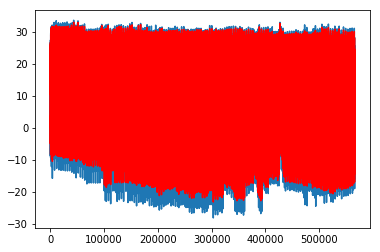

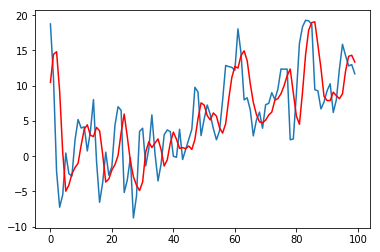

In [75]:
###TOD DO: FORECASTING MOVING AVERAGES
from pandas import Series
from numpy import mean
from sklearn.metrics import mean_squared_error
from matplotlib import pyplot
#series = Series.from_csv('daily-total-female-births.csv', header=0)
series= Series(data=data_long.X.values, index=data_long.Date)
# prepare situation
X = series.values
window = 3
history = [X[i] for i in range(window)]
test = [X[i] for i in range(window, len(X))]
predictions = list()

# walk forward over time steps in test
for t in range(len(test)):
    length = len(history)
    yhat = mean([history[i] for i in range(length-window,length)])
    obs = test[t]
    predictions.append(yhat)
    history.append(obs)
    print('predicted=%f, expected=%f' % (yhat, obs))
error = mean_squared_error(test, predictions)
print('Test MSE: %.3f' % error)
# plot
pyplot.plot(test)
pyplot.plot(predictions, color='red')
pyplot.show()
# zoom plot
pyplot.plot(test[0:100])
pyplot.plot(predictions[0:100], color='red')
pyplot.show()

In [76]:
series

Date
2004-01-01     6.805
2004-01-02     9.975
2004-01-03    14.625
2004-01-04    18.760
2004-01-05    11.060
2004-01-06    -2.150
2004-01-07    -7.245
2004-01-08    -5.490
2004-01-09     0.440
2004-01-10    -2.485
2004-01-11    -2.825
2004-01-12     2.285
2004-01-13     5.205
2004-01-14     3.995
2004-01-15     4.155
2004-01-16     0.740
2004-01-17     3.490
2004-01-18     8.025
2004-01-19    -0.735
2004-01-20    -6.545
2004-01-21    -3.740
2004-01-22     0.570
2004-01-23    -2.705
2004-01-24    -1.440
2004-01-25     4.415
2004-01-26     7.015
2004-01-27     6.500
2004-01-28    -5.150
2004-01-29    -3.395
2004-01-30    -0.215
               ...  
2014-12-02    -6.915
2014-12-03    -3.120
2014-12-04    -1.725
2014-12-05    -3.260
2014-12-06     0.560
2014-12-07    -1.485
2014-12-08    -2.565
2014-12-09     1.315
2014-12-10     0.230
2014-12-11    -3.430
2014-12-12    -1.515
2014-12-13     0.270
2014-12-14     3.875
2014-12-15     7.830
2014-12-16     7.745
2014-12-17     2.750
2014-12-